In [ ]:
# Load the Pandas libraries with alias 'pd' 
import numpy as np
import pandas as pd 
import matplotlib.colors as Colors
import matplotlib.pyplot as plt
import os
import cv2
import sys
from matplotlib.collections import PatchCollection
from matplotlib.patches import Rectangle
from scipy.stats import entropy
from os import listdir
from os.path import isfile, join
import math
from scipy.stats import chisquare
from scipy import stats
from itertools import product
import pickle
import random


np.set_printoptions(threshold=sys.maxsize)

def plotAllModelsObservables(models, coeffs):
    
    
    observables = loadObservables()
    
    numObservables = len(observables)
    nrows = math.ceil(numObservables/2)
    ncols = 2
    nrows =3
    ncols =3
    imageWidth = 6
    imageHeight = 5
    hspace = 0.5
    wspace = 0.5
    figureHeight = nrows * imageHeight + (nrows - 1) * hspace
    figureWidth = ncols * imageWidth + (ncols - 1) * wspace
    
    plt.rc('text', usetex=True)
    plt.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]    
    
    
    for C9, C10 in models:    
        index = 1
        fig, axs = plt.subplots(nrows,ncols)
        fig.subplots_adjust(left=None, right=None, bottom=None, top=0.90, hspace=hspace, wspace=wspace)  
        fig.set_figheight(figureHeight)
        fig.set_figwidth(figureWidth)
        fig.delaxes(axs[2,2])
        axs = np.reshape(axs,(-1))
        axis_index = 0
        allFits=[]
        for mo, eo in observables:
            
            #fig.suptitle(title, fontsize=18) 
            df = mo['data']
            de = eo['data']
            
            ax = axs[axis_index]            
            
            observableName = mo['name']
            
            ax.set_xlabel(r'\(\boldsymbol{q^2(GeV^2)}\)', fontsize=16)
            print(observableName)
            if(observableName == 'RKStar'):
                ytitle = 'R'
                ax.set_ylabel(r'\(\langle \boldsymbol{{{}_K^*}} \rangle\)'.format(ytitle), fontsize=16)
            elif(observableName=='BRK0mumu'):
                ytitle = 'B'
                ax.set_ylabel(r'\(\langle \boldsymbol{{\mathcal{B}(B^0\rightarrow K\mu\mu)}} \rangle\)', fontsize=16)
            elif(observableName=='BRK0Starmumu'):
                ytitle = 'B'
                ax.set_ylabel(r'\(\langle \boldsymbol{{\mathcal{B}(B^0\rightarrow K^{*0}\mu\mu)}} \rangle\)', fontsize=16)
            elif(observableName == 'P5'):
                ytitle = 'P'
                ax.set_ylabel(r'\(\langle \boldsymbol{{{}_5}} \rangle\)'.format(ytitle), fontsize=16)
            else:
                ax.set_ylabel(r'\(\langle \boldsymbol{{{}}} \rangle\)'.format(observableName), fontsize=16)
                
            computeModelObservable(df, C9, C10)
            if(len(coeffs) > 0):
                addQPoly(df,coeffs[axis_index])
                
            fit = computeModelFit(df, de)
            print(fit)
            print(coeffs[axis_index])
            allFits.append(fit)
            ax.set_title(r'\(\chi^2:{} \)'.format(round(fit,2)), fontsize=20)
            ax.set_xlim(0, max(df['BinHigh'].max(), de['BinHigh'].max()))
            ax.set_ylim([min(df['MinValue'].min(),de['MinValue'].min()), max(df['MaxValue'].max(),de['MaxValue'].max())])
            
            plotObservable(ax, df, 'orange', 'black', 1)
            plotObservable(ax, de, 'black', 'green', 0, True, True)
            index = index + 1 
            
            axis_index = axis_index + 1
        title = r'Model: C9: {}, C10: {}, \(\chi^2: {} \)'.format(round(C9,2), round(C10,2),round(np.array(allFits).sum(),2))         
        fig.suptitle(title, fontsize=24) 
        fig.savefig('observableImages/{}.svg'.format('AllObservables'))
    plt.show()
   
    
    
def expandObservableData(df):
    df['Widths'] = df['BinHigh'] - df['BinLow']
    df['Heights'] = df['ErrorPlus'] + df['ErrorMinus']  
    
       

def plotObservable(ax, df, color,kcolor, opacity, yerrorbar = False, onlyErrorBars = False):   
    patches = [Rectangle((x,y), w, h) for x,y,w,h in zip(df['BinLow'], df['MinValue'], df['Widths'], df['Heights'])]
    xerror = [df['Widths'] / 2, df['Widths'] / 2]    
    
    if(not onlyErrorBars):
        p = PatchCollection(patches, facecolor=Colors.to_rgba(color, opacity))
        ax.add_collection(p)       
    ax.errorbar(df['BinLow'] + df['Widths']/2, df['BinValue'], xerr=xerror, fmt='None', ecolor=Colors.to_rgba(kcolor, 1))
    if(yerrorbar):
        yerror = [df['Heights'] / 2, df['Heights'] / 2] 
        ax.errorbar(df['BinLow'] + df['Widths']/2, df['BinValue'], yerr=yerror, fmt='None', ecolor=Colors.to_rgba(kcolor, 1))


def computePoly(binCoeffs,c9,c10):
    a = binCoeffs[0]
    b = binCoeffs[1]*c10
    c = binCoeffs[2]*c10**2
    d = binCoeffs[3]*c9
    e = binCoeffs[4]*c10*c9
    f = binCoeffs[5]*c9**2
    return a + b + c  + d + e + f

def getBinValuesFreeCoeffs(df, c9, c10, observableCoeffs):     
    df['BinValue'] = [computePoly(binCoeffs,c9,c10) for binCoeffs in observableCoeffs]
    
        
def getBinValues(df, C9, C10):     
    df2 = df.copy();       
    df2['C10'] = df2['C10']*C10
    df2['C10^2'] = df2['C10^2']*C10**2
    df2['C9'] = df2['C9']*C9
    df2['C10*C9']=df2['C10*C9']*C10*C9
    df2['C9^2'] = df2['C9^2']*C9**2    
    df['BinValue'] = df['C0'] + df2['C10'] + df2['C10^2'] + df2['C9'] + df2['C10*C9'] + df2['C9^2']
    df['MinValue'] = df['BinValue'] - df['ErrorMinus']
    df['MaxValue'] = df['BinValue'] + df['ErrorPlus']

def getModelObservable(DATADIR, filename) :
    return getObservable(DATADIR, filename)

def getExpObservable(DATADIR, filename) :
    eo = getObservable(DATADIR, filename)
    df = eo['data']
    df['MinValue'] = df['BinValue'] - df['ErrorMinus']
    df['MaxValue'] = df['BinValue'] + df['ErrorPlus']
    return eo

def getObservable(DATADIR, filename):
    try:  
        df = pd.read_csv(os.path.join(DATADIR, filename))
        expandObservableData(df)
        fname = filename.split('.')[0]              
        return {'name': fname, 'data': df}
    except Exception as e:
        print('Exception',e)
        pass
    
def computeModelFit2(dfm, dfe):
    data = zip(dfm['BinValue'], dfe['BinValue'], (dfm['ErrorPlus']+dfm['ErrorMinus'])/2, (dfe['ErrorPlus']+dfe['ErrorMinus'])/2)
    binFits = [computeChiSquare(muModel, muExp, sigmaModel, sigmaExp) for muModel, muExp, sigmaModel, sigmaExp in data]      
    s = sum(binFits)
    return s
        
def computeChiSquare(muModel, muExp, sigmaModel, sigmaExp):   
    return (muExp - muModel)**2/(sigmaModel**2 + sigmaExp**2)
    

def getObservables(DATADIR, EXPDIR, names):
    observables = []
    for filename in names:
        mo = getModelObservable(DATADIR, filename)        
        eo = getExpObservable(EXPDIR, filename)
        observables.append([mo, eo])
    return observables
    
def getAllObservables():
    DATADIR = 'data/models/observables' 
    EXPDIR = 'data/experimental'     
    onlyfiles = [f for f in listdir(DATADIR) if isfile(join(DATADIR, f))]    
    return getObservables(DATADIR, EXPDIR, onlyfiles)   

def computeRandomModelsFit(observables):    
    models = getRandomModels()
    return computeModelsFit(models, observables)    

def getCoeffsFromModels(models):
    m = [[c9, c10] for c9, c10 in zip(models['C9'], models['C10'])]
    return m
    
def getModels():
    MODELSDIR = 'data/models'  
    mfilename = 'models1.txt'    
    models = pd.read_csv(os.path.join(MODELSDIR, mfilename))
    return models

def addQPoly(dfe, coeffs):
    dfe['q^2'] = (dfe['BinHigh'] + dfe['BinLow']) / 2
    
    dfe['Fq^2Net'] = coeffs[0]  + coeffs[1] * dfe['q^2'] + coeffs[2] * dfe['q^2']**2
    
    dfe['BinValueOld'] = dfe['BinValue']
    dfe['BinValue'] = dfe['BinValue'] + dfe['Fq^2Net']  
    dfe['BinValueDiff'] = dfe['BinValue'] - dfe['BinValueOld']
    dfe['MinValue'] = dfe['BinValue'] - dfe['ErrorMinus']
    dfe['MaxValue'] = dfe['BinValue'] + dfe['ErrorPlus']
    
        
def computeModelObservable(df, C9, C10):
    getBinValues(df,C9, C10) 
    expandObservableData(df)

def getObservablesByName(DATADIR, EXPDIR, names):
    names = [f for f in listdir(DATADIR) if isfile(join(DATADIR, f)) and f.split('.')[0] in names]
    return getObservables(DATADIR, EXPDIR, names)     

    
def computeAllModelsAllFit():
    DATADIR = 'data/models/observables' 
    EXPDIR = 'data/experimental'  
    models = getModels()
    m = getCoeffsFromModels(models)
    observables = getAllObservables()
    #observables = getObservablesByName(DATADIR, EXPDIR, ['P5'])
    return computeModelsFit(m, observables)

def getValue(value, low, high ):    
    #print('value: {}, high: {}, low: {}, newValue: {}'.format(value,high,low, random.uniform(value - low, value + high)))
    return np.random.normal(value, low)

def generateExperimental():    
    observables = loadObservables()
    x = np.array([])
    for mo, eo in observables:
        dfe = eo['data']
        x = np.append(x, dfe['BinValue'].values)
        
    saveData("X_experimental.pickle", x)
    return x

def saveData(filename, data):
    pickle_out = open(filename, "wb")
    pickle.dump(data, pickle_out)
    pickle_out.close()         

    
def generateBinErrors():
    observables = loadObservables() 
    
    errors = np.empty([0,6]);
    for mo, eo in observables:
        
        dfm = mo['data']
        dfe = eo['data']
        expandObservableData(dfm)
        expandObservableData(dfe)
        dfmErrorMinus = dfm['ErrorMinus']  
        dfeErrorMinus = dfe['ErrorMinus']  
        dfmError = dfm['Heights'].values / 2
        dfeError = dfe['Heights'].values / 2
        widths = dfe['Widths'].values
        bins = dfm['BinLow'].values
        errors = np.append(errors, [[a,b,c,d,e,f] for a,b,c,d,e,f in zip(dfmError,dfeError,widths,bins,dfmErrorMinus,dfeErrorMinus)],axis=0)
     
    saveData("errors.pickle", errors)
    

def generateObservableNumBins():
    observables = loadObservables() 
    
    numBins = []
    for mo, eo in observables:
        dfe = eo['data']
        numBins.append(len(dfe.index))
     
    saveData("numBins.pickle", numBins)
    print(numBins)


    
def genNNData():
    observables = loadObservables()  
    models = getRandomModels()
   
    X = []
    Y = []
    coeffs = []
    iter=0   
    bestFit=100000
    bestc=[]
    allFits=[]
    for c9, c10 in models:
        print(iter)
        iter=iter+1             
            
       
        x = []
        y = np.array([])

        fits=[]        

        for mo, eo in observables:
            dfm = mo['data']
            dfe = eo['data']                

            computeModelObservable(dfm,c9, c10)


            fit = computeModelFit(dfm, dfe)
            fits.append(fit)                

            x = x + dfm['BinValue'].values.tolist()          


        y = np.append(y,[c9,c10])     
       
        fit = np.array(fits).sum()
        allFits.append(fit)
     
        if(fit<bestFit):
            bestFit=fit
            bestc = [c9,c10]
            print(bestc)
            print(fit)
            
        # FOR GAN -----------------------------
        x = x + [c9,c10]
        #--------------------------------------
        X.append(x)
        
        Y.append(y.tolist()) 
            
        
    
    generateExperimental()
    X = np.array(X)
    Y = np.array(Y)  
    
    
    saveData("X_NN.pickle", X)
    saveData("y_NN.pickle", Y)
    saveData("histLogChisquare.pickle", allFits)
    
    print(bestFit)
    print(bestc)
    print(X[0])
    
    
def genNNWithCoeffsData():
    observables = loadObservables()  
    models = getRandomModels()
   
    X = []
    Y = []
    coeffs = []
    numPolyCoeffs = 100
    iter=0   
    bestFit=100000
    bestq=[]
    bestc=[]
    for c9, c10 in models:
        print(iter)
        iter=iter+1        
        
        for i in range(numPolyCoeffs):  
            
            allFits = []      
            x = []
            y = np.array([])
            allQSquareCoeffs = np.array([])            
            fits=[]
            numObs = 0
            
            for mo, eo in observables:
                dfm = mo['data']
                dfe = eo['data']                
                
                computeModelObservable(dfm,c9, c10)
                
                if(i==0):
                    QSsquareCoeffs = np.random.uniform(0, 0, 3)                
                else:
                    QSsquareCoeffs = [rnd() for _ in range(3)]
                    QSsquareCoeffs[1] = QSsquareCoeffs[1]/10
                    QSsquareCoeffs[2] = QSsquareCoeffs[2]/100
                    QSsquareCoeffs = np.round(QSsquareCoeffs,2)
                  
                
                allQSquareCoeffs = np.append(allQSquareCoeffs, QSsquareCoeffs)                
                addQPoly(dfm, QSsquareCoeffs)                
                fit = computeModelFit(dfm, dfe)
                fits.append(fit)                
                
                x = x + dfm['BinValue'].values.tolist()
                numObs = numObs + 1
                
            
            y = np.append(y,[c9,c10])     
            y = np.append(y, allQSquareCoeffs)
            fit = np.array(fits).sum()
            if(fit<bestFit):
                bestFit=fit
                bestc = [c9,c10]
                bestq = allQSquareCoeffs
                print(bestc)
                print(bestq)
                print(fit)
            X.append(x)
            #X.append(x + [fit])
            
            
            Y.append(y.tolist()) 
            
        
    
    generateExperimental()
    X = np.array(X)
    Y = np.array(Y)  
    
    
    saveData("X_NN_With_Coeffs.pickle", X)
    saveData("y_NN_With_Coeffs.pickle", Y)
    
    saveData("coeffs_noChi.pickle", coeffs)  
    print(bestFit)
    print(bestc)
    print(bestq)
    

    
def loadObservables():
    DATADIR = 'data/models/observables' 
    EXPDIR = 'data/experimental'  
    observables = []
    
    P1 = getObservablesByName(DATADIR, EXPDIR, ['P1'])
    P2 = getObservablesByName(DATADIR, EXPDIR, ['P2'])
    P4 = getObservablesByName(DATADIR, EXPDIR, ['P4'])
    P5 = getObservablesByName(DATADIR, EXPDIR, ['P5'])
    BRK0Starmumu = getObservablesByName(DATADIR, EXPDIR, ['BRK0Starmumu'])
    BRK0mumu = getObservablesByName(DATADIR, EXPDIR, ['BRK0mumu'])
    RK = getObservablesByName(DATADIR, EXPDIR, ['RK'])
    RKStar = getObservablesByName(DATADIR, EXPDIR, ['RKStar'])    
    #
    observables = np.array([P1, P2, P4, P5, BRK0Starmumu, BRK0mumu, RK, RKStar])
    observables = observables.reshape((8,2))
    
    #observables = np.array([RKStar])
    #observables = observables.reshape((1,2))
    
    
    #observables = np.array([P1])
    #observables = observables.reshape((1,2))
    return observables

    
def getRandomModels():
    #c9 = np.round(np.linspace(-2, 0, num=10), 2)
    #c10 = np.round(np.linspace(-1, 1, num=10), 2)    
    c9 = np.round(np.linspace(-5, 5, num=50), 2)
    c10 = np.round(np.linspace(-5, 5, num=50), 2)    
    models = np.meshgrid(c9, c10)    
    
    r = np.array([(x,y) for a,b in zip(models[0], models[1]) for x,y in zip(a,b)]) 
    #r = np.array([(x,y) for x,y in zip(c9,c10)])      
    area = np.pi*2
    # Plot
    plt.scatter(r[:,0], r[:,1], s=area, alpha=1)
    plt.show() 
    return r   


    
def rnd():
    exp = random.randint(-19, -15)
    base = 10 * random.random() - 1
    #return base * 10**exp
    #return random.random()
    return round(random.uniform(-1, 1),2)
    return round(random.uniform(-0.010, 0.010),2)
    


def computeModelCoeffsFit(coeffs, q2coeffs):
    observables = loadObservables() 
    c9, c10 = coeffs[0]
    fits=[]
    numObs = 0
    for mo, eo in observables:
        dfm = mo['data']
        dfe = eo['data'] 
        computeModelObservable(dfm,c9, c10)

        if(len(q2coeffs) > 0):            
            addQPoly(dfm, q2coeffs[numObs])

        fit = computeModelFit2(dfm, dfe)
        
        fits.append(fit)
        numObs = numObs+1
        
    return np.array(fits).sum()

Model: "sequential_118"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_337 (Conv2D)          (None, 4, 4, 8)           40        
_________________________________________________________________
leaky_re_lu_180 (LeakyReLU)  (None, 4, 4, 8)           0         
_________________________________________________________________
dropout_180 (Dropout)        (None, 4, 4, 8)           0         
_________________________________________________________________
conv2d_338 (Conv2D)          (None, 2, 2, 64)          4672      
_________________________________________________________________
leaky_re_lu_181 (LeakyReLU)  (None, 2, 2, 64)          0         
_________________________________________________________________
dropout_181 (Dropout)        (None, 2, 2, 64)          0         
_________________________________________________________________
flatten_59 (Flatten)         (None, 256)            

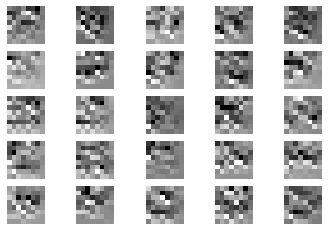

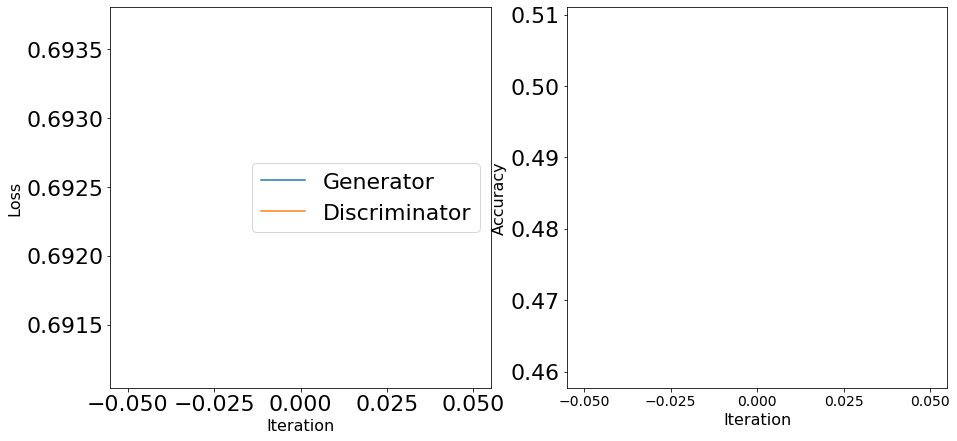

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1 [D loss: 0.668668, acc.: 51.56%] [G loss: 0.690408]
2 [D loss: 0.668559, acc.: 35.94%] [G loss: 0.686960]
3 [D loss: 0.638912, acc.: 46.88%] [G loss: 0.687304]
4 [D loss: 0.648874, acc.: 50.00%] [G loss: 0.684315]
5 [D loss: 0.652732, acc.: 48.44%] [G loss: 0.683023]
6 [D loss: 0.626500, acc.: 53.12%] [G loss: 0.680427]
7 [D loss: 0.639810, acc.: 51.56%] [G loss: 0.681935]
8 [D loss: 0.646457, acc.: 56.25%] [G loss: 0.674259]
9 [D loss: 0.612466, acc.: 56.25%] [G loss: 0.673663]
10 [D loss: 0.632076, acc.: 53.12%] [G loss: 0.677986]
11 [D loss: 0.609435, acc.: 53.12%] [G loss: 0.680428]
12 [D loss: 0.600946, acc.: 59.38%] [G loss: 0.687034]
13 [D loss: 0.600208, acc.: 64.06%] [G loss: 0.676365]
14 [D loss: 0.590692, acc.: 65.62%] [G loss: 0.684935]
15 [D loss: 0.583315, acc.: 64.06%] [G loss: 0.692094]
16 [D loss: 0.587661, acc.: 70.31%] [G loss: 0.691327]
17 [D loss: 0.576004, acc.: 75.00%] [G loss: 0.696743]
18 [D loss: 0.555049, acc.: 73.44%] [G loss: 0.693755]
19 [D loss: 0.57805

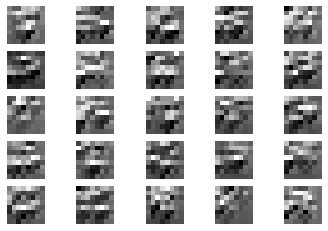

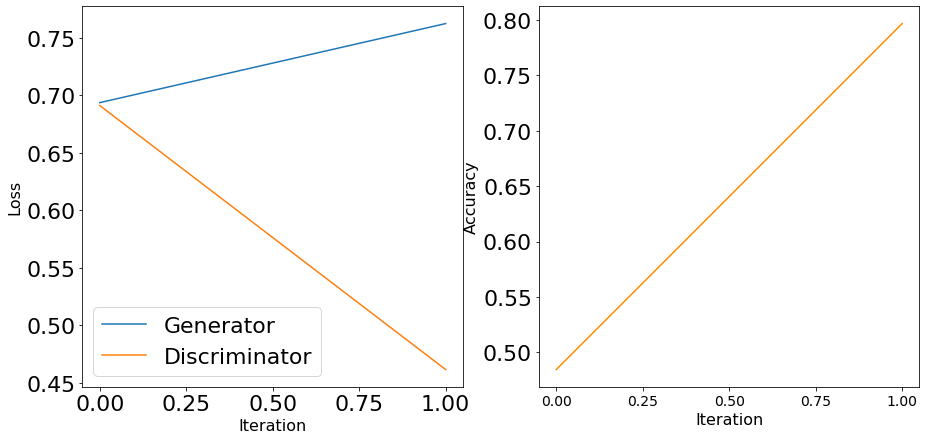

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


101 [D loss: 0.434865, acc.: 82.81%] [G loss: 0.750029]
102 [D loss: 0.463235, acc.: 78.12%] [G loss: 0.722304]
103 [D loss: 0.458948, acc.: 71.88%] [G loss: 0.730037]
104 [D loss: 0.458195, acc.: 79.69%] [G loss: 0.747536]
105 [D loss: 0.503347, acc.: 76.56%] [G loss: 0.693780]
106 [D loss: 0.426292, acc.: 90.62%] [G loss: 0.844781]
107 [D loss: 0.457155, acc.: 82.81%] [G loss: 0.712098]
108 [D loss: 0.479335, acc.: 78.12%] [G loss: 0.777502]
109 [D loss: 0.457990, acc.: 76.56%] [G loss: 0.776116]
110 [D loss: 0.487840, acc.: 73.44%] [G loss: 0.735169]
111 [D loss: 0.477593, acc.: 81.25%] [G loss: 0.785304]
112 [D loss: 0.442998, acc.: 85.94%] [G loss: 0.837386]
113 [D loss: 0.448095, acc.: 85.94%] [G loss: 0.778379]
114 [D loss: 0.479378, acc.: 84.38%] [G loss: 0.748870]
115 [D loss: 0.405919, acc.: 89.06%] [G loss: 0.825680]
116 [D loss: 0.475963, acc.: 78.12%] [G loss: 0.786207]
117 [D loss: 0.427625, acc.: 87.50%] [G loss: 0.774497]
118 [D loss: 0.425600, acc.: 82.81%] [G loss: 0.

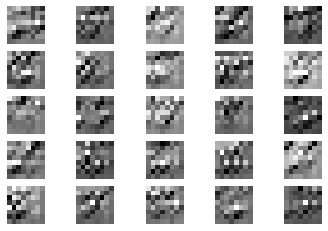

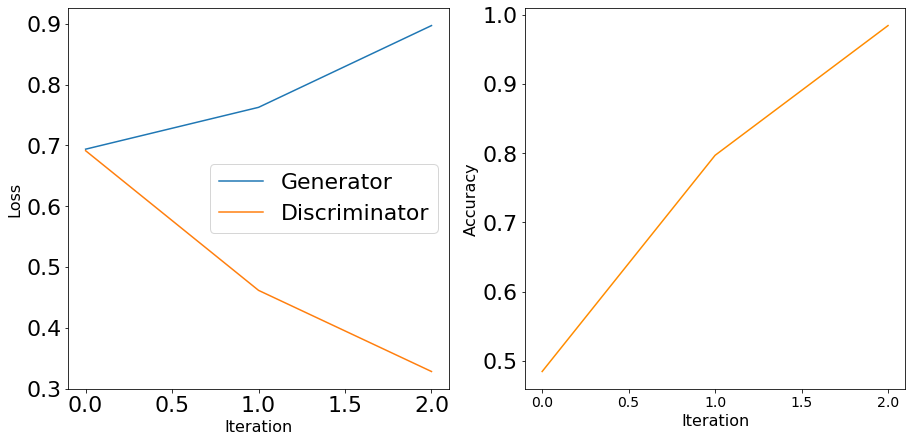

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


201 [D loss: 0.361602, acc.: 95.31%] [G loss: 0.903771]
202 [D loss: 0.341720, acc.: 93.75%] [G loss: 0.987670]
203 [D loss: 0.376737, acc.: 93.75%] [G loss: 0.915218]
204 [D loss: 0.342726, acc.: 92.19%] [G loss: 0.906101]
205 [D loss: 0.388254, acc.: 85.94%] [G loss: 0.954636]
206 [D loss: 0.391391, acc.: 90.62%] [G loss: 0.924279]
207 [D loss: 0.372723, acc.: 90.62%] [G loss: 0.935453]
208 [D loss: 0.328820, acc.: 90.62%] [G loss: 1.010237]
209 [D loss: 0.296215, acc.: 96.88%] [G loss: 1.039644]
210 [D loss: 0.379486, acc.: 90.62%] [G loss: 0.961139]
211 [D loss: 0.318845, acc.: 95.31%] [G loss: 1.018559]
212 [D loss: 0.307591, acc.: 90.62%] [G loss: 1.001505]
213 [D loss: 0.306891, acc.: 95.31%] [G loss: 0.980903]
214 [D loss: 0.333758, acc.: 90.62%] [G loss: 0.964845]
215 [D loss: 0.340101, acc.: 89.06%] [G loss: 0.967471]
216 [D loss: 0.320840, acc.: 98.44%] [G loss: 0.973074]
217 [D loss: 0.288792, acc.: 98.44%] [G loss: 1.003670]
218 [D loss: 0.307355, acc.: 96.88%] [G loss: 1.

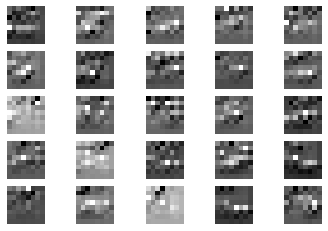

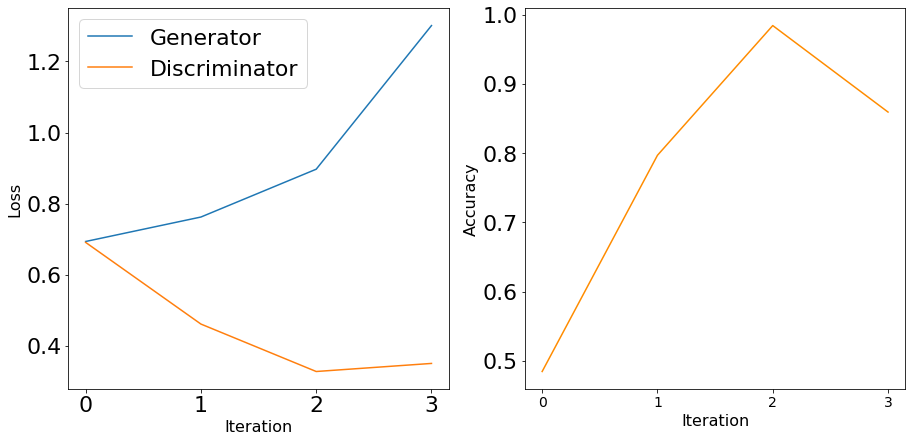

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


301 [D loss: 0.351401, acc.: 82.81%] [G loss: 1.194175]
302 [D loss: 0.276211, acc.: 92.19%] [G loss: 1.484619]
303 [D loss: 0.277950, acc.: 92.19%] [G loss: 1.521499]
304 [D loss: 0.323098, acc.: 92.19%] [G loss: 1.252797]
305 [D loss: 0.370423, acc.: 84.38%] [G loss: 1.303699]
306 [D loss: 0.330660, acc.: 89.06%] [G loss: 1.522245]
307 [D loss: 0.322792, acc.: 92.19%] [G loss: 1.403270]
308 [D loss: 0.259383, acc.: 93.75%] [G loss: 1.487740]
309 [D loss: 0.338084, acc.: 81.25%] [G loss: 1.279811]
310 [D loss: 0.350478, acc.: 92.19%] [G loss: 1.437999]
311 [D loss: 0.334207, acc.: 87.50%] [G loss: 1.277517]
312 [D loss: 0.350204, acc.: 82.81%] [G loss: 1.333672]
313 [D loss: 0.373242, acc.: 89.06%] [G loss: 1.191412]
314 [D loss: 0.317365, acc.: 87.50%] [G loss: 1.452315]
315 [D loss: 0.366591, acc.: 84.38%] [G loss: 1.426528]
316 [D loss: 0.345404, acc.: 89.06%] [G loss: 1.347193]
317 [D loss: 0.383375, acc.: 82.81%] [G loss: 1.371002]
318 [D loss: 0.281721, acc.: 93.75%] [G loss: 1.

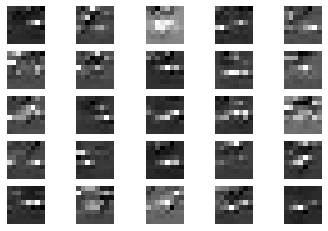

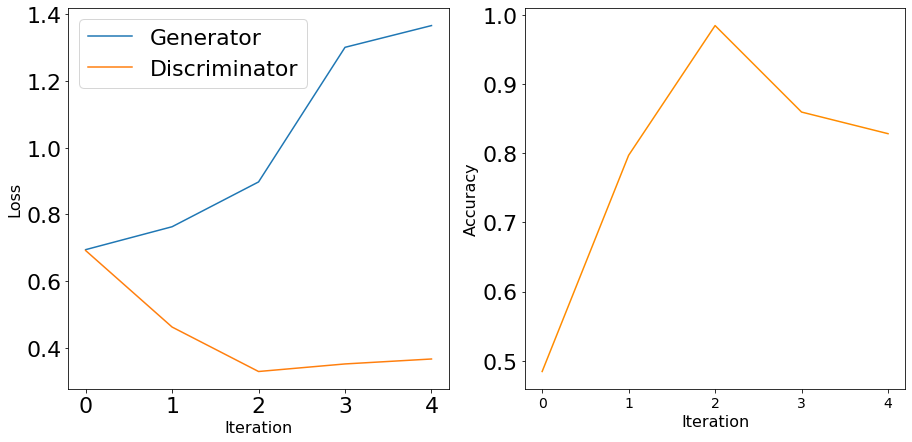

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


401 [D loss: 0.295774, acc.: 92.19%] [G loss: 1.472843]
402 [D loss: 0.368180, acc.: 90.62%] [G loss: 1.483665]
403 [D loss: 0.326321, acc.: 84.38%] [G loss: 1.609208]
404 [D loss: 0.594490, acc.: 84.38%] [G loss: 1.209078]
405 [D loss: 0.377856, acc.: 84.38%] [G loss: 1.693445]
406 [D loss: 0.355816, acc.: 85.94%] [G loss: 1.606245]
407 [D loss: 0.428874, acc.: 75.00%] [G loss: 1.620649]
408 [D loss: 0.434839, acc.: 87.50%] [G loss: 1.371539]
409 [D loss: 0.461778, acc.: 75.00%] [G loss: 1.329713]
410 [D loss: 0.276065, acc.: 92.19%] [G loss: 1.857397]
411 [D loss: 0.423649, acc.: 78.12%] [G loss: 1.492585]
412 [D loss: 0.340063, acc.: 87.50%] [G loss: 1.481899]
413 [D loss: 0.419997, acc.: 84.38%] [G loss: 1.353085]
414 [D loss: 0.320881, acc.: 92.19%] [G loss: 1.750471]
415 [D loss: 0.413606, acc.: 85.94%] [G loss: 1.493729]
416 [D loss: 0.427306, acc.: 76.56%] [G loss: 1.676713]
417 [D loss: 0.433402, acc.: 84.38%] [G loss: 1.698374]
418 [D loss: 0.415431, acc.: 82.81%] [G loss: 1.

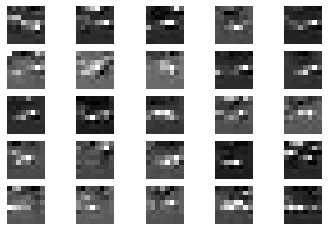

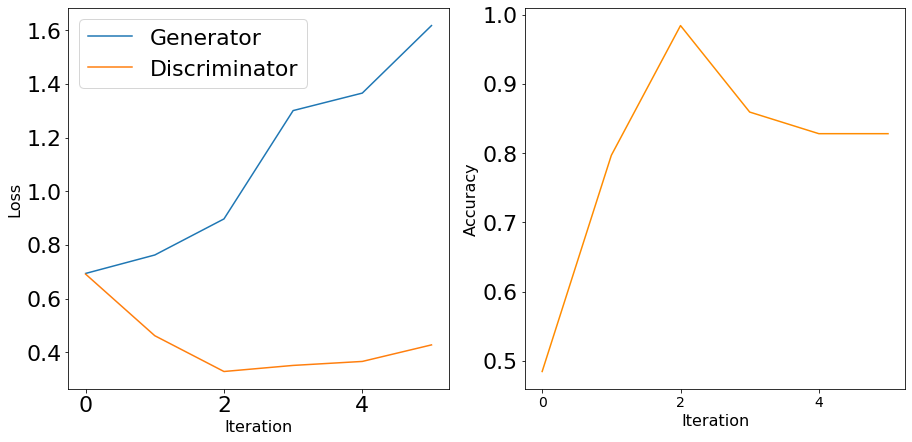

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


501 [D loss: 0.502792, acc.: 79.69%] [G loss: 1.457859]
502 [D loss: 0.425187, acc.: 84.38%] [G loss: 1.568555]
503 [D loss: 0.426364, acc.: 79.69%] [G loss: 1.456428]
504 [D loss: 0.477580, acc.: 75.00%] [G loss: 1.604176]
505 [D loss: 0.390266, acc.: 82.81%] [G loss: 1.579638]
506 [D loss: 0.485600, acc.: 79.69%] [G loss: 1.693394]
507 [D loss: 0.494720, acc.: 71.88%] [G loss: 1.412158]
508 [D loss: 0.404130, acc.: 84.38%] [G loss: 1.406394]
509 [D loss: 0.414630, acc.: 81.25%] [G loss: 1.434274]
510 [D loss: 0.405510, acc.: 81.25%] [G loss: 1.339726]
511 [D loss: 0.395670, acc.: 81.25%] [G loss: 1.639867]
512 [D loss: 0.500146, acc.: 73.44%] [G loss: 1.359721]
513 [D loss: 0.307273, acc.: 89.06%] [G loss: 1.554723]
514 [D loss: 0.468682, acc.: 79.69%] [G loss: 1.334148]
515 [D loss: 0.401748, acc.: 81.25%] [G loss: 1.576200]
516 [D loss: 0.541145, acc.: 76.56%] [G loss: 1.249489]
517 [D loss: 0.570141, acc.: 75.00%] [G loss: 1.423839]
518 [D loss: 0.363473, acc.: 85.94%] [G loss: 1.

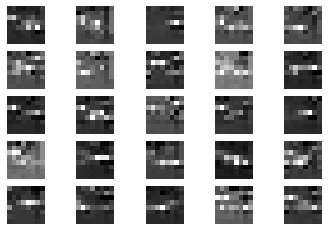

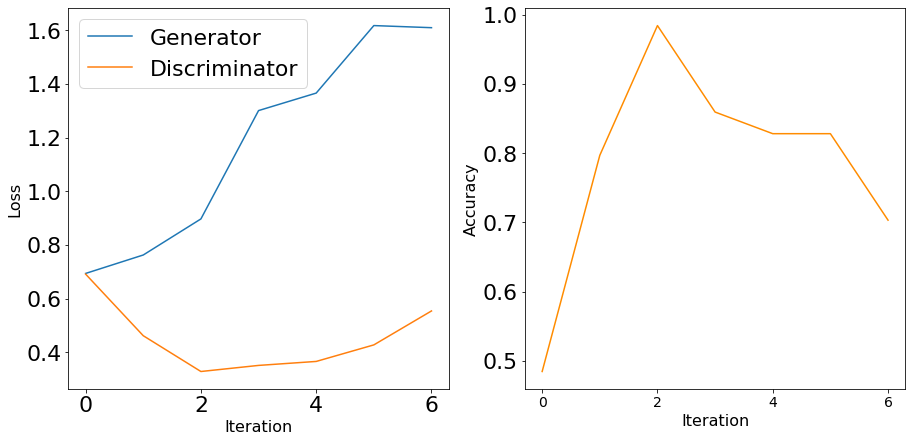

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


601 [D loss: 0.512826, acc.: 71.88%] [G loss: 1.495250]
602 [D loss: 0.444428, acc.: 76.56%] [G loss: 1.303303]
603 [D loss: 0.484697, acc.: 71.88%] [G loss: 1.753779]
604 [D loss: 0.412266, acc.: 85.94%] [G loss: 1.374473]
605 [D loss: 0.416914, acc.: 78.12%] [G loss: 1.534058]
606 [D loss: 0.431825, acc.: 82.81%] [G loss: 1.332985]
607 [D loss: 0.425938, acc.: 81.25%] [G loss: 1.324376]
608 [D loss: 0.529182, acc.: 76.56%] [G loss: 1.295600]
609 [D loss: 0.421331, acc.: 84.38%] [G loss: 1.429656]
610 [D loss: 0.510556, acc.: 79.69%] [G loss: 1.403669]
611 [D loss: 0.494200, acc.: 76.56%] [G loss: 1.340055]
612 [D loss: 0.455539, acc.: 79.69%] [G loss: 1.539543]
613 [D loss: 0.476360, acc.: 81.25%] [G loss: 1.507059]
614 [D loss: 0.614662, acc.: 67.19%] [G loss: 1.487502]
615 [D loss: 0.405798, acc.: 81.25%] [G loss: 1.491411]
616 [D loss: 0.402114, acc.: 82.81%] [G loss: 1.543746]
617 [D loss: 0.440253, acc.: 79.69%] [G loss: 1.596027]
618 [D loss: 0.509941, acc.: 71.88%] [G loss: 1.

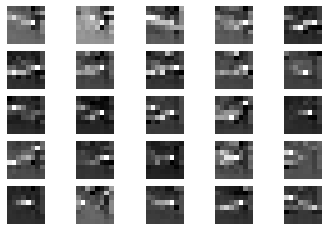

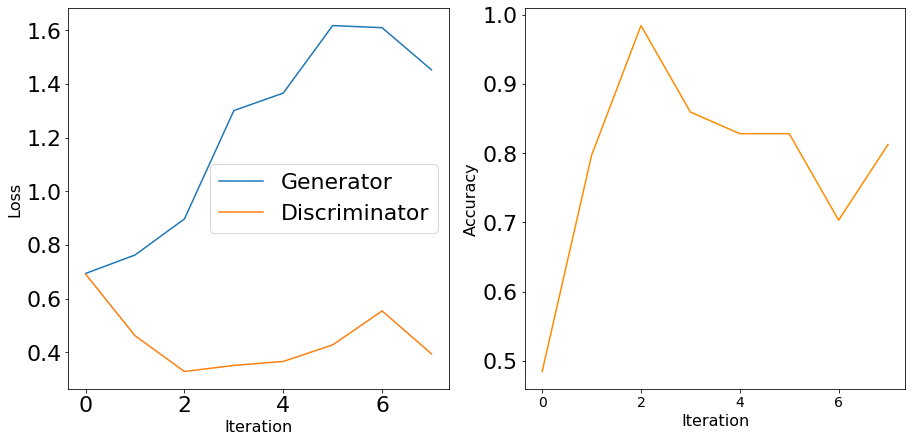

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


701 [D loss: 0.393713, acc.: 79.69%] [G loss: 1.531436]
702 [D loss: 0.388309, acc.: 82.81%] [G loss: 1.640971]
703 [D loss: 0.367873, acc.: 87.50%] [G loss: 1.326759]
704 [D loss: 0.447374, acc.: 76.56%] [G loss: 1.396064]
705 [D loss: 0.420414, acc.: 78.12%] [G loss: 1.470632]
706 [D loss: 0.457215, acc.: 81.25%] [G loss: 1.472106]
707 [D loss: 0.530682, acc.: 73.44%] [G loss: 1.199305]
708 [D loss: 0.446443, acc.: 78.12%] [G loss: 1.475982]
709 [D loss: 0.485280, acc.: 76.56%] [G loss: 1.427096]
710 [D loss: 0.431630, acc.: 81.25%] [G loss: 1.858310]
711 [D loss: 0.495822, acc.: 73.44%] [G loss: 1.485237]
712 [D loss: 0.574870, acc.: 76.56%] [G loss: 1.294080]
713 [D loss: 0.446762, acc.: 76.56%] [G loss: 1.424616]
714 [D loss: 0.522730, acc.: 71.88%] [G loss: 1.415627]
715 [D loss: 0.614192, acc.: 73.44%] [G loss: 1.322956]
716 [D loss: 0.518397, acc.: 71.88%] [G loss: 1.188790]
717 [D loss: 0.429569, acc.: 78.12%] [G loss: 1.561823]
718 [D loss: 0.502348, acc.: 75.00%] [G loss: 1.

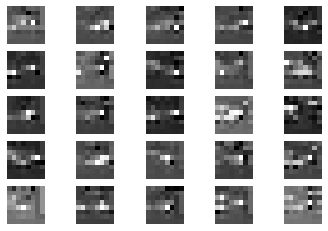

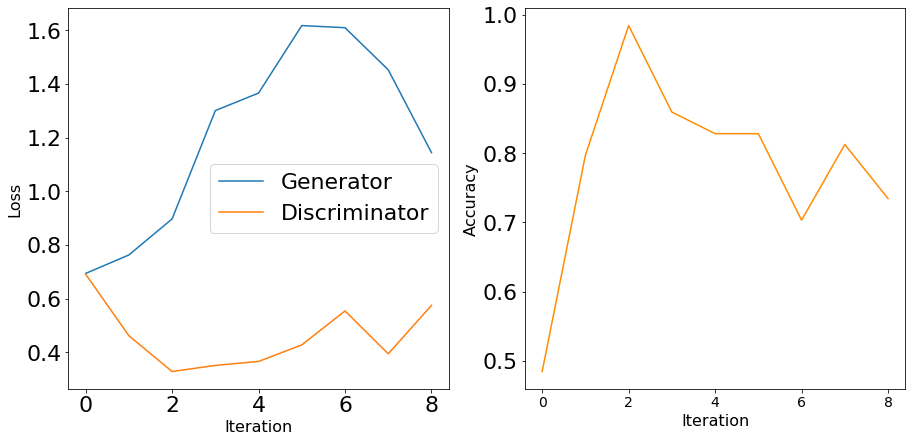

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


801 [D loss: 0.554700, acc.: 68.75%] [G loss: 1.166910]
802 [D loss: 0.476757, acc.: 78.12%] [G loss: 1.339067]
803 [D loss: 0.515844, acc.: 76.56%] [G loss: 1.336419]
804 [D loss: 0.520878, acc.: 78.12%] [G loss: 1.214961]
805 [D loss: 0.479570, acc.: 78.12%] [G loss: 1.402736]
806 [D loss: 0.460439, acc.: 78.12%] [G loss: 1.304278]
807 [D loss: 0.487510, acc.: 78.12%] [G loss: 1.320509]
808 [D loss: 0.576869, acc.: 65.62%] [G loss: 1.388232]
809 [D loss: 0.519964, acc.: 73.44%] [G loss: 1.691678]
810 [D loss: 0.438044, acc.: 81.25%] [G loss: 1.369270]
811 [D loss: 0.583168, acc.: 75.00%] [G loss: 1.528168]
812 [D loss: 0.509680, acc.: 79.69%] [G loss: 1.568697]
813 [D loss: 0.463564, acc.: 79.69%] [G loss: 1.300575]
814 [D loss: 0.455120, acc.: 75.00%] [G loss: 1.369247]
815 [D loss: 0.457002, acc.: 76.56%] [G loss: 1.485896]
816 [D loss: 0.472268, acc.: 81.25%] [G loss: 1.406105]
817 [D loss: 0.540428, acc.: 70.31%] [G loss: 1.262031]
818 [D loss: 0.472359, acc.: 68.75%] [G loss: 1.

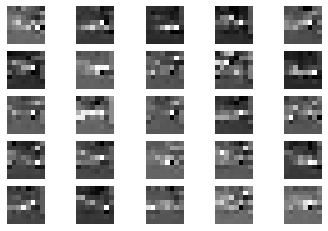

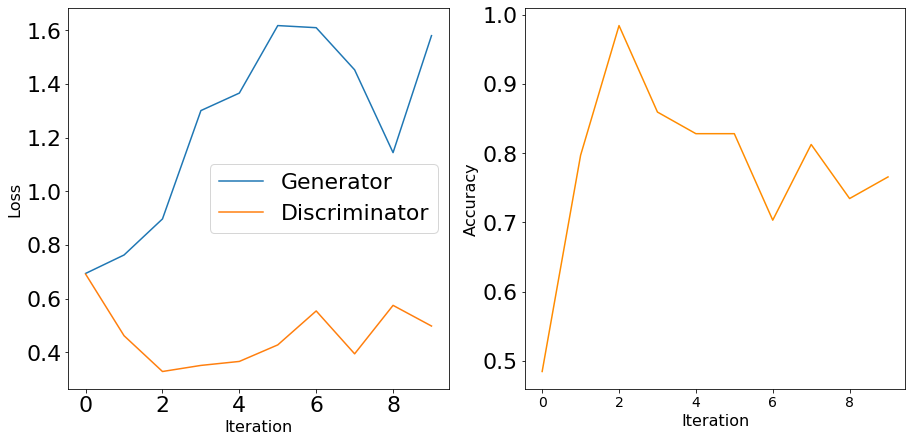

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


901 [D loss: 0.486059, acc.: 73.44%] [G loss: 1.241897]
902 [D loss: 0.501664, acc.: 71.88%] [G loss: 1.307686]
903 [D loss: 0.501069, acc.: 78.12%] [G loss: 1.214507]
904 [D loss: 0.462775, acc.: 78.12%] [G loss: 1.333959]
905 [D loss: 0.476597, acc.: 76.56%] [G loss: 1.214481]
906 [D loss: 0.576583, acc.: 71.88%] [G loss: 1.341596]
907 [D loss: 0.454045, acc.: 79.69%] [G loss: 1.186289]
908 [D loss: 0.497750, acc.: 71.88%] [G loss: 1.398265]
909 [D loss: 0.460847, acc.: 76.56%] [G loss: 1.457418]
910 [D loss: 0.425752, acc.: 81.25%] [G loss: 1.262533]
911 [D loss: 0.447978, acc.: 81.25%] [G loss: 1.139544]
912 [D loss: 0.500076, acc.: 71.88%] [G loss: 1.215181]
913 [D loss: 0.437769, acc.: 82.81%] [G loss: 1.459779]
914 [D loss: 0.398491, acc.: 82.81%] [G loss: 1.503600]
915 [D loss: 0.573533, acc.: 73.44%] [G loss: 1.353941]
916 [D loss: 0.454323, acc.: 82.81%] [G loss: 1.506091]
917 [D loss: 0.449484, acc.: 78.12%] [G loss: 1.452775]
918 [D loss: 0.475790, acc.: 70.31%] [G loss: 1.

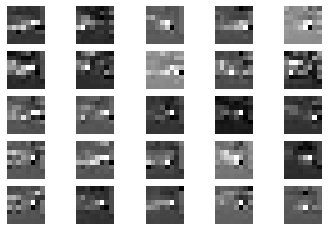

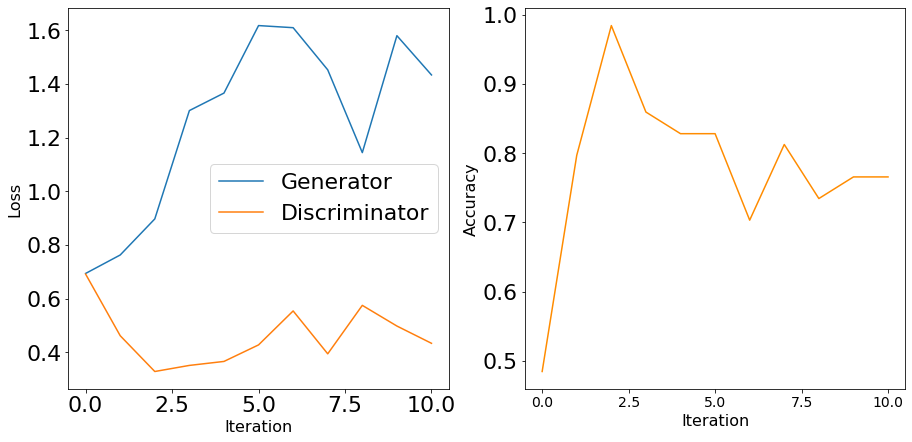

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1001 [D loss: 0.497662, acc.: 81.25%] [G loss: 1.219965]
1002 [D loss: 0.471006, acc.: 73.44%] [G loss: 1.586366]
1003 [D loss: 0.406207, acc.: 81.25%] [G loss: 1.450768]
1004 [D loss: 0.568052, acc.: 70.31%] [G loss: 1.333011]
1005 [D loss: 0.557297, acc.: 70.31%] [G loss: 1.673833]
1006 [D loss: 0.465996, acc.: 82.81%] [G loss: 1.428623]
1007 [D loss: 0.445816, acc.: 82.81%] [G loss: 1.763034]
1008 [D loss: 0.527373, acc.: 71.88%] [G loss: 1.322291]
1009 [D loss: 0.446019, acc.: 76.56%] [G loss: 1.484049]
1010 [D loss: 0.591859, acc.: 75.00%] [G loss: 1.312111]
1011 [D loss: 0.387981, acc.: 90.62%] [G loss: 1.605524]
1012 [D loss: 0.493335, acc.: 78.12%] [G loss: 1.044442]
1013 [D loss: 0.533669, acc.: 71.88%] [G loss: 1.324597]
1014 [D loss: 0.499152, acc.: 78.12%] [G loss: 1.196529]
1015 [D loss: 0.459688, acc.: 79.69%] [G loss: 1.323356]
1016 [D loss: 0.459283, acc.: 82.81%] [G loss: 1.626607]
1017 [D loss: 0.359342, acc.: 89.06%] [G loss: 1.600477]
1018 [D loss: 0.531253, acc.: 7

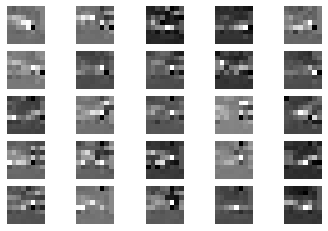

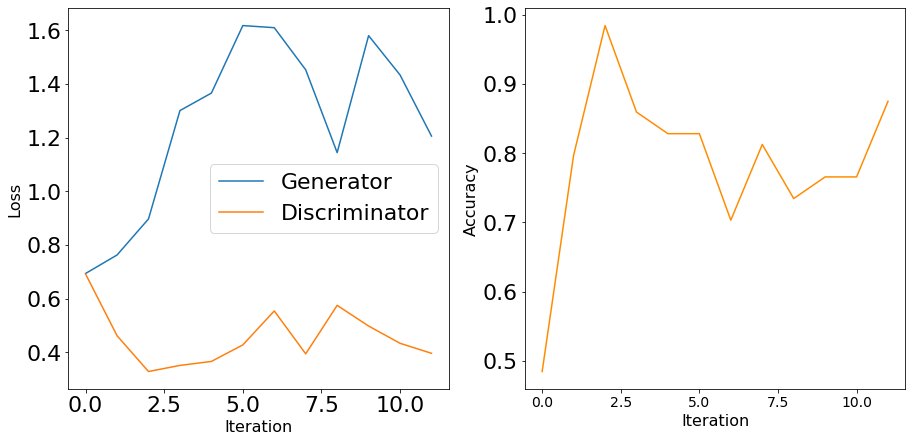

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1101 [D loss: 0.454729, acc.: 81.25%] [G loss: 1.217999]
1102 [D loss: 0.439898, acc.: 81.25%] [G loss: 1.390579]
1103 [D loss: 0.404023, acc.: 87.50%] [G loss: 1.265989]
1104 [D loss: 0.563834, acc.: 64.06%] [G loss: 1.334697]
1105 [D loss: 0.481613, acc.: 78.12%] [G loss: 1.365478]
1106 [D loss: 0.463062, acc.: 78.12%] [G loss: 1.356183]
1107 [D loss: 0.522087, acc.: 71.88%] [G loss: 1.625325]
1108 [D loss: 0.496640, acc.: 75.00%] [G loss: 1.262055]
1109 [D loss: 0.502538, acc.: 78.12%] [G loss: 1.519569]
1110 [D loss: 0.482314, acc.: 75.00%] [G loss: 1.629595]
1111 [D loss: 0.513165, acc.: 76.56%] [G loss: 1.255836]
1112 [D loss: 0.571992, acc.: 75.00%] [G loss: 1.351121]
1113 [D loss: 0.356444, acc.: 87.50%] [G loss: 1.255217]
1114 [D loss: 0.483226, acc.: 79.69%] [G loss: 1.154788]
1115 [D loss: 0.503351, acc.: 75.00%] [G loss: 1.268678]
1116 [D loss: 0.515247, acc.: 71.88%] [G loss: 1.373113]
1117 [D loss: 0.421709, acc.: 81.25%] [G loss: 1.284902]
1118 [D loss: 0.397201, acc.: 8

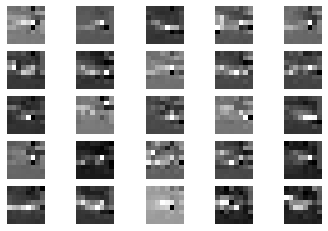

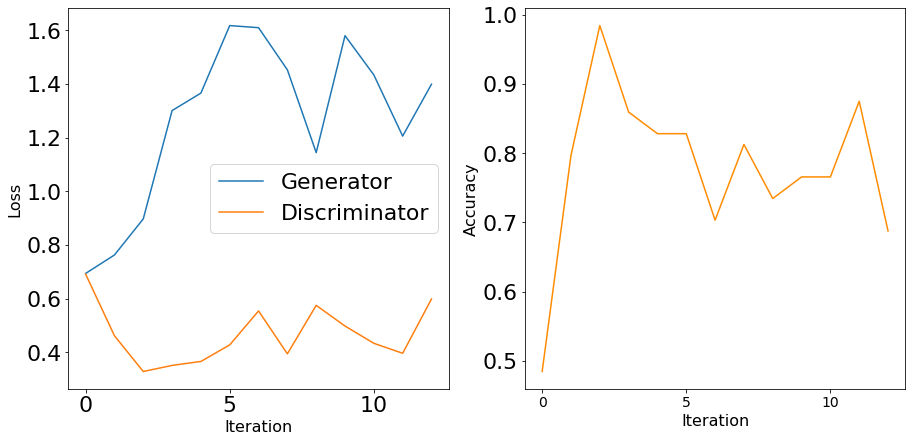

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1201 [D loss: 0.545081, acc.: 71.88%] [G loss: 1.123189]
1202 [D loss: 0.516265, acc.: 73.44%] [G loss: 1.616874]
1203 [D loss: 0.372685, acc.: 89.06%] [G loss: 1.239651]
1204 [D loss: 0.438275, acc.: 82.81%] [G loss: 1.264412]
1205 [D loss: 0.575321, acc.: 68.75%] [G loss: 1.221576]
1206 [D loss: 0.448306, acc.: 79.69%] [G loss: 1.513121]
1207 [D loss: 0.469926, acc.: 78.12%] [G loss: 1.542827]
1208 [D loss: 0.496811, acc.: 70.31%] [G loss: 1.417351]
1209 [D loss: 0.586766, acc.: 65.62%] [G loss: 1.299675]
1210 [D loss: 0.548267, acc.: 70.31%] [G loss: 1.270862]
1211 [D loss: 0.486982, acc.: 78.12%] [G loss: 1.298607]
1212 [D loss: 0.504834, acc.: 71.88%] [G loss: 1.588709]
1213 [D loss: 0.586636, acc.: 68.75%] [G loss: 1.454575]
1214 [D loss: 0.508668, acc.: 78.12%] [G loss: 1.295667]
1215 [D loss: 0.557419, acc.: 68.75%] [G loss: 1.455338]
1216 [D loss: 0.442083, acc.: 79.69%] [G loss: 1.425530]
1217 [D loss: 0.530447, acc.: 71.88%] [G loss: 1.155158]
1218 [D loss: 0.531206, acc.: 7

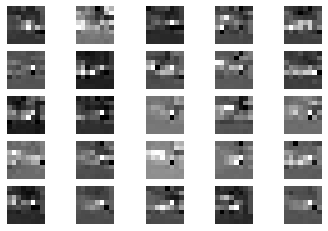

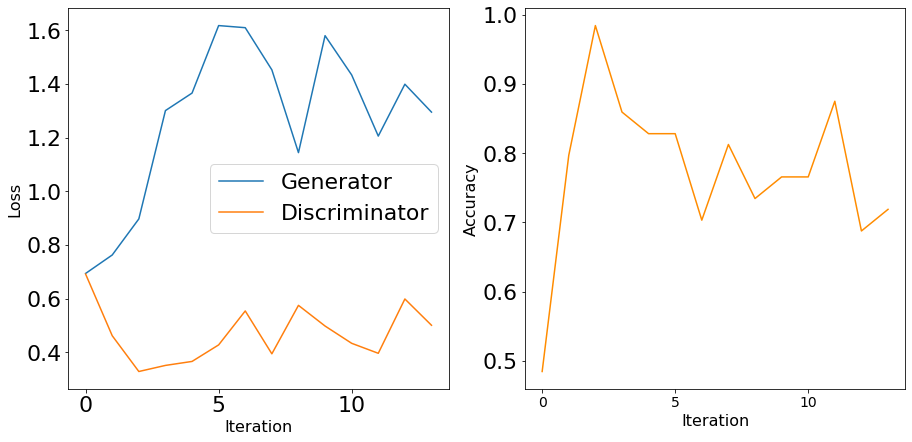

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1301 [D loss: 0.438070, acc.: 82.81%] [G loss: 1.420984]
1302 [D loss: 0.415888, acc.: 82.81%] [G loss: 1.163309]
1303 [D loss: 0.443777, acc.: 81.25%] [G loss: 1.480740]
1304 [D loss: 0.440377, acc.: 79.69%] [G loss: 1.554841]
1305 [D loss: 0.468114, acc.: 76.56%] [G loss: 1.190124]
1306 [D loss: 0.412977, acc.: 81.25%] [G loss: 1.423566]
1307 [D loss: 0.492091, acc.: 76.56%] [G loss: 1.300444]
1308 [D loss: 0.426566, acc.: 87.50%] [G loss: 1.354203]
1309 [D loss: 0.493770, acc.: 79.69%] [G loss: 1.357586]
1310 [D loss: 0.440060, acc.: 79.69%] [G loss: 1.281120]
1311 [D loss: 0.603730, acc.: 64.06%] [G loss: 1.134403]
1312 [D loss: 0.452509, acc.: 79.69%] [G loss: 1.138243]
1313 [D loss: 0.563308, acc.: 64.06%] [G loss: 1.309735]
1314 [D loss: 0.437905, acc.: 84.38%] [G loss: 1.254751]
1315 [D loss: 0.526971, acc.: 76.56%] [G loss: 1.352536]
1316 [D loss: 0.382960, acc.: 89.06%] [G loss: 1.317146]
1317 [D loss: 0.447908, acc.: 85.94%] [G loss: 1.097931]
1318 [D loss: 0.419730, acc.: 7

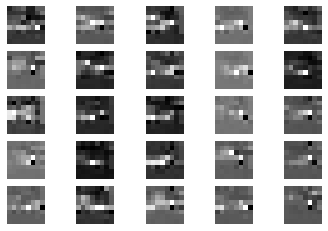

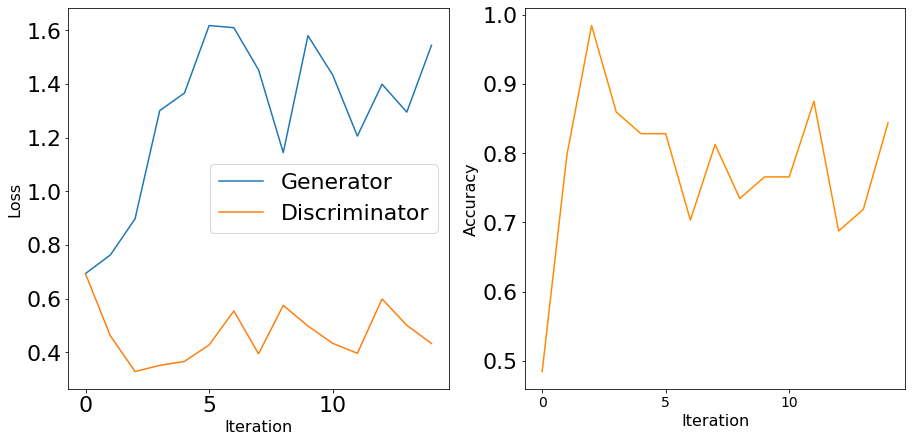

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1401 [D loss: 0.536436, acc.: 70.31%] [G loss: 1.455886]
1402 [D loss: 0.413075, acc.: 79.69%] [G loss: 1.228999]
1403 [D loss: 0.436601, acc.: 78.12%] [G loss: 1.385126]
1404 [D loss: 0.400894, acc.: 79.69%] [G loss: 1.468577]
1405 [D loss: 0.431719, acc.: 79.69%] [G loss: 1.141334]
1406 [D loss: 0.526455, acc.: 75.00%] [G loss: 1.254470]
1407 [D loss: 0.457123, acc.: 75.00%] [G loss: 1.413239]
1408 [D loss: 0.501107, acc.: 67.19%] [G loss: 1.356232]
1409 [D loss: 0.538010, acc.: 68.75%] [G loss: 1.392189]
1410 [D loss: 0.425977, acc.: 81.25%] [G loss: 1.290776]
1411 [D loss: 0.488748, acc.: 76.56%] [G loss: 1.441695]
1412 [D loss: 0.433632, acc.: 76.56%] [G loss: 1.350589]
1413 [D loss: 0.454585, acc.: 75.00%] [G loss: 1.368412]
1414 [D loss: 0.396399, acc.: 81.25%] [G loss: 1.460569]
1415 [D loss: 0.442212, acc.: 79.69%] [G loss: 1.389650]
1416 [D loss: 0.553110, acc.: 73.44%] [G loss: 1.381102]
1417 [D loss: 0.451044, acc.: 79.69%] [G loss: 1.347565]
1418 [D loss: 0.477334, acc.: 7

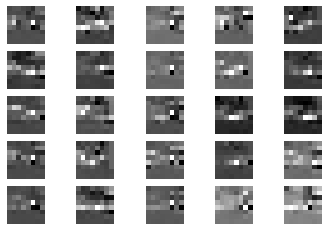

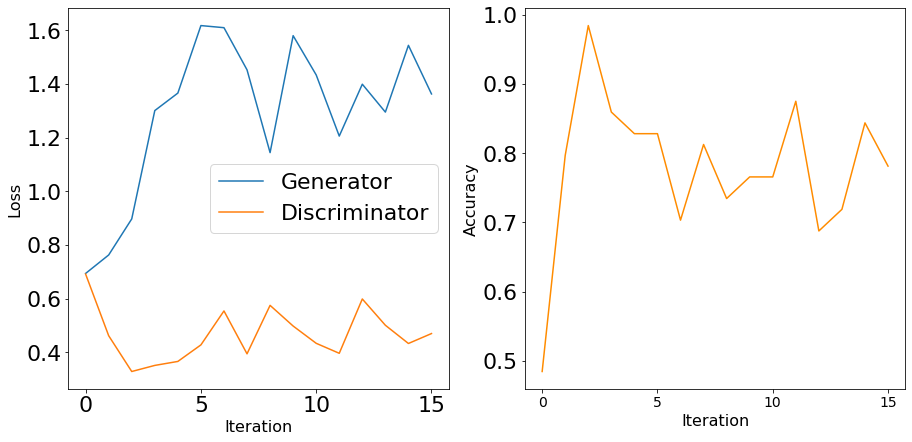

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1501 [D loss: 0.516179, acc.: 70.31%] [G loss: 1.180799]
1502 [D loss: 0.475928, acc.: 82.81%] [G loss: 1.462083]
1503 [D loss: 0.543696, acc.: 73.44%] [G loss: 1.404979]
1504 [D loss: 0.409816, acc.: 84.38%] [G loss: 1.405222]
1505 [D loss: 0.438403, acc.: 78.12%] [G loss: 1.378380]
1506 [D loss: 0.551095, acc.: 70.31%] [G loss: 1.355976]
1507 [D loss: 0.541518, acc.: 70.31%] [G loss: 1.153120]
1508 [D loss: 0.401097, acc.: 82.81%] [G loss: 1.396678]
1509 [D loss: 0.432811, acc.: 85.94%] [G loss: 1.262131]
1510 [D loss: 0.447283, acc.: 85.94%] [G loss: 1.097149]
1511 [D loss: 0.401957, acc.: 82.81%] [G loss: 1.489283]
1512 [D loss: 0.572973, acc.: 68.75%] [G loss: 1.339275]
1513 [D loss: 0.452440, acc.: 79.69%] [G loss: 1.426455]
1514 [D loss: 0.501022, acc.: 75.00%] [G loss: 1.282453]
1515 [D loss: 0.459752, acc.: 81.25%] [G loss: 1.377259]
1516 [D loss: 0.418749, acc.: 81.25%] [G loss: 1.254676]
1517 [D loss: 0.350956, acc.: 92.19%] [G loss: 1.432480]
1518 [D loss: 0.437266, acc.: 8

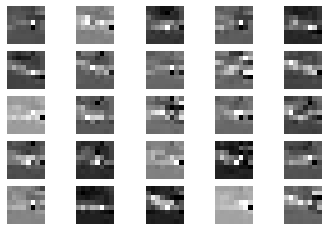

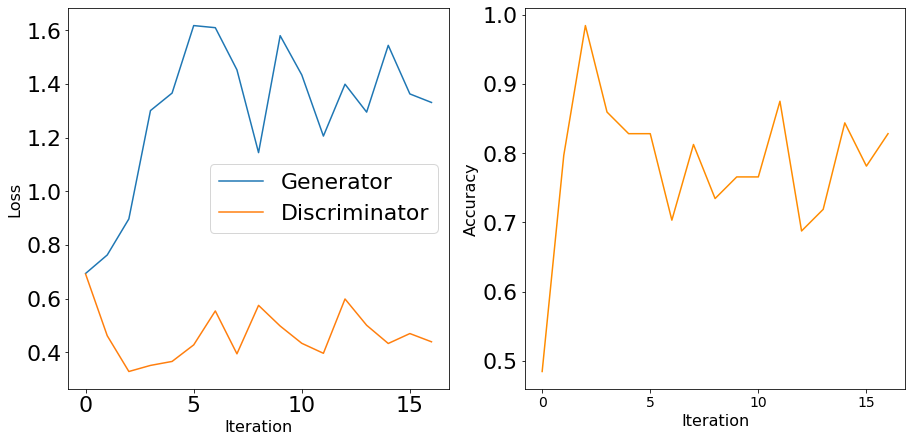

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1601 [D loss: 0.465833, acc.: 75.00%] [G loss: 1.436011]
1602 [D loss: 0.374358, acc.: 89.06%] [G loss: 1.494106]
1603 [D loss: 0.449384, acc.: 78.12%] [G loss: 1.344162]
1604 [D loss: 0.454445, acc.: 78.12%] [G loss: 1.040057]
1605 [D loss: 0.466532, acc.: 81.25%] [G loss: 1.228557]
1606 [D loss: 0.421591, acc.: 84.38%] [G loss: 1.295256]
1607 [D loss: 0.424855, acc.: 82.81%] [G loss: 1.490014]
1608 [D loss: 0.524511, acc.: 73.44%] [G loss: 1.080279]
1609 [D loss: 0.491352, acc.: 78.12%] [G loss: 1.171533]
1610 [D loss: 0.468373, acc.: 76.56%] [G loss: 1.281312]
1611 [D loss: 0.455807, acc.: 82.81%] [G loss: 1.242361]
1612 [D loss: 0.410150, acc.: 78.12%] [G loss: 1.278651]
1613 [D loss: 0.449843, acc.: 84.38%] [G loss: 1.355052]
1614 [D loss: 0.490818, acc.: 78.12%] [G loss: 1.216521]
1615 [D loss: 0.473678, acc.: 73.44%] [G loss: 1.128806]
1616 [D loss: 0.484584, acc.: 79.69%] [G loss: 1.221130]
1617 [D loss: 0.488344, acc.: 82.81%] [G loss: 1.405133]
1618 [D loss: 0.455277, acc.: 7

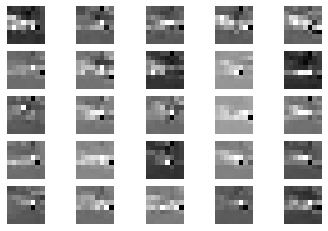

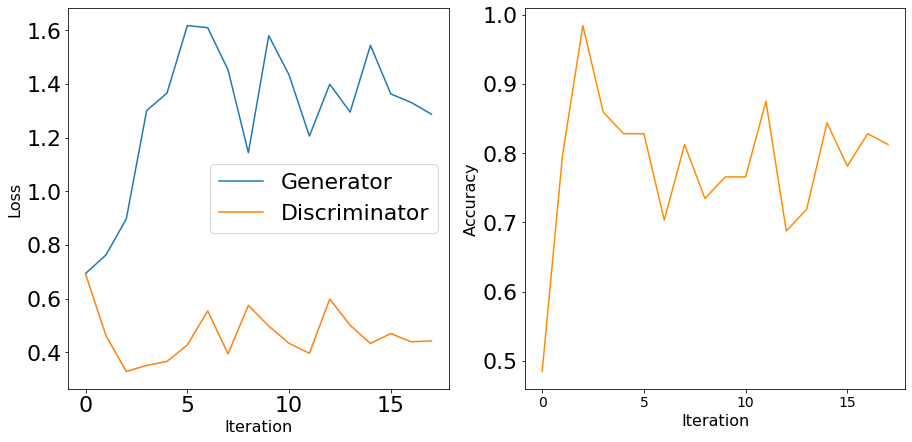

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1701 [D loss: 0.458696, acc.: 81.25%] [G loss: 1.318553]
1702 [D loss: 0.417323, acc.: 79.69%] [G loss: 1.418260]
1703 [D loss: 0.484830, acc.: 76.56%] [G loss: 1.226924]
1704 [D loss: 0.443340, acc.: 76.56%] [G loss: 1.162936]
1705 [D loss: 0.417125, acc.: 76.56%] [G loss: 1.345686]
1706 [D loss: 0.550877, acc.: 71.88%] [G loss: 1.285508]
1707 [D loss: 0.389845, acc.: 82.81%] [G loss: 1.461942]
1708 [D loss: 0.603537, acc.: 65.62%] [G loss: 1.522421]
1709 [D loss: 0.476798, acc.: 76.56%] [G loss: 1.285680]
1710 [D loss: 0.420717, acc.: 84.38%] [G loss: 1.256344]
1711 [D loss: 0.426582, acc.: 79.69%] [G loss: 1.302174]
1712 [D loss: 0.486378, acc.: 71.88%] [G loss: 1.245134]
1713 [D loss: 0.442561, acc.: 84.38%] [G loss: 1.424687]
1714 [D loss: 0.526477, acc.: 76.56%] [G loss: 1.437708]
1715 [D loss: 0.425778, acc.: 84.38%] [G loss: 1.363031]
1716 [D loss: 0.512643, acc.: 78.12%] [G loss: 1.447115]
1717 [D loss: 0.465290, acc.: 79.69%] [G loss: 1.392170]
1718 [D loss: 0.396359, acc.: 8

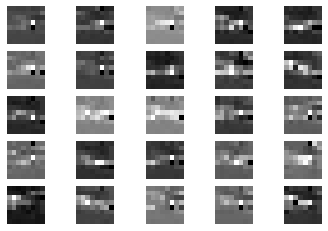

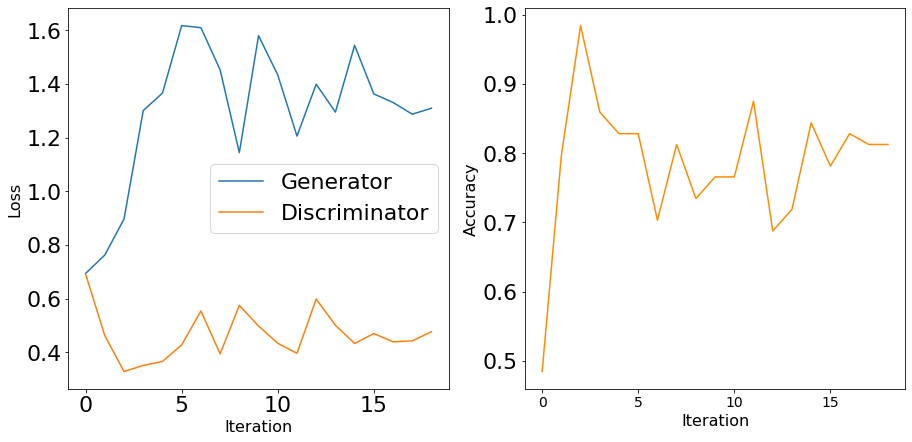

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1801 [D loss: 0.453824, acc.: 78.12%] [G loss: 1.343279]
1802 [D loss: 0.457757, acc.: 75.00%] [G loss: 1.318782]
1803 [D loss: 0.502237, acc.: 79.69%] [G loss: 1.130173]
1804 [D loss: 0.379232, acc.: 85.94%] [G loss: 1.487584]
1805 [D loss: 0.477210, acc.: 78.12%] [G loss: 1.266623]
1806 [D loss: 0.582001, acc.: 76.56%] [G loss: 1.449744]
1807 [D loss: 0.475535, acc.: 81.25%] [G loss: 1.467314]
1808 [D loss: 0.450376, acc.: 76.56%] [G loss: 1.288068]
1809 [D loss: 0.494755, acc.: 71.88%] [G loss: 1.415258]
1810 [D loss: 0.471557, acc.: 79.69%] [G loss: 1.328295]
1811 [D loss: 0.469186, acc.: 79.69%] [G loss: 1.433629]
1812 [D loss: 0.527925, acc.: 70.31%] [G loss: 1.170827]
1813 [D loss: 0.491579, acc.: 76.56%] [G loss: 1.462407]
1814 [D loss: 0.554527, acc.: 68.75%] [G loss: 1.213224]
1815 [D loss: 0.542185, acc.: 75.00%] [G loss: 1.405193]
1816 [D loss: 0.461720, acc.: 81.25%] [G loss: 1.336009]
1817 [D loss: 0.537833, acc.: 68.75%] [G loss: 1.330253]
1818 [D loss: 0.454987, acc.: 7

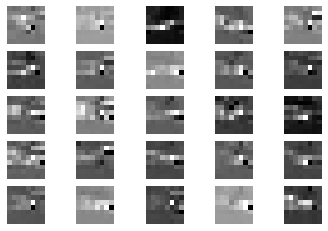

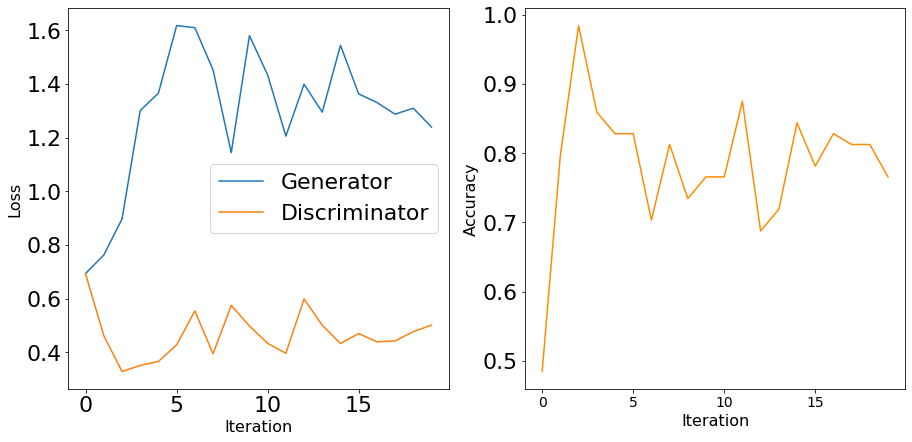

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1901 [D loss: 0.414417, acc.: 84.38%] [G loss: 1.231349]
1902 [D loss: 0.303499, acc.: 89.06%] [G loss: 1.193017]
1903 [D loss: 0.452876, acc.: 81.25%] [G loss: 1.302073]
1904 [D loss: 0.434006, acc.: 76.56%] [G loss: 1.373937]
1905 [D loss: 0.512394, acc.: 73.44%] [G loss: 1.351335]
1906 [D loss: 0.457381, acc.: 76.56%] [G loss: 1.277500]
1907 [D loss: 0.520206, acc.: 76.56%] [G loss: 1.570643]
1908 [D loss: 0.460996, acc.: 75.00%] [G loss: 1.298262]
1909 [D loss: 0.497622, acc.: 70.31%] [G loss: 1.293501]
1910 [D loss: 0.422823, acc.: 82.81%] [G loss: 1.437731]
1911 [D loss: 0.592171, acc.: 70.31%] [G loss: 1.354268]
1912 [D loss: 0.396916, acc.: 87.50%] [G loss: 1.298979]
1913 [D loss: 0.549232, acc.: 73.44%] [G loss: 1.415441]
1914 [D loss: 0.543349, acc.: 73.44%] [G loss: 1.312742]
1915 [D loss: 0.481888, acc.: 76.56%] [G loss: 1.250129]
1916 [D loss: 0.408131, acc.: 82.81%] [G loss: 1.299047]
1917 [D loss: 0.428299, acc.: 78.12%] [G loss: 1.235359]
1918 [D loss: 0.475944, acc.: 7

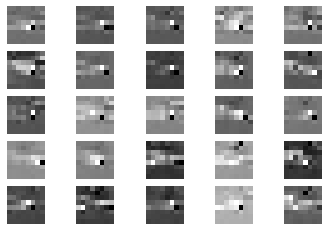

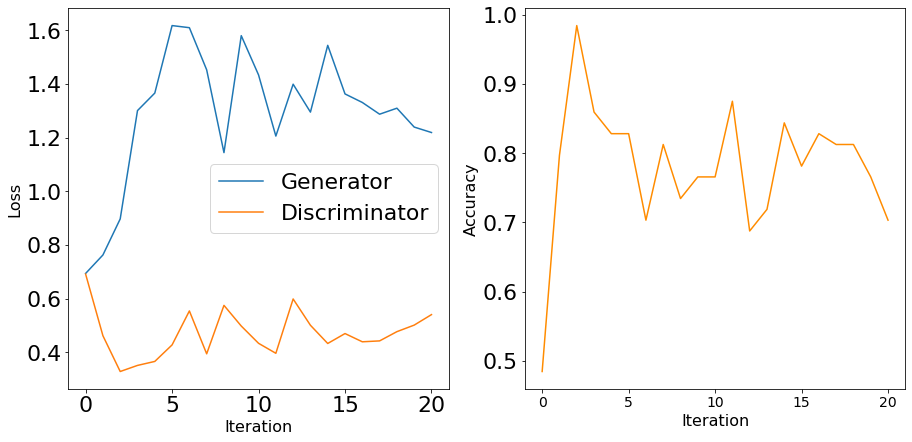

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2001 [D loss: 0.461779, acc.: 78.12%] [G loss: 1.202271]
2002 [D loss: 0.439930, acc.: 79.69%] [G loss: 1.317720]
2003 [D loss: 0.512388, acc.: 75.00%] [G loss: 1.383195]
2004 [D loss: 0.485241, acc.: 73.44%] [G loss: 1.301648]
2005 [D loss: 0.539911, acc.: 64.06%] [G loss: 1.328741]
2006 [D loss: 0.450504, acc.: 78.12%] [G loss: 1.270629]
2007 [D loss: 0.441430, acc.: 78.12%] [G loss: 1.691865]
2008 [D loss: 0.560243, acc.: 68.75%] [G loss: 1.159517]
2009 [D loss: 0.462625, acc.: 73.44%] [G loss: 1.557738]
2010 [D loss: 0.450707, acc.: 81.25%] [G loss: 1.288101]
2011 [D loss: 0.553465, acc.: 75.00%] [G loss: 1.321393]
2012 [D loss: 0.548635, acc.: 68.75%] [G loss: 1.268505]
2013 [D loss: 0.500220, acc.: 75.00%] [G loss: 1.210304]
2014 [D loss: 0.475856, acc.: 71.88%] [G loss: 1.131352]
2015 [D loss: 0.621842, acc.: 59.38%] [G loss: 1.379721]
2016 [D loss: 0.508063, acc.: 73.44%] [G loss: 1.333258]
2017 [D loss: 0.488139, acc.: 75.00%] [G loss: 1.275814]
2018 [D loss: 0.381449, acc.: 8

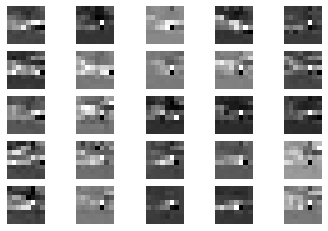

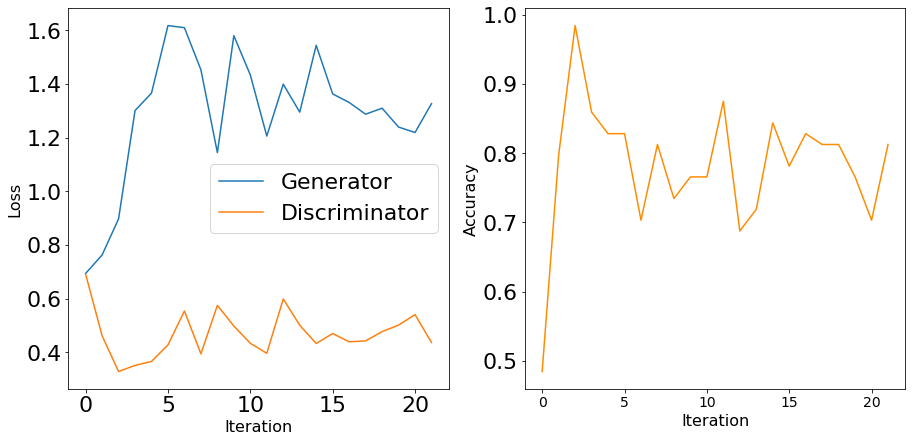

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2101 [D loss: 0.604973, acc.: 64.06%] [G loss: 1.367190]
2102 [D loss: 0.453210, acc.: 84.38%] [G loss: 1.242777]
2103 [D loss: 0.485996, acc.: 73.44%] [G loss: 1.306966]
2104 [D loss: 0.533557, acc.: 76.56%] [G loss: 1.411971]
2105 [D loss: 0.520294, acc.: 79.69%] [G loss: 1.423349]
2106 [D loss: 0.528834, acc.: 71.88%] [G loss: 1.087890]
2107 [D loss: 0.491914, acc.: 73.44%] [G loss: 1.362164]
2108 [D loss: 0.438488, acc.: 78.12%] [G loss: 1.258866]
2109 [D loss: 0.459650, acc.: 76.56%] [G loss: 1.321968]
2110 [D loss: 0.432298, acc.: 84.38%] [G loss: 1.233952]
2111 [D loss: 0.518903, acc.: 71.88%] [G loss: 1.357565]
2112 [D loss: 0.455900, acc.: 76.56%] [G loss: 1.423185]
2113 [D loss: 0.544154, acc.: 70.31%] [G loss: 1.221998]
2114 [D loss: 0.578183, acc.: 75.00%] [G loss: 1.337622]
2115 [D loss: 0.416375, acc.: 82.81%] [G loss: 1.583632]
2116 [D loss: 0.580872, acc.: 60.94%] [G loss: 1.362220]
2117 [D loss: 0.519376, acc.: 70.31%] [G loss: 1.474752]
2118 [D loss: 0.566592, acc.: 7

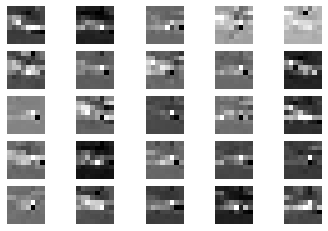

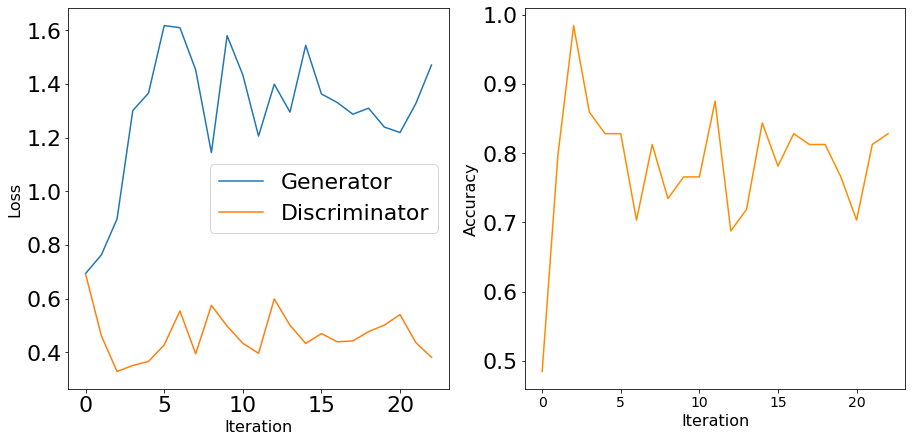

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2201 [D loss: 0.483647, acc.: 81.25%] [G loss: 1.102399]
2202 [D loss: 0.532743, acc.: 71.88%] [G loss: 1.247662]
2203 [D loss: 0.507231, acc.: 71.88%] [G loss: 1.384509]
2204 [D loss: 0.501760, acc.: 68.75%] [G loss: 1.117420]
2205 [D loss: 0.502145, acc.: 81.25%] [G loss: 1.396625]
2206 [D loss: 0.456140, acc.: 81.25%] [G loss: 1.193153]
2207 [D loss: 0.501030, acc.: 78.12%] [G loss: 1.302711]
2208 [D loss: 0.441217, acc.: 81.25%] [G loss: 1.317909]
2209 [D loss: 0.472477, acc.: 76.56%] [G loss: 1.338443]
2210 [D loss: 0.640486, acc.: 64.06%] [G loss: 1.414025]
2211 [D loss: 0.505509, acc.: 70.31%] [G loss: 1.103518]
2212 [D loss: 0.373347, acc.: 84.38%] [G loss: 1.327554]
2213 [D loss: 0.500440, acc.: 71.88%] [G loss: 1.252965]
2214 [D loss: 0.469246, acc.: 81.25%] [G loss: 1.351440]
2215 [D loss: 0.524806, acc.: 76.56%] [G loss: 1.334800]
2216 [D loss: 0.407016, acc.: 84.38%] [G loss: 1.277602]
2217 [D loss: 0.491639, acc.: 70.31%] [G loss: 1.302741]
2218 [D loss: 0.485052, acc.: 7

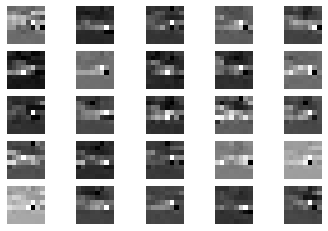

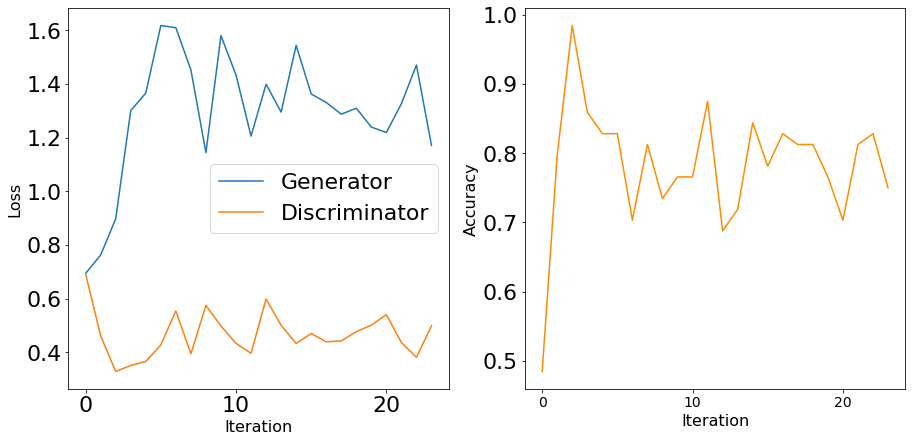

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2301 [D loss: 0.423427, acc.: 79.69%] [G loss: 1.298818]
2302 [D loss: 0.428453, acc.: 76.56%] [G loss: 1.474159]
2303 [D loss: 0.366833, acc.: 82.81%] [G loss: 1.251163]
2304 [D loss: 0.490354, acc.: 73.44%] [G loss: 1.372441]
2305 [D loss: 0.380783, acc.: 90.62%] [G loss: 1.497056]
2306 [D loss: 0.573785, acc.: 78.12%] [G loss: 1.191129]
2307 [D loss: 0.476041, acc.: 78.12%] [G loss: 1.544242]
2308 [D loss: 0.462370, acc.: 78.12%] [G loss: 1.591636]
2309 [D loss: 0.414207, acc.: 78.12%] [G loss: 1.216857]
2310 [D loss: 0.397398, acc.: 79.69%] [G loss: 1.586738]
2311 [D loss: 0.468423, acc.: 82.81%] [G loss: 1.425449]
2312 [D loss: 0.410793, acc.: 81.25%] [G loss: 1.201224]
2313 [D loss: 0.436334, acc.: 81.25%] [G loss: 1.381440]
2314 [D loss: 0.463718, acc.: 78.12%] [G loss: 1.449007]
2315 [D loss: 0.537518, acc.: 73.44%] [G loss: 1.366540]
2316 [D loss: 0.429447, acc.: 79.69%] [G loss: 1.299949]
2317 [D loss: 0.487577, acc.: 79.69%] [G loss: 1.236604]
2318 [D loss: 0.467495, acc.: 7

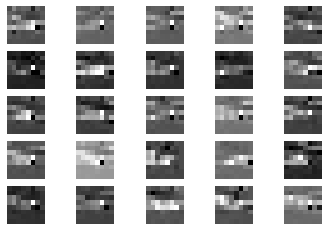

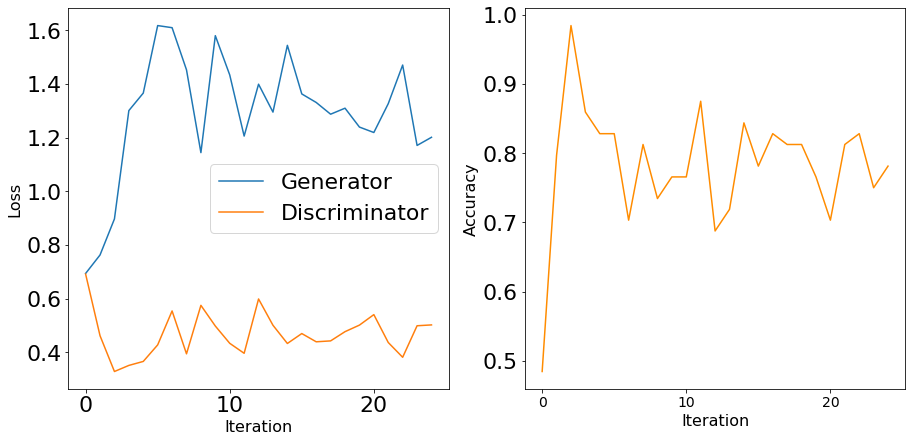

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2401 [D loss: 0.694180, acc.: 68.75%] [G loss: 1.330233]
2402 [D loss: 0.530072, acc.: 68.75%] [G loss: 1.334827]
2403 [D loss: 0.624591, acc.: 71.88%] [G loss: 1.191267]
2404 [D loss: 0.414443, acc.: 84.38%] [G loss: 1.186416]
2405 [D loss: 0.459338, acc.: 82.81%] [G loss: 1.396611]
2406 [D loss: 0.574642, acc.: 73.44%] [G loss: 1.008586]
2407 [D loss: 0.369695, acc.: 85.94%] [G loss: 1.258135]
2408 [D loss: 0.464635, acc.: 71.88%] [G loss: 1.405439]
2409 [D loss: 0.467338, acc.: 78.12%] [G loss: 1.288460]
2410 [D loss: 0.469343, acc.: 76.56%] [G loss: 1.356019]
2411 [D loss: 0.467400, acc.: 76.56%] [G loss: 1.329194]
2412 [D loss: 0.546492, acc.: 73.44%] [G loss: 1.179770]
2413 [D loss: 0.416173, acc.: 81.25%] [G loss: 1.450866]
2414 [D loss: 0.646721, acc.: 70.31%] [G loss: 1.270539]
2415 [D loss: 0.527386, acc.: 70.31%] [G loss: 1.443768]
2416 [D loss: 0.493539, acc.: 78.12%] [G loss: 1.571553]
2417 [D loss: 0.413419, acc.: 85.94%] [G loss: 1.380082]
2418 [D loss: 0.400070, acc.: 8

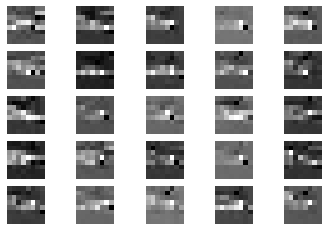

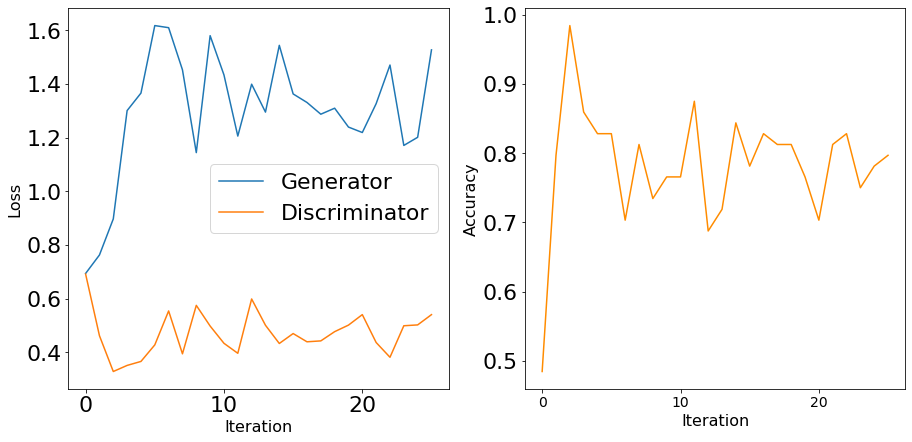

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2501 [D loss: 0.546937, acc.: 71.88%] [G loss: 1.146587]
2502 [D loss: 0.502933, acc.: 78.12%] [G loss: 1.269345]
2503 [D loss: 0.607289, acc.: 57.81%] [G loss: 1.338277]
2504 [D loss: 0.365838, acc.: 89.06%] [G loss: 1.344991]
2505 [D loss: 0.470085, acc.: 79.69%] [G loss: 1.259005]
2506 [D loss: 0.562684, acc.: 71.88%] [G loss: 1.273310]
2507 [D loss: 0.559395, acc.: 68.75%] [G loss: 1.316858]
2508 [D loss: 0.489025, acc.: 73.44%] [G loss: 1.222612]
2509 [D loss: 0.513448, acc.: 73.44%] [G loss: 1.208183]
2510 [D loss: 0.441204, acc.: 76.56%] [G loss: 1.381047]
2511 [D loss: 0.536049, acc.: 68.75%] [G loss: 1.202637]
2512 [D loss: 0.459740, acc.: 81.25%] [G loss: 1.275397]
2513 [D loss: 0.515779, acc.: 76.56%] [G loss: 1.291157]
2514 [D loss: 0.607066, acc.: 65.62%] [G loss: 1.218819]
2515 [D loss: 0.527387, acc.: 81.25%] [G loss: 1.317161]
2516 [D loss: 0.456636, acc.: 76.56%] [G loss: 1.344215]
2517 [D loss: 0.536206, acc.: 70.31%] [G loss: 1.348986]
2518 [D loss: 0.490499, acc.: 8

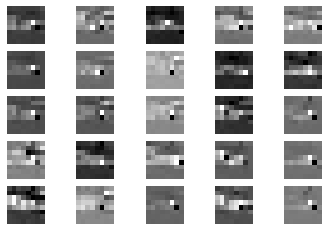

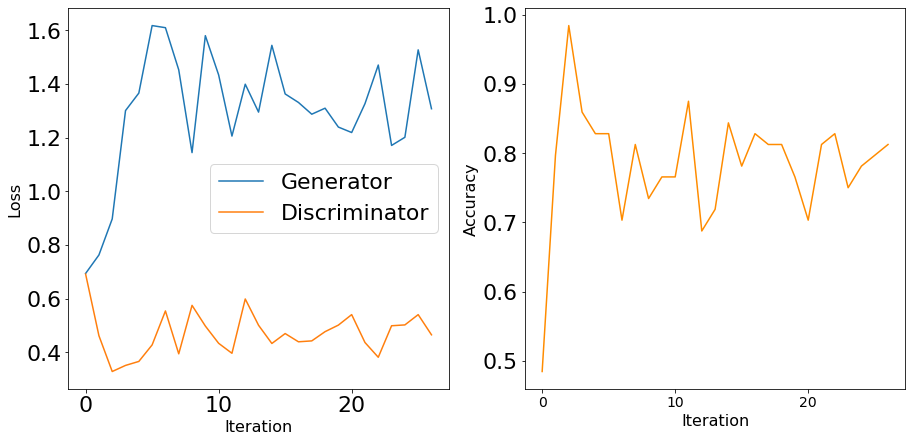

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2601 [D loss: 0.569286, acc.: 67.19%] [G loss: 1.218085]
2602 [D loss: 0.448154, acc.: 78.12%] [G loss: 1.198628]
2603 [D loss: 0.595797, acc.: 70.31%] [G loss: 1.358985]
2604 [D loss: 0.474849, acc.: 75.00%] [G loss: 1.237197]
2605 [D loss: 0.547272, acc.: 71.88%] [G loss: 1.378716]
2606 [D loss: 0.514930, acc.: 75.00%] [G loss: 1.394157]
2607 [D loss: 0.417851, acc.: 82.81%] [G loss: 1.330115]
2608 [D loss: 0.383128, acc.: 85.94%] [G loss: 1.273965]
2609 [D loss: 0.603215, acc.: 71.88%] [G loss: 1.132967]
2610 [D loss: 0.475044, acc.: 76.56%] [G loss: 1.258468]
2611 [D loss: 0.413390, acc.: 84.38%] [G loss: 1.517998]
2612 [D loss: 0.520838, acc.: 78.12%] [G loss: 1.260019]
2613 [D loss: 0.522031, acc.: 75.00%] [G loss: 1.518504]
2614 [D loss: 0.574403, acc.: 68.75%] [G loss: 1.438025]
2615 [D loss: 0.511570, acc.: 76.56%] [G loss: 1.145620]
2616 [D loss: 0.584962, acc.: 70.31%] [G loss: 1.217213]
2617 [D loss: 0.586570, acc.: 75.00%] [G loss: 1.172245]
2618 [D loss: 0.537840, acc.: 7

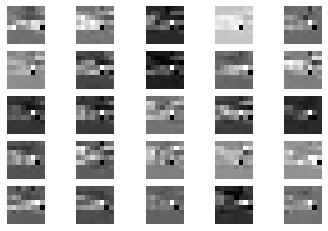

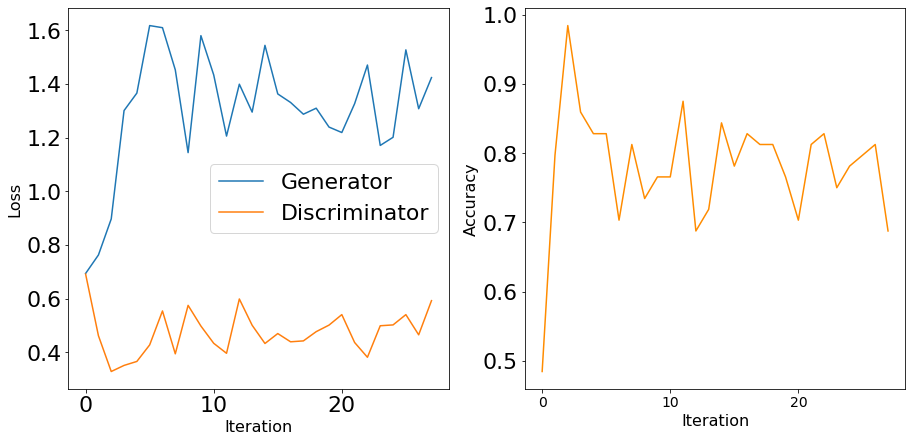

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2701 [D loss: 0.494763, acc.: 75.00%] [G loss: 1.256458]
2702 [D loss: 0.405026, acc.: 85.94%] [G loss: 1.320889]
2703 [D loss: 0.547728, acc.: 68.75%] [G loss: 1.164988]
2704 [D loss: 0.520866, acc.: 79.69%] [G loss: 1.224654]
2705 [D loss: 0.518729, acc.: 76.56%] [G loss: 1.294342]
2706 [D loss: 0.534796, acc.: 73.44%] [G loss: 1.353452]
2707 [D loss: 0.451452, acc.: 73.44%] [G loss: 1.505300]
2708 [D loss: 0.515699, acc.: 75.00%] [G loss: 1.420963]
2709 [D loss: 0.538196, acc.: 79.69%] [G loss: 1.440893]
2710 [D loss: 0.503495, acc.: 78.12%] [G loss: 1.202294]
2711 [D loss: 0.429869, acc.: 84.38%] [G loss: 1.295180]
2712 [D loss: 0.539036, acc.: 67.19%] [G loss: 1.218946]
2713 [D loss: 0.610104, acc.: 68.75%] [G loss: 1.071433]
2714 [D loss: 0.428357, acc.: 81.25%] [G loss: 1.291535]
2715 [D loss: 0.386815, acc.: 82.81%] [G loss: 1.352730]
2716 [D loss: 0.522137, acc.: 73.44%] [G loss: 1.576672]
2717 [D loss: 0.481635, acc.: 78.12%] [G loss: 1.477736]
2718 [D loss: 0.439901, acc.: 8

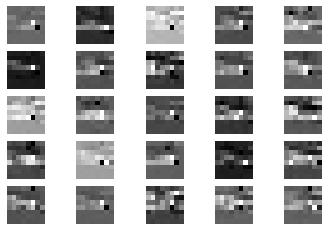

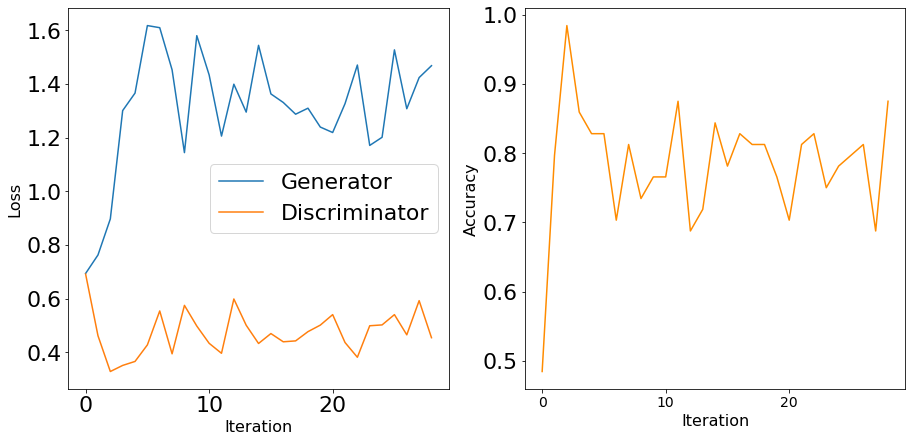

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2801 [D loss: 0.473905, acc.: 76.56%] [G loss: 1.277249]
2802 [D loss: 0.526239, acc.: 68.75%] [G loss: 1.291609]
2803 [D loss: 0.509738, acc.: 76.56%] [G loss: 1.319539]
2804 [D loss: 0.499983, acc.: 71.88%] [G loss: 1.457906]
2805 [D loss: 0.478407, acc.: 78.12%] [G loss: 1.212107]
2806 [D loss: 0.470307, acc.: 76.56%] [G loss: 1.306896]
2807 [D loss: 0.502024, acc.: 68.75%] [G loss: 1.233853]
2808 [D loss: 0.488194, acc.: 76.56%] [G loss: 1.190112]
2809 [D loss: 0.624456, acc.: 65.62%] [G loss: 1.293916]
2810 [D loss: 0.465968, acc.: 78.12%] [G loss: 1.369211]
2811 [D loss: 0.530286, acc.: 73.44%] [G loss: 1.246766]
2812 [D loss: 0.395444, acc.: 84.38%] [G loss: 1.199804]
2813 [D loss: 0.495105, acc.: 67.19%] [G loss: 1.270367]
2814 [D loss: 0.446265, acc.: 81.25%] [G loss: 1.391384]
2815 [D loss: 0.471068, acc.: 73.44%] [G loss: 1.230476]
2816 [D loss: 0.517411, acc.: 79.69%] [G loss: 1.315311]
2817 [D loss: 0.526388, acc.: 71.88%] [G loss: 1.174107]
2818 [D loss: 0.501132, acc.: 7

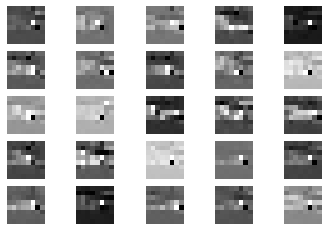

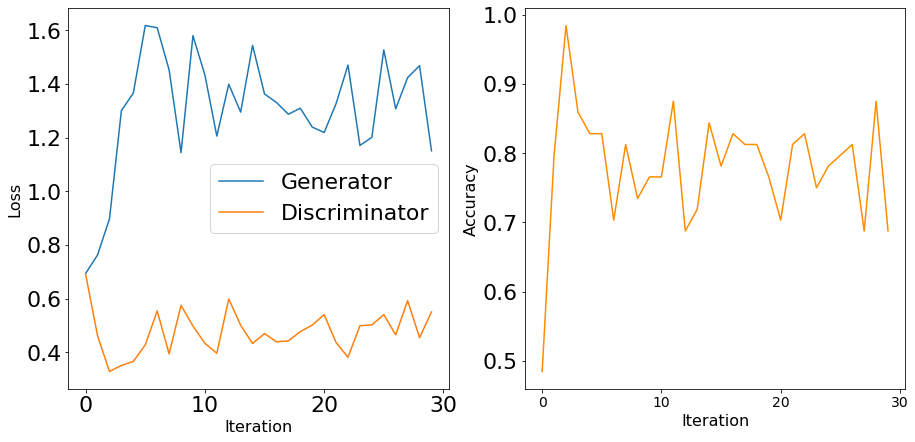

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


2901 [D loss: 0.453989, acc.: 75.00%] [G loss: 1.294612]
2902 [D loss: 0.475017, acc.: 79.69%] [G loss: 1.370494]
2903 [D loss: 0.590489, acc.: 70.31%] [G loss: 1.362843]
2904 [D loss: 0.571605, acc.: 70.31%] [G loss: 1.274549]
2905 [D loss: 0.472379, acc.: 79.69%] [G loss: 1.408395]
2906 [D loss: 0.476697, acc.: 75.00%] [G loss: 1.354499]
2907 [D loss: 0.550134, acc.: 75.00%] [G loss: 1.398474]
2908 [D loss: 0.519971, acc.: 68.75%] [G loss: 1.137251]
2909 [D loss: 0.520789, acc.: 78.12%] [G loss: 0.948442]
2910 [D loss: 0.542908, acc.: 70.31%] [G loss: 1.042090]
2911 [D loss: 0.503232, acc.: 68.75%] [G loss: 1.324769]
2912 [D loss: 0.491805, acc.: 75.00%] [G loss: 1.530035]
2913 [D loss: 0.561199, acc.: 65.62%] [G loss: 1.305680]
2914 [D loss: 0.474853, acc.: 78.12%] [G loss: 1.203212]
2915 [D loss: 0.431595, acc.: 84.38%] [G loss: 1.217382]
2916 [D loss: 0.569865, acc.: 75.00%] [G loss: 1.393764]
2917 [D loss: 0.465063, acc.: 73.44%] [G loss: 1.148223]
2918 [D loss: 0.447308, acc.: 8

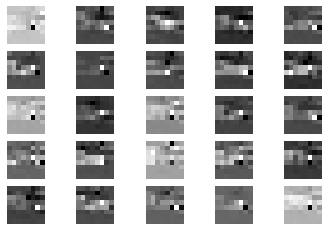

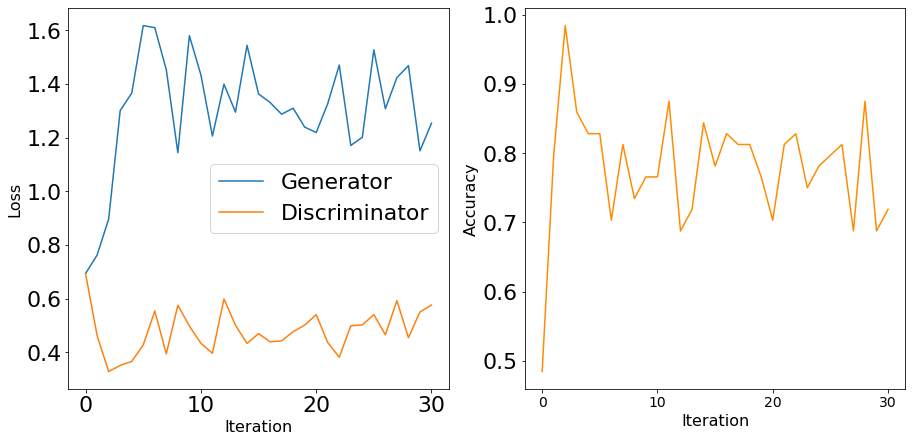

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3001 [D loss: 0.498419, acc.: 68.75%] [G loss: 1.167089]
3002 [D loss: 0.630747, acc.: 75.00%] [G loss: 1.087541]
3003 [D loss: 0.445273, acc.: 79.69%] [G loss: 1.218053]
3004 [D loss: 0.579292, acc.: 70.31%] [G loss: 1.139505]
3005 [D loss: 0.562821, acc.: 71.88%] [G loss: 1.104628]
3006 [D loss: 0.551374, acc.: 70.31%] [G loss: 1.473547]
3007 [D loss: 0.524451, acc.: 70.31%] [G loss: 1.228742]
3008 [D loss: 0.469148, acc.: 75.00%] [G loss: 1.476263]
3009 [D loss: 0.457840, acc.: 78.12%] [G loss: 1.513403]
3010 [D loss: 0.522631, acc.: 71.88%] [G loss: 1.246456]
3011 [D loss: 0.492993, acc.: 70.31%] [G loss: 1.362507]
3012 [D loss: 0.567820, acc.: 70.31%] [G loss: 1.408237]
3013 [D loss: 0.548995, acc.: 70.31%] [G loss: 1.275007]
3014 [D loss: 0.416979, acc.: 84.38%] [G loss: 1.476961]
3015 [D loss: 0.429662, acc.: 81.25%] [G loss: 1.480247]
3016 [D loss: 0.547327, acc.: 71.88%] [G loss: 1.134266]
3017 [D loss: 0.506057, acc.: 73.44%] [G loss: 1.139797]
3018 [D loss: 0.513183, acc.: 7

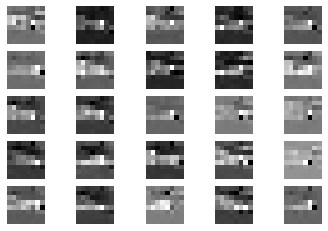

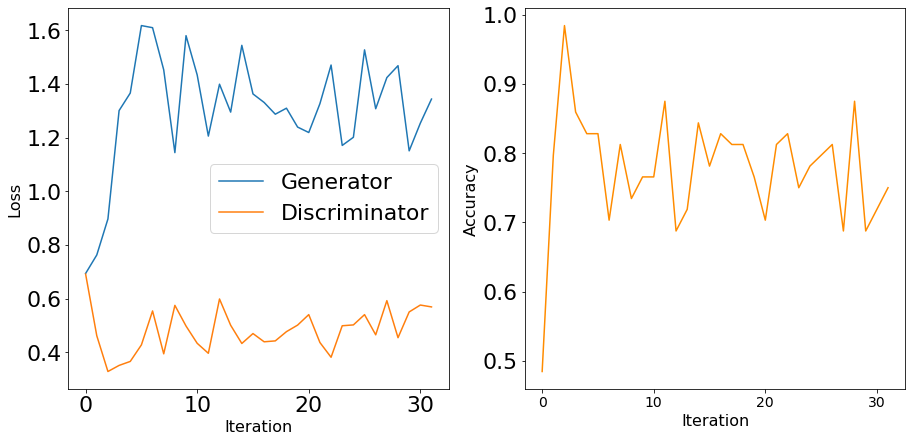

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3101 [D loss: 0.421278, acc.: 84.38%] [G loss: 1.246143]
3102 [D loss: 0.514076, acc.: 76.56%] [G loss: 1.092528]
3103 [D loss: 0.548402, acc.: 70.31%] [G loss: 1.241458]
3104 [D loss: 0.528533, acc.: 76.56%] [G loss: 1.298821]
3105 [D loss: 0.426941, acc.: 84.38%] [G loss: 1.187077]
3106 [D loss: 0.548268, acc.: 68.75%] [G loss: 1.301832]
3107 [D loss: 0.443978, acc.: 84.38%] [G loss: 1.187507]
3108 [D loss: 0.465081, acc.: 79.69%] [G loss: 1.286257]
3109 [D loss: 0.499835, acc.: 78.12%] [G loss: 1.242320]
3110 [D loss: 0.537142, acc.: 73.44%] [G loss: 1.227427]
3111 [D loss: 0.542299, acc.: 71.88%] [G loss: 1.367097]
3112 [D loss: 0.546486, acc.: 73.44%] [G loss: 1.408337]
3113 [D loss: 0.451809, acc.: 81.25%] [G loss: 1.137361]
3114 [D loss: 0.484601, acc.: 78.12%] [G loss: 1.312196]
3115 [D loss: 0.549452, acc.: 73.44%] [G loss: 1.314618]
3116 [D loss: 0.479615, acc.: 75.00%] [G loss: 1.280328]
3117 [D loss: 0.492035, acc.: 81.25%] [G loss: 1.398523]
3118 [D loss: 0.542340, acc.: 7

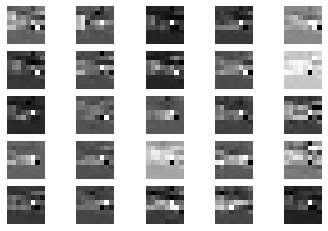

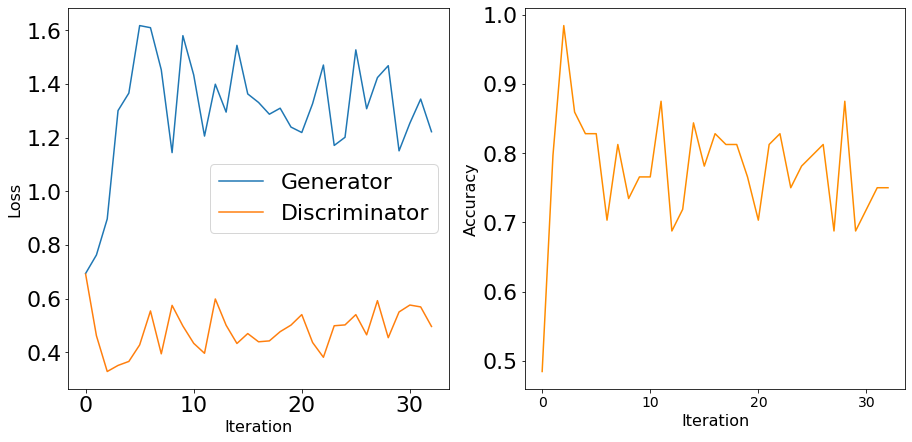

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3201 [D loss: 0.426534, acc.: 79.69%] [G loss: 1.225935]
3202 [D loss: 0.447518, acc.: 79.69%] [G loss: 1.129408]
3203 [D loss: 0.537709, acc.: 71.88%] [G loss: 1.442554]
3204 [D loss: 0.534396, acc.: 70.31%] [G loss: 1.389627]
3205 [D loss: 0.608930, acc.: 75.00%] [G loss: 1.341248]
3206 [D loss: 0.559887, acc.: 67.19%] [G loss: 1.363863]
3207 [D loss: 0.525563, acc.: 70.31%] [G loss: 1.420413]
3208 [D loss: 0.516858, acc.: 70.31%] [G loss: 1.157454]
3209 [D loss: 0.413043, acc.: 82.81%] [G loss: 1.546469]
3210 [D loss: 0.621577, acc.: 65.62%] [G loss: 1.229644]
3211 [D loss: 0.589344, acc.: 67.19%] [G loss: 1.203068]
3212 [D loss: 0.567102, acc.: 64.06%] [G loss: 1.156119]
3213 [D loss: 0.539173, acc.: 75.00%] [G loss: 1.048678]
3214 [D loss: 0.400219, acc.: 82.81%] [G loss: 1.497208]
3215 [D loss: 0.541822, acc.: 70.31%] [G loss: 1.545186]
3216 [D loss: 0.551641, acc.: 73.44%] [G loss: 1.209524]
3217 [D loss: 0.494451, acc.: 78.12%] [G loss: 1.209279]
3218 [D loss: 0.604181, acc.: 7

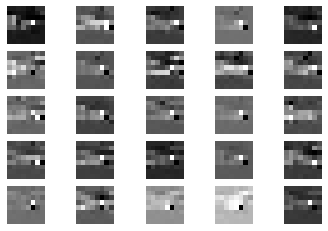

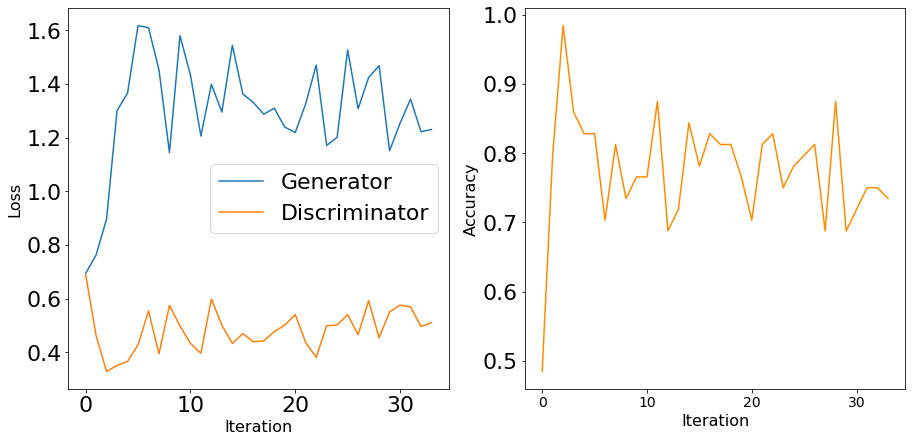

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3301 [D loss: 0.507667, acc.: 79.69%] [G loss: 1.093644]
3302 [D loss: 0.501009, acc.: 76.56%] [G loss: 1.182930]
3303 [D loss: 0.660732, acc.: 67.19%] [G loss: 1.164115]
3304 [D loss: 0.578411, acc.: 67.19%] [G loss: 1.359388]
3305 [D loss: 0.493299, acc.: 76.56%] [G loss: 0.979336]
3306 [D loss: 0.460153, acc.: 79.69%] [G loss: 1.328684]
3307 [D loss: 0.591457, acc.: 70.31%] [G loss: 1.182674]
3308 [D loss: 0.485440, acc.: 78.12%] [G loss: 1.017741]
3309 [D loss: 0.526880, acc.: 81.25%] [G loss: 1.113968]
3310 [D loss: 0.457155, acc.: 78.12%] [G loss: 1.279755]
3311 [D loss: 0.511336, acc.: 73.44%] [G loss: 1.405685]
3312 [D loss: 0.445782, acc.: 81.25%] [G loss: 1.475344]
3313 [D loss: 0.450404, acc.: 78.12%] [G loss: 1.309332]
3314 [D loss: 0.545143, acc.: 71.88%] [G loss: 1.279572]
3315 [D loss: 0.498831, acc.: 73.44%] [G loss: 1.161437]
3316 [D loss: 0.493783, acc.: 71.88%] [G loss: 1.303347]
3317 [D loss: 0.538871, acc.: 76.56%] [G loss: 1.415318]
3318 [D loss: 0.497950, acc.: 7

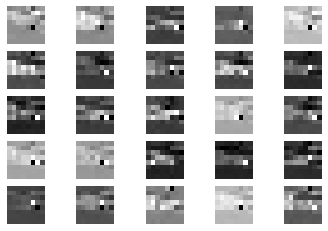

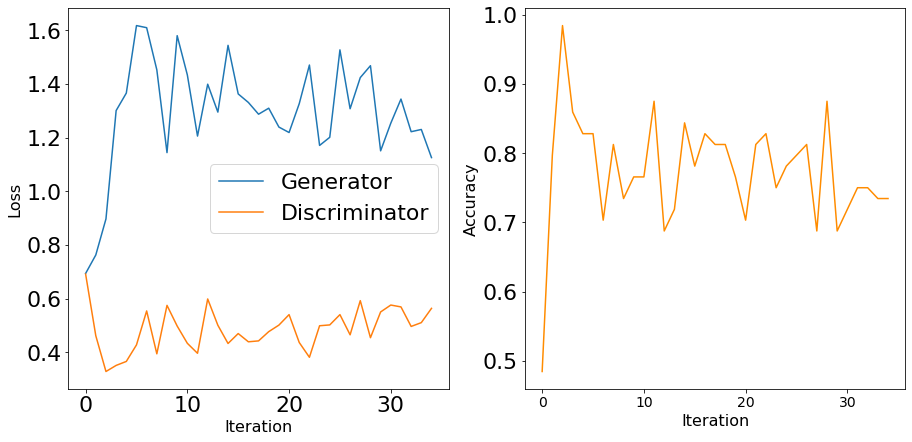

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3401 [D loss: 0.542295, acc.: 73.44%] [G loss: 1.106154]
3402 [D loss: 0.525455, acc.: 73.44%] [G loss: 1.176831]
3403 [D loss: 0.565674, acc.: 67.19%] [G loss: 1.111501]
3404 [D loss: 0.496318, acc.: 79.69%] [G loss: 1.184861]
3405 [D loss: 0.418631, acc.: 82.81%] [G loss: 1.125827]
3406 [D loss: 0.545661, acc.: 76.56%] [G loss: 1.489793]
3407 [D loss: 0.579387, acc.: 68.75%] [G loss: 1.314130]
3408 [D loss: 0.562349, acc.: 64.06%] [G loss: 1.303939]
3409 [D loss: 0.510360, acc.: 73.44%] [G loss: 1.168384]
3410 [D loss: 0.482180, acc.: 75.00%] [G loss: 1.465856]
3411 [D loss: 0.518574, acc.: 79.69%] [G loss: 1.383138]
3412 [D loss: 0.514640, acc.: 73.44%] [G loss: 1.144276]
3413 [D loss: 0.525711, acc.: 73.44%] [G loss: 1.390531]
3414 [D loss: 0.487140, acc.: 79.69%] [G loss: 1.249176]
3415 [D loss: 0.596029, acc.: 67.19%] [G loss: 1.283270]
3416 [D loss: 0.548644, acc.: 78.12%] [G loss: 1.421812]
3417 [D loss: 0.610259, acc.: 71.88%] [G loss: 1.132896]
3418 [D loss: 0.487653, acc.: 7

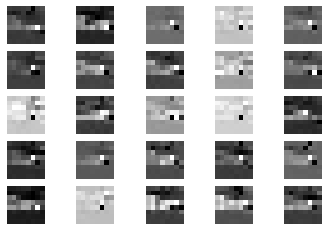

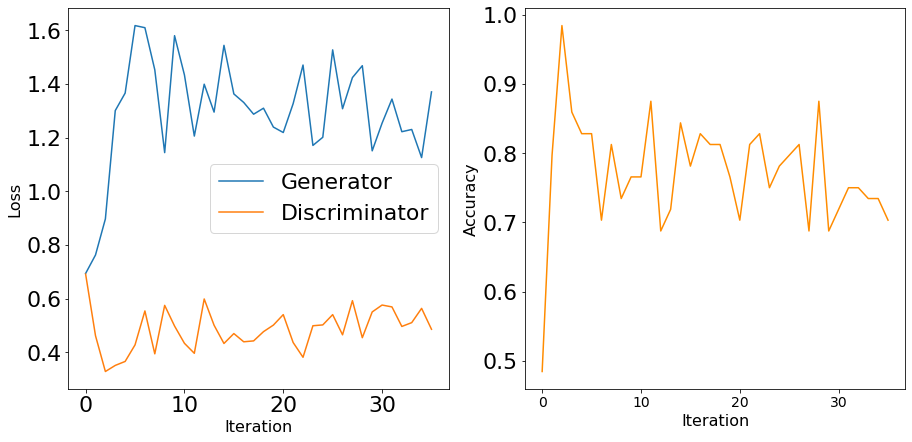

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3501 [D loss: 0.583613, acc.: 65.62%] [G loss: 0.953074]
3502 [D loss: 0.612549, acc.: 68.75%] [G loss: 1.303416]
3503 [D loss: 0.498056, acc.: 71.88%] [G loss: 1.115215]
3504 [D loss: 0.511957, acc.: 73.44%] [G loss: 1.216693]
3505 [D loss: 0.505598, acc.: 70.31%] [G loss: 1.170561]
3506 [D loss: 0.493856, acc.: 81.25%] [G loss: 1.184750]
3507 [D loss: 0.565902, acc.: 68.75%] [G loss: 1.167407]
3508 [D loss: 0.395832, acc.: 87.50%] [G loss: 1.038932]
3509 [D loss: 0.505137, acc.: 75.00%] [G loss: 1.090380]
3510 [D loss: 0.502675, acc.: 78.12%] [G loss: 1.333780]
3511 [D loss: 0.513107, acc.: 68.75%] [G loss: 1.091644]
3512 [D loss: 0.556726, acc.: 79.69%] [G loss: 1.351895]
3513 [D loss: 0.571021, acc.: 68.75%] [G loss: 1.092020]
3514 [D loss: 0.487453, acc.: 81.25%] [G loss: 0.942860]
3515 [D loss: 0.525099, acc.: 76.56%] [G loss: 1.081727]
3516 [D loss: 0.599408, acc.: 57.81%] [G loss: 1.201272]
3517 [D loss: 0.633561, acc.: 64.06%] [G loss: 1.240875]
3518 [D loss: 0.480474, acc.: 7

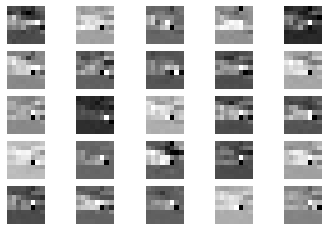

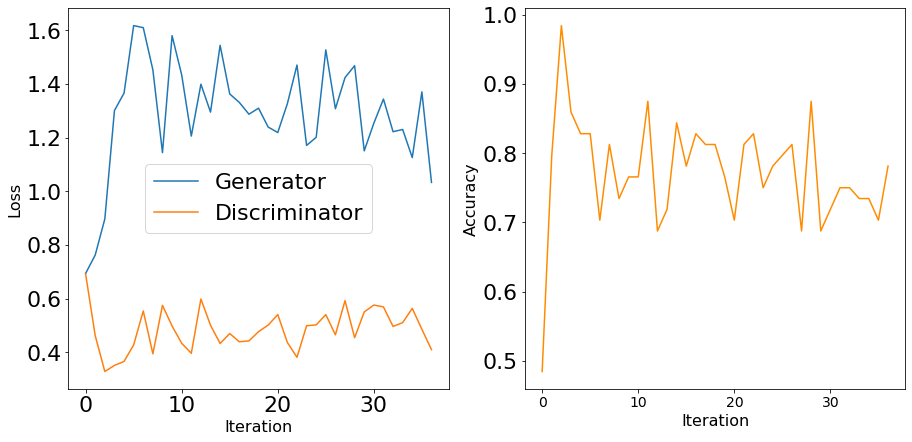

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3601 [D loss: 0.571019, acc.: 78.12%] [G loss: 1.014333]
3602 [D loss: 0.489618, acc.: 71.88%] [G loss: 1.200411]
3603 [D loss: 0.487877, acc.: 79.69%] [G loss: 1.323535]
3604 [D loss: 0.512024, acc.: 76.56%] [G loss: 1.444543]
3605 [D loss: 0.596843, acc.: 70.31%] [G loss: 1.191418]
3606 [D loss: 0.408487, acc.: 84.38%] [G loss: 1.273018]
3607 [D loss: 0.586271, acc.: 73.44%] [G loss: 1.236484]
3608 [D loss: 0.435082, acc.: 81.25%] [G loss: 1.315454]
3609 [D loss: 0.546481, acc.: 65.62%] [G loss: 1.140351]
3610 [D loss: 0.501577, acc.: 78.12%] [G loss: 1.202059]
3611 [D loss: 0.528636, acc.: 70.31%] [G loss: 1.311235]
3612 [D loss: 0.479660, acc.: 75.00%] [G loss: 1.039774]
3613 [D loss: 0.561459, acc.: 71.88%] [G loss: 1.112963]
3614 [D loss: 0.623458, acc.: 75.00%] [G loss: 1.162631]
3615 [D loss: 0.447412, acc.: 78.12%] [G loss: 1.322066]
3616 [D loss: 0.476873, acc.: 73.44%] [G loss: 1.245259]
3617 [D loss: 0.572543, acc.: 70.31%] [G loss: 1.037019]
3618 [D loss: 0.510581, acc.: 7

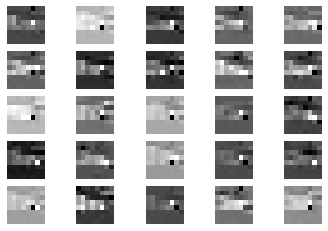

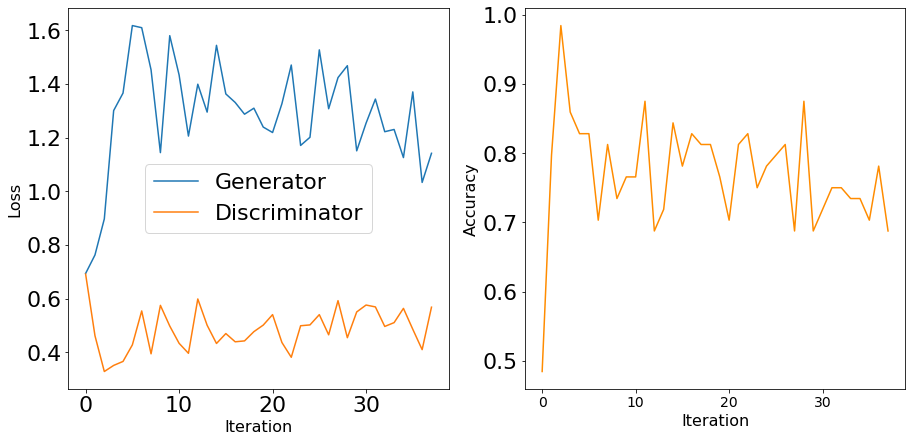

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3701 [D loss: 0.573653, acc.: 68.75%] [G loss: 1.298106]
3702 [D loss: 0.571695, acc.: 73.44%] [G loss: 1.007222]
3703 [D loss: 0.528907, acc.: 75.00%] [G loss: 1.185493]
3704 [D loss: 0.512486, acc.: 75.00%] [G loss: 1.299627]
3705 [D loss: 0.640097, acc.: 64.06%] [G loss: 1.198762]
3706 [D loss: 0.488776, acc.: 78.12%] [G loss: 1.115310]
3707 [D loss: 0.538579, acc.: 68.75%] [G loss: 1.447470]
3708 [D loss: 0.548587, acc.: 75.00%] [G loss: 1.353530]
3709 [D loss: 0.588950, acc.: 75.00%] [G loss: 1.184352]
3710 [D loss: 0.566693, acc.: 70.31%] [G loss: 1.036223]
3711 [D loss: 0.515378, acc.: 76.56%] [G loss: 1.171172]
3712 [D loss: 0.573882, acc.: 73.44%] [G loss: 1.314641]
3713 [D loss: 0.571744, acc.: 71.88%] [G loss: 1.326324]
3714 [D loss: 0.566903, acc.: 71.88%] [G loss: 1.054132]
3715 [D loss: 0.512241, acc.: 70.31%] [G loss: 1.017638]
3716 [D loss: 0.637428, acc.: 70.31%] [G loss: 1.154945]
3717 [D loss: 0.550136, acc.: 75.00%] [G loss: 1.455451]
3718 [D loss: 0.606285, acc.: 6

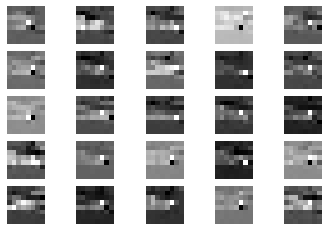

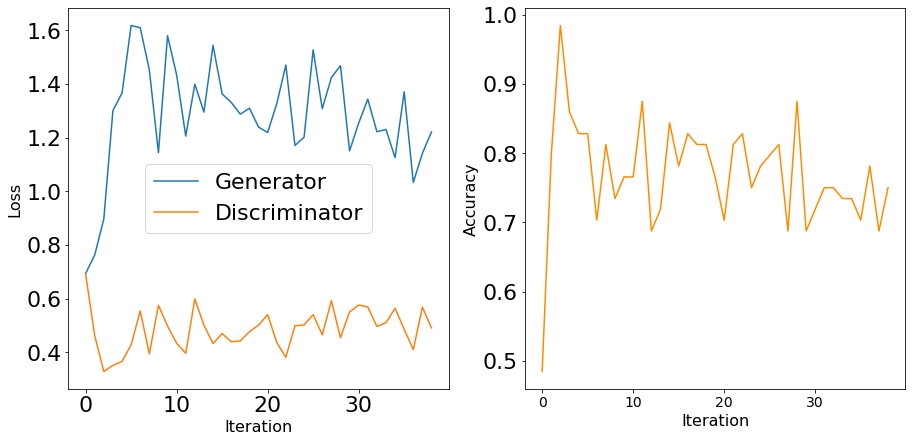

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3801 [D loss: 0.540782, acc.: 70.31%] [G loss: 1.123457]
3802 [D loss: 0.490272, acc.: 79.69%] [G loss: 1.084006]
3803 [D loss: 0.565604, acc.: 67.19%] [G loss: 1.430238]
3804 [D loss: 0.538658, acc.: 73.44%] [G loss: 1.158369]
3805 [D loss: 0.572561, acc.: 68.75%] [G loss: 1.176984]
3806 [D loss: 0.647986, acc.: 60.94%] [G loss: 0.969295]
3807 [D loss: 0.527571, acc.: 81.25%] [G loss: 1.433709]
3808 [D loss: 0.510411, acc.: 70.31%] [G loss: 1.260694]
3809 [D loss: 0.494269, acc.: 71.88%] [G loss: 1.186183]
3810 [D loss: 0.471004, acc.: 79.69%] [G loss: 1.275367]
3811 [D loss: 0.586485, acc.: 67.19%] [G loss: 1.074002]
3812 [D loss: 0.506919, acc.: 71.88%] [G loss: 1.019564]
3813 [D loss: 0.514927, acc.: 70.31%] [G loss: 1.186561]
3814 [D loss: 0.505119, acc.: 78.12%] [G loss: 1.256440]
3815 [D loss: 0.597417, acc.: 62.50%] [G loss: 1.230598]
3816 [D loss: 0.465431, acc.: 76.56%] [G loss: 1.038337]
3817 [D loss: 0.494490, acc.: 75.00%] [G loss: 1.175390]
3818 [D loss: 0.488261, acc.: 7

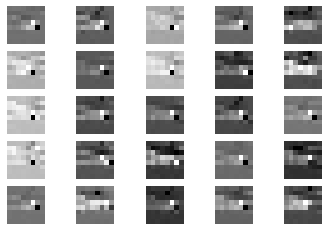

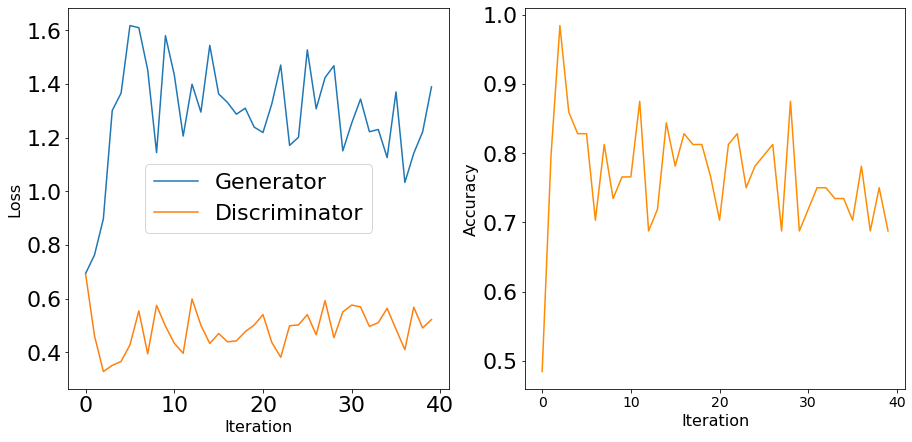

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


3901 [D loss: 0.497229, acc.: 70.31%] [G loss: 1.309131]
3902 [D loss: 0.566563, acc.: 67.19%] [G loss: 1.169786]
3903 [D loss: 0.485579, acc.: 70.31%] [G loss: 1.258910]
3904 [D loss: 0.470359, acc.: 78.12%] [G loss: 1.293637]
3905 [D loss: 0.522070, acc.: 75.00%] [G loss: 1.234859]
3906 [D loss: 0.565103, acc.: 68.75%] [G loss: 1.367412]
3907 [D loss: 0.532503, acc.: 76.56%] [G loss: 1.242478]
3908 [D loss: 0.472751, acc.: 79.69%] [G loss: 1.066448]
3909 [D loss: 0.455719, acc.: 81.25%] [G loss: 1.260804]
3910 [D loss: 0.520618, acc.: 75.00%] [G loss: 1.340734]
3911 [D loss: 0.571355, acc.: 65.62%] [G loss: 1.074946]
3912 [D loss: 0.531186, acc.: 75.00%] [G loss: 1.269216]
3913 [D loss: 0.502745, acc.: 76.56%] [G loss: 1.383051]
3914 [D loss: 0.616584, acc.: 78.12%] [G loss: 1.334458]
3915 [D loss: 0.534449, acc.: 71.88%] [G loss: 1.119114]
3916 [D loss: 0.503873, acc.: 76.56%] [G loss: 1.140256]
3917 [D loss: 0.478514, acc.: 73.44%] [G loss: 1.137480]
3918 [D loss: 0.551277, acc.: 7

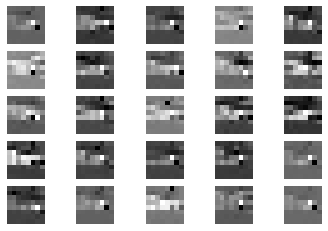

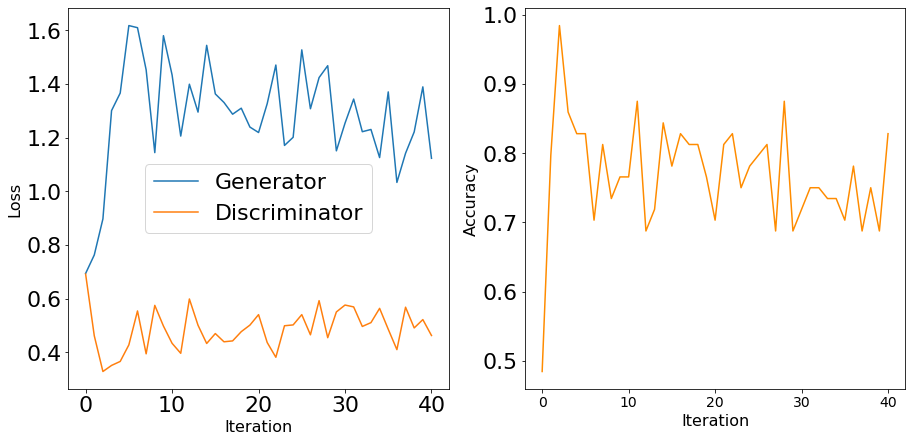

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4001 [D loss: 0.476696, acc.: 84.38%] [G loss: 1.251781]
4002 [D loss: 0.553651, acc.: 78.12%] [G loss: 1.180065]
4003 [D loss: 0.475243, acc.: 79.69%] [G loss: 1.424896]
4004 [D loss: 0.489041, acc.: 73.44%] [G loss: 1.092169]
4005 [D loss: 0.617657, acc.: 60.94%] [G loss: 1.322346]
4006 [D loss: 0.617785, acc.: 67.19%] [G loss: 1.222799]
4007 [D loss: 0.611284, acc.: 70.31%] [G loss: 1.235383]
4008 [D loss: 0.562620, acc.: 73.44%] [G loss: 1.436229]
4009 [D loss: 0.477399, acc.: 81.25%] [G loss: 1.094360]
4010 [D loss: 0.548612, acc.: 71.88%] [G loss: 1.195754]
4011 [D loss: 0.472370, acc.: 79.69%] [G loss: 1.245247]
4012 [D loss: 0.493399, acc.: 75.00%] [G loss: 1.254133]
4013 [D loss: 0.513301, acc.: 75.00%] [G loss: 1.298623]
4014 [D loss: 0.504302, acc.: 73.44%] [G loss: 1.048595]
4015 [D loss: 0.509711, acc.: 76.56%] [G loss: 1.276110]
4016 [D loss: 0.590466, acc.: 62.50%] [G loss: 1.082298]
4017 [D loss: 0.577144, acc.: 64.06%] [G loss: 1.169037]
4018 [D loss: 0.488767, acc.: 7

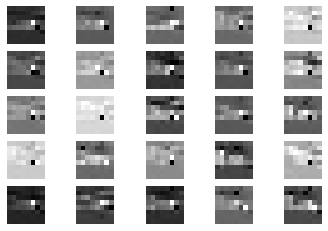

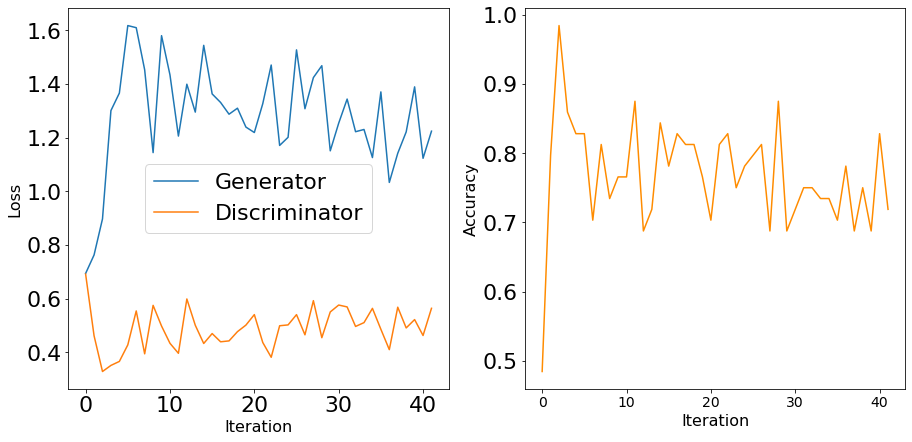

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4101 [D loss: 0.481847, acc.: 73.44%] [G loss: 1.130153]
4102 [D loss: 0.495878, acc.: 71.88%] [G loss: 1.280449]
4103 [D loss: 0.613856, acc.: 60.94%] [G loss: 1.141992]
4104 [D loss: 0.525313, acc.: 71.88%] [G loss: 1.329342]
4105 [D loss: 0.517617, acc.: 71.88%] [G loss: 1.176349]
4106 [D loss: 0.490822, acc.: 84.38%] [G loss: 1.169817]
4107 [D loss: 0.543145, acc.: 75.00%] [G loss: 1.150502]
4108 [D loss: 0.440279, acc.: 84.38%] [G loss: 1.187748]
4109 [D loss: 0.541776, acc.: 75.00%] [G loss: 1.277875]
4110 [D loss: 0.539667, acc.: 73.44%] [G loss: 1.334765]
4111 [D loss: 0.501628, acc.: 79.69%] [G loss: 1.451760]
4112 [D loss: 0.685516, acc.: 57.81%] [G loss: 1.021649]
4113 [D loss: 0.513033, acc.: 70.31%] [G loss: 1.130319]
4114 [D loss: 0.526813, acc.: 71.88%] [G loss: 1.161795]
4115 [D loss: 0.471865, acc.: 76.56%] [G loss: 1.207229]
4116 [D loss: 0.546068, acc.: 73.44%] [G loss: 1.370752]
4117 [D loss: 0.598782, acc.: 65.62%] [G loss: 1.102979]
4118 [D loss: 0.519148, acc.: 7

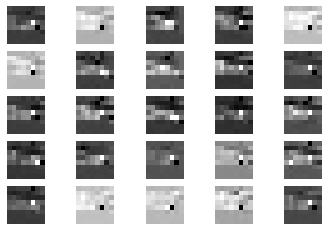

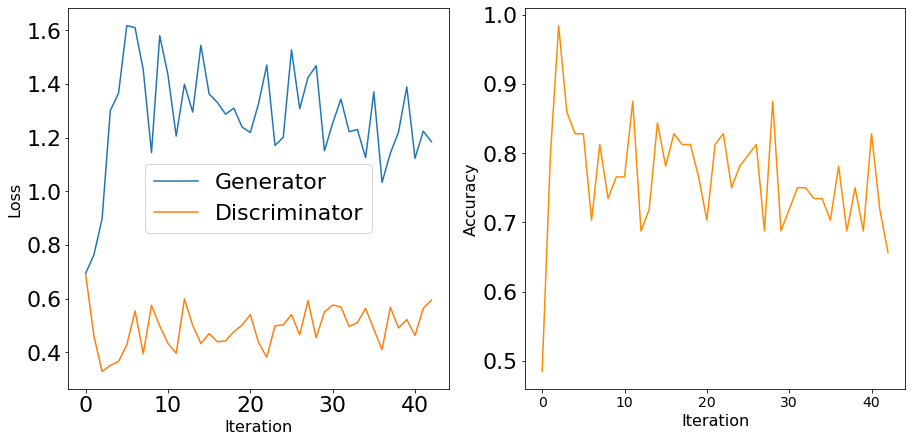

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4201 [D loss: 0.482674, acc.: 70.31%] [G loss: 1.146121]
4202 [D loss: 0.467693, acc.: 81.25%] [G loss: 1.106523]
4203 [D loss: 0.538165, acc.: 76.56%] [G loss: 1.154403]
4204 [D loss: 0.611280, acc.: 64.06%] [G loss: 1.305620]
4205 [D loss: 0.481952, acc.: 73.44%] [G loss: 1.215833]
4206 [D loss: 0.468900, acc.: 79.69%] [G loss: 1.432739]
4207 [D loss: 0.449222, acc.: 70.31%] [G loss: 1.343083]
4208 [D loss: 0.456149, acc.: 78.12%] [G loss: 1.327963]
4209 [D loss: 0.489756, acc.: 76.56%] [G loss: 1.323539]
4210 [D loss: 0.474224, acc.: 79.69%] [G loss: 1.074123]
4211 [D loss: 0.492093, acc.: 78.12%] [G loss: 1.124631]
4212 [D loss: 0.588199, acc.: 64.06%] [G loss: 1.124735]
4213 [D loss: 0.543541, acc.: 71.88%] [G loss: 1.173119]
4214 [D loss: 0.533290, acc.: 75.00%] [G loss: 1.121960]
4215 [D loss: 0.483197, acc.: 76.56%] [G loss: 1.101422]
4216 [D loss: 0.476612, acc.: 81.25%] [G loss: 1.254792]
4217 [D loss: 0.495458, acc.: 78.12%] [G loss: 1.389304]
4218 [D loss: 0.465400, acc.: 7

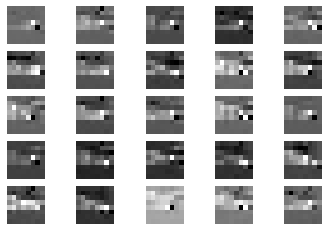

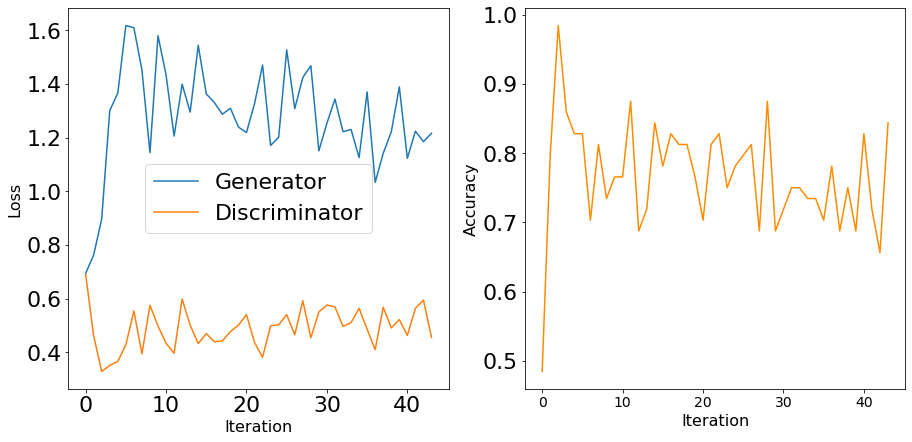

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4301 [D loss: 0.500692, acc.: 78.12%] [G loss: 1.247789]
4302 [D loss: 0.557578, acc.: 75.00%] [G loss: 1.000917]
4303 [D loss: 0.521886, acc.: 73.44%] [G loss: 1.062953]
4304 [D loss: 0.536753, acc.: 70.31%] [G loss: 1.126070]
4305 [D loss: 0.604183, acc.: 70.31%] [G loss: 1.349028]
4306 [D loss: 0.705915, acc.: 59.38%] [G loss: 0.973459]
4307 [D loss: 0.523590, acc.: 71.88%] [G loss: 1.181378]
4308 [D loss: 0.554127, acc.: 67.19%] [G loss: 1.032838]
4309 [D loss: 0.610030, acc.: 65.62%] [G loss: 1.151491]
4310 [D loss: 0.459430, acc.: 82.81%] [G loss: 1.270037]
4311 [D loss: 0.517707, acc.: 76.56%] [G loss: 1.146384]
4312 [D loss: 0.558697, acc.: 75.00%] [G loss: 1.219127]
4313 [D loss: 0.532562, acc.: 79.69%] [G loss: 1.315400]
4314 [D loss: 0.500246, acc.: 75.00%] [G loss: 1.110477]
4315 [D loss: 0.584948, acc.: 68.75%] [G loss: 1.098218]
4316 [D loss: 0.490150, acc.: 78.12%] [G loss: 1.226321]
4317 [D loss: 0.605368, acc.: 65.62%] [G loss: 1.253107]
4318 [D loss: 0.469961, acc.: 7

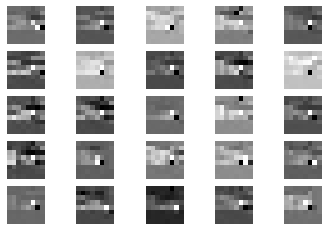

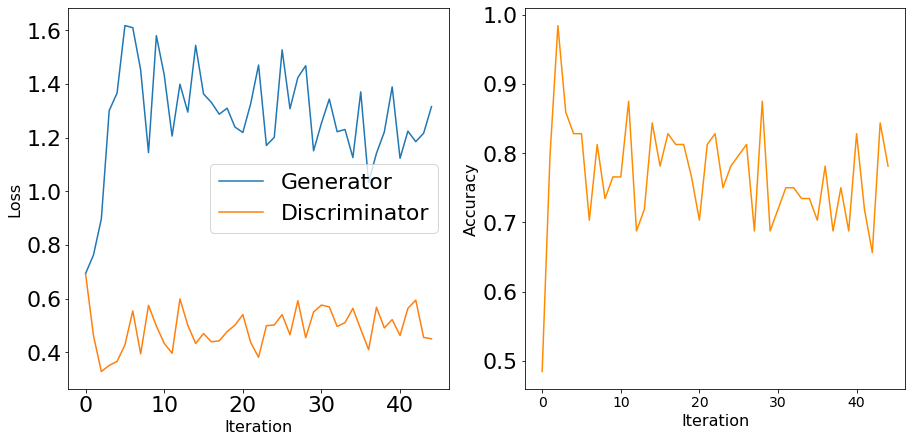

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4401 [D loss: 0.567112, acc.: 64.06%] [G loss: 1.079509]
4402 [D loss: 0.542072, acc.: 73.44%] [G loss: 1.195134]
4403 [D loss: 0.608083, acc.: 64.06%] [G loss: 1.130589]
4404 [D loss: 0.530722, acc.: 75.00%] [G loss: 1.217921]
4405 [D loss: 0.602461, acc.: 71.88%] [G loss: 1.221357]
4406 [D loss: 0.618968, acc.: 64.06%] [G loss: 1.076606]
4407 [D loss: 0.515743, acc.: 71.88%] [G loss: 0.962358]
4408 [D loss: 0.525649, acc.: 71.88%] [G loss: 1.125567]
4409 [D loss: 0.532233, acc.: 78.12%] [G loss: 1.200172]
4410 [D loss: 0.474995, acc.: 76.56%] [G loss: 1.187177]
4411 [D loss: 0.524494, acc.: 73.44%] [G loss: 0.962661]
4412 [D loss: 0.509548, acc.: 73.44%] [G loss: 1.106595]
4413 [D loss: 0.619675, acc.: 67.19%] [G loss: 1.068281]
4414 [D loss: 0.620197, acc.: 70.31%] [G loss: 1.209831]
4415 [D loss: 0.487232, acc.: 76.56%] [G loss: 1.297650]
4416 [D loss: 0.578337, acc.: 76.56%] [G loss: 1.146177]
4417 [D loss: 0.546606, acc.: 79.69%] [G loss: 1.075450]
4418 [D loss: 0.611120, acc.: 7

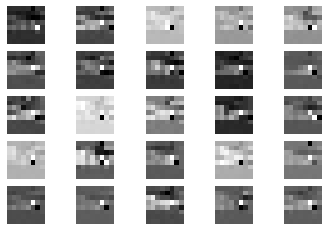

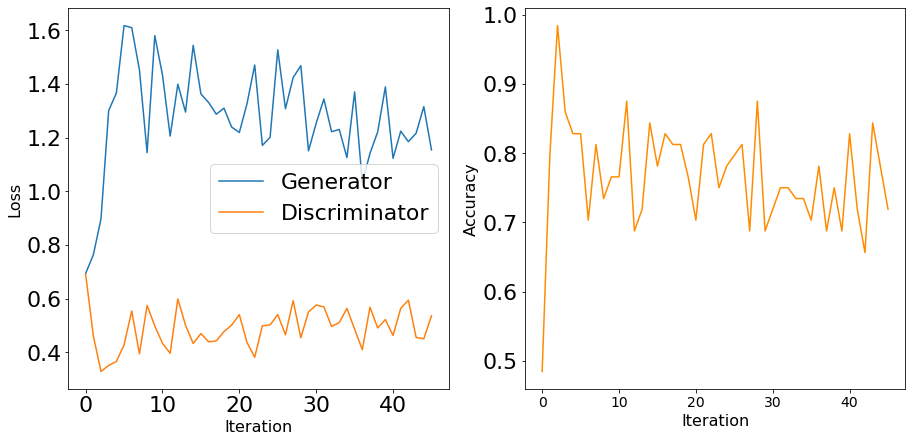

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4501 [D loss: 0.519222, acc.: 76.56%] [G loss: 1.254909]
4502 [D loss: 0.688488, acc.: 68.75%] [G loss: 1.154577]
4503 [D loss: 0.548895, acc.: 76.56%] [G loss: 1.107920]
4504 [D loss: 0.498378, acc.: 76.56%] [G loss: 1.095749]
4505 [D loss: 0.625308, acc.: 56.25%] [G loss: 1.205816]
4506 [D loss: 0.581864, acc.: 70.31%] [G loss: 1.243579]
4507 [D loss: 0.510851, acc.: 76.56%] [G loss: 1.101548]
4508 [D loss: 0.507580, acc.: 75.00%] [G loss: 1.195803]
4509 [D loss: 0.595914, acc.: 65.62%] [G loss: 1.196772]
4510 [D loss: 0.557220, acc.: 71.88%] [G loss: 1.091856]
4511 [D loss: 0.606298, acc.: 68.75%] [G loss: 1.056667]
4512 [D loss: 0.506839, acc.: 75.00%] [G loss: 0.997467]
4513 [D loss: 0.628747, acc.: 75.00%] [G loss: 1.118893]
4514 [D loss: 0.518972, acc.: 75.00%] [G loss: 1.094613]
4515 [D loss: 0.461637, acc.: 73.44%] [G loss: 1.070912]
4516 [D loss: 0.456322, acc.: 75.00%] [G loss: 1.410911]
4517 [D loss: 0.471561, acc.: 79.69%] [G loss: 1.107000]
4518 [D loss: 0.615229, acc.: 7

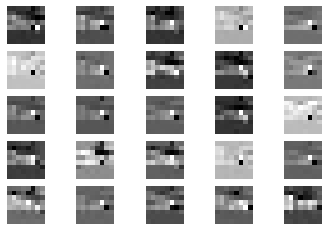

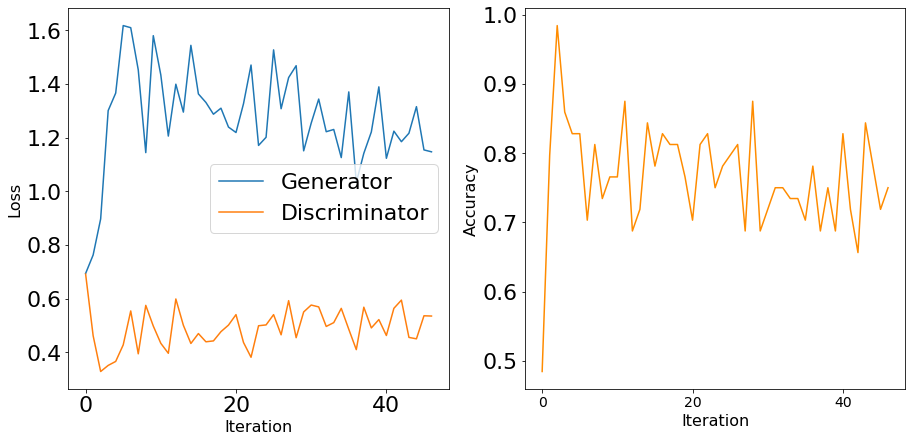

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4601 [D loss: 0.589065, acc.: 68.75%] [G loss: 1.096221]
4602 [D loss: 0.564317, acc.: 64.06%] [G loss: 1.160380]
4603 [D loss: 0.602715, acc.: 67.19%] [G loss: 1.128222]
4604 [D loss: 0.471806, acc.: 73.44%] [G loss: 1.043594]
4605 [D loss: 0.480050, acc.: 76.56%] [G loss: 1.056729]
4606 [D loss: 0.544086, acc.: 71.88%] [G loss: 1.134547]
4607 [D loss: 0.469313, acc.: 78.12%] [G loss: 1.148834]
4608 [D loss: 0.589312, acc.: 59.38%] [G loss: 1.169791]
4609 [D loss: 0.532877, acc.: 70.31%] [G loss: 1.121274]
4610 [D loss: 0.628407, acc.: 64.06%] [G loss: 0.968938]
4611 [D loss: 0.515013, acc.: 73.44%] [G loss: 0.991677]
4612 [D loss: 0.565931, acc.: 73.44%] [G loss: 1.150356]
4613 [D loss: 0.623101, acc.: 68.75%] [G loss: 1.132905]
4614 [D loss: 0.600102, acc.: 75.00%] [G loss: 1.018213]
4615 [D loss: 0.563239, acc.: 73.44%] [G loss: 1.229935]
4616 [D loss: 0.545751, acc.: 71.88%] [G loss: 1.205591]
4617 [D loss: 0.461902, acc.: 75.00%] [G loss: 1.219730]
4618 [D loss: 0.476342, acc.: 8

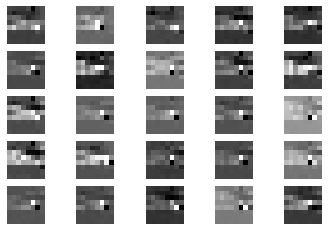

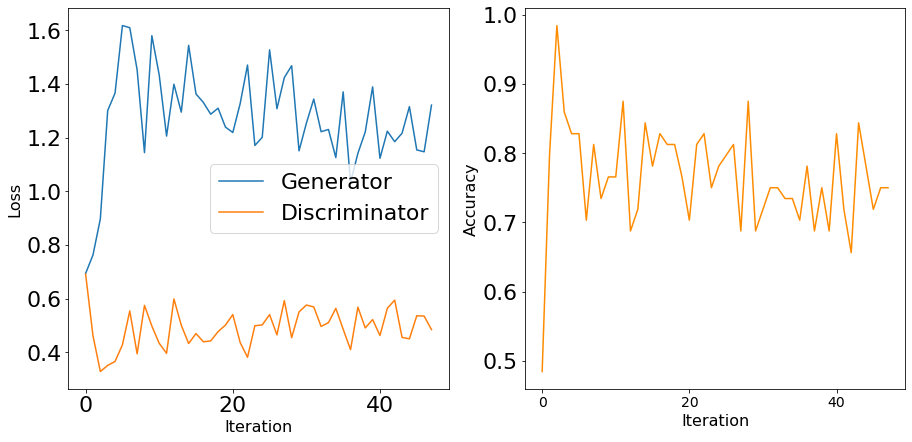

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4701 [D loss: 0.592533, acc.: 68.75%] [G loss: 1.131778]
4702 [D loss: 0.405100, acc.: 82.81%] [G loss: 1.173024]
4703 [D loss: 0.600369, acc.: 71.88%] [G loss: 1.104767]
4704 [D loss: 0.461989, acc.: 79.69%] [G loss: 1.339633]
4705 [D loss: 0.514826, acc.: 78.12%] [G loss: 1.144237]
4706 [D loss: 0.460198, acc.: 82.81%] [G loss: 1.140905]
4707 [D loss: 0.535404, acc.: 78.12%] [G loss: 0.893054]
4708 [D loss: 0.521289, acc.: 73.44%] [G loss: 1.149752]
4709 [D loss: 0.648539, acc.: 60.94%] [G loss: 1.162000]
4710 [D loss: 0.570115, acc.: 67.19%] [G loss: 1.341245]
4711 [D loss: 0.533526, acc.: 68.75%] [G loss: 1.374284]
4712 [D loss: 0.469700, acc.: 75.00%] [G loss: 1.157662]
4713 [D loss: 0.554093, acc.: 78.12%] [G loss: 1.034681]
4714 [D loss: 0.606091, acc.: 59.38%] [G loss: 1.164689]
4715 [D loss: 0.584774, acc.: 70.31%] [G loss: 1.529434]
4716 [D loss: 0.568060, acc.: 71.88%] [G loss: 0.982673]
4717 [D loss: 0.551442, acc.: 76.56%] [G loss: 1.225840]
4718 [D loss: 0.515935, acc.: 7

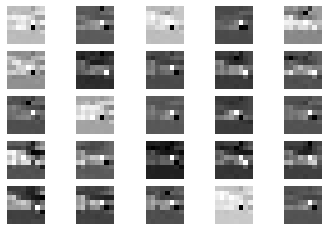

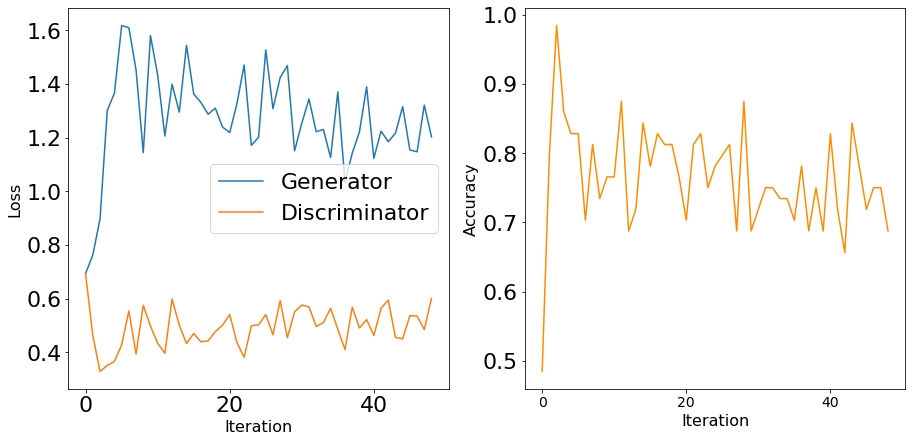

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4801 [D loss: 0.526644, acc.: 78.12%] [G loss: 1.315187]
4802 [D loss: 0.508967, acc.: 76.56%] [G loss: 1.221711]
4803 [D loss: 0.434244, acc.: 78.12%] [G loss: 1.039820]
4804 [D loss: 0.476789, acc.: 78.12%] [G loss: 1.069728]
4805 [D loss: 0.563415, acc.: 68.75%] [G loss: 1.048824]
4806 [D loss: 0.500550, acc.: 78.12%] [G loss: 1.293725]
4807 [D loss: 0.596333, acc.: 67.19%] [G loss: 1.269674]
4808 [D loss: 0.534662, acc.: 70.31%] [G loss: 1.303066]
4809 [D loss: 0.479507, acc.: 78.12%] [G loss: 0.984078]
4810 [D loss: 0.433702, acc.: 81.25%] [G loss: 1.101751]
4811 [D loss: 0.551744, acc.: 70.31%] [G loss: 1.262124]
4812 [D loss: 0.569557, acc.: 68.75%] [G loss: 1.168082]
4813 [D loss: 0.566818, acc.: 76.56%] [G loss: 1.203202]
4814 [D loss: 0.479975, acc.: 78.12%] [G loss: 0.955892]
4815 [D loss: 0.459109, acc.: 82.81%] [G loss: 1.301185]
4816 [D loss: 0.562597, acc.: 76.56%] [G loss: 1.038744]
4817 [D loss: 0.595667, acc.: 57.81%] [G loss: 0.981394]
4818 [D loss: 0.485143, acc.: 7

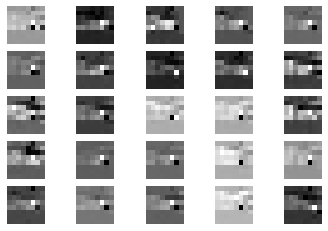

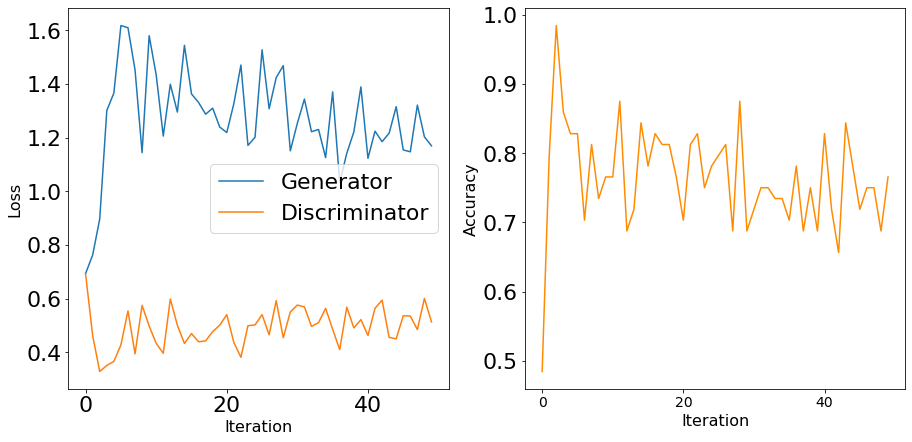

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


4901 [D loss: 0.480567, acc.: 75.00%] [G loss: 1.063185]
4902 [D loss: 0.495190, acc.: 79.69%] [G loss: 1.076356]
4903 [D loss: 0.506077, acc.: 79.69%] [G loss: 1.142198]
4904 [D loss: 0.594840, acc.: 68.75%] [G loss: 1.256190]
4905 [D loss: 0.490022, acc.: 71.88%] [G loss: 1.074338]
4906 [D loss: 0.515962, acc.: 76.56%] [G loss: 1.196715]
4907 [D loss: 0.453663, acc.: 76.56%] [G loss: 1.403888]
4908 [D loss: 0.546161, acc.: 71.88%] [G loss: 1.137254]
4909 [D loss: 0.572649, acc.: 68.75%] [G loss: 1.389111]
4910 [D loss: 0.529151, acc.: 75.00%] [G loss: 1.186486]
4911 [D loss: 0.558806, acc.: 70.31%] [G loss: 1.202739]
4912 [D loss: 0.503997, acc.: 78.12%] [G loss: 1.186082]
4913 [D loss: 0.555681, acc.: 68.75%] [G loss: 1.126330]
4914 [D loss: 0.462168, acc.: 78.12%] [G loss: 1.065432]
4915 [D loss: 0.604942, acc.: 68.75%] [G loss: 1.032248]
4916 [D loss: 0.562027, acc.: 68.75%] [G loss: 1.208938]
4917 [D loss: 0.531868, acc.: 76.56%] [G loss: 1.207292]
4918 [D loss: 0.544085, acc.: 7

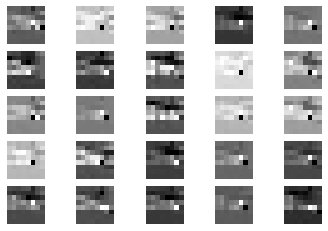

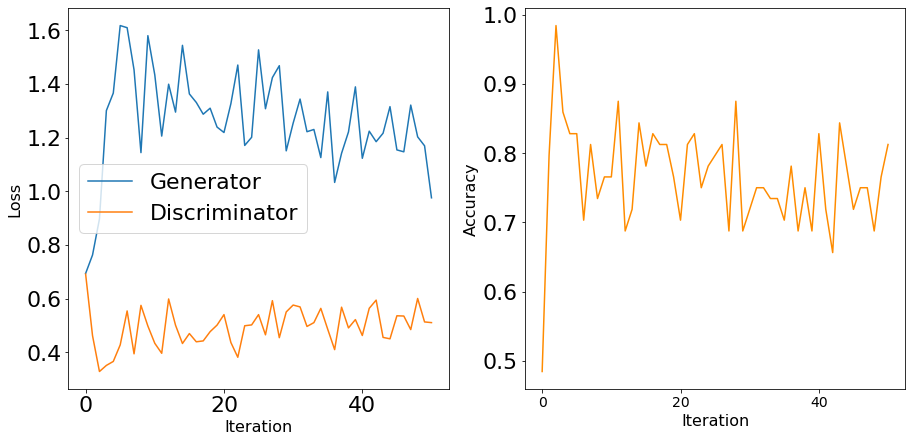

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5001 [D loss: 0.546417, acc.: 75.00%] [G loss: 1.296856]
5002 [D loss: 0.574852, acc.: 67.19%] [G loss: 1.059796]
5003 [D loss: 0.550061, acc.: 68.75%] [G loss: 1.121221]
5004 [D loss: 0.529825, acc.: 76.56%] [G loss: 1.336246]
5005 [D loss: 0.635448, acc.: 65.62%] [G loss: 1.174666]
5006 [D loss: 0.542773, acc.: 71.88%] [G loss: 1.078191]
5007 [D loss: 0.485215, acc.: 78.12%] [G loss: 1.164779]
5008 [D loss: 0.422572, acc.: 89.06%] [G loss: 1.246617]
5009 [D loss: 0.507934, acc.: 79.69%] [G loss: 1.328495]
5010 [D loss: 0.465840, acc.: 79.69%] [G loss: 1.046052]
5011 [D loss: 0.521522, acc.: 75.00%] [G loss: 0.963963]
5012 [D loss: 0.474482, acc.: 84.38%] [G loss: 1.056171]
5013 [D loss: 0.544998, acc.: 71.88%] [G loss: 1.335860]
5014 [D loss: 0.615257, acc.: 67.19%] [G loss: 1.157189]
5015 [D loss: 0.487142, acc.: 76.56%] [G loss: 1.220058]
5016 [D loss: 0.578879, acc.: 64.06%] [G loss: 1.115161]
5017 [D loss: 0.542481, acc.: 67.19%] [G loss: 1.047123]
5018 [D loss: 0.591590, acc.: 6

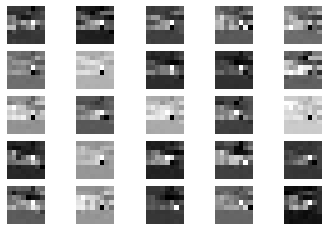

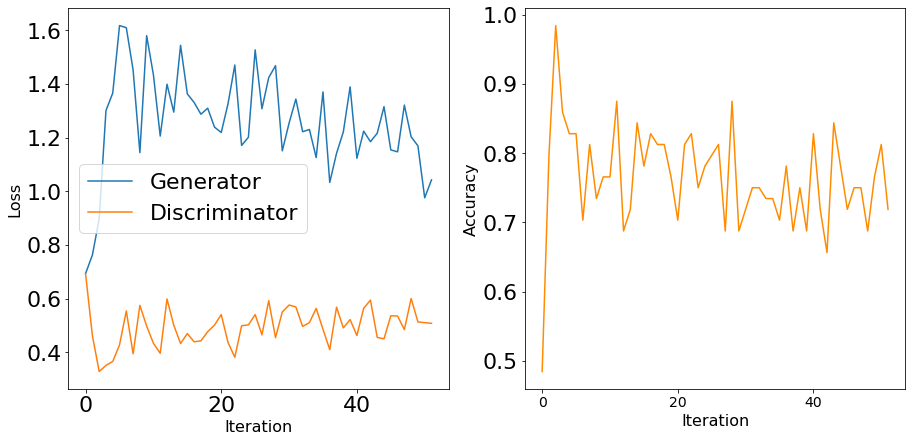

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5101 [D loss: 0.597526, acc.: 67.19%] [G loss: 1.076932]
5102 [D loss: 0.583594, acc.: 71.88%] [G loss: 1.266475]
5103 [D loss: 0.593266, acc.: 71.88%] [G loss: 0.953734]
5104 [D loss: 0.465443, acc.: 81.25%] [G loss: 0.992531]
5105 [D loss: 0.515513, acc.: 75.00%] [G loss: 1.048050]
5106 [D loss: 0.507934, acc.: 73.44%] [G loss: 1.307897]
5107 [D loss: 0.537455, acc.: 67.19%] [G loss: 1.364917]
5108 [D loss: 0.551943, acc.: 67.19%] [G loss: 1.200367]
5109 [D loss: 0.584716, acc.: 70.31%] [G loss: 1.108526]
5110 [D loss: 0.583466, acc.: 70.31%] [G loss: 1.110202]
5111 [D loss: 0.528718, acc.: 75.00%] [G loss: 0.974808]
5112 [D loss: 0.586247, acc.: 65.62%] [G loss: 1.145603]
5113 [D loss: 0.459843, acc.: 75.00%] [G loss: 1.171325]
5114 [D loss: 0.580819, acc.: 71.88%] [G loss: 1.026784]
5115 [D loss: 0.572113, acc.: 75.00%] [G loss: 1.009493]
5116 [D loss: 0.673229, acc.: 64.06%] [G loss: 1.263564]
5117 [D loss: 0.498666, acc.: 76.56%] [G loss: 1.149158]
5118 [D loss: 0.506387, acc.: 7

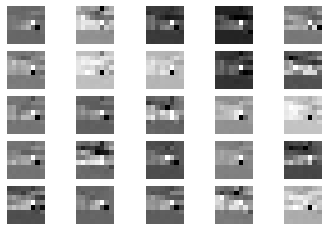

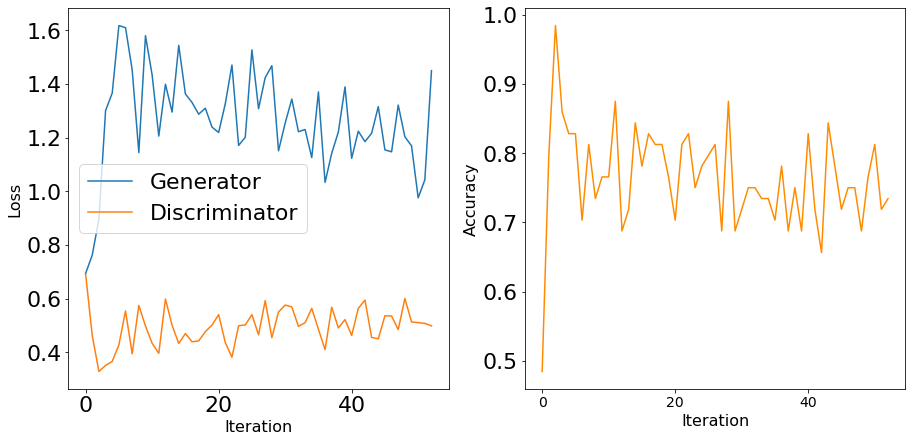

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5201 [D loss: 0.486701, acc.: 71.88%] [G loss: 1.356297]
5202 [D loss: 0.557371, acc.: 70.31%] [G loss: 1.165338]
5203 [D loss: 0.609287, acc.: 68.75%] [G loss: 1.262327]
5204 [D loss: 0.653182, acc.: 67.19%] [G loss: 1.302451]
5205 [D loss: 0.506778, acc.: 76.56%] [G loss: 1.150252]
5206 [D loss: 0.674064, acc.: 65.62%] [G loss: 0.930900]
5207 [D loss: 0.560813, acc.: 78.12%] [G loss: 1.063302]
5208 [D loss: 0.584387, acc.: 70.31%] [G loss: 1.211087]
5209 [D loss: 0.453964, acc.: 82.81%] [G loss: 1.159021]
5210 [D loss: 0.582561, acc.: 68.75%] [G loss: 1.345549]
5211 [D loss: 0.439311, acc.: 79.69%] [G loss: 1.349640]
5212 [D loss: 0.517177, acc.: 76.56%] [G loss: 1.219139]
5213 [D loss: 0.580912, acc.: 67.19%] [G loss: 1.182155]
5214 [D loss: 0.476150, acc.: 79.69%] [G loss: 1.257682]
5215 [D loss: 0.566230, acc.: 68.75%] [G loss: 0.966880]
5216 [D loss: 0.548976, acc.: 70.31%] [G loss: 1.159870]
5217 [D loss: 0.563578, acc.: 73.44%] [G loss: 1.058446]
5218 [D loss: 0.650429, acc.: 7

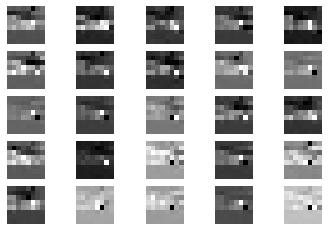

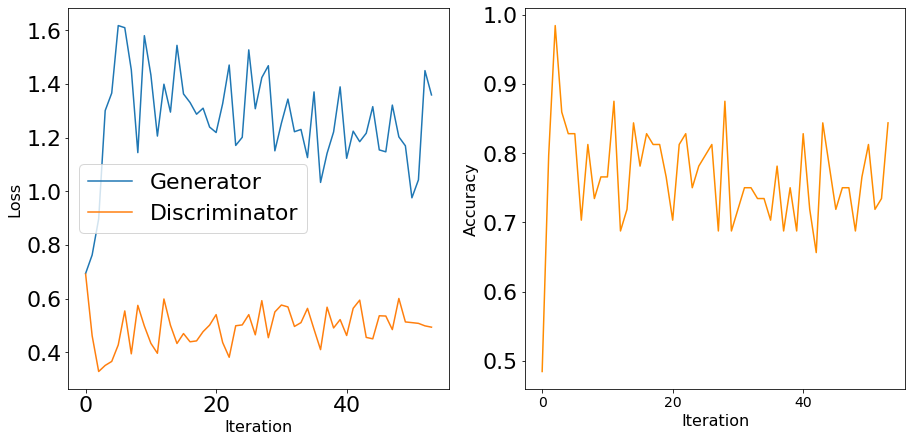

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5301 [D loss: 0.516587, acc.: 79.69%] [G loss: 1.218963]
5302 [D loss: 0.590408, acc.: 70.31%] [G loss: 0.995151]
5303 [D loss: 0.574390, acc.: 67.19%] [G loss: 1.105423]
5304 [D loss: 0.505006, acc.: 76.56%] [G loss: 1.117204]
5305 [D loss: 0.571001, acc.: 65.62%] [G loss: 1.221870]
5306 [D loss: 0.460367, acc.: 78.12%] [G loss: 0.983094]
5307 [D loss: 0.558149, acc.: 65.62%] [G loss: 1.066215]
5308 [D loss: 0.519869, acc.: 78.12%] [G loss: 1.082037]
5309 [D loss: 0.529276, acc.: 73.44%] [G loss: 1.122131]
5310 [D loss: 0.549090, acc.: 75.00%] [G loss: 1.029639]
5311 [D loss: 0.489384, acc.: 82.81%] [G loss: 1.172856]
5312 [D loss: 0.545767, acc.: 68.75%] [G loss: 1.338158]
5313 [D loss: 0.474706, acc.: 75.00%] [G loss: 1.021048]
5314 [D loss: 0.545395, acc.: 71.88%] [G loss: 1.086418]
5315 [D loss: 0.525205, acc.: 75.00%] [G loss: 1.014813]
5316 [D loss: 0.409158, acc.: 89.06%] [G loss: 1.025682]
5317 [D loss: 0.647061, acc.: 54.69%] [G loss: 1.062432]
5318 [D loss: 0.531512, acc.: 7

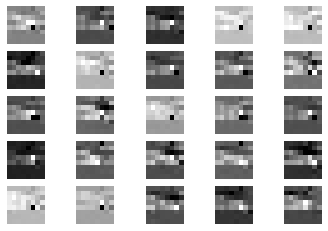

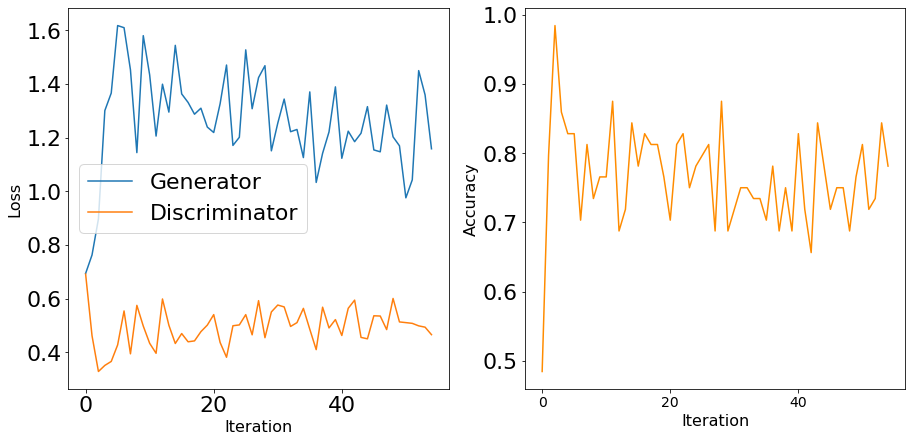

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5401 [D loss: 0.603028, acc.: 59.38%] [G loss: 1.016364]
5402 [D loss: 0.546328, acc.: 79.69%] [G loss: 1.074250]
5403 [D loss: 0.641258, acc.: 57.81%] [G loss: 1.058550]
5404 [D loss: 0.607006, acc.: 67.19%] [G loss: 1.194328]
5405 [D loss: 0.534579, acc.: 70.31%] [G loss: 1.150596]
5406 [D loss: 0.521766, acc.: 78.12%] [G loss: 1.321571]
5407 [D loss: 0.631484, acc.: 60.94%] [G loss: 1.096159]
5408 [D loss: 0.501155, acc.: 71.88%] [G loss: 1.188808]
5409 [D loss: 0.621400, acc.: 65.62%] [G loss: 1.119846]
5410 [D loss: 0.673431, acc.: 57.81%] [G loss: 1.142460]
5411 [D loss: 0.622356, acc.: 67.19%] [G loss: 1.041414]
5412 [D loss: 0.593248, acc.: 64.06%] [G loss: 0.990687]
5413 [D loss: 0.541308, acc.: 73.44%] [G loss: 1.175184]
5414 [D loss: 0.484426, acc.: 81.25%] [G loss: 1.183111]
5415 [D loss: 0.583286, acc.: 71.88%] [G loss: 1.084783]
5416 [D loss: 0.612396, acc.: 70.31%] [G loss: 1.117028]
5417 [D loss: 0.551353, acc.: 71.88%] [G loss: 1.019180]
5418 [D loss: 0.552982, acc.: 7

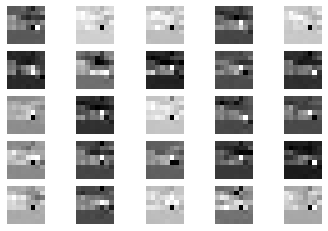

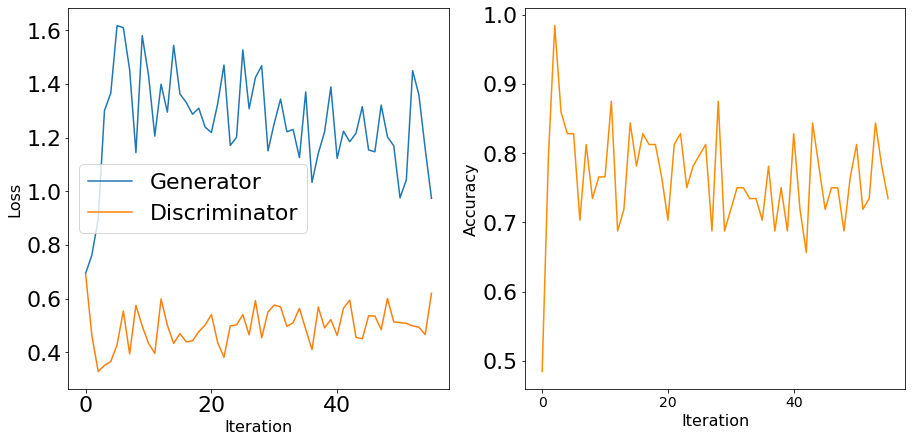

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5501 [D loss: 0.495748, acc.: 71.88%] [G loss: 1.238187]
5502 [D loss: 0.533524, acc.: 75.00%] [G loss: 0.988840]
5503 [D loss: 0.570603, acc.: 76.56%] [G loss: 1.064532]
5504 [D loss: 0.557182, acc.: 67.19%] [G loss: 1.116150]
5505 [D loss: 0.534587, acc.: 73.44%] [G loss: 1.158886]
5506 [D loss: 0.439942, acc.: 82.81%] [G loss: 0.916816]
5507 [D loss: 0.579430, acc.: 65.62%] [G loss: 1.232516]
5508 [D loss: 0.577515, acc.: 64.06%] [G loss: 1.158086]
5509 [D loss: 0.576454, acc.: 68.75%] [G loss: 1.006851]
5510 [D loss: 0.543683, acc.: 65.62%] [G loss: 1.273100]
5511 [D loss: 0.578829, acc.: 65.62%] [G loss: 0.911867]
5512 [D loss: 0.570641, acc.: 68.75%] [G loss: 1.123098]
5513 [D loss: 0.552191, acc.: 73.44%] [G loss: 0.969739]
5514 [D loss: 0.620858, acc.: 65.62%] [G loss: 1.239328]
5515 [D loss: 0.616340, acc.: 60.94%] [G loss: 1.035360]
5516 [D loss: 0.652546, acc.: 60.94%] [G loss: 1.027241]
5517 [D loss: 0.647679, acc.: 57.81%] [G loss: 0.955374]
5518 [D loss: 0.586125, acc.: 6

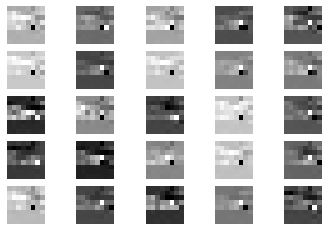

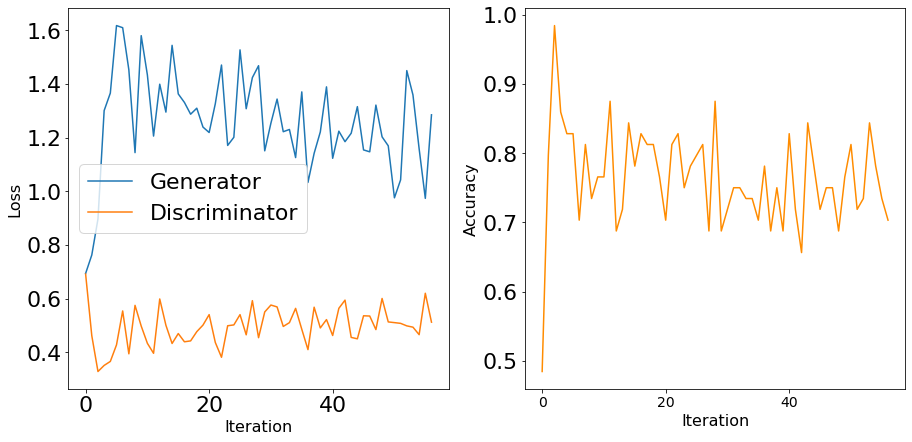

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5601 [D loss: 0.483195, acc.: 81.25%] [G loss: 1.300187]
5602 [D loss: 0.548139, acc.: 68.75%] [G loss: 1.268063]
5603 [D loss: 0.623869, acc.: 64.06%] [G loss: 1.412838]
5604 [D loss: 0.550219, acc.: 75.00%] [G loss: 1.103730]
5605 [D loss: 0.513933, acc.: 73.44%] [G loss: 0.925058]
5606 [D loss: 0.615917, acc.: 59.38%] [G loss: 1.178602]
5607 [D loss: 0.536187, acc.: 70.31%] [G loss: 1.126213]
5608 [D loss: 0.504898, acc.: 75.00%] [G loss: 0.903295]
5609 [D loss: 0.651397, acc.: 67.19%] [G loss: 0.895843]
5610 [D loss: 0.659165, acc.: 65.62%] [G loss: 1.195941]
5611 [D loss: 0.555224, acc.: 65.62%] [G loss: 1.011973]
5612 [D loss: 0.531259, acc.: 70.31%] [G loss: 1.134730]
5613 [D loss: 0.491497, acc.: 76.56%] [G loss: 1.008772]
5614 [D loss: 0.587660, acc.: 70.31%] [G loss: 1.161814]
5615 [D loss: 0.543860, acc.: 75.00%] [G loss: 1.100171]
5616 [D loss: 0.566722, acc.: 67.19%] [G loss: 1.095475]
5617 [D loss: 0.520912, acc.: 70.31%] [G loss: 1.227050]
5618 [D loss: 0.678021, acc.: 6

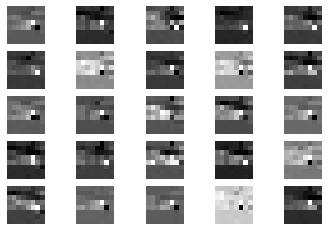

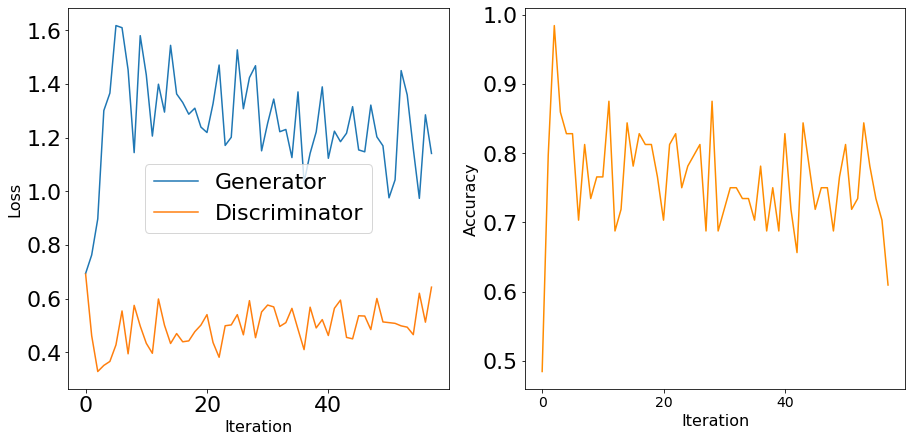

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5701 [D loss: 0.646045, acc.: 70.31%] [G loss: 1.131990]
5702 [D loss: 0.444619, acc.: 76.56%] [G loss: 1.266373]
5703 [D loss: 0.585288, acc.: 67.19%] [G loss: 0.940075]
5704 [D loss: 0.512776, acc.: 75.00%] [G loss: 1.091363]
5705 [D loss: 0.555513, acc.: 75.00%] [G loss: 1.132376]
5706 [D loss: 0.665779, acc.: 62.50%] [G loss: 1.039712]
5707 [D loss: 0.592544, acc.: 65.62%] [G loss: 1.013426]
5708 [D loss: 0.576994, acc.: 68.75%] [G loss: 1.016906]
5709 [D loss: 0.602383, acc.: 68.75%] [G loss: 1.103870]
5710 [D loss: 0.488250, acc.: 81.25%] [G loss: 1.024608]
5711 [D loss: 0.551065, acc.: 70.31%] [G loss: 1.174514]
5712 [D loss: 0.555951, acc.: 73.44%] [G loss: 1.172051]
5713 [D loss: 0.577228, acc.: 67.19%] [G loss: 0.976451]
5714 [D loss: 0.565091, acc.: 73.44%] [G loss: 1.126023]
5715 [D loss: 0.542601, acc.: 76.56%] [G loss: 1.057536]
5716 [D loss: 0.556795, acc.: 73.44%] [G loss: 0.962585]
5717 [D loss: 0.573770, acc.: 73.44%] [G loss: 0.858958]
5718 [D loss: 0.612882, acc.: 6

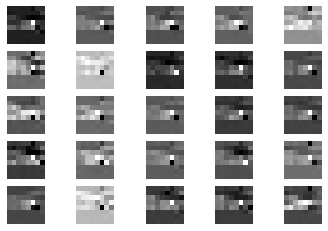

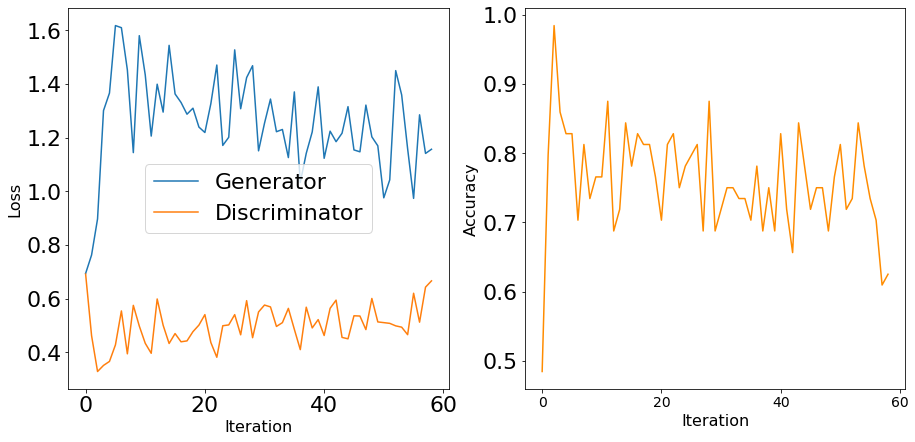

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5801 [D loss: 0.563772, acc.: 70.31%] [G loss: 1.043984]
5802 [D loss: 0.585864, acc.: 59.38%] [G loss: 1.092836]
5803 [D loss: 0.611134, acc.: 62.50%] [G loss: 1.110557]
5804 [D loss: 0.557825, acc.: 70.31%] [G loss: 1.104548]
5805 [D loss: 0.597613, acc.: 71.88%] [G loss: 1.144266]
5806 [D loss: 0.532149, acc.: 68.75%] [G loss: 1.051890]
5807 [D loss: 0.584695, acc.: 68.75%] [G loss: 1.015763]
5808 [D loss: 0.550754, acc.: 68.75%] [G loss: 1.005320]
5809 [D loss: 0.553744, acc.: 70.31%] [G loss: 1.102876]
5810 [D loss: 0.453812, acc.: 78.12%] [G loss: 1.118840]
5811 [D loss: 0.593188, acc.: 68.75%] [G loss: 1.242468]
5812 [D loss: 0.495275, acc.: 79.69%] [G loss: 1.285441]
5813 [D loss: 0.588465, acc.: 65.62%] [G loss: 1.088969]
5814 [D loss: 0.614128, acc.: 60.94%] [G loss: 1.037081]
5815 [D loss: 0.558462, acc.: 67.19%] [G loss: 0.949262]
5816 [D loss: 0.583998, acc.: 70.31%] [G loss: 1.087284]
5817 [D loss: 0.537634, acc.: 70.31%] [G loss: 1.092272]
5818 [D loss: 0.638404, acc.: 6

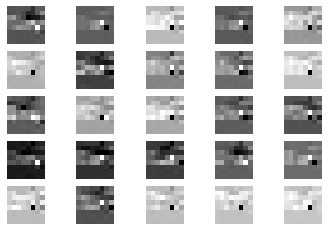

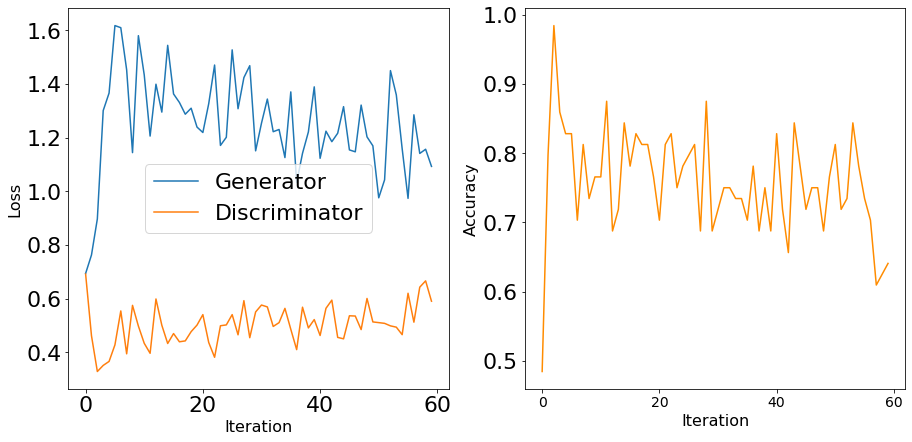

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


5901 [D loss: 0.685142, acc.: 59.38%] [G loss: 0.947789]
5902 [D loss: 0.611547, acc.: 65.62%] [G loss: 1.082300]
5903 [D loss: 0.627499, acc.: 68.75%] [G loss: 0.973779]
5904 [D loss: 0.606439, acc.: 65.62%] [G loss: 1.230883]
5905 [D loss: 0.587733, acc.: 67.19%] [G loss: 1.089607]
5906 [D loss: 0.604617, acc.: 68.75%] [G loss: 1.074943]
5907 [D loss: 0.596887, acc.: 71.88%] [G loss: 1.041650]
5908 [D loss: 0.595621, acc.: 71.88%] [G loss: 1.235789]
5909 [D loss: 0.552441, acc.: 70.31%] [G loss: 1.142504]
5910 [D loss: 0.568365, acc.: 71.88%] [G loss: 1.138660]
5911 [D loss: 0.560528, acc.: 70.31%] [G loss: 1.210513]
5912 [D loss: 0.626525, acc.: 64.06%] [G loss: 1.068273]
5913 [D loss: 0.528981, acc.: 73.44%] [G loss: 1.039173]
5914 [D loss: 0.659953, acc.: 64.06%] [G loss: 1.099161]
5915 [D loss: 0.647519, acc.: 64.06%] [G loss: 0.898319]
5916 [D loss: 0.634306, acc.: 57.81%] [G loss: 1.006470]
5917 [D loss: 0.465137, acc.: 79.69%] [G loss: 1.193775]
5918 [D loss: 0.506162, acc.: 7

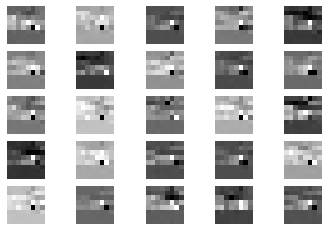

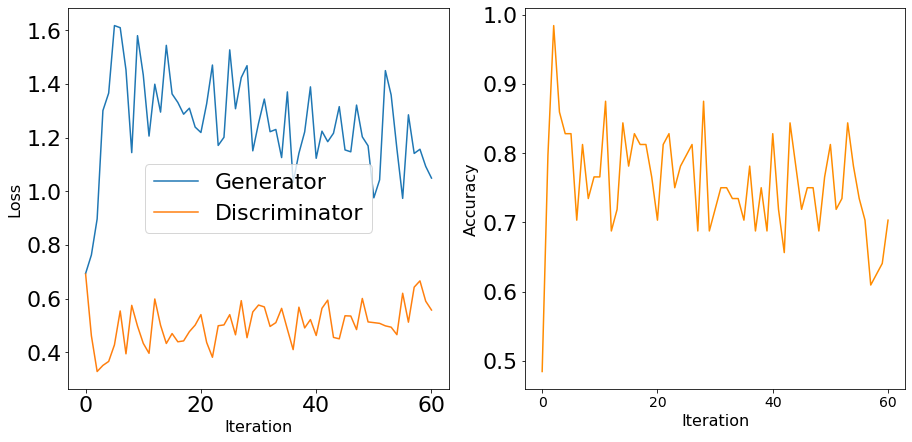

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6001 [D loss: 0.548791, acc.: 68.75%] [G loss: 1.181227]
6002 [D loss: 0.650655, acc.: 65.62%] [G loss: 1.051974]
6003 [D loss: 0.505558, acc.: 71.88%] [G loss: 1.123100]
6004 [D loss: 0.635624, acc.: 67.19%] [G loss: 1.137187]
6005 [D loss: 0.529205, acc.: 70.31%] [G loss: 1.215849]
6006 [D loss: 0.618026, acc.: 60.94%] [G loss: 1.333231]
6007 [D loss: 0.581428, acc.: 70.31%] [G loss: 1.108855]
6008 [D loss: 0.575354, acc.: 64.06%] [G loss: 1.194464]
6009 [D loss: 0.623852, acc.: 64.06%] [G loss: 1.023126]
6010 [D loss: 0.518344, acc.: 76.56%] [G loss: 1.209379]
6011 [D loss: 0.579831, acc.: 64.06%] [G loss: 1.120208]
6012 [D loss: 0.663377, acc.: 62.50%] [G loss: 1.075255]
6013 [D loss: 0.634366, acc.: 64.06%] [G loss: 1.224804]
6014 [D loss: 0.583982, acc.: 67.19%] [G loss: 1.194084]
6015 [D loss: 0.618500, acc.: 65.62%] [G loss: 1.055278]
6016 [D loss: 0.505039, acc.: 71.88%] [G loss: 1.206344]
6017 [D loss: 0.649065, acc.: 60.94%] [G loss: 0.979347]
6018 [D loss: 0.578945, acc.: 6

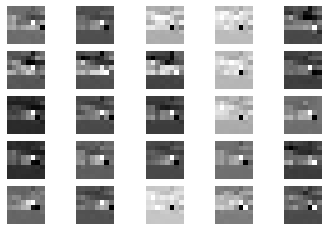

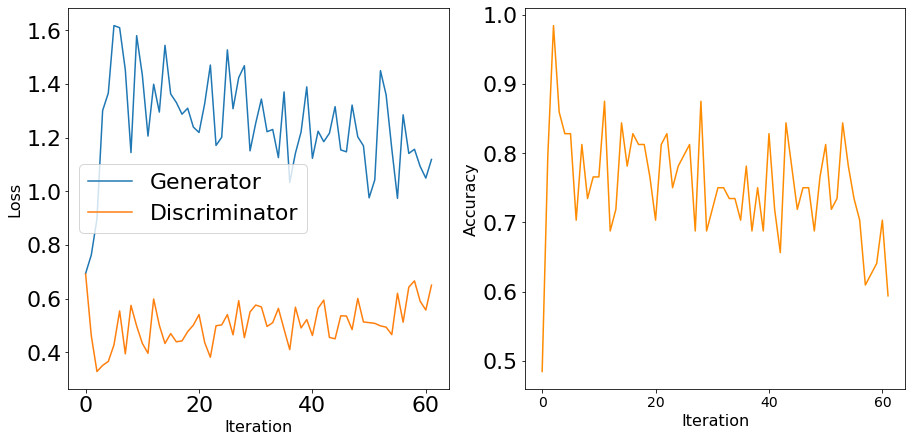

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6101 [D loss: 0.560295, acc.: 71.88%] [G loss: 1.057078]
6102 [D loss: 0.521203, acc.: 73.44%] [G loss: 1.188550]
6103 [D loss: 0.519111, acc.: 73.44%] [G loss: 1.299523]
6104 [D loss: 0.632942, acc.: 54.69%] [G loss: 1.135030]
6105 [D loss: 0.588566, acc.: 62.50%] [G loss: 1.097311]
6106 [D loss: 0.579132, acc.: 71.88%] [G loss: 0.985510]
6107 [D loss: 0.503024, acc.: 71.88%] [G loss: 1.174562]
6108 [D loss: 0.623903, acc.: 62.50%] [G loss: 1.010052]
6109 [D loss: 0.536662, acc.: 67.19%] [G loss: 1.108423]
6110 [D loss: 0.566443, acc.: 64.06%] [G loss: 1.126688]
6111 [D loss: 0.613041, acc.: 68.75%] [G loss: 1.194459]
6112 [D loss: 0.657272, acc.: 64.06%] [G loss: 1.150478]
6113 [D loss: 0.595926, acc.: 65.62%] [G loss: 1.040973]
6114 [D loss: 0.551919, acc.: 68.75%] [G loss: 1.344654]
6115 [D loss: 0.564820, acc.: 68.75%] [G loss: 0.867979]
6116 [D loss: 0.577509, acc.: 64.06%] [G loss: 0.886496]
6117 [D loss: 0.525385, acc.: 70.31%] [G loss: 1.053601]
6118 [D loss: 0.654202, acc.: 6

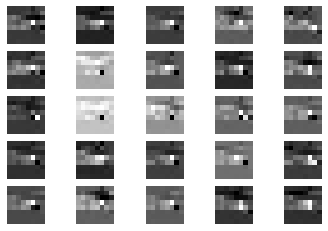

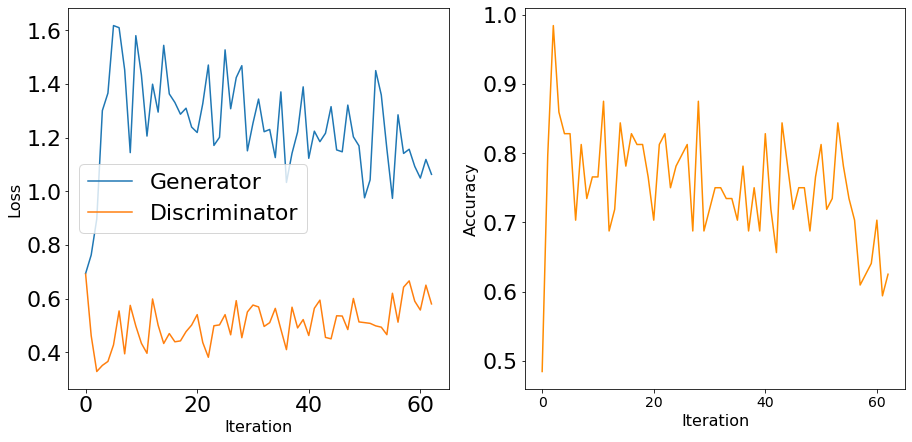

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6201 [D loss: 0.600916, acc.: 67.19%] [G loss: 1.242553]
6202 [D loss: 0.533372, acc.: 73.44%] [G loss: 1.024351]
6203 [D loss: 0.611793, acc.: 62.50%] [G loss: 1.032115]
6204 [D loss: 0.635903, acc.: 65.62%] [G loss: 1.216018]
6205 [D loss: 0.557376, acc.: 65.62%] [G loss: 1.200940]
6206 [D loss: 0.699910, acc.: 60.94%] [G loss: 1.150847]
6207 [D loss: 0.728265, acc.: 56.25%] [G loss: 1.073394]
6208 [D loss: 0.566736, acc.: 71.88%] [G loss: 0.982030]
6209 [D loss: 0.624149, acc.: 67.19%] [G loss: 0.902532]
6210 [D loss: 0.520830, acc.: 75.00%] [G loss: 1.190536]
6211 [D loss: 0.570974, acc.: 70.31%] [G loss: 0.989317]
6212 [D loss: 0.551291, acc.: 70.31%] [G loss: 1.101831]
6213 [D loss: 0.617441, acc.: 68.75%] [G loss: 1.013462]
6214 [D loss: 0.540465, acc.: 76.56%] [G loss: 1.043791]
6215 [D loss: 0.590872, acc.: 67.19%] [G loss: 0.862115]
6216 [D loss: 0.550593, acc.: 70.31%] [G loss: 1.033127]
6217 [D loss: 0.671359, acc.: 64.06%] [G loss: 1.033617]
6218 [D loss: 0.632987, acc.: 6

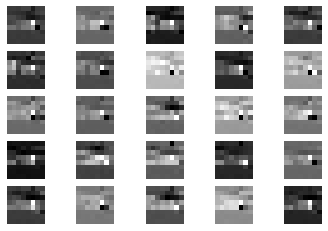

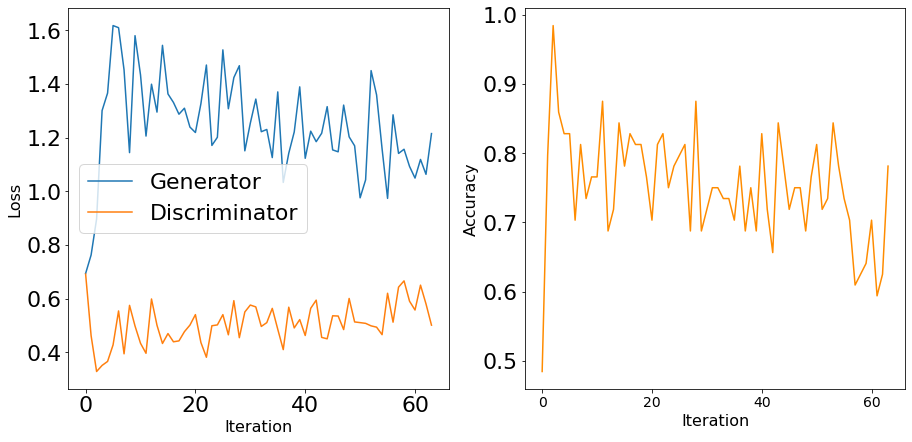

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6301 [D loss: 0.573463, acc.: 65.62%] [G loss: 1.125493]
6302 [D loss: 0.668369, acc.: 62.50%] [G loss: 0.957435]
6303 [D loss: 0.560703, acc.: 70.31%] [G loss: 0.976834]
6304 [D loss: 0.654526, acc.: 59.38%] [G loss: 1.098273]
6305 [D loss: 0.603596, acc.: 68.75%] [G loss: 0.837924]
6306 [D loss: 0.477290, acc.: 81.25%] [G loss: 1.198056]
6307 [D loss: 0.594762, acc.: 65.62%] [G loss: 1.181773]
6308 [D loss: 0.581204, acc.: 62.50%] [G loss: 1.011170]
6309 [D loss: 0.522758, acc.: 75.00%] [G loss: 1.018411]
6310 [D loss: 0.581235, acc.: 70.31%] [G loss: 1.103852]
6311 [D loss: 0.545960, acc.: 68.75%] [G loss: 1.079851]
6312 [D loss: 0.525833, acc.: 70.31%] [G loss: 1.151537]
6313 [D loss: 0.701459, acc.: 60.94%] [G loss: 1.218703]
6314 [D loss: 0.537498, acc.: 70.31%] [G loss: 1.143395]
6315 [D loss: 0.554018, acc.: 67.19%] [G loss: 1.021015]
6316 [D loss: 0.554933, acc.: 67.19%] [G loss: 1.138473]
6317 [D loss: 0.524372, acc.: 73.44%] [G loss: 1.201660]
6318 [D loss: 0.611457, acc.: 6

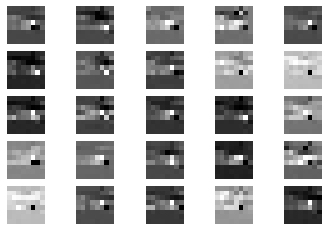

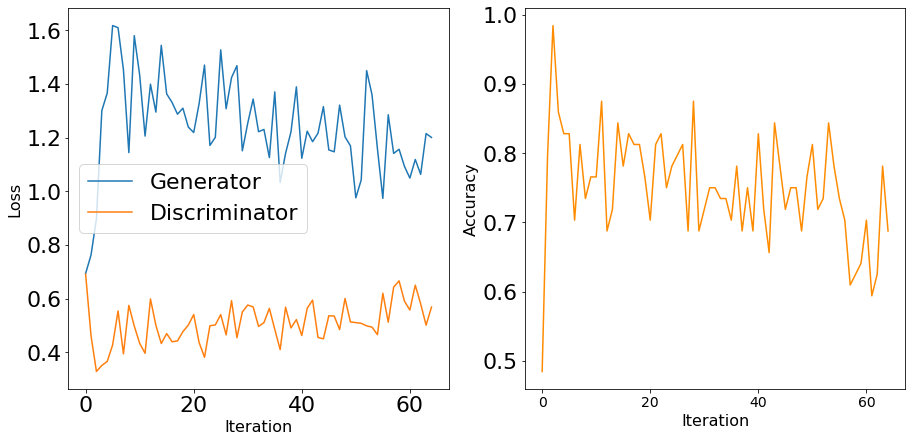

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6401 [D loss: 0.606268, acc.: 70.31%] [G loss: 0.839703]
6402 [D loss: 0.650130, acc.: 54.69%] [G loss: 1.110863]
6403 [D loss: 0.609458, acc.: 67.19%] [G loss: 0.943681]
6404 [D loss: 0.610292, acc.: 57.81%] [G loss: 0.956109]
6405 [D loss: 0.528174, acc.: 70.31%] [G loss: 1.088249]
6406 [D loss: 0.730600, acc.: 56.25%] [G loss: 1.176548]
6407 [D loss: 0.551612, acc.: 71.88%] [G loss: 1.113101]
6408 [D loss: 0.626868, acc.: 70.31%] [G loss: 1.078610]
6409 [D loss: 0.547028, acc.: 75.00%] [G loss: 0.932683]
6410 [D loss: 0.580072, acc.: 67.19%] [G loss: 0.886772]
6411 [D loss: 0.661616, acc.: 59.38%] [G loss: 1.074893]
6412 [D loss: 0.614129, acc.: 59.38%] [G loss: 1.062475]
6413 [D loss: 0.596715, acc.: 68.75%] [G loss: 1.044485]
6414 [D loss: 0.592039, acc.: 70.31%] [G loss: 0.926221]
6415 [D loss: 0.754590, acc.: 60.94%] [G loss: 0.931976]
6416 [D loss: 0.532631, acc.: 70.31%] [G loss: 1.122171]
6417 [D loss: 0.578396, acc.: 65.62%] [G loss: 1.084768]
6418 [D loss: 0.557231, acc.: 6

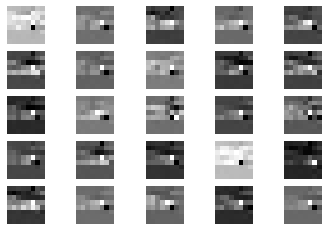

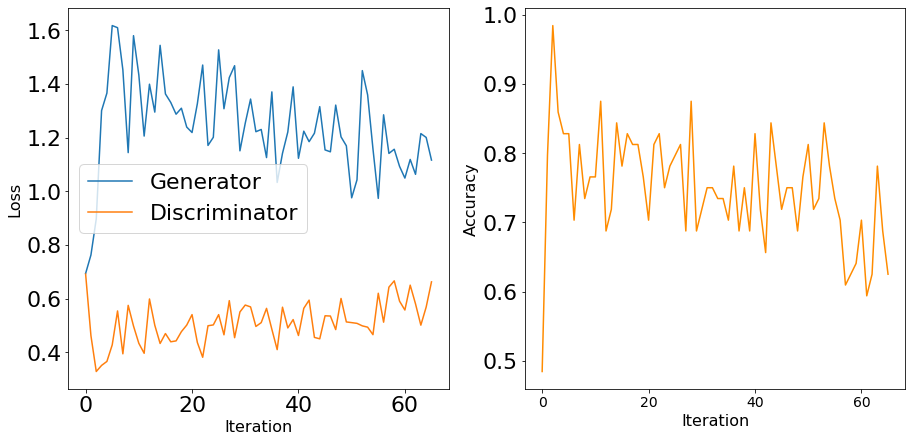

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6501 [D loss: 0.627172, acc.: 60.94%] [G loss: 1.217175]
6502 [D loss: 0.587411, acc.: 64.06%] [G loss: 1.125283]
6503 [D loss: 0.485602, acc.: 78.12%] [G loss: 1.182094]
6504 [D loss: 0.496960, acc.: 84.38%] [G loss: 1.156817]
6505 [D loss: 0.668637, acc.: 62.50%] [G loss: 1.085276]
6506 [D loss: 0.544194, acc.: 71.88%] [G loss: 1.073168]
6507 [D loss: 0.647894, acc.: 62.50%] [G loss: 0.991603]
6508 [D loss: 0.564517, acc.: 73.44%] [G loss: 0.956108]
6509 [D loss: 0.661791, acc.: 57.81%] [G loss: 1.116244]
6510 [D loss: 0.615553, acc.: 75.00%] [G loss: 1.254386]
6511 [D loss: 0.610689, acc.: 68.75%] [G loss: 1.020565]
6512 [D loss: 0.592376, acc.: 65.62%] [G loss: 1.038838]
6513 [D loss: 0.633871, acc.: 64.06%] [G loss: 1.057483]
6514 [D loss: 0.590933, acc.: 70.31%] [G loss: 1.032847]
6515 [D loss: 0.612357, acc.: 64.06%] [G loss: 1.165319]
6516 [D loss: 0.628947, acc.: 62.50%] [G loss: 0.938242]
6517 [D loss: 0.577696, acc.: 68.75%] [G loss: 1.128727]
6518 [D loss: 0.588619, acc.: 7

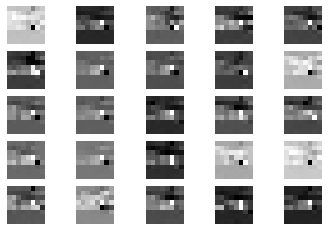

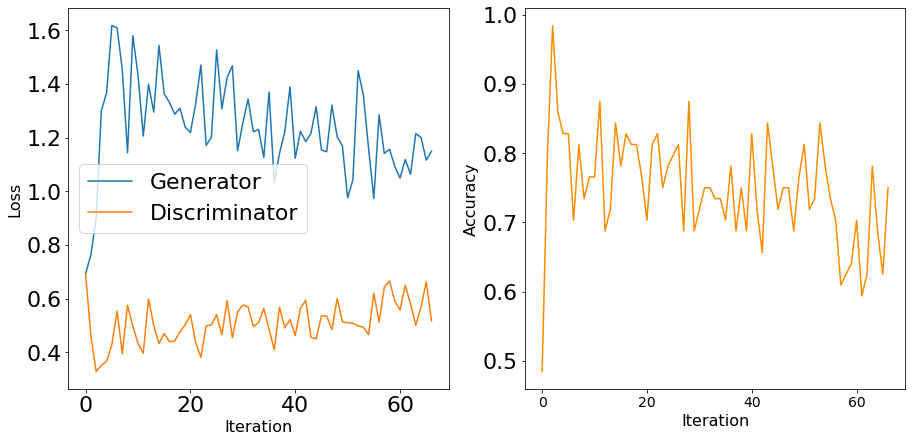

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6601 [D loss: 0.583052, acc.: 70.31%] [G loss: 1.230623]
6602 [D loss: 0.537598, acc.: 76.56%] [G loss: 1.298091]
6603 [D loss: 0.502620, acc.: 75.00%] [G loss: 1.087885]
6604 [D loss: 0.586332, acc.: 68.75%] [G loss: 0.979315]
6605 [D loss: 0.563335, acc.: 73.44%] [G loss: 0.975689]
6606 [D loss: 0.509853, acc.: 75.00%] [G loss: 1.184156]
6607 [D loss: 0.575477, acc.: 68.75%] [G loss: 1.251536]
6608 [D loss: 0.645945, acc.: 71.88%] [G loss: 0.922856]
6609 [D loss: 0.616480, acc.: 67.19%] [G loss: 1.204600]
6610 [D loss: 0.573165, acc.: 71.88%] [G loss: 1.059245]
6611 [D loss: 0.562370, acc.: 68.75%] [G loss: 1.049503]
6612 [D loss: 0.563005, acc.: 68.75%] [G loss: 1.116543]
6613 [D loss: 0.674200, acc.: 56.25%] [G loss: 1.090858]
6614 [D loss: 0.619520, acc.: 62.50%] [G loss: 1.133081]
6615 [D loss: 0.542132, acc.: 81.25%] [G loss: 1.016508]
6616 [D loss: 0.622987, acc.: 68.75%] [G loss: 0.880661]
6617 [D loss: 0.582340, acc.: 71.88%] [G loss: 1.198177]
6618 [D loss: 0.718314, acc.: 5

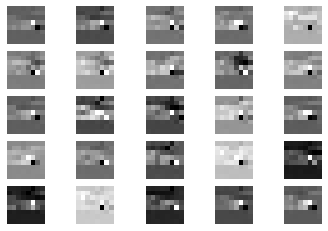

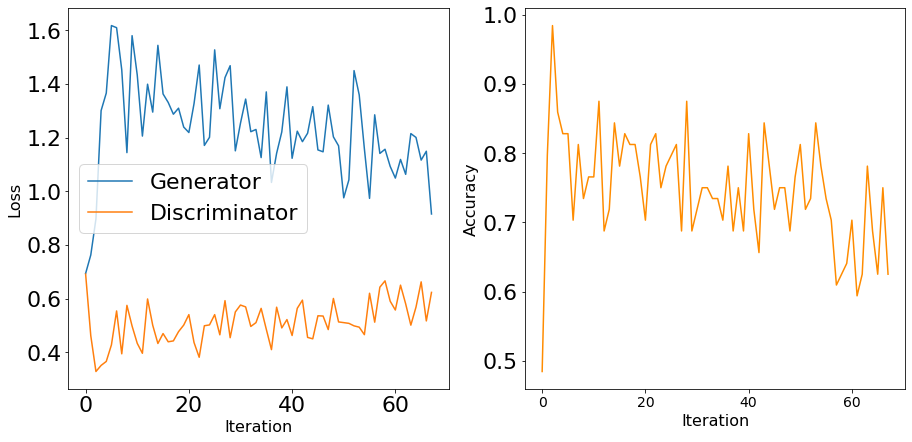

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6701 [D loss: 0.631649, acc.: 57.81%] [G loss: 1.069024]
6702 [D loss: 0.599217, acc.: 73.44%] [G loss: 1.011258]
6703 [D loss: 0.556098, acc.: 65.62%] [G loss: 1.043687]
6704 [D loss: 0.618317, acc.: 73.44%] [G loss: 0.956393]
6705 [D loss: 0.614872, acc.: 68.75%] [G loss: 1.042162]
6706 [D loss: 0.539119, acc.: 73.44%] [G loss: 1.122064]
6707 [D loss: 0.712446, acc.: 50.00%] [G loss: 0.902277]
6708 [D loss: 0.567330, acc.: 65.62%] [G loss: 1.068206]
6709 [D loss: 0.637556, acc.: 67.19%] [G loss: 0.950795]
6710 [D loss: 0.600578, acc.: 68.75%] [G loss: 0.921510]
6711 [D loss: 0.685111, acc.: 60.94%] [G loss: 1.030801]
6712 [D loss: 0.558448, acc.: 70.31%] [G loss: 1.172796]
6713 [D loss: 0.644996, acc.: 59.38%] [G loss: 0.984826]
6714 [D loss: 0.516509, acc.: 81.25%] [G loss: 1.007602]
6715 [D loss: 0.558108, acc.: 71.88%] [G loss: 1.124035]
6716 [D loss: 0.626835, acc.: 62.50%] [G loss: 1.060070]
6717 [D loss: 0.626094, acc.: 62.50%] [G loss: 1.185910]
6718 [D loss: 0.584441, acc.: 7

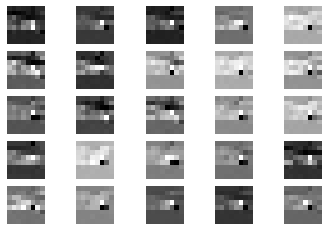

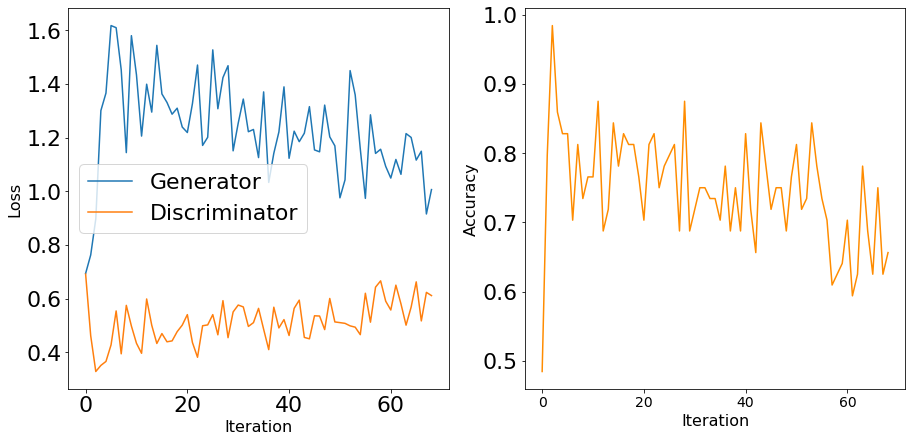

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6801 [D loss: 0.570907, acc.: 71.88%] [G loss: 0.947654]
6802 [D loss: 0.610939, acc.: 65.62%] [G loss: 0.957918]
6803 [D loss: 0.664639, acc.: 57.81%] [G loss: 1.140256]
6804 [D loss: 0.617600, acc.: 67.19%] [G loss: 1.085017]
6805 [D loss: 0.502579, acc.: 75.00%] [G loss: 0.881426]
6806 [D loss: 0.643873, acc.: 67.19%] [G loss: 1.151132]
6807 [D loss: 0.645761, acc.: 62.50%] [G loss: 1.071494]
6808 [D loss: 0.590261, acc.: 62.50%] [G loss: 1.078329]
6809 [D loss: 0.725375, acc.: 57.81%] [G loss: 0.955163]
6810 [D loss: 0.611701, acc.: 67.19%] [G loss: 0.982606]
6811 [D loss: 0.618131, acc.: 64.06%] [G loss: 1.148648]
6812 [D loss: 0.532421, acc.: 81.25%] [G loss: 1.029798]
6813 [D loss: 0.578118, acc.: 70.31%] [G loss: 0.890162]
6814 [D loss: 0.549742, acc.: 71.88%] [G loss: 0.959490]
6815 [D loss: 0.559997, acc.: 70.31%] [G loss: 0.919005]
6816 [D loss: 0.562903, acc.: 70.31%] [G loss: 1.107862]
6817 [D loss: 0.603082, acc.: 68.75%] [G loss: 1.045178]
6818 [D loss: 0.617761, acc.: 6

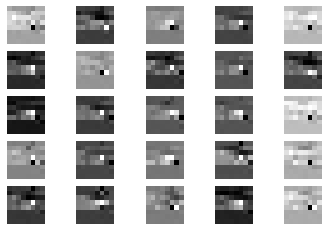

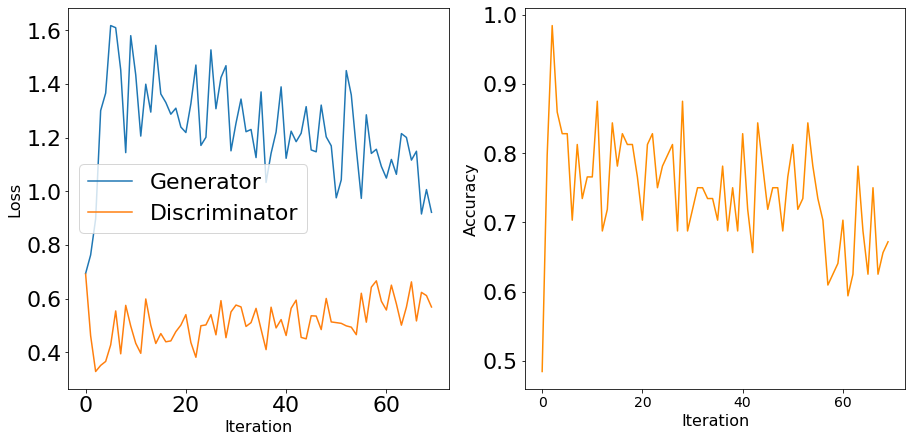

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


6901 [D loss: 0.576918, acc.: 65.62%] [G loss: 0.933363]
6902 [D loss: 0.636001, acc.: 67.19%] [G loss: 0.978983]
6903 [D loss: 0.578991, acc.: 67.19%] [G loss: 0.926074]
6904 [D loss: 0.560621, acc.: 67.19%] [G loss: 1.023400]
6905 [D loss: 0.560899, acc.: 75.00%] [G loss: 0.927869]
6906 [D loss: 0.565075, acc.: 68.75%] [G loss: 1.183880]
6907 [D loss: 0.583212, acc.: 64.06%] [G loss: 0.972243]
6908 [D loss: 0.599122, acc.: 73.44%] [G loss: 1.178996]
6909 [D loss: 0.598590, acc.: 65.62%] [G loss: 1.102063]
6910 [D loss: 0.636107, acc.: 62.50%] [G loss: 1.081614]
6911 [D loss: 0.653769, acc.: 60.94%] [G loss: 1.052071]
6912 [D loss: 0.534813, acc.: 82.81%] [G loss: 1.057207]
6913 [D loss: 0.565818, acc.: 75.00%] [G loss: 1.068881]
6914 [D loss: 0.665977, acc.: 59.38%] [G loss: 0.964267]
6915 [D loss: 0.589449, acc.: 68.75%] [G loss: 0.961184]
6916 [D loss: 0.617761, acc.: 62.50%] [G loss: 1.077356]
6917 [D loss: 0.533578, acc.: 68.75%] [G loss: 0.931399]
6918 [D loss: 0.571814, acc.: 6

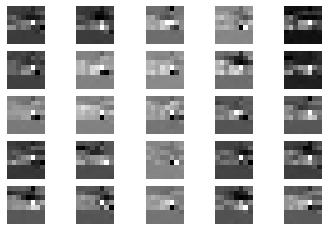

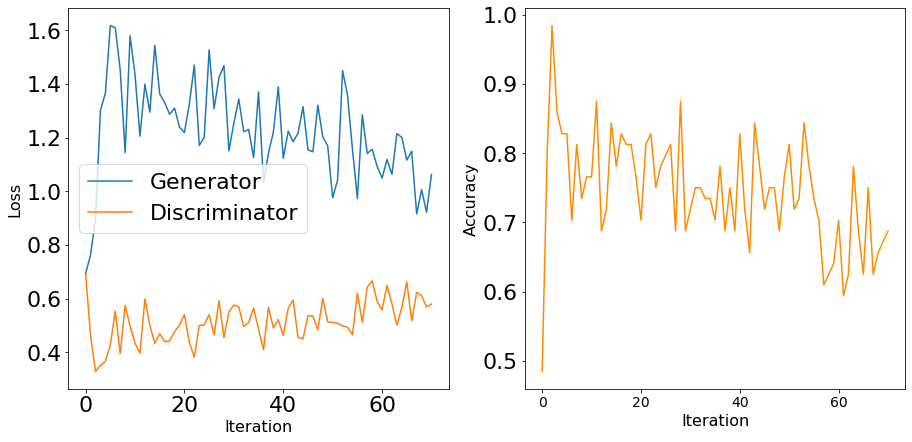

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7001 [D loss: 0.613388, acc.: 64.06%] [G loss: 0.945733]
7002 [D loss: 0.630142, acc.: 64.06%] [G loss: 0.889363]
7003 [D loss: 0.569140, acc.: 76.56%] [G loss: 0.995512]
7004 [D loss: 0.618448, acc.: 65.62%] [G loss: 0.909641]
7005 [D loss: 0.501008, acc.: 76.56%] [G loss: 1.042370]
7006 [D loss: 0.638421, acc.: 59.38%] [G loss: 0.856981]
7007 [D loss: 0.598418, acc.: 70.31%] [G loss: 0.953669]
7008 [D loss: 0.649187, acc.: 57.81%] [G loss: 1.206815]
7009 [D loss: 0.608110, acc.: 68.75%] [G loss: 1.078585]
7010 [D loss: 0.672174, acc.: 64.06%] [G loss: 1.021956]
7011 [D loss: 0.536479, acc.: 75.00%] [G loss: 1.165781]
7012 [D loss: 0.563620, acc.: 71.88%] [G loss: 1.095633]
7013 [D loss: 0.537668, acc.: 76.56%] [G loss: 1.088873]
7014 [D loss: 0.586335, acc.: 68.75%] [G loss: 0.998778]
7015 [D loss: 0.533587, acc.: 70.31%] [G loss: 1.163903]
7016 [D loss: 0.600532, acc.: 65.62%] [G loss: 0.934094]
7017 [D loss: 0.639177, acc.: 67.19%] [G loss: 0.910362]
7018 [D loss: 0.639940, acc.: 6

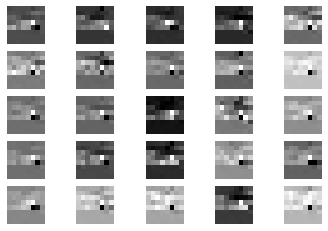

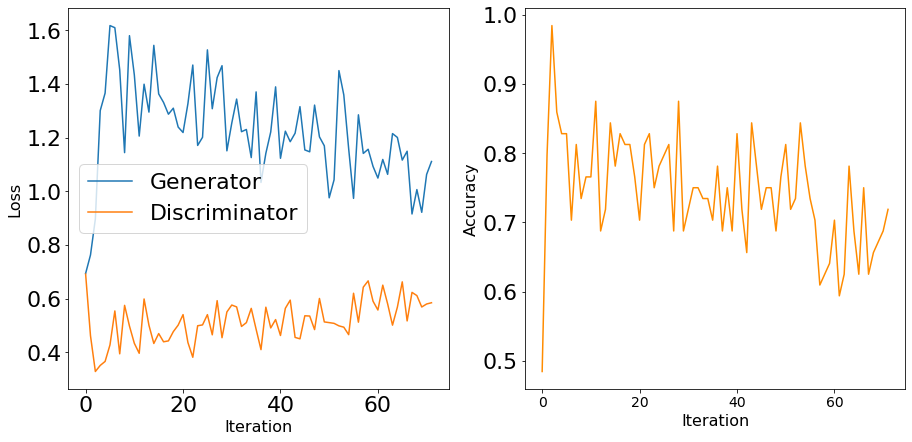

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7101 [D loss: 0.579680, acc.: 68.75%] [G loss: 1.111255]
7102 [D loss: 0.597841, acc.: 60.94%] [G loss: 0.850962]
7103 [D loss: 0.700173, acc.: 53.12%] [G loss: 0.937154]
7104 [D loss: 0.592894, acc.: 73.44%] [G loss: 1.019885]
7105 [D loss: 0.699256, acc.: 56.25%] [G loss: 1.024146]
7106 [D loss: 0.621814, acc.: 64.06%] [G loss: 0.953017]
7107 [D loss: 0.540856, acc.: 75.00%] [G loss: 1.016262]
7108 [D loss: 0.616757, acc.: 68.75%] [G loss: 1.035367]
7109 [D loss: 0.583166, acc.: 67.19%] [G loss: 1.064627]
7110 [D loss: 0.632161, acc.: 65.62%] [G loss: 1.059980]
7111 [D loss: 0.613203, acc.: 60.94%] [G loss: 1.012326]
7112 [D loss: 0.593478, acc.: 65.62%] [G loss: 1.066065]
7113 [D loss: 0.558416, acc.: 65.62%] [G loss: 0.965480]
7114 [D loss: 0.558701, acc.: 67.19%] [G loss: 1.134833]
7115 [D loss: 0.652889, acc.: 64.06%] [G loss: 0.999215]
7116 [D loss: 0.603397, acc.: 67.19%] [G loss: 1.049764]
7117 [D loss: 0.603631, acc.: 68.75%] [G loss: 1.208093]
7118 [D loss: 0.563070, acc.: 7

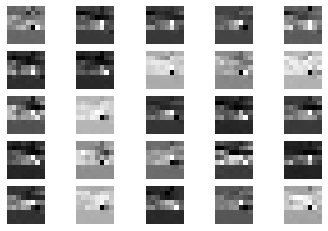

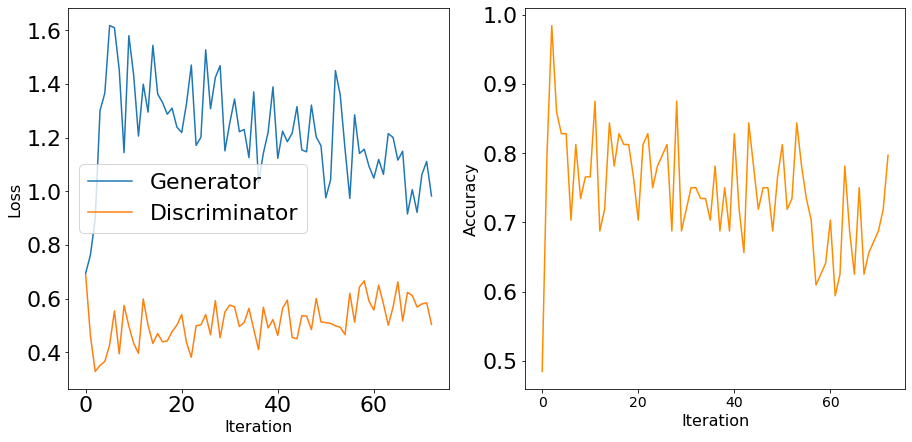

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7201 [D loss: 0.566039, acc.: 73.44%] [G loss: 0.914650]
7202 [D loss: 0.641477, acc.: 65.62%] [G loss: 0.918899]
7203 [D loss: 0.621720, acc.: 67.19%] [G loss: 0.951219]
7204 [D loss: 0.575566, acc.: 65.62%] [G loss: 1.070701]
7205 [D loss: 0.591660, acc.: 59.38%] [G loss: 0.888999]
7206 [D loss: 0.609769, acc.: 68.75%] [G loss: 1.039692]
7207 [D loss: 0.585849, acc.: 70.31%] [G loss: 1.037147]
7208 [D loss: 0.518358, acc.: 75.00%] [G loss: 0.974152]
7209 [D loss: 0.599792, acc.: 56.25%] [G loss: 1.000249]
7210 [D loss: 0.629037, acc.: 65.62%] [G loss: 0.942420]
7211 [D loss: 0.600976, acc.: 70.31%] [G loss: 0.838567]
7212 [D loss: 0.628631, acc.: 59.38%] [G loss: 1.208562]
7213 [D loss: 0.647586, acc.: 62.50%] [G loss: 1.072199]
7214 [D loss: 0.683278, acc.: 64.06%] [G loss: 1.051014]
7215 [D loss: 0.603733, acc.: 68.75%] [G loss: 1.148635]
7216 [D loss: 0.552299, acc.: 70.31%] [G loss: 1.073091]
7217 [D loss: 0.539781, acc.: 73.44%] [G loss: 0.991451]
7218 [D loss: 0.571099, acc.: 7

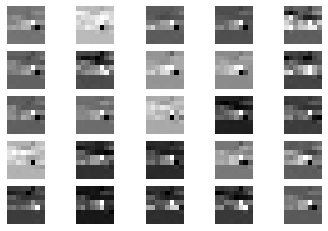

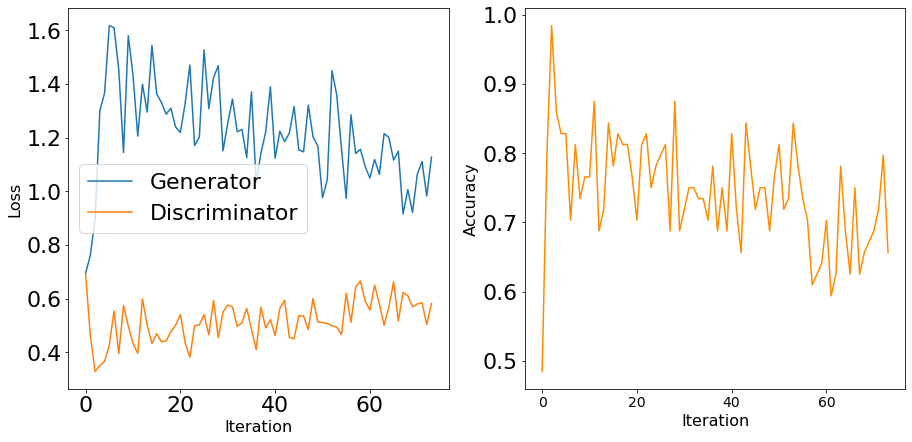

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7301 [D loss: 0.637004, acc.: 59.38%] [G loss: 0.945070]
7302 [D loss: 0.567712, acc.: 73.44%] [G loss: 0.924814]
7303 [D loss: 0.627301, acc.: 65.62%] [G loss: 0.968299]
7304 [D loss: 0.609546, acc.: 56.25%] [G loss: 0.913506]
7305 [D loss: 0.671468, acc.: 62.50%] [G loss: 0.938531]
7306 [D loss: 0.612508, acc.: 60.94%] [G loss: 1.045763]
7307 [D loss: 0.601489, acc.: 67.19%] [G loss: 0.959235]
7308 [D loss: 0.673758, acc.: 62.50%] [G loss: 1.102635]
7309 [D loss: 0.618371, acc.: 62.50%] [G loss: 1.126341]
7310 [D loss: 0.587915, acc.: 64.06%] [G loss: 1.112802]
7311 [D loss: 0.549900, acc.: 68.75%] [G loss: 1.057876]
7312 [D loss: 0.628167, acc.: 60.94%] [G loss: 1.199019]
7313 [D loss: 0.599948, acc.: 67.19%] [G loss: 1.063817]
7314 [D loss: 0.631912, acc.: 65.62%] [G loss: 0.914785]
7315 [D loss: 0.553012, acc.: 70.31%] [G loss: 0.936729]
7316 [D loss: 0.593241, acc.: 65.62%] [G loss: 1.046509]
7317 [D loss: 0.566628, acc.: 67.19%] [G loss: 1.175738]
7318 [D loss: 0.603976, acc.: 6

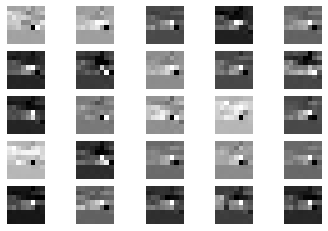

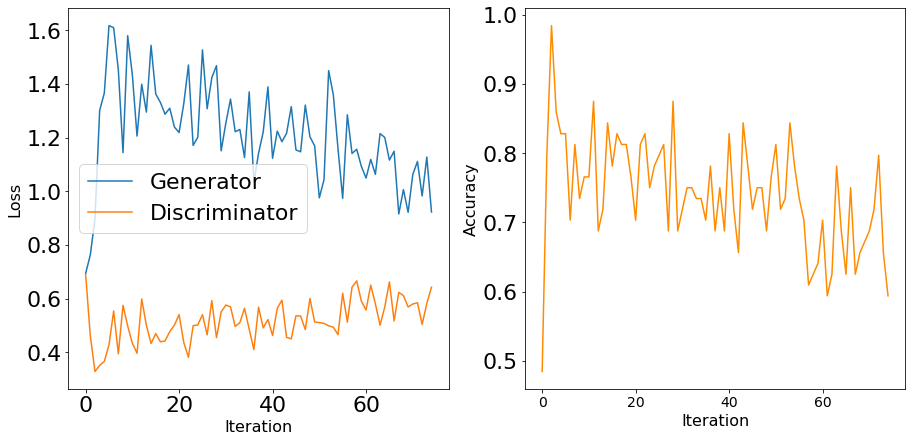

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7401 [D loss: 0.491177, acc.: 73.44%] [G loss: 0.892804]
7402 [D loss: 0.635027, acc.: 60.94%] [G loss: 1.104945]
7403 [D loss: 0.588576, acc.: 68.75%] [G loss: 0.960448]
7404 [D loss: 0.569881, acc.: 67.19%] [G loss: 0.936377]
7405 [D loss: 0.586949, acc.: 64.06%] [G loss: 1.083235]
7406 [D loss: 0.494300, acc.: 79.69%] [G loss: 1.122957]
7407 [D loss: 0.596447, acc.: 67.19%] [G loss: 1.067038]
7408 [D loss: 0.513670, acc.: 73.44%] [G loss: 0.923638]
7409 [D loss: 0.516591, acc.: 78.12%] [G loss: 0.895720]
7410 [D loss: 0.592759, acc.: 67.19%] [G loss: 0.839713]
7411 [D loss: 0.536618, acc.: 82.81%] [G loss: 0.866538]
7412 [D loss: 0.552920, acc.: 71.88%] [G loss: 1.006124]
7413 [D loss: 0.652877, acc.: 59.38%] [G loss: 1.046148]
7414 [D loss: 0.621150, acc.: 65.62%] [G loss: 1.090935]
7415 [D loss: 0.691882, acc.: 54.69%] [G loss: 0.907778]
7416 [D loss: 0.574056, acc.: 68.75%] [G loss: 0.984564]
7417 [D loss: 0.597846, acc.: 67.19%] [G loss: 1.036514]
7418 [D loss: 0.629571, acc.: 6

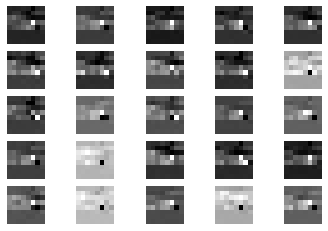

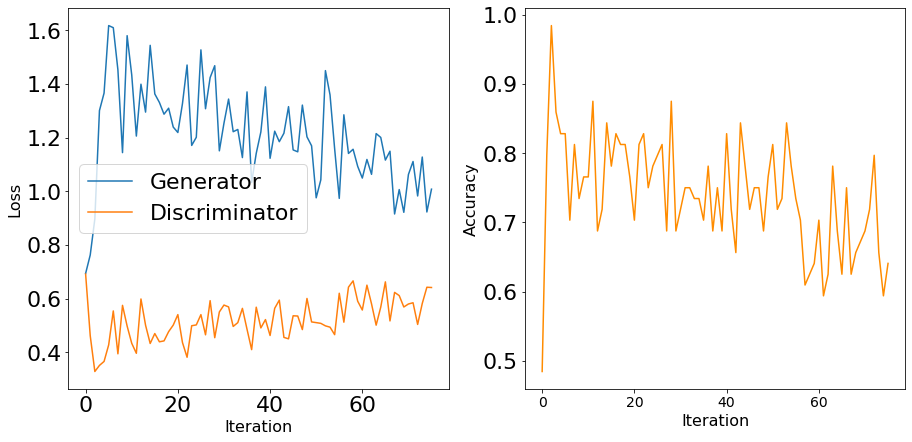

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7501 [D loss: 0.540520, acc.: 73.44%] [G loss: 0.804602]
7502 [D loss: 0.626800, acc.: 60.94%] [G loss: 0.913337]
7503 [D loss: 0.587097, acc.: 65.62%] [G loss: 0.962488]
7504 [D loss: 0.593074, acc.: 68.75%] [G loss: 1.067159]
7505 [D loss: 0.636588, acc.: 56.25%] [G loss: 0.883364]
7506 [D loss: 0.652653, acc.: 62.50%] [G loss: 1.070906]
7507 [D loss: 0.552307, acc.: 70.31%] [G loss: 1.040121]
7508 [D loss: 0.579830, acc.: 70.31%] [G loss: 0.964593]
7509 [D loss: 0.592497, acc.: 60.94%] [G loss: 0.998222]
7510 [D loss: 0.625375, acc.: 68.75%] [G loss: 1.095175]
7511 [D loss: 0.578836, acc.: 70.31%] [G loss: 1.065768]
7512 [D loss: 0.633898, acc.: 62.50%] [G loss: 1.029309]
7513 [D loss: 0.580122, acc.: 70.31%] [G loss: 1.046890]
7514 [D loss: 0.592635, acc.: 65.62%] [G loss: 0.931722]
7515 [D loss: 0.713102, acc.: 59.38%] [G loss: 0.828742]
7516 [D loss: 0.574577, acc.: 68.75%] [G loss: 0.994276]
7517 [D loss: 0.604225, acc.: 62.50%] [G loss: 1.024573]
7518 [D loss: 0.562468, acc.: 7

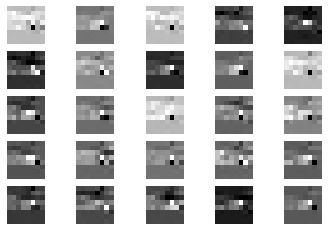

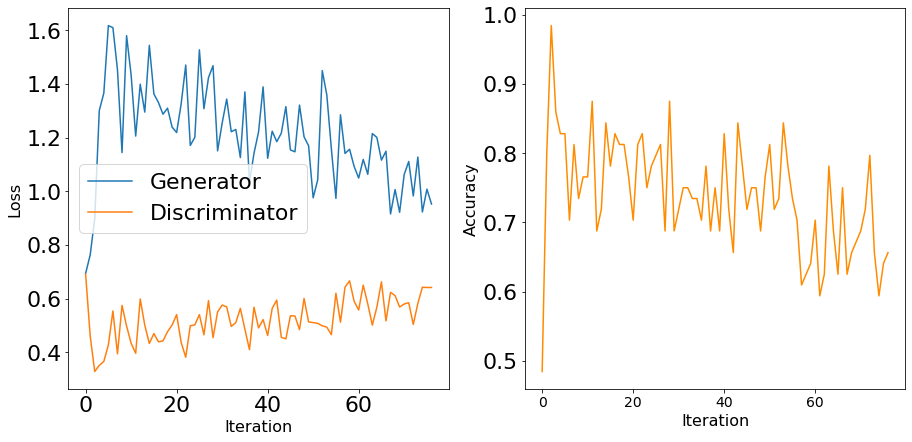

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7601 [D loss: 0.599281, acc.: 64.06%] [G loss: 1.023705]
7602 [D loss: 0.631192, acc.: 59.38%] [G loss: 0.884414]
7603 [D loss: 0.594162, acc.: 67.19%] [G loss: 0.965945]
7604 [D loss: 0.620828, acc.: 71.88%] [G loss: 1.028535]
7605 [D loss: 0.552762, acc.: 70.31%] [G loss: 1.001113]
7606 [D loss: 0.596727, acc.: 70.31%] [G loss: 1.043554]
7607 [D loss: 0.633964, acc.: 60.94%] [G loss: 1.098797]
7608 [D loss: 0.597058, acc.: 68.75%] [G loss: 1.084053]
7609 [D loss: 0.605047, acc.: 65.62%] [G loss: 0.971763]
7610 [D loss: 0.606829, acc.: 64.06%] [G loss: 1.016485]
7611 [D loss: 0.623949, acc.: 65.62%] [G loss: 1.075876]
7612 [D loss: 0.596178, acc.: 64.06%] [G loss: 0.983167]
7613 [D loss: 0.594759, acc.: 68.75%] [G loss: 1.042417]
7614 [D loss: 0.676167, acc.: 59.38%] [G loss: 1.066712]
7615 [D loss: 0.588778, acc.: 62.50%] [G loss: 0.906600]
7616 [D loss: 0.602582, acc.: 71.88%] [G loss: 0.907075]
7617 [D loss: 0.690124, acc.: 57.81%] [G loss: 1.024339]
7618 [D loss: 0.617748, acc.: 6

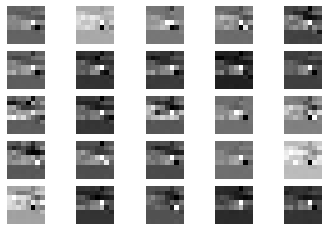

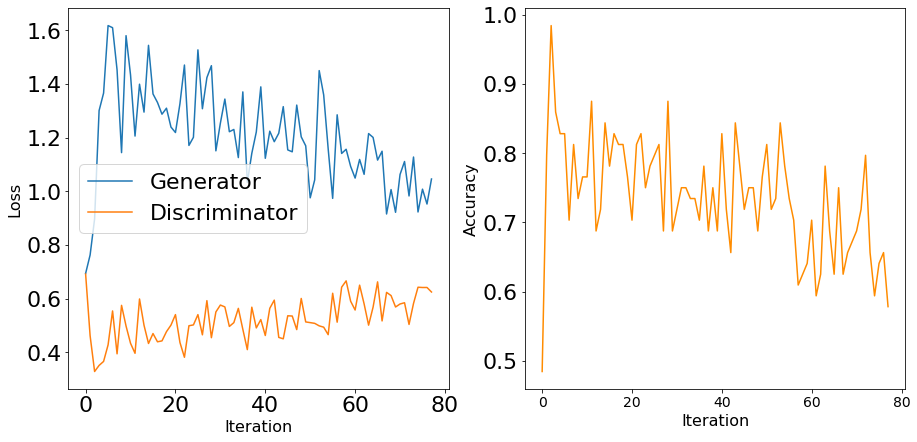

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7701 [D loss: 0.606275, acc.: 67.19%] [G loss: 1.091089]
7702 [D loss: 0.551844, acc.: 75.00%] [G loss: 1.091119]
7703 [D loss: 0.554517, acc.: 71.88%] [G loss: 0.944943]
7704 [D loss: 0.677332, acc.: 62.50%] [G loss: 0.933798]
7705 [D loss: 0.529229, acc.: 68.75%] [G loss: 0.907341]
7706 [D loss: 0.569741, acc.: 71.88%] [G loss: 0.953200]
7707 [D loss: 0.582040, acc.: 71.88%] [G loss: 1.008340]
7708 [D loss: 0.603944, acc.: 67.19%] [G loss: 0.969704]
7709 [D loss: 0.548318, acc.: 70.31%] [G loss: 1.138808]
7710 [D loss: 0.542992, acc.: 76.56%] [G loss: 0.891557]
7711 [D loss: 0.613718, acc.: 64.06%] [G loss: 0.922624]
7712 [D loss: 0.542997, acc.: 68.75%] [G loss: 0.908214]
7713 [D loss: 0.571583, acc.: 76.56%] [G loss: 0.966868]
7714 [D loss: 0.601020, acc.: 68.75%] [G loss: 0.870195]
7715 [D loss: 0.573935, acc.: 70.31%] [G loss: 1.024279]
7716 [D loss: 0.557187, acc.: 68.75%] [G loss: 0.965522]
7717 [D loss: 0.653306, acc.: 60.94%] [G loss: 1.034228]
7718 [D loss: 0.621421, acc.: 6

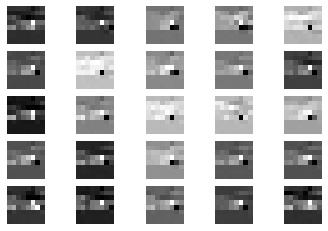

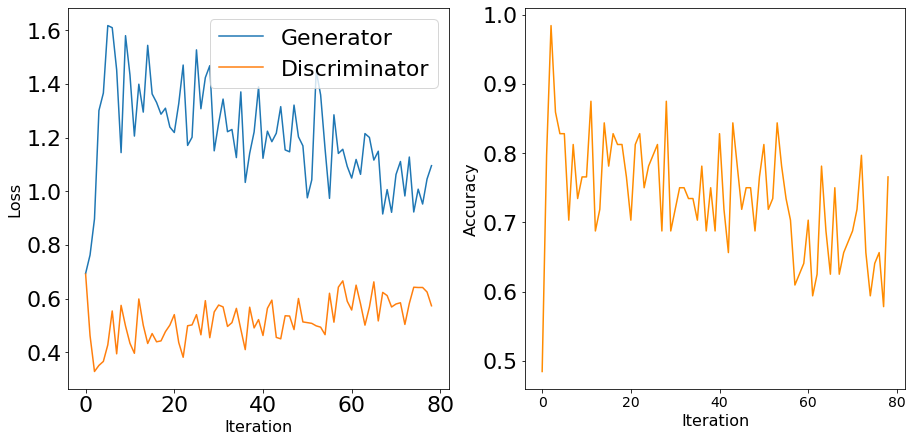

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7801 [D loss: 0.655544, acc.: 60.94%] [G loss: 1.034144]
7802 [D loss: 0.483159, acc.: 81.25%] [G loss: 0.998058]
7803 [D loss: 0.522898, acc.: 78.12%] [G loss: 0.980128]
7804 [D loss: 0.533678, acc.: 70.31%] [G loss: 0.909937]
7805 [D loss: 0.629068, acc.: 60.94%] [G loss: 0.948953]
7806 [D loss: 0.554363, acc.: 75.00%] [G loss: 1.036234]
7807 [D loss: 0.518687, acc.: 75.00%] [G loss: 0.987973]
7808 [D loss: 0.540642, acc.: 70.31%] [G loss: 1.060273]
7809 [D loss: 0.633547, acc.: 64.06%] [G loss: 1.023521]
7810 [D loss: 0.623490, acc.: 70.31%] [G loss: 0.820827]
7811 [D loss: 0.566317, acc.: 71.88%] [G loss: 0.902445]
7812 [D loss: 0.640530, acc.: 57.81%] [G loss: 0.870103]
7813 [D loss: 0.534233, acc.: 76.56%] [G loss: 0.916962]
7814 [D loss: 0.593026, acc.: 67.19%] [G loss: 0.877901]
7815 [D loss: 0.626590, acc.: 70.31%] [G loss: 0.887657]
7816 [D loss: 0.660012, acc.: 56.25%] [G loss: 1.002447]
7817 [D loss: 0.721482, acc.: 56.25%] [G loss: 0.941556]
7818 [D loss: 0.632658, acc.: 6

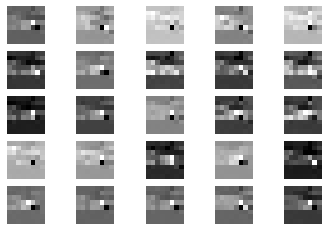

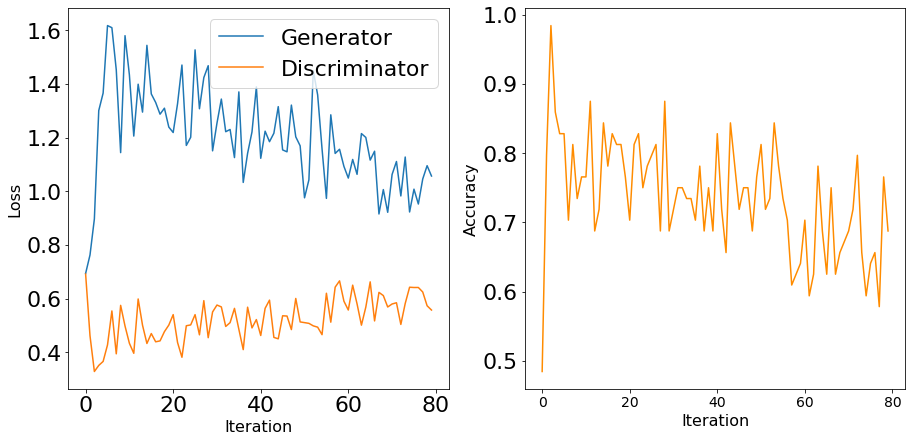

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


7901 [D loss: 0.647335, acc.: 68.75%] [G loss: 0.954119]
7902 [D loss: 0.665250, acc.: 59.38%] [G loss: 1.006525]
7903 [D loss: 0.596754, acc.: 60.94%] [G loss: 0.840842]
7904 [D loss: 0.583189, acc.: 67.19%] [G loss: 0.875366]
7905 [D loss: 0.567903, acc.: 73.44%] [G loss: 0.948880]
7906 [D loss: 0.642581, acc.: 59.38%] [G loss: 0.852489]
7907 [D loss: 0.557883, acc.: 76.56%] [G loss: 0.944611]
7908 [D loss: 0.652240, acc.: 65.62%] [G loss: 0.974007]
7909 [D loss: 0.651050, acc.: 60.94%] [G loss: 1.143717]
7910 [D loss: 0.558293, acc.: 70.31%] [G loss: 1.101613]
7911 [D loss: 0.649477, acc.: 67.19%] [G loss: 1.011078]
7912 [D loss: 0.601261, acc.: 60.94%] [G loss: 1.013399]
7913 [D loss: 0.572153, acc.: 71.88%] [G loss: 1.023243]
7914 [D loss: 0.642212, acc.: 57.81%] [G loss: 1.051997]
7915 [D loss: 0.606007, acc.: 75.00%] [G loss: 0.988060]
7916 [D loss: 0.557523, acc.: 70.31%] [G loss: 1.165944]
7917 [D loss: 0.620690, acc.: 65.62%] [G loss: 0.993510]
7918 [D loss: 0.601201, acc.: 7

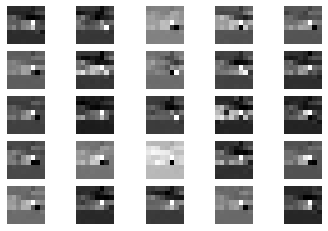

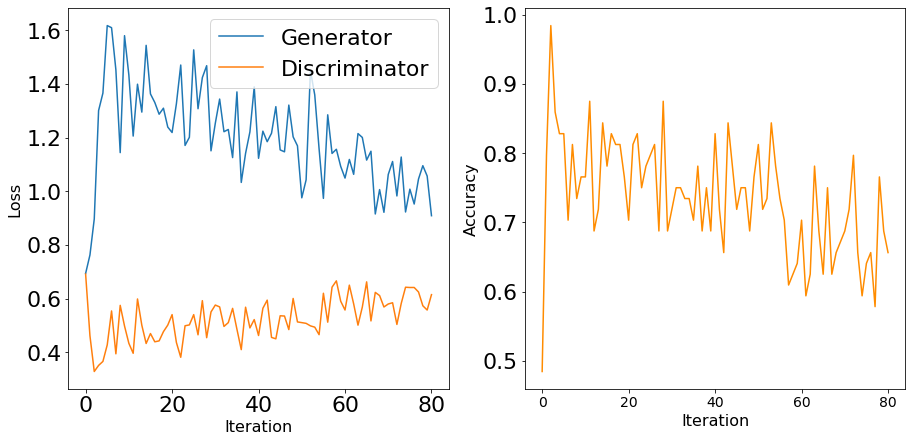

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8001 [D loss: 0.586171, acc.: 67.19%] [G loss: 1.075410]
8002 [D loss: 0.525401, acc.: 75.00%] [G loss: 1.103732]
8003 [D loss: 0.560107, acc.: 75.00%] [G loss: 0.969162]
8004 [D loss: 0.595858, acc.: 67.19%] [G loss: 0.900914]
8005 [D loss: 0.648535, acc.: 60.94%] [G loss: 1.117421]
8006 [D loss: 0.494604, acc.: 82.81%] [G loss: 0.936482]
8007 [D loss: 0.628056, acc.: 64.06%] [G loss: 0.984976]
8008 [D loss: 0.523251, acc.: 79.69%] [G loss: 1.006772]
8009 [D loss: 0.544311, acc.: 73.44%] [G loss: 0.851412]
8010 [D loss: 0.677036, acc.: 54.69%] [G loss: 0.895497]
8011 [D loss: 0.506159, acc.: 81.25%] [G loss: 0.999588]
8012 [D loss: 0.578058, acc.: 68.75%] [G loss: 1.061605]
8013 [D loss: 0.677403, acc.: 54.69%] [G loss: 1.035488]
8014 [D loss: 0.678606, acc.: 64.06%] [G loss: 0.957152]
8015 [D loss: 0.548998, acc.: 71.88%] [G loss: 0.999424]
8016 [D loss: 0.613879, acc.: 67.19%] [G loss: 0.889326]
8017 [D loss: 0.597353, acc.: 57.81%] [G loss: 0.911181]
8018 [D loss: 0.568904, acc.: 7

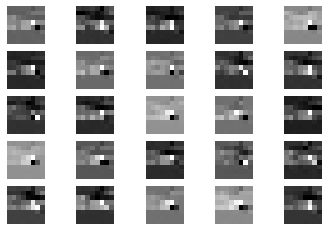

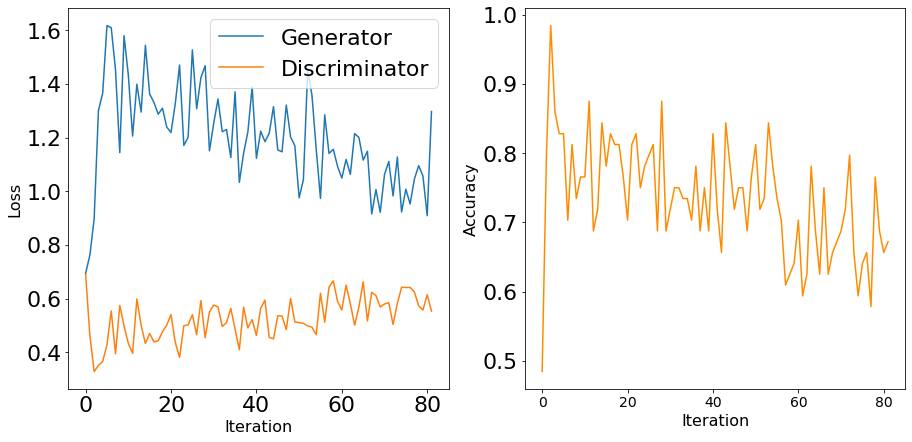

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8101 [D loss: 0.627775, acc.: 68.75%] [G loss: 1.028258]
8102 [D loss: 0.579944, acc.: 71.88%] [G loss: 1.113842]
8103 [D loss: 0.616586, acc.: 67.19%] [G loss: 1.040046]
8104 [D loss: 0.649915, acc.: 60.94%] [G loss: 1.076620]
8105 [D loss: 0.596659, acc.: 71.88%] [G loss: 0.948011]
8106 [D loss: 0.626882, acc.: 67.19%] [G loss: 1.080064]
8107 [D loss: 0.610532, acc.: 65.62%] [G loss: 0.937450]
8108 [D loss: 0.633388, acc.: 60.94%] [G loss: 0.918327]
8109 [D loss: 0.571130, acc.: 78.12%] [G loss: 0.980611]
8110 [D loss: 0.553502, acc.: 70.31%] [G loss: 1.145467]
8111 [D loss: 0.654298, acc.: 60.94%] [G loss: 1.101231]
8112 [D loss: 0.558513, acc.: 67.19%] [G loss: 1.123828]
8113 [D loss: 0.579539, acc.: 64.06%] [G loss: 0.885784]
8114 [D loss: 0.646761, acc.: 60.94%] [G loss: 0.954490]
8115 [D loss: 0.589657, acc.: 70.31%] [G loss: 1.052419]
8116 [D loss: 0.585846, acc.: 67.19%] [G loss: 1.159691]
8117 [D loss: 0.566004, acc.: 68.75%] [G loss: 1.048873]
8118 [D loss: 0.582247, acc.: 6

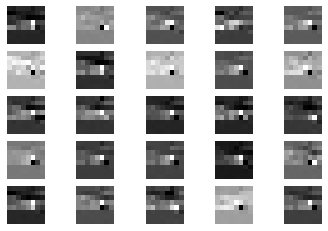

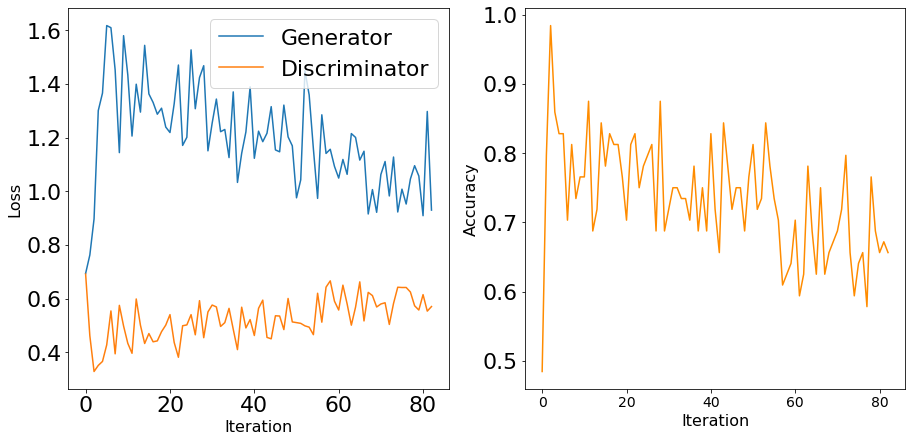

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8201 [D loss: 0.561643, acc.: 67.19%] [G loss: 1.037740]
8202 [D loss: 0.570530, acc.: 60.94%] [G loss: 1.258955]
8203 [D loss: 0.680680, acc.: 60.94%] [G loss: 1.178992]
8204 [D loss: 0.542726, acc.: 73.44%] [G loss: 1.269949]
8205 [D loss: 0.570569, acc.: 68.75%] [G loss: 0.988633]
8206 [D loss: 0.617942, acc.: 67.19%] [G loss: 0.940676]
8207 [D loss: 0.572248, acc.: 73.44%] [G loss: 0.911546]
8208 [D loss: 0.647296, acc.: 57.81%] [G loss: 0.930178]
8209 [D loss: 0.681116, acc.: 59.38%] [G loss: 0.939467]
8210 [D loss: 0.602674, acc.: 68.75%] [G loss: 0.927375]
8211 [D loss: 0.577178, acc.: 73.44%] [G loss: 1.021641]
8212 [D loss: 0.611426, acc.: 64.06%] [G loss: 1.005979]
8213 [D loss: 0.595750, acc.: 57.81%] [G loss: 0.935450]
8214 [D loss: 0.543686, acc.: 75.00%] [G loss: 0.934058]
8215 [D loss: 0.541435, acc.: 71.88%] [G loss: 1.073495]
8216 [D loss: 0.598889, acc.: 67.19%] [G loss: 1.043337]
8217 [D loss: 0.574670, acc.: 68.75%] [G loss: 1.054030]
8218 [D loss: 0.542947, acc.: 6

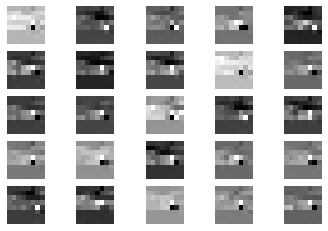

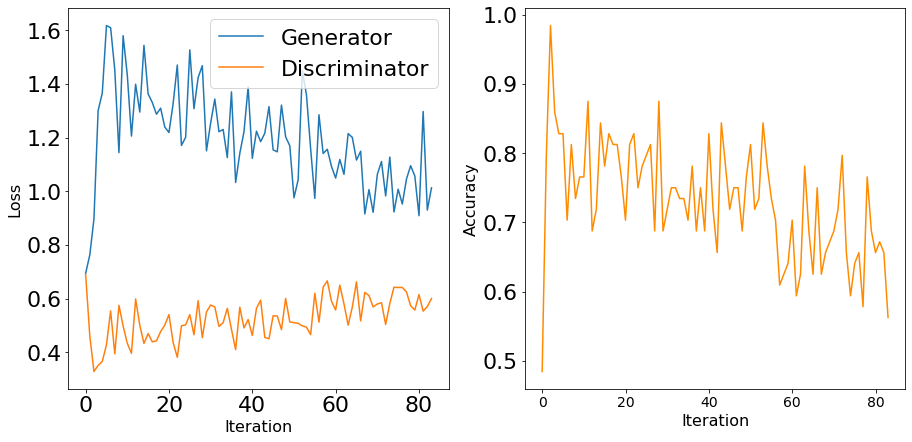

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8301 [D loss: 0.560864, acc.: 65.62%] [G loss: 1.084882]
8302 [D loss: 0.604080, acc.: 68.75%] [G loss: 1.050263]
8303 [D loss: 0.602203, acc.: 64.06%] [G loss: 1.098871]
8304 [D loss: 0.659725, acc.: 59.38%] [G loss: 1.002167]
8305 [D loss: 0.525177, acc.: 71.88%] [G loss: 1.195325]
8306 [D loss: 0.591351, acc.: 65.62%] [G loss: 1.136579]
8307 [D loss: 0.651362, acc.: 60.94%] [G loss: 1.025507]
8308 [D loss: 0.552179, acc.: 68.75%] [G loss: 0.987848]
8309 [D loss: 0.588835, acc.: 70.31%] [G loss: 0.919503]
8310 [D loss: 0.591817, acc.: 65.62%] [G loss: 0.992991]
8311 [D loss: 0.564020, acc.: 68.75%] [G loss: 0.873933]
8312 [D loss: 0.579507, acc.: 65.62%] [G loss: 0.789515]
8313 [D loss: 0.594449, acc.: 65.62%] [G loss: 0.956410]
8314 [D loss: 0.510533, acc.: 70.31%] [G loss: 1.031753]
8315 [D loss: 0.598613, acc.: 65.62%] [G loss: 1.071420]
8316 [D loss: 0.573066, acc.: 70.31%] [G loss: 0.882642]
8317 [D loss: 0.690866, acc.: 56.25%] [G loss: 0.970158]
8318 [D loss: 0.503794, acc.: 7

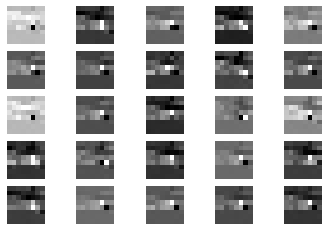

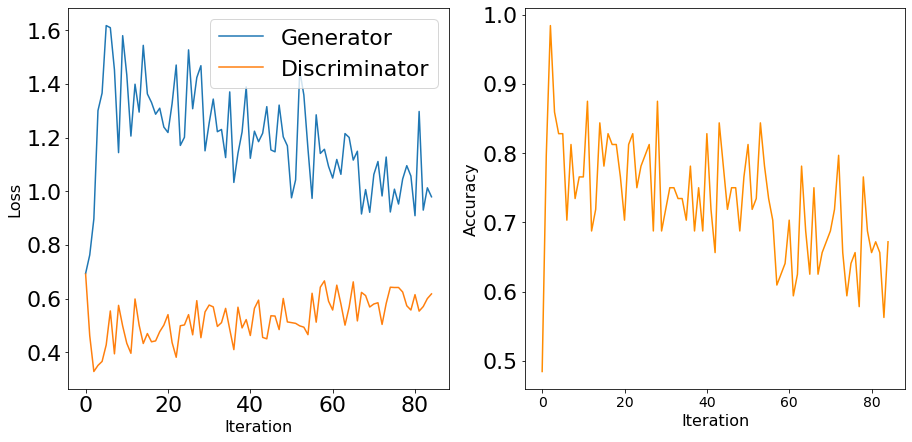

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8401 [D loss: 0.543887, acc.: 68.75%] [G loss: 1.000972]
8402 [D loss: 0.604918, acc.: 70.31%] [G loss: 0.992699]
8403 [D loss: 0.574529, acc.: 68.75%] [G loss: 1.010010]
8404 [D loss: 0.550422, acc.: 68.75%] [G loss: 1.072102]
8405 [D loss: 0.603862, acc.: 62.50%] [G loss: 0.950368]
8406 [D loss: 0.639151, acc.: 70.31%] [G loss: 0.917807]
8407 [D loss: 0.575184, acc.: 73.44%] [G loss: 0.984098]
8408 [D loss: 0.565162, acc.: 67.19%] [G loss: 0.974720]
8409 [D loss: 0.645734, acc.: 60.94%] [G loss: 1.016400]
8410 [D loss: 0.675083, acc.: 54.69%] [G loss: 1.006465]
8411 [D loss: 0.612754, acc.: 67.19%] [G loss: 0.956992]
8412 [D loss: 0.599351, acc.: 62.50%] [G loss: 0.879780]
8413 [D loss: 0.572637, acc.: 68.75%] [G loss: 1.011622]
8414 [D loss: 0.537650, acc.: 71.88%] [G loss: 1.126578]
8415 [D loss: 0.624580, acc.: 59.38%] [G loss: 0.907265]
8416 [D loss: 0.583711, acc.: 67.19%] [G loss: 1.030596]
8417 [D loss: 0.689376, acc.: 59.38%] [G loss: 1.019952]
8418 [D loss: 0.615376, acc.: 6

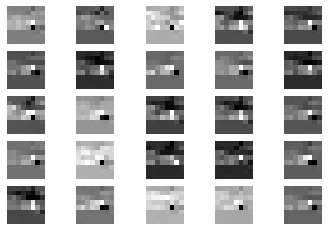

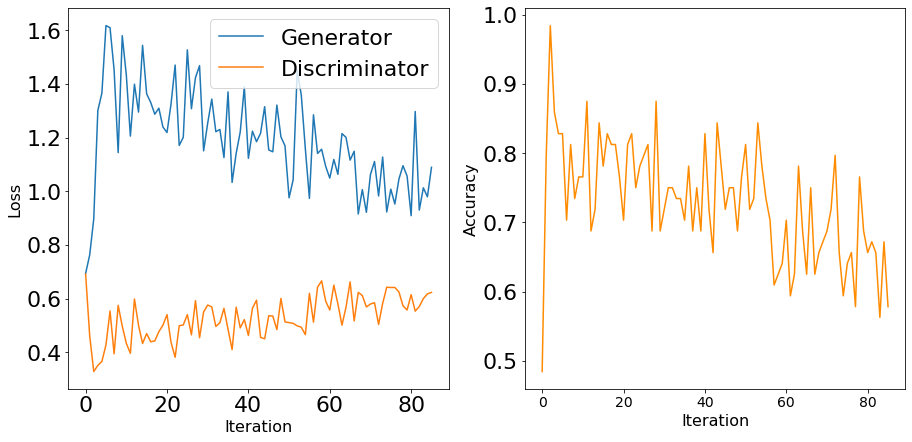

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8501 [D loss: 0.639615, acc.: 57.81%] [G loss: 1.055012]
8502 [D loss: 0.588814, acc.: 70.31%] [G loss: 0.935190]
8503 [D loss: 0.494891, acc.: 78.12%] [G loss: 0.904187]
8504 [D loss: 0.495380, acc.: 75.00%] [G loss: 1.006568]
8505 [D loss: 0.653133, acc.: 62.50%] [G loss: 1.134833]
8506 [D loss: 0.548755, acc.: 76.56%] [G loss: 1.038874]
8507 [D loss: 0.611794, acc.: 68.75%] [G loss: 1.040584]
8508 [D loss: 0.569475, acc.: 76.56%] [G loss: 0.904341]
8509 [D loss: 0.580058, acc.: 65.62%] [G loss: 1.020417]
8510 [D loss: 0.628140, acc.: 60.94%] [G loss: 1.048437]
8511 [D loss: 0.630993, acc.: 64.06%] [G loss: 0.965772]
8512 [D loss: 0.592627, acc.: 67.19%] [G loss: 0.916513]
8513 [D loss: 0.565299, acc.: 76.56%] [G loss: 0.732334]
8514 [D loss: 0.661239, acc.: 56.25%] [G loss: 0.982872]
8515 [D loss: 0.524847, acc.: 81.25%] [G loss: 0.896441]
8516 [D loss: 0.607667, acc.: 70.31%] [G loss: 0.951031]
8517 [D loss: 0.583869, acc.: 75.00%] [G loss: 0.942886]
8518 [D loss: 0.718701, acc.: 5

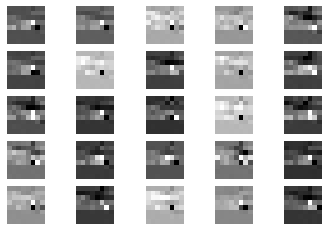

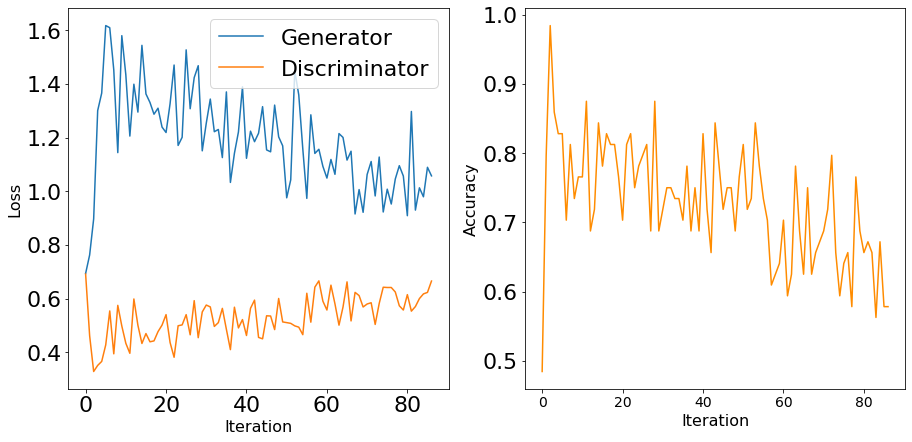

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8601 [D loss: 0.600555, acc.: 62.50%] [G loss: 0.990460]
8602 [D loss: 0.588712, acc.: 67.19%] [G loss: 1.109427]
8603 [D loss: 0.627950, acc.: 65.62%] [G loss: 0.986126]
8604 [D loss: 0.514678, acc.: 71.88%] [G loss: 1.077229]
8605 [D loss: 0.576240, acc.: 68.75%] [G loss: 0.998035]
8606 [D loss: 0.527543, acc.: 75.00%] [G loss: 0.984085]
8607 [D loss: 0.620644, acc.: 59.38%] [G loss: 1.111332]
8608 [D loss: 0.591483, acc.: 62.50%] [G loss: 1.008045]
8609 [D loss: 0.561537, acc.: 70.31%] [G loss: 0.934800]
8610 [D loss: 0.584160, acc.: 65.62%] [G loss: 1.071595]
8611 [D loss: 0.590447, acc.: 65.62%] [G loss: 1.153887]
8612 [D loss: 0.550354, acc.: 71.88%] [G loss: 0.987111]
8613 [D loss: 0.587377, acc.: 62.50%] [G loss: 0.907938]
8614 [D loss: 0.656880, acc.: 62.50%] [G loss: 1.023366]
8615 [D loss: 0.530285, acc.: 73.44%] [G loss: 1.021271]
8616 [D loss: 0.513829, acc.: 70.31%] [G loss: 1.230270]
8617 [D loss: 0.576008, acc.: 64.06%] [G loss: 1.096987]
8618 [D loss: 0.666714, acc.: 5

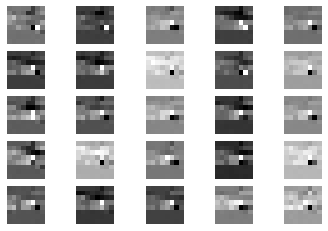

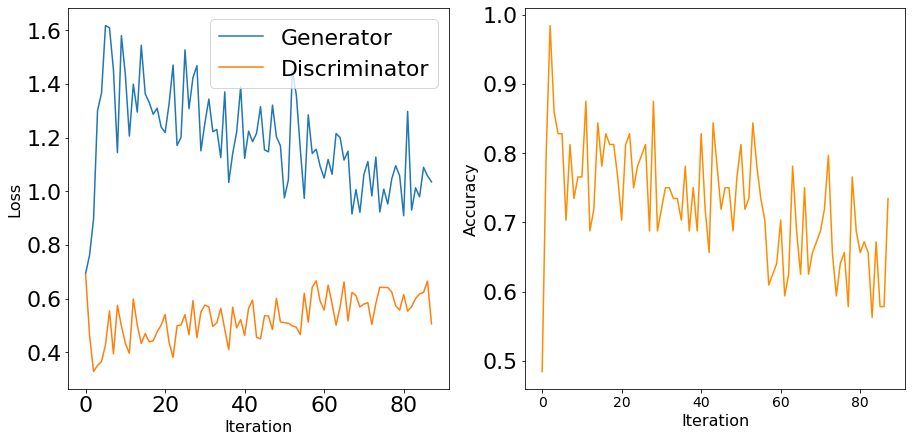

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8701 [D loss: 0.609513, acc.: 64.06%] [G loss: 0.909114]
8702 [D loss: 0.570689, acc.: 68.75%] [G loss: 1.265765]
8703 [D loss: 0.611031, acc.: 68.75%] [G loss: 1.222983]
8704 [D loss: 0.605185, acc.: 68.75%] [G loss: 1.052312]
8705 [D loss: 0.449297, acc.: 79.69%] [G loss: 1.556143]
8706 [D loss: 0.442293, acc.: 82.81%] [G loss: 1.071168]
8707 [D loss: 0.568929, acc.: 64.06%] [G loss: 1.266806]
8708 [D loss: 0.541349, acc.: 70.31%] [G loss: 1.023915]
8709 [D loss: 0.505684, acc.: 78.12%] [G loss: 1.112913]
8710 [D loss: 0.578393, acc.: 67.19%] [G loss: 1.062089]
8711 [D loss: 0.671754, acc.: 53.12%] [G loss: 0.942699]
8712 [D loss: 0.484665, acc.: 75.00%] [G loss: 0.872527]
8713 [D loss: 0.619578, acc.: 64.06%] [G loss: 1.043250]
8714 [D loss: 0.600287, acc.: 65.62%] [G loss: 1.004011]
8715 [D loss: 0.652995, acc.: 62.50%] [G loss: 0.922382]
8716 [D loss: 0.684239, acc.: 53.12%] [G loss: 0.947036]
8717 [D loss: 0.527499, acc.: 73.44%] [G loss: 1.080278]
8718 [D loss: 0.609469, acc.: 6

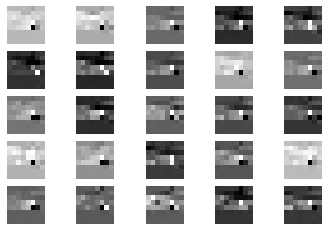

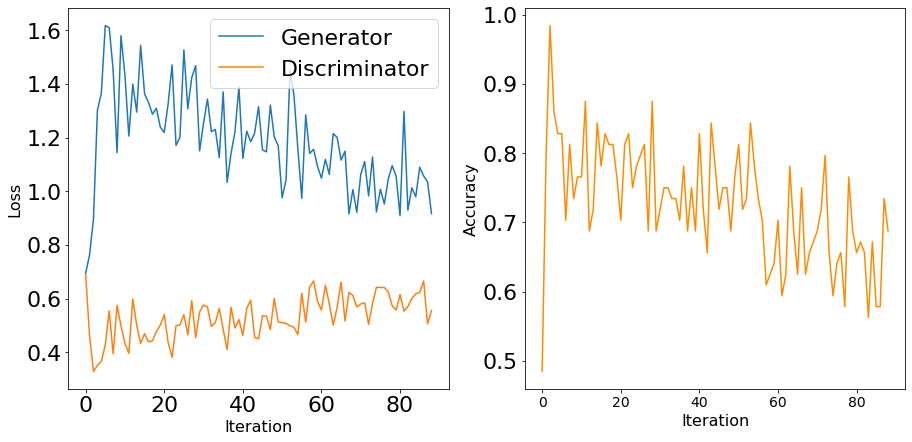

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8801 [D loss: 0.563501, acc.: 76.56%] [G loss: 0.946750]
8802 [D loss: 0.642491, acc.: 64.06%] [G loss: 0.952712]
8803 [D loss: 0.577556, acc.: 64.06%] [G loss: 1.125215]
8804 [D loss: 0.584926, acc.: 65.62%] [G loss: 1.060472]
8805 [D loss: 0.614245, acc.: 68.75%] [G loss: 0.959128]
8806 [D loss: 0.581473, acc.: 67.19%] [G loss: 0.906675]
8807 [D loss: 0.661409, acc.: 68.75%] [G loss: 0.879035]
8808 [D loss: 0.659566, acc.: 57.81%] [G loss: 0.895941]
8809 [D loss: 0.643562, acc.: 65.62%] [G loss: 0.897795]
8810 [D loss: 0.559095, acc.: 73.44%] [G loss: 1.150905]
8811 [D loss: 0.544770, acc.: 68.75%] [G loss: 1.180927]
8812 [D loss: 0.657055, acc.: 60.94%] [G loss: 1.044488]
8813 [D loss: 0.533062, acc.: 75.00%] [G loss: 1.056659]
8814 [D loss: 0.568553, acc.: 68.75%] [G loss: 1.105051]
8815 [D loss: 0.535939, acc.: 75.00%] [G loss: 0.924509]
8816 [D loss: 0.550860, acc.: 68.75%] [G loss: 0.964974]
8817 [D loss: 0.606695, acc.: 68.75%] [G loss: 0.935670]
8818 [D loss: 0.652054, acc.: 6

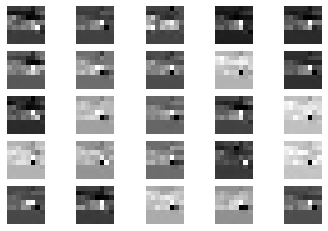

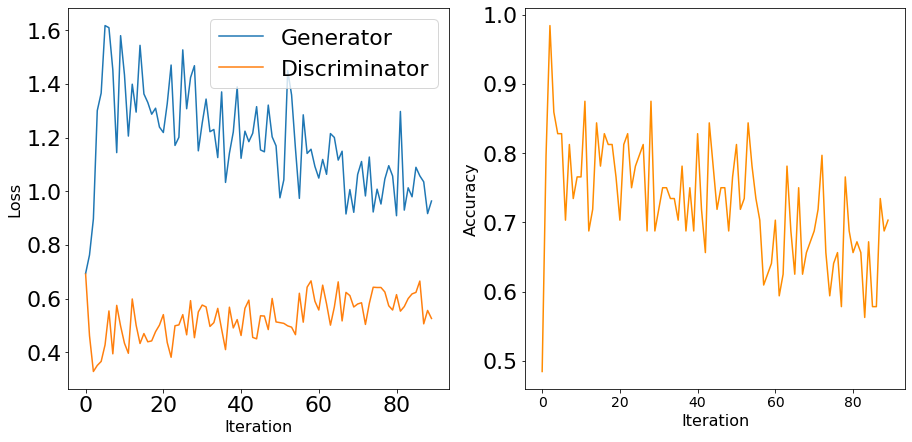

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


8901 [D loss: 0.524081, acc.: 76.56%] [G loss: 1.173361]
8902 [D loss: 0.539602, acc.: 73.44%] [G loss: 1.364764]
8903 [D loss: 0.641840, acc.: 73.44%] [G loss: 0.933492]
8904 [D loss: 0.575245, acc.: 70.31%] [G loss: 0.999112]
8905 [D loss: 0.627791, acc.: 64.06%] [G loss: 0.925208]
8906 [D loss: 0.561687, acc.: 70.31%] [G loss: 0.834302]
8907 [D loss: 0.576939, acc.: 67.19%] [G loss: 0.958951]
8908 [D loss: 0.581494, acc.: 68.75%] [G loss: 0.921023]
8909 [D loss: 0.617521, acc.: 60.94%] [G loss: 1.037917]
8910 [D loss: 0.618709, acc.: 73.44%] [G loss: 1.010257]
8911 [D loss: 0.507742, acc.: 75.00%] [G loss: 1.180358]
8912 [D loss: 0.718142, acc.: 59.38%] [G loss: 0.882549]
8913 [D loss: 0.529920, acc.: 68.75%] [G loss: 1.472375]
8914 [D loss: 0.674606, acc.: 62.50%] [G loss: 0.855122]
8915 [D loss: 0.552170, acc.: 75.00%] [G loss: 0.859799]
8916 [D loss: 0.579760, acc.: 68.75%] [G loss: 1.057760]
8917 [D loss: 0.608422, acc.: 78.12%] [G loss: 0.882544]
8918 [D loss: 0.602363, acc.: 6

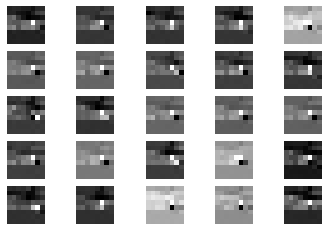

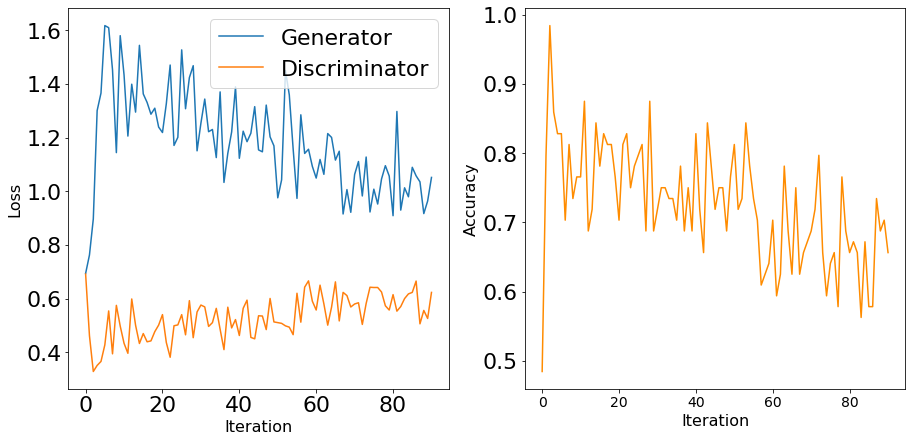

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9001 [D loss: 0.639969, acc.: 57.81%] [G loss: 1.008456]
9002 [D loss: 0.584396, acc.: 70.31%] [G loss: 1.153195]
9003 [D loss: 0.577081, acc.: 64.06%] [G loss: 1.156001]
9004 [D loss: 0.522491, acc.: 76.56%] [G loss: 1.076767]
9005 [D loss: 0.552489, acc.: 68.75%] [G loss: 0.976703]
9006 [D loss: 0.542120, acc.: 76.56%] [G loss: 1.185404]
9007 [D loss: 0.520690, acc.: 75.00%] [G loss: 1.076709]
9008 [D loss: 0.548247, acc.: 75.00%] [G loss: 0.966057]
9009 [D loss: 0.500751, acc.: 75.00%] [G loss: 1.527869]
9010 [D loss: 0.538603, acc.: 75.00%] [G loss: 1.092725]
9011 [D loss: 0.611323, acc.: 64.06%] [G loss: 0.868037]
9012 [D loss: 0.596413, acc.: 71.88%] [G loss: 0.786152]
9013 [D loss: 0.558234, acc.: 73.44%] [G loss: 0.845588]
9014 [D loss: 0.610685, acc.: 71.88%] [G loss: 0.912979]
9015 [D loss: 0.554311, acc.: 75.00%] [G loss: 0.921164]
9016 [D loss: 0.593754, acc.: 65.62%] [G loss: 0.902302]
9017 [D loss: 0.587820, acc.: 70.31%] [G loss: 1.012529]
9018 [D loss: 0.600895, acc.: 6

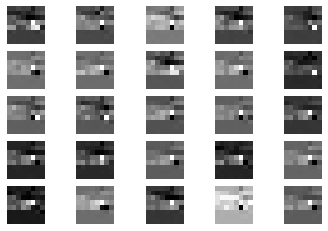

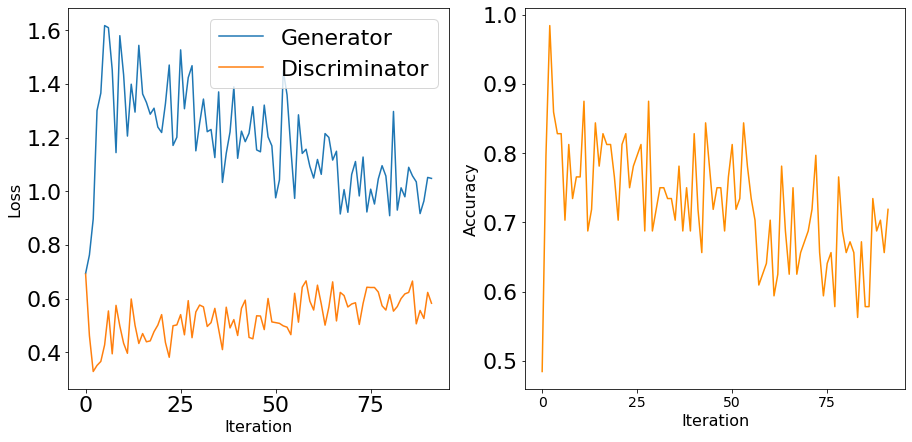

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9101 [D loss: 0.728797, acc.: 54.69%] [G loss: 1.138274]
9102 [D loss: 0.619167, acc.: 71.88%] [G loss: 0.945472]
9103 [D loss: 0.509141, acc.: 70.31%] [G loss: 1.337987]
9104 [D loss: 0.504022, acc.: 78.12%] [G loss: 0.989445]
9105 [D loss: 0.505005, acc.: 76.56%] [G loss: 1.100797]
9106 [D loss: 0.603948, acc.: 73.44%] [G loss: 1.072451]
9107 [D loss: 0.648260, acc.: 60.94%] [G loss: 1.001710]
9108 [D loss: 0.626455, acc.: 57.81%] [G loss: 1.103604]
9109 [D loss: 0.560583, acc.: 71.88%] [G loss: 1.146424]
9110 [D loss: 0.523634, acc.: 75.00%] [G loss: 0.982908]
9111 [D loss: 0.576303, acc.: 71.88%] [G loss: 1.049294]
9112 [D loss: 0.642077, acc.: 57.81%] [G loss: 0.970692]
9113 [D loss: 0.510523, acc.: 81.25%] [G loss: 0.974653]
9114 [D loss: 0.604558, acc.: 60.94%] [G loss: 1.099463]
9115 [D loss: 0.572182, acc.: 68.75%] [G loss: 0.984131]
9116 [D loss: 0.639816, acc.: 62.50%] [G loss: 0.936710]
9117 [D loss: 0.502837, acc.: 76.56%] [G loss: 1.042653]
9118 [D loss: 0.582293, acc.: 6

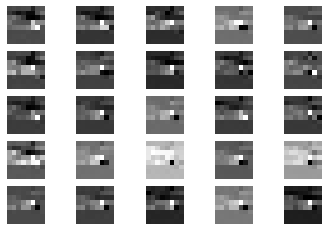

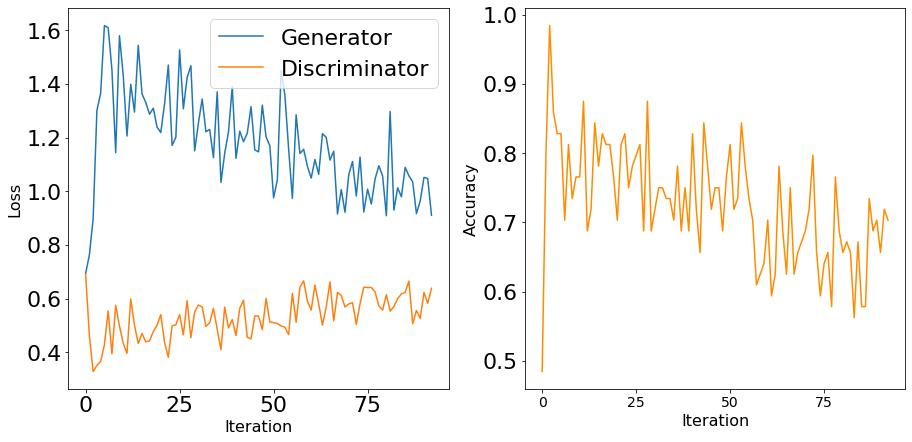

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9201 [D loss: 0.598427, acc.: 70.31%] [G loss: 1.049227]
9202 [D loss: 0.554589, acc.: 73.44%] [G loss: 1.124959]
9203 [D loss: 0.709186, acc.: 51.56%] [G loss: 0.911445]
9204 [D loss: 0.636162, acc.: 57.81%] [G loss: 0.892880]
9205 [D loss: 0.586507, acc.: 65.62%] [G loss: 0.991625]
9206 [D loss: 0.659915, acc.: 59.38%] [G loss: 1.133953]
9207 [D loss: 0.610331, acc.: 70.31%] [G loss: 0.962888]
9208 [D loss: 0.547270, acc.: 73.44%] [G loss: 0.952627]
9209 [D loss: 0.626508, acc.: 62.50%] [G loss: 0.887927]
9210 [D loss: 0.582678, acc.: 67.19%] [G loss: 0.919563]
9211 [D loss: 0.628232, acc.: 64.06%] [G loss: 0.940071]
9212 [D loss: 0.643191, acc.: 65.62%] [G loss: 0.952442]
9213 [D loss: 0.672146, acc.: 56.25%] [G loss: 0.947254]
9214 [D loss: 0.582694, acc.: 70.31%] [G loss: 1.108681]
9215 [D loss: 0.544365, acc.: 65.62%] [G loss: 1.059730]
9216 [D loss: 0.511977, acc.: 81.25%] [G loss: 0.904926]
9217 [D loss: 0.611372, acc.: 65.62%] [G loss: 0.833917]
9218 [D loss: 0.649787, acc.: 5

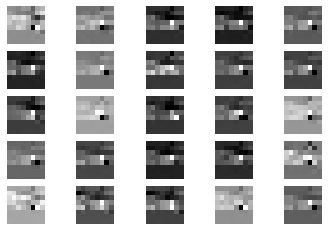

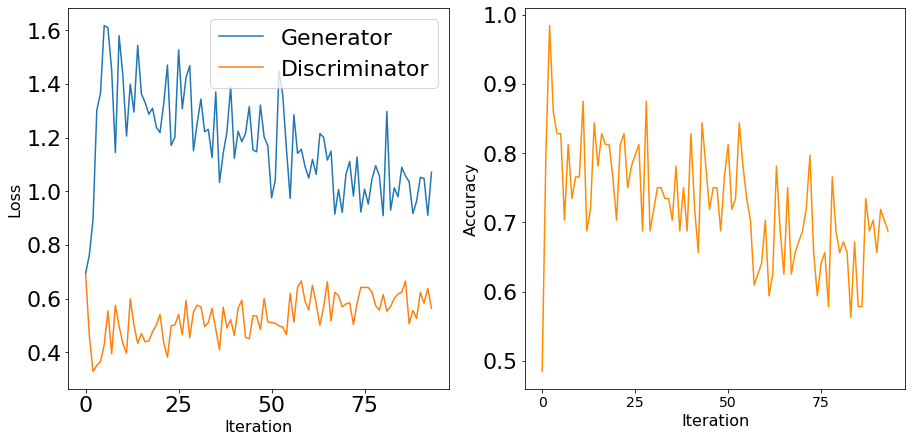

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9301 [D loss: 0.557895, acc.: 70.31%] [G loss: 0.969865]
9302 [D loss: 0.659481, acc.: 60.94%] [G loss: 1.003247]
9303 [D loss: 0.581744, acc.: 68.75%] [G loss: 0.968292]
9304 [D loss: 0.637609, acc.: 60.94%] [G loss: 0.767394]
9305 [D loss: 0.540147, acc.: 75.00%] [G loss: 0.906655]
9306 [D loss: 0.642926, acc.: 62.50%] [G loss: 0.882134]
9307 [D loss: 0.555822, acc.: 70.31%] [G loss: 0.964076]
9308 [D loss: 0.639568, acc.: 64.06%] [G loss: 0.962642]
9309 [D loss: 0.591373, acc.: 59.38%] [G loss: 0.895391]
9310 [D loss: 0.472431, acc.: 71.88%] [G loss: 0.753598]
9311 [D loss: 0.625231, acc.: 64.06%] [G loss: 0.834847]
9312 [D loss: 0.635113, acc.: 65.62%] [G loss: 0.926589]
9313 [D loss: 0.574514, acc.: 67.19%] [G loss: 0.882043]
9314 [D loss: 0.563800, acc.: 67.19%] [G loss: 0.905055]
9315 [D loss: 0.573689, acc.: 68.75%] [G loss: 1.269045]
9316 [D loss: 0.647738, acc.: 56.25%] [G loss: 1.002373]
9317 [D loss: 0.498281, acc.: 76.56%] [G loss: 0.878877]
9318 [D loss: 0.616732, acc.: 7

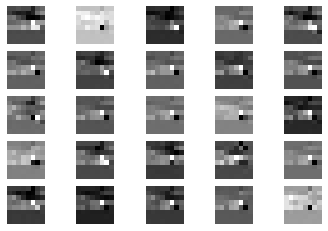

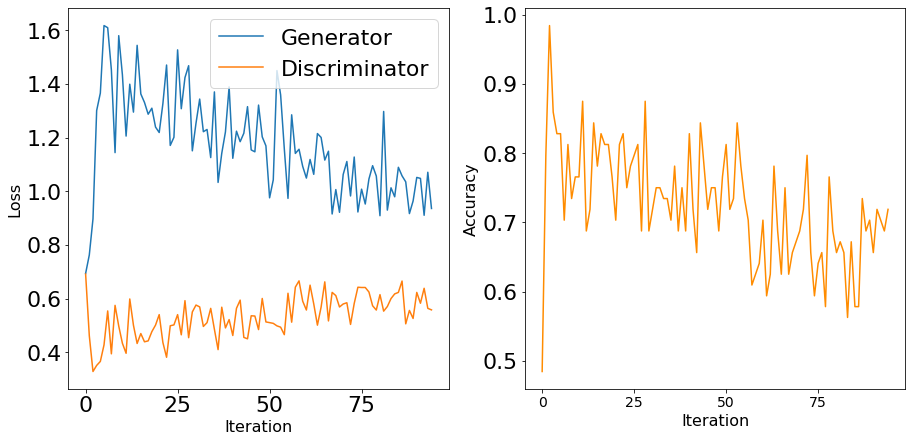

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9401 [D loss: 0.560834, acc.: 73.44%] [G loss: 1.050786]
9402 [D loss: 0.534024, acc.: 68.75%] [G loss: 1.021596]
9403 [D loss: 0.547815, acc.: 68.75%] [G loss: 1.050569]
9404 [D loss: 0.462144, acc.: 71.88%] [G loss: 1.227233]
9405 [D loss: 0.675809, acc.: 57.81%] [G loss: 0.967571]
9406 [D loss: 0.545074, acc.: 73.44%] [G loss: 1.165506]
9407 [D loss: 0.583643, acc.: 73.44%] [G loss: 0.852619]
9408 [D loss: 0.547859, acc.: 68.75%] [G loss: 0.829071]
9409 [D loss: 0.509099, acc.: 76.56%] [G loss: 0.812363]
9410 [D loss: 0.529718, acc.: 70.31%] [G loss: 0.957759]
9411 [D loss: 0.576645, acc.: 76.56%] [G loss: 0.907085]
9412 [D loss: 0.716169, acc.: 57.81%] [G loss: 1.042617]
9413 [D loss: 0.613797, acc.: 62.50%] [G loss: 0.866672]
9414 [D loss: 0.657167, acc.: 59.38%] [G loss: 0.971035]
9415 [D loss: 0.452035, acc.: 82.81%] [G loss: 1.257673]
9416 [D loss: 0.558314, acc.: 70.31%] [G loss: 0.980432]
9417 [D loss: 0.593111, acc.: 65.62%] [G loss: 0.976240]
9418 [D loss: 0.586145, acc.: 6

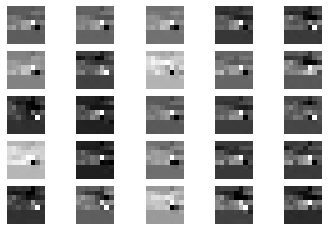

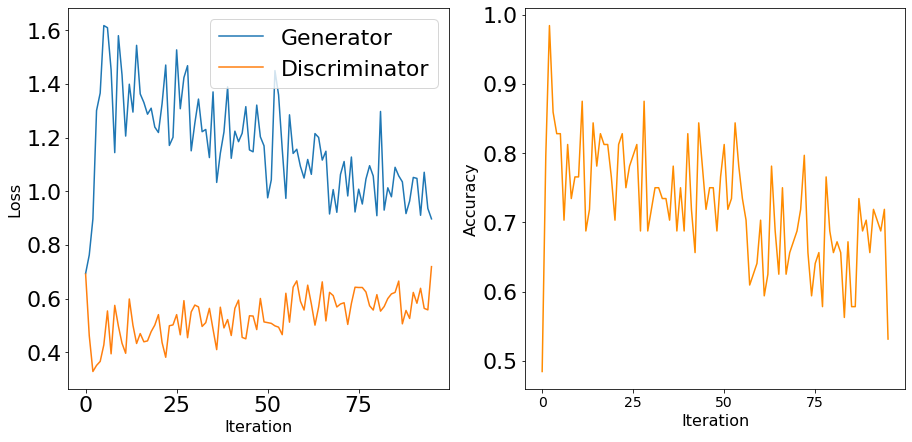

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9501 [D loss: 0.609640, acc.: 64.06%] [G loss: 0.982017]
9502 [D loss: 0.608618, acc.: 70.31%] [G loss: 0.865218]
9503 [D loss: 0.562561, acc.: 71.88%] [G loss: 0.919559]
9504 [D loss: 0.547646, acc.: 71.88%] [G loss: 1.117121]
9505 [D loss: 0.598024, acc.: 65.62%] [G loss: 1.070082]
9506 [D loss: 0.500306, acc.: 78.12%] [G loss: 0.983950]
9507 [D loss: 0.629414, acc.: 56.25%] [G loss: 0.863524]
9508 [D loss: 0.613133, acc.: 64.06%] [G loss: 0.879647]
9509 [D loss: 0.527587, acc.: 71.88%] [G loss: 0.992040]
9510 [D loss: 0.564736, acc.: 65.62%] [G loss: 0.971434]
9511 [D loss: 0.597192, acc.: 65.62%] [G loss: 0.844877]
9512 [D loss: 0.551985, acc.: 67.19%] [G loss: 0.886456]
9513 [D loss: 0.551624, acc.: 71.88%] [G loss: 1.107790]
9514 [D loss: 0.639169, acc.: 56.25%] [G loss: 0.874196]
9515 [D loss: 0.630002, acc.: 62.50%] [G loss: 1.093119]
9516 [D loss: 0.542991, acc.: 59.38%] [G loss: 1.258507]
9517 [D loss: 0.679282, acc.: 65.62%] [G loss: 1.062134]
9518 [D loss: 0.539990, acc.: 7

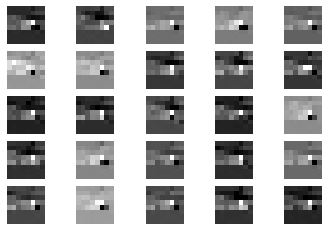

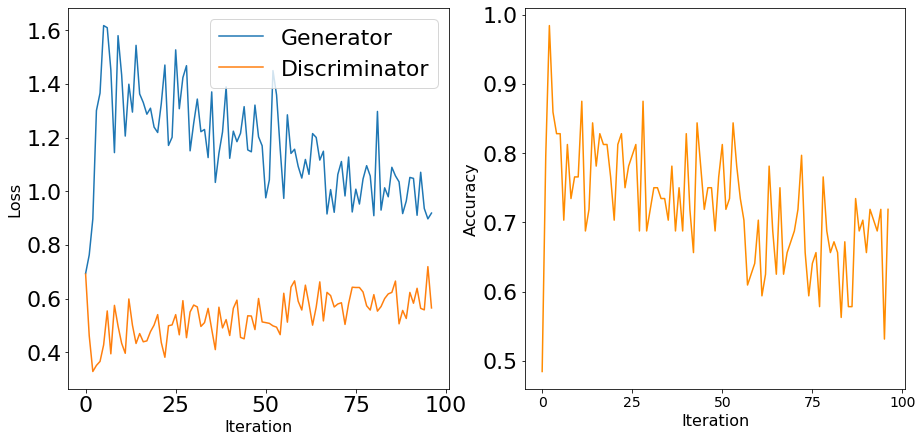

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9601 [D loss: 0.583063, acc.: 65.62%] [G loss: 1.093861]
9602 [D loss: 0.605524, acc.: 71.88%] [G loss: 0.950349]
9603 [D loss: 0.715301, acc.: 60.94%] [G loss: 1.119100]
9604 [D loss: 0.475373, acc.: 76.56%] [G loss: 1.546394]
9605 [D loss: 0.442141, acc.: 82.81%] [G loss: 1.054821]
9606 [D loss: 0.560039, acc.: 81.25%] [G loss: 0.884354]
9607 [D loss: 0.507768, acc.: 73.44%] [G loss: 1.139288]
9608 [D loss: 0.566954, acc.: 76.56%] [G loss: 1.001034]
9609 [D loss: 0.527450, acc.: 76.56%] [G loss: 0.904112]
9610 [D loss: 0.640740, acc.: 57.81%] [G loss: 0.839652]
9611 [D loss: 0.589100, acc.: 62.50%] [G loss: 0.851322]
9612 [D loss: 0.590720, acc.: 67.19%] [G loss: 1.022769]
9613 [D loss: 0.571736, acc.: 67.19%] [G loss: 1.033978]
9614 [D loss: 0.608187, acc.: 65.62%] [G loss: 0.858556]
9615 [D loss: 0.638591, acc.: 68.75%] [G loss: 0.934162]
9616 [D loss: 0.598756, acc.: 68.75%] [G loss: 0.909819]
9617 [D loss: 0.603163, acc.: 67.19%] [G loss: 0.853312]
9618 [D loss: 0.541792, acc.: 7

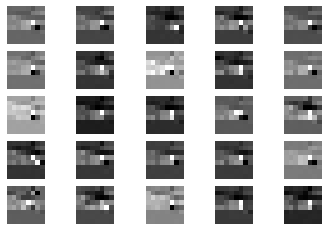

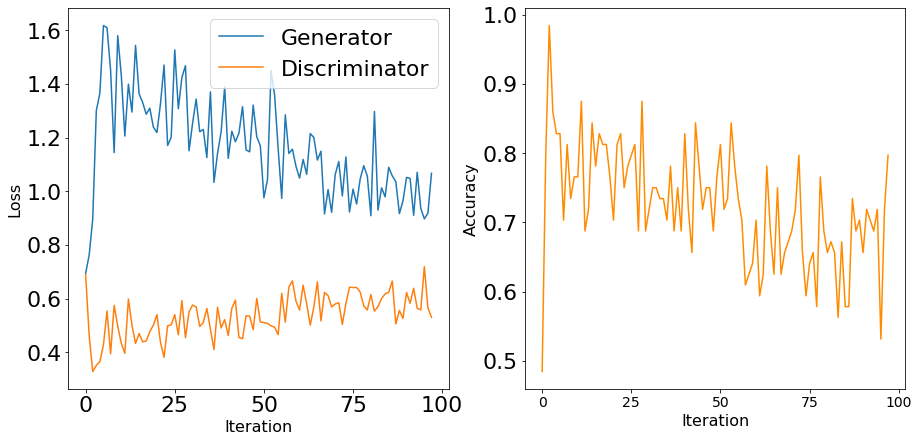

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9701 [D loss: 0.664749, acc.: 57.81%] [G loss: 0.862690]
9702 [D loss: 0.566844, acc.: 76.56%] [G loss: 0.869217]
9703 [D loss: 0.549651, acc.: 68.75%] [G loss: 0.915690]
9704 [D loss: 0.546091, acc.: 71.88%] [G loss: 0.819967]
9705 [D loss: 0.580442, acc.: 62.50%] [G loss: 0.985657]
9706 [D loss: 0.624658, acc.: 60.94%] [G loss: 0.991897]
9707 [D loss: 0.551017, acc.: 70.31%] [G loss: 0.866062]
9708 [D loss: 0.585833, acc.: 62.50%] [G loss: 0.940157]
9709 [D loss: 0.478138, acc.: 79.69%] [G loss: 0.873819]
9710 [D loss: 0.626929, acc.: 67.19%] [G loss: 1.013554]
9711 [D loss: 0.618041, acc.: 60.94%] [G loss: 0.915621]
9712 [D loss: 0.673773, acc.: 62.50%] [G loss: 0.881478]
9713 [D loss: 0.559794, acc.: 70.31%] [G loss: 0.936041]
9714 [D loss: 0.662933, acc.: 57.81%] [G loss: 1.047080]
9715 [D loss: 0.546246, acc.: 71.88%] [G loss: 1.197183]
9716 [D loss: 0.557811, acc.: 68.75%] [G loss: 1.083501]
9717 [D loss: 0.626987, acc.: 71.88%] [G loss: 0.960755]
9718 [D loss: 0.616118, acc.: 6

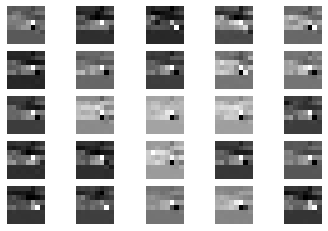

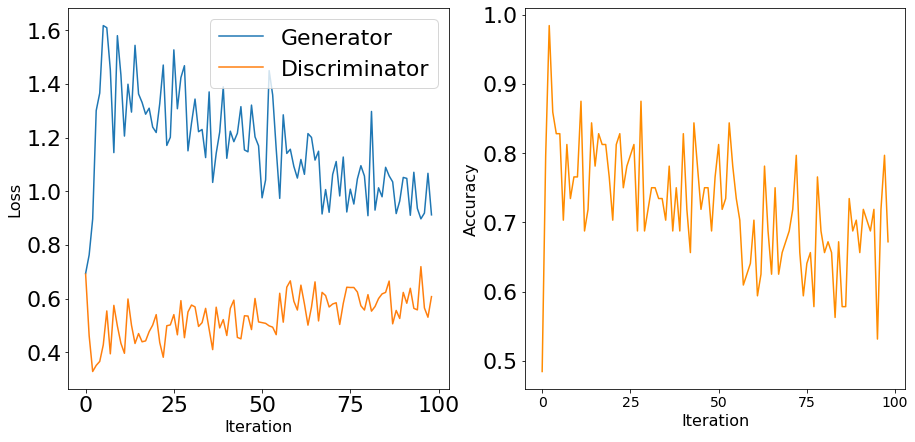

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9801 [D loss: 0.598710, acc.: 65.62%] [G loss: 0.997142]
9802 [D loss: 0.573558, acc.: 71.88%] [G loss: 0.807907]
9803 [D loss: 0.638361, acc.: 65.62%] [G loss: 0.925062]
9804 [D loss: 0.557661, acc.: 67.19%] [G loss: 1.050561]
9805 [D loss: 0.495141, acc.: 75.00%] [G loss: 1.088490]
9806 [D loss: 0.531399, acc.: 78.12%] [G loss: 0.886541]
9807 [D loss: 0.583706, acc.: 67.19%] [G loss: 0.896220]
9808 [D loss: 0.591734, acc.: 60.94%] [G loss: 1.008359]
9809 [D loss: 0.582327, acc.: 75.00%] [G loss: 0.937223]
9810 [D loss: 0.555816, acc.: 73.44%] [G loss: 0.945159]
9811 [D loss: 0.532867, acc.: 75.00%] [G loss: 1.200385]
9812 [D loss: 0.660594, acc.: 62.50%] [G loss: 0.928777]
9813 [D loss: 0.563218, acc.: 68.75%] [G loss: 0.983985]
9814 [D loss: 0.595226, acc.: 62.50%] [G loss: 1.024777]
9815 [D loss: 0.617319, acc.: 62.50%] [G loss: 1.020481]
9816 [D loss: 0.596488, acc.: 68.75%] [G loss: 0.913313]
9817 [D loss: 0.484918, acc.: 75.00%] [G loss: 1.061028]
9818 [D loss: 0.578127, acc.: 7

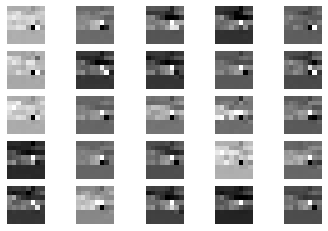

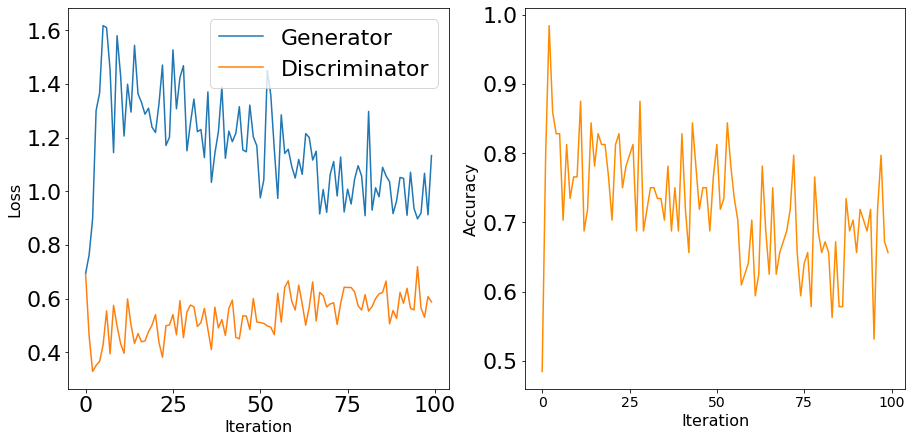

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


9901 [D loss: 0.570521, acc.: 71.88%] [G loss: 1.314278]
9902 [D loss: 0.644096, acc.: 70.31%] [G loss: 0.999174]
9903 [D loss: 0.523743, acc.: 76.56%] [G loss: 0.843477]
9904 [D loss: 0.577286, acc.: 65.62%] [G loss: 0.915377]
9905 [D loss: 0.627873, acc.: 70.31%] [G loss: 0.960521]
9906 [D loss: 0.526372, acc.: 76.56%] [G loss: 0.906327]
9907 [D loss: 0.573923, acc.: 70.31%] [G loss: 1.202188]
9908 [D loss: 0.528094, acc.: 79.69%] [G loss: 1.087052]
9909 [D loss: 0.563890, acc.: 64.06%] [G loss: 1.127370]
9910 [D loss: 0.619103, acc.: 56.25%] [G loss: 1.190570]
9911 [D loss: 0.592458, acc.: 73.44%] [G loss: 1.178129]
9912 [D loss: 0.623275, acc.: 62.50%] [G loss: 0.979488]
9913 [D loss: 0.568535, acc.: 73.44%] [G loss: 0.937549]
9914 [D loss: 0.661924, acc.: 65.62%] [G loss: 1.156626]
9915 [D loss: 0.461590, acc.: 75.00%] [G loss: 1.102547]
9916 [D loss: 0.544036, acc.: 76.56%] [G loss: 1.090757]
9917 [D loss: 0.572327, acc.: 70.31%] [G loss: 1.236245]
9918 [D loss: 0.519096, acc.: 7

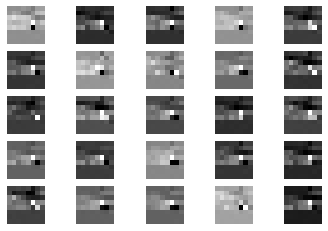

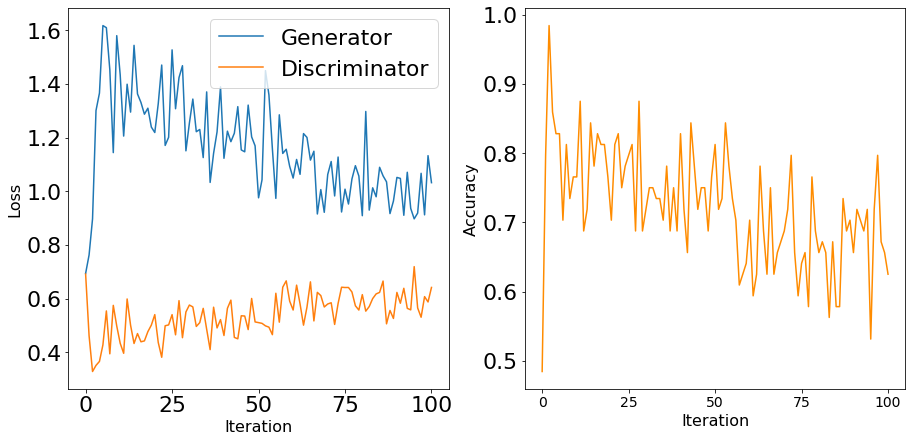

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10001 [D loss: 0.579217, acc.: 64.06%] [G loss: 0.953834]
10002 [D loss: 0.596044, acc.: 60.94%] [G loss: 0.953841]
10003 [D loss: 0.600463, acc.: 64.06%] [G loss: 0.930560]
10004 [D loss: 0.623038, acc.: 57.81%] [G loss: 0.868948]
10005 [D loss: 0.557905, acc.: 73.44%] [G loss: 0.828183]
10006 [D loss: 0.679794, acc.: 67.19%] [G loss: 0.893643]
10007 [D loss: 0.630158, acc.: 59.38%] [G loss: 0.953482]
10008 [D loss: 0.700088, acc.: 56.25%] [G loss: 0.953925]
10009 [D loss: 0.591317, acc.: 71.88%] [G loss: 0.819151]
10010 [D loss: 0.604600, acc.: 67.19%] [G loss: 1.077113]
10011 [D loss: 0.521814, acc.: 79.69%] [G loss: 0.939819]
10012 [D loss: 0.492413, acc.: 82.81%] [G loss: 0.912703]
10013 [D loss: 0.604158, acc.: 75.00%] [G loss: 0.924553]
10014 [D loss: 0.538933, acc.: 71.88%] [G loss: 1.039285]
10015 [D loss: 0.705981, acc.: 57.81%] [G loss: 0.920062]
10016 [D loss: 0.564003, acc.: 68.75%] [G loss: 1.050128]
10017 [D loss: 0.646584, acc.: 59.38%] [G loss: 0.851346]
10018 [D loss:

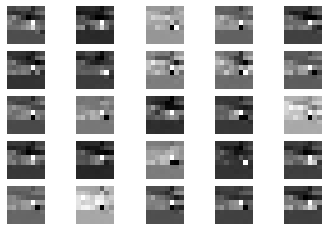

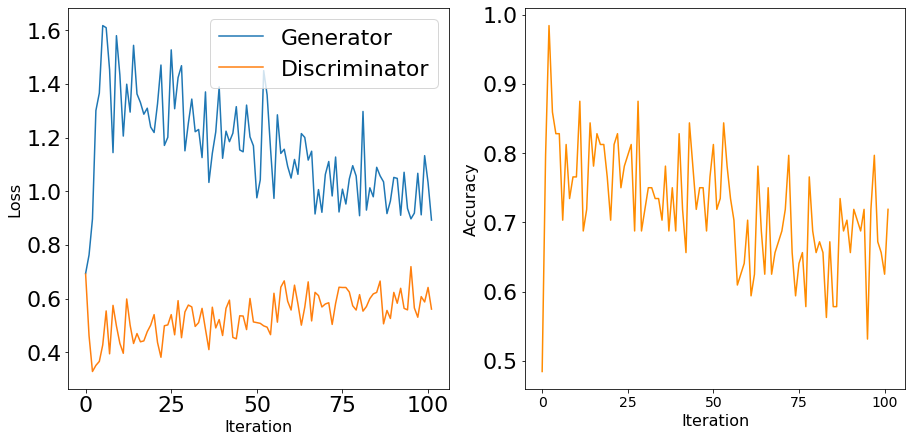

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10101 [D loss: 0.587346, acc.: 67.19%] [G loss: 0.925213]
10102 [D loss: 0.555743, acc.: 68.75%] [G loss: 0.915569]
10103 [D loss: 0.601948, acc.: 65.62%] [G loss: 0.990960]
10104 [D loss: 0.640425, acc.: 65.62%] [G loss: 0.944216]
10105 [D loss: 0.550591, acc.: 73.44%] [G loss: 0.949406]
10106 [D loss: 0.625098, acc.: 67.19%] [G loss: 0.945441]
10107 [D loss: 0.599351, acc.: 65.62%] [G loss: 1.070749]
10108 [D loss: 0.568831, acc.: 70.31%] [G loss: 1.197934]
10109 [D loss: 0.641925, acc.: 59.38%] [G loss: 1.083352]
10110 [D loss: 0.540199, acc.: 73.44%] [G loss: 1.011507]
10111 [D loss: 0.609739, acc.: 65.62%] [G loss: 1.017961]
10112 [D loss: 0.572504, acc.: 70.31%] [G loss: 0.805581]
10113 [D loss: 0.666508, acc.: 56.25%] [G loss: 0.818134]
10114 [D loss: 0.605061, acc.: 64.06%] [G loss: 1.069120]
10115 [D loss: 0.516593, acc.: 76.56%] [G loss: 1.000365]
10116 [D loss: 0.558949, acc.: 71.88%] [G loss: 1.038828]
10117 [D loss: 0.574172, acc.: 68.75%] [G loss: 0.968233]
10118 [D loss:

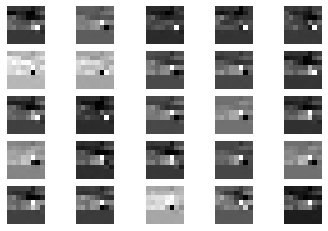

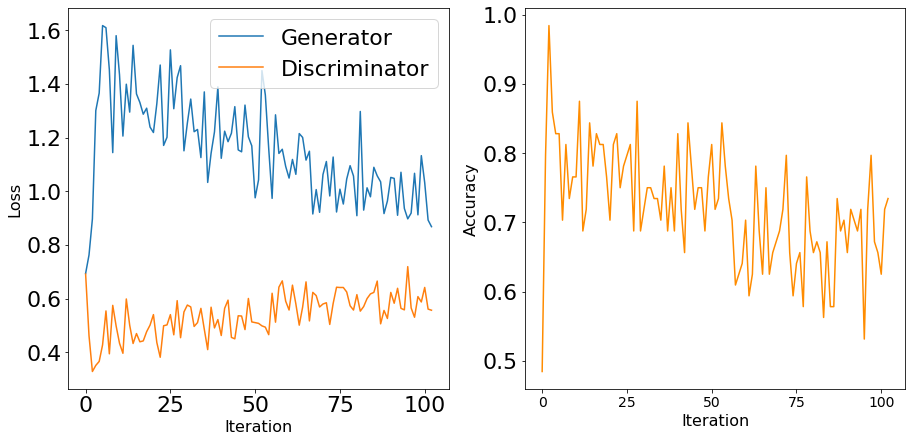

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10201 [D loss: 0.560668, acc.: 73.44%] [G loss: 0.983688]
10202 [D loss: 0.552765, acc.: 62.50%] [G loss: 1.178856]
10203 [D loss: 0.599386, acc.: 67.19%] [G loss: 1.115057]
10204 [D loss: 0.528262, acc.: 76.56%] [G loss: 1.038919]
10205 [D loss: 0.564369, acc.: 73.44%] [G loss: 0.969152]
10206 [D loss: 0.680618, acc.: 62.50%] [G loss: 0.953529]
10207 [D loss: 0.655106, acc.: 53.12%] [G loss: 0.972875]
10208 [D loss: 0.567360, acc.: 71.88%] [G loss: 0.893135]
10209 [D loss: 0.544525, acc.: 73.44%] [G loss: 0.978871]
10210 [D loss: 0.531653, acc.: 71.88%] [G loss: 1.041186]
10211 [D loss: 0.581127, acc.: 68.75%] [G loss: 1.015502]
10212 [D loss: 0.551738, acc.: 71.88%] [G loss: 1.154341]
10213 [D loss: 0.538594, acc.: 68.75%] [G loss: 1.095056]
10214 [D loss: 0.541438, acc.: 75.00%] [G loss: 0.923420]
10215 [D loss: 0.541444, acc.: 71.88%] [G loss: 0.926768]
10216 [D loss: 0.559239, acc.: 70.31%] [G loss: 1.004186]
10217 [D loss: 0.623963, acc.: 65.62%] [G loss: 1.090278]
10218 [D loss:

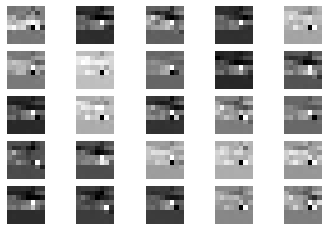

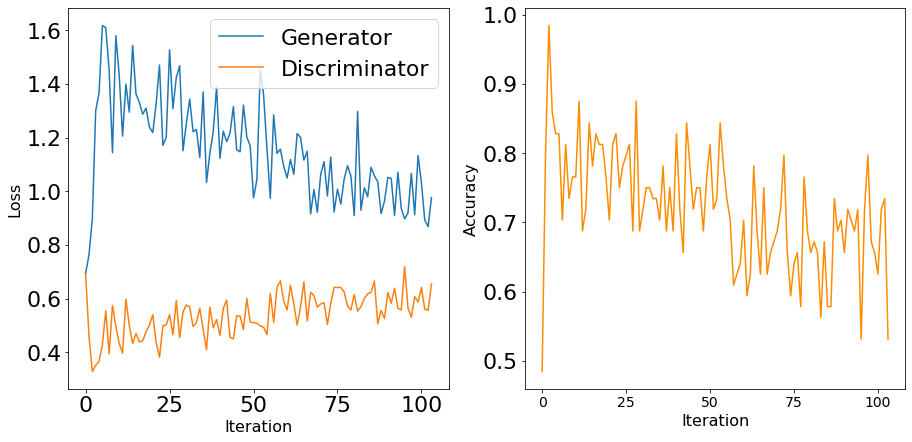

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10301 [D loss: 0.502283, acc.: 76.56%] [G loss: 0.983471]
10302 [D loss: 0.560850, acc.: 70.31%] [G loss: 1.206313]
10303 [D loss: 0.552711, acc.: 67.19%] [G loss: 0.965613]
10304 [D loss: 0.551274, acc.: 68.75%] [G loss: 0.937358]
10305 [D loss: 0.538621, acc.: 75.00%] [G loss: 1.291703]
10306 [D loss: 0.586229, acc.: 70.31%] [G loss: 0.910559]
10307 [D loss: 0.557906, acc.: 68.75%] [G loss: 1.190174]
10308 [D loss: 0.569130, acc.: 68.75%] [G loss: 1.071299]
10309 [D loss: 0.589080, acc.: 68.75%] [G loss: 0.914818]
10310 [D loss: 0.498750, acc.: 71.88%] [G loss: 1.180971]
10311 [D loss: 0.503301, acc.: 73.44%] [G loss: 1.129740]
10312 [D loss: 0.558893, acc.: 70.31%] [G loss: 0.879012]
10313 [D loss: 0.611085, acc.: 70.31%] [G loss: 0.916811]
10314 [D loss: 0.559954, acc.: 75.00%] [G loss: 1.496376]
10315 [D loss: 0.533949, acc.: 67.19%] [G loss: 1.346238]
10316 [D loss: 0.603584, acc.: 62.50%] [G loss: 1.022761]
10317 [D loss: 0.549688, acc.: 73.44%] [G loss: 0.882276]
10318 [D loss:

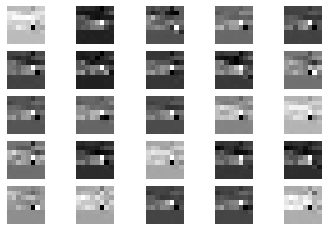

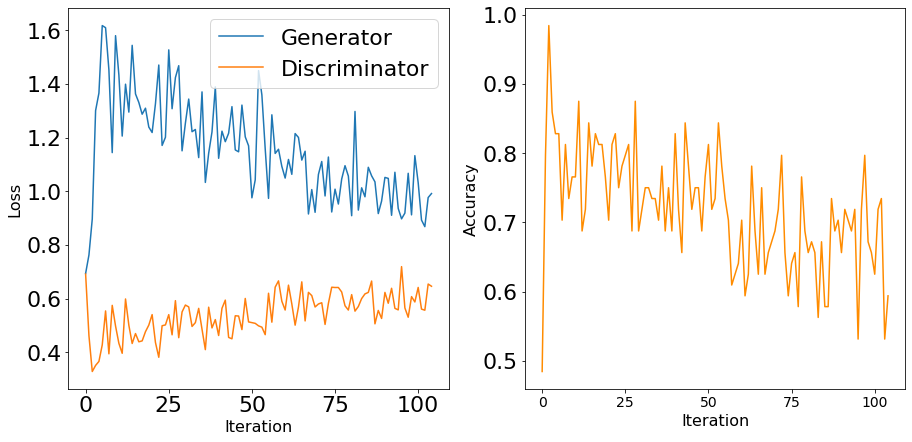

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10401 [D loss: 0.668898, acc.: 59.38%] [G loss: 0.936639]
10402 [D loss: 0.520766, acc.: 75.00%] [G loss: 0.882844]
10403 [D loss: 0.570596, acc.: 68.75%] [G loss: 0.985816]
10404 [D loss: 0.601307, acc.: 64.06%] [G loss: 1.087132]
10405 [D loss: 0.562236, acc.: 64.06%] [G loss: 1.135353]
10406 [D loss: 0.580685, acc.: 70.31%] [G loss: 1.029468]
10407 [D loss: 0.547717, acc.: 68.75%] [G loss: 1.181667]
10408 [D loss: 0.565383, acc.: 65.62%] [G loss: 1.102989]
10409 [D loss: 0.585409, acc.: 75.00%] [G loss: 0.867762]
10410 [D loss: 0.585455, acc.: 71.88%] [G loss: 0.855163]
10411 [D loss: 0.547113, acc.: 71.88%] [G loss: 1.088264]
10412 [D loss: 0.598851, acc.: 67.19%] [G loss: 1.029198]
10413 [D loss: 0.565622, acc.: 68.75%] [G loss: 1.116457]
10414 [D loss: 0.539698, acc.: 75.00%] [G loss: 1.092233]
10415 [D loss: 0.604001, acc.: 71.88%] [G loss: 0.906634]
10416 [D loss: 0.568716, acc.: 70.31%] [G loss: 1.031445]
10417 [D loss: 0.596527, acc.: 71.88%] [G loss: 0.769822]
10418 [D loss:

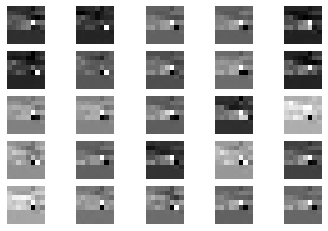

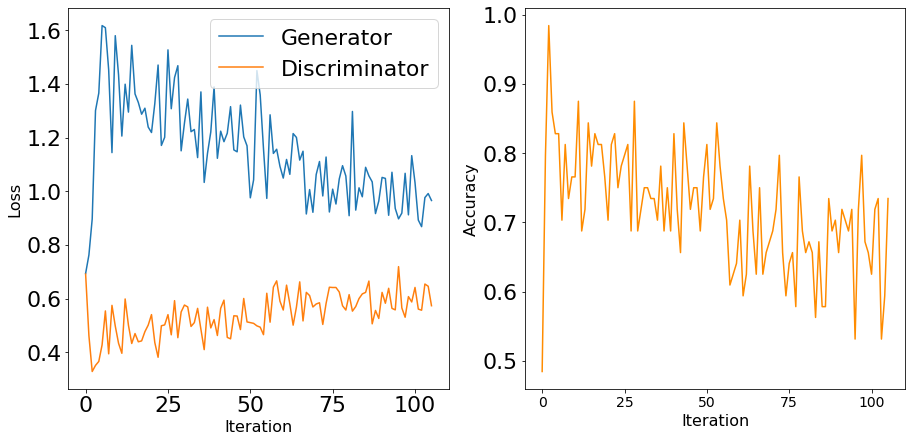

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10501 [D loss: 0.575437, acc.: 65.62%] [G loss: 0.883903]
10502 [D loss: 0.611449, acc.: 59.38%] [G loss: 0.996496]
10503 [D loss: 0.516966, acc.: 75.00%] [G loss: 1.184317]
10504 [D loss: 0.541978, acc.: 79.69%] [G loss: 1.189915]
10505 [D loss: 0.611647, acc.: 71.88%] [G loss: 0.969065]
10506 [D loss: 0.650566, acc.: 56.25%] [G loss: 0.967002]
10507 [D loss: 0.535595, acc.: 75.00%] [G loss: 1.226359]
10508 [D loss: 0.594765, acc.: 70.31%] [G loss: 1.061122]
10509 [D loss: 0.481265, acc.: 79.69%] [G loss: 1.312840]
10510 [D loss: 0.597447, acc.: 60.94%] [G loss: 1.084999]
10511 [D loss: 0.563288, acc.: 71.88%] [G loss: 1.024387]
10512 [D loss: 0.526574, acc.: 78.12%] [G loss: 1.225721]
10513 [D loss: 0.618948, acc.: 65.62%] [G loss: 1.040602]
10514 [D loss: 0.545671, acc.: 73.44%] [G loss: 1.427545]
10515 [D loss: 0.516413, acc.: 78.12%] [G loss: 1.405716]
10516 [D loss: 0.571775, acc.: 68.75%] [G loss: 0.941087]
10517 [D loss: 0.494392, acc.: 78.12%] [G loss: 1.029879]
10518 [D loss:

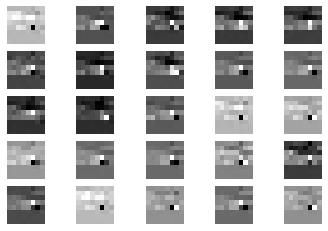

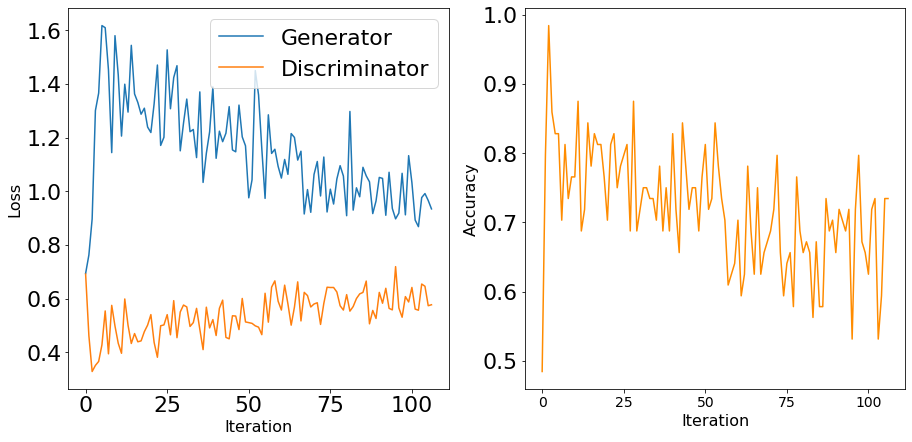

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10601 [D loss: 0.527913, acc.: 71.88%] [G loss: 1.297277]
10602 [D loss: 0.530923, acc.: 71.88%] [G loss: 1.248484]
10603 [D loss: 0.612284, acc.: 70.31%] [G loss: 0.915278]
10604 [D loss: 0.645074, acc.: 65.62%] [G loss: 0.991857]
10605 [D loss: 0.589194, acc.: 67.19%] [G loss: 0.969153]
10606 [D loss: 0.634830, acc.: 64.06%] [G loss: 0.834654]
10607 [D loss: 0.640475, acc.: 65.62%] [G loss: 0.994406]
10608 [D loss: 0.541653, acc.: 70.31%] [G loss: 0.923620]
10609 [D loss: 0.531905, acc.: 68.75%] [G loss: 1.213842]
10610 [D loss: 0.577204, acc.: 67.19%] [G loss: 0.930593]
10611 [D loss: 0.469051, acc.: 76.56%] [G loss: 1.021662]
10612 [D loss: 0.598722, acc.: 64.06%] [G loss: 1.057757]
10613 [D loss: 0.619722, acc.: 68.75%] [G loss: 0.896718]
10614 [D loss: 0.680851, acc.: 62.50%] [G loss: 0.970640]
10615 [D loss: 0.563914, acc.: 71.88%] [G loss: 0.997983]
10616 [D loss: 0.561290, acc.: 70.31%] [G loss: 1.204386]
10617 [D loss: 0.629330, acc.: 65.62%] [G loss: 0.980876]
10618 [D loss:

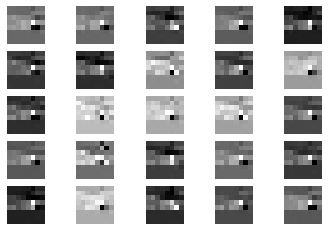

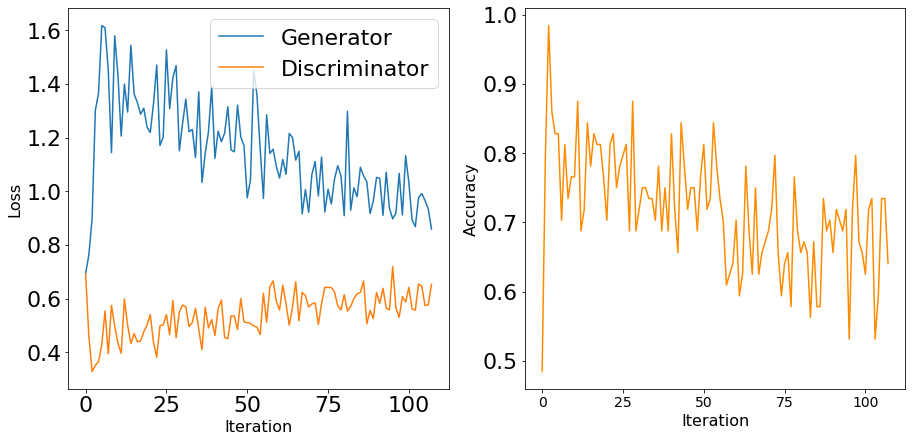

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10701 [D loss: 0.578455, acc.: 75.00%] [G loss: 0.967914]
10702 [D loss: 0.627130, acc.: 56.25%] [G loss: 1.068011]
10703 [D loss: 0.602353, acc.: 65.62%] [G loss: 1.199263]
10704 [D loss: 0.512737, acc.: 71.88%] [G loss: 1.119856]
10705 [D loss: 0.584861, acc.: 71.88%] [G loss: 1.178535]
10706 [D loss: 0.581121, acc.: 71.88%] [G loss: 1.211481]
10707 [D loss: 0.573251, acc.: 64.06%] [G loss: 0.979191]
10708 [D loss: 0.529153, acc.: 71.88%] [G loss: 1.013089]
10709 [D loss: 0.583106, acc.: 70.31%] [G loss: 1.062110]
10710 [D loss: 0.569829, acc.: 71.88%] [G loss: 1.332265]
10711 [D loss: 0.555482, acc.: 68.75%] [G loss: 1.167886]
10712 [D loss: 0.607083, acc.: 70.31%] [G loss: 0.949932]
10713 [D loss: 0.533831, acc.: 79.69%] [G loss: 0.964857]
10714 [D loss: 0.550719, acc.: 71.88%] [G loss: 1.158915]
10715 [D loss: 0.552550, acc.: 68.75%] [G loss: 1.079601]
10716 [D loss: 0.648897, acc.: 57.81%] [G loss: 1.129154]
10717 [D loss: 0.518587, acc.: 78.12%] [G loss: 1.080372]
10718 [D loss:

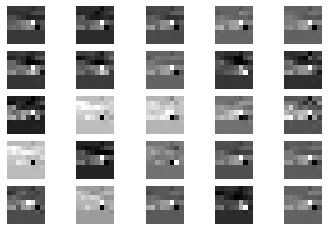

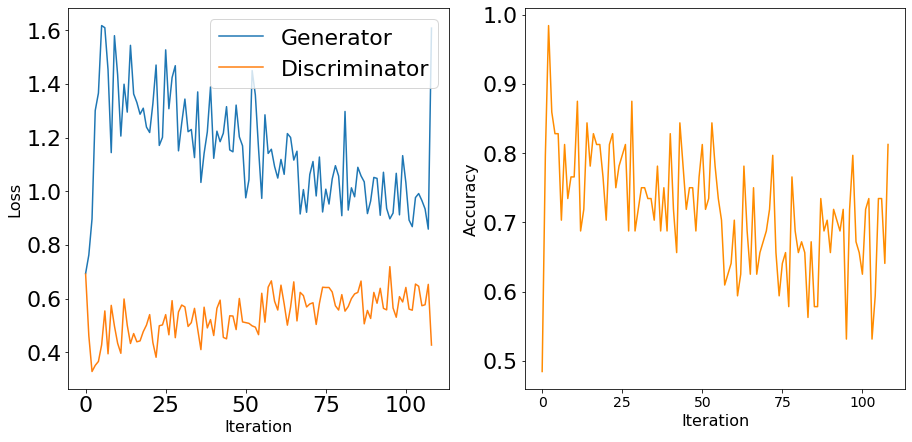

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10801 [D loss: 0.579908, acc.: 71.88%] [G loss: 1.034328]
10802 [D loss: 0.576564, acc.: 65.62%] [G loss: 0.854510]
10803 [D loss: 0.491817, acc.: 76.56%] [G loss: 0.988040]
10804 [D loss: 0.480872, acc.: 76.56%] [G loss: 1.176629]
10805 [D loss: 0.518087, acc.: 70.31%] [G loss: 1.147877]
10806 [D loss: 0.602196, acc.: 65.62%] [G loss: 1.019669]
10807 [D loss: 0.579818, acc.: 67.19%] [G loss: 1.075880]
10808 [D loss: 0.562802, acc.: 68.75%] [G loss: 0.900615]
10809 [D loss: 0.640073, acc.: 59.38%] [G loss: 0.936574]
10810 [D loss: 0.524746, acc.: 76.56%] [G loss: 0.985357]
10811 [D loss: 0.501038, acc.: 71.88%] [G loss: 1.222341]
10812 [D loss: 0.561363, acc.: 71.88%] [G loss: 1.200323]
10813 [D loss: 0.576317, acc.: 70.31%] [G loss: 1.138255]
10814 [D loss: 0.607838, acc.: 67.19%] [G loss: 0.835982]
10815 [D loss: 0.523908, acc.: 76.56%] [G loss: 0.900531]
10816 [D loss: 0.584294, acc.: 67.19%] [G loss: 0.995301]
10817 [D loss: 0.598703, acc.: 70.31%] [G loss: 0.991569]
10818 [D loss:

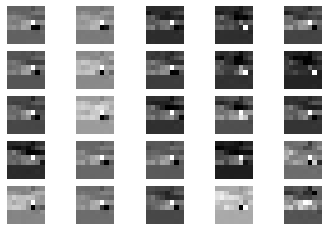

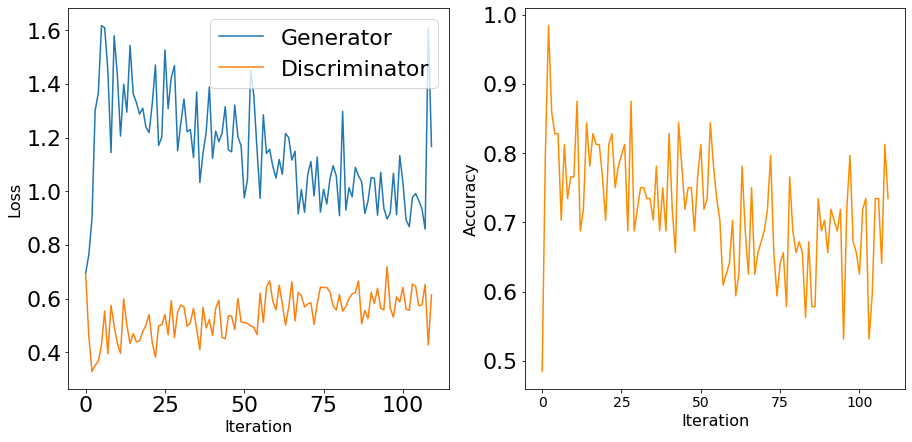

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


10901 [D loss: 0.534184, acc.: 76.56%] [G loss: 1.084840]
10902 [D loss: 0.586065, acc.: 70.31%] [G loss: 1.105408]
10903 [D loss: 0.549914, acc.: 65.62%] [G loss: 1.275740]
10904 [D loss: 0.593305, acc.: 62.50%] [G loss: 1.069659]
10905 [D loss: 0.702493, acc.: 53.12%] [G loss: 1.133389]
10906 [D loss: 0.537396, acc.: 64.06%] [G loss: 1.345038]
10907 [D loss: 0.607929, acc.: 64.06%] [G loss: 0.953529]
10908 [D loss: 0.509856, acc.: 73.44%] [G loss: 1.153815]
10909 [D loss: 0.581029, acc.: 70.31%] [G loss: 1.272598]
10910 [D loss: 0.536074, acc.: 68.75%] [G loss: 1.035553]
10911 [D loss: 0.612020, acc.: 64.06%] [G loss: 0.938842]
10912 [D loss: 0.596881, acc.: 64.06%] [G loss: 0.988888]
10913 [D loss: 0.664899, acc.: 57.81%] [G loss: 0.955406]
10914 [D loss: 0.540314, acc.: 67.19%] [G loss: 0.977819]
10915 [D loss: 0.506897, acc.: 73.44%] [G loss: 1.163515]
10916 [D loss: 0.626350, acc.: 67.19%] [G loss: 1.024524]
10917 [D loss: 0.557917, acc.: 67.19%] [G loss: 1.033949]
10918 [D loss:

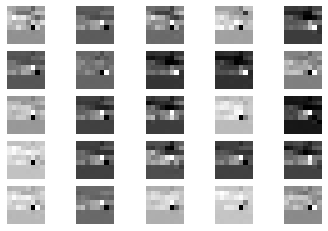

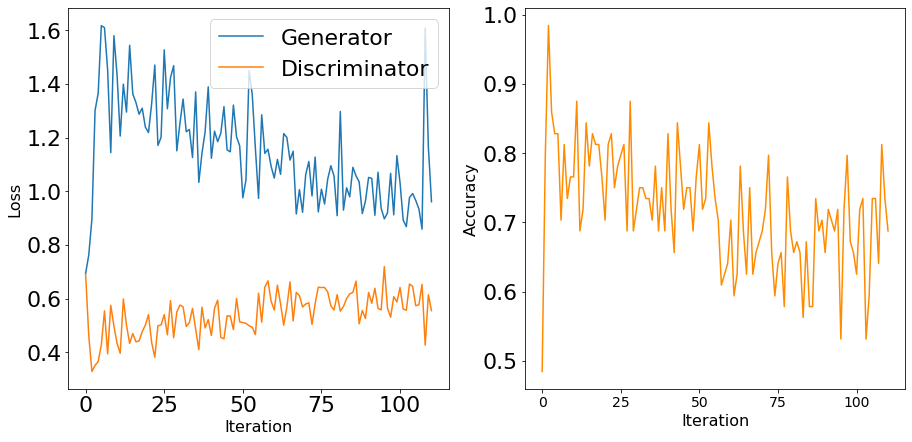

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11001 [D loss: 0.695257, acc.: 50.00%] [G loss: 0.868633]
11002 [D loss: 0.623831, acc.: 67.19%] [G loss: 1.026222]
11003 [D loss: 0.508337, acc.: 71.88%] [G loss: 1.200802]
11004 [D loss: 0.616697, acc.: 62.50%] [G loss: 0.812742]
11005 [D loss: 0.541672, acc.: 75.00%] [G loss: 0.955238]
11006 [D loss: 0.638700, acc.: 59.38%] [G loss: 0.950343]
11007 [D loss: 0.523447, acc.: 76.56%] [G loss: 0.791156]
11008 [D loss: 0.599075, acc.: 65.62%] [G loss: 1.023177]
11009 [D loss: 0.533578, acc.: 75.00%] [G loss: 0.949242]
11010 [D loss: 0.491617, acc.: 70.31%] [G loss: 1.088108]
11011 [D loss: 0.497560, acc.: 79.69%] [G loss: 1.179116]
11012 [D loss: 0.424898, acc.: 81.25%] [G loss: 1.268091]
11013 [D loss: 0.556833, acc.: 67.19%] [G loss: 1.149307]
11014 [D loss: 0.575933, acc.: 68.75%] [G loss: 1.371961]
11015 [D loss: 0.663192, acc.: 60.94%] [G loss: 1.007189]
11016 [D loss: 0.649280, acc.: 60.94%] [G loss: 0.885956]
11017 [D loss: 0.622794, acc.: 59.38%] [G loss: 0.962312]
11018 [D loss:

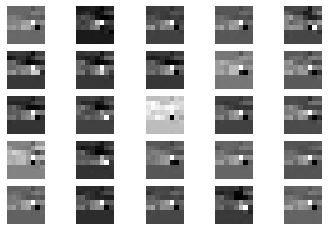

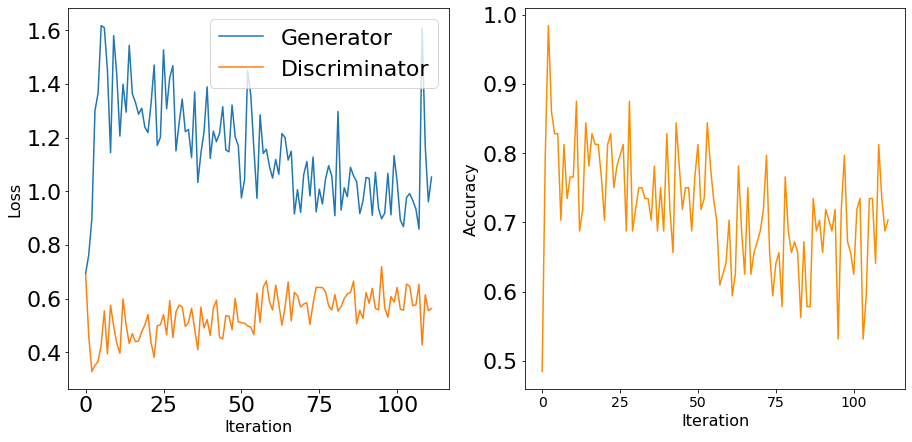

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11101 [D loss: 0.584029, acc.: 78.12%] [G loss: 0.923132]
11102 [D loss: 0.521287, acc.: 75.00%] [G loss: 1.178879]
11103 [D loss: 0.614437, acc.: 65.62%] [G loss: 0.945647]
11104 [D loss: 0.623793, acc.: 71.88%] [G loss: 1.069896]
11105 [D loss: 0.576742, acc.: 67.19%] [G loss: 1.261789]
11106 [D loss: 0.552181, acc.: 71.88%] [G loss: 1.062493]
11107 [D loss: 0.556102, acc.: 73.44%] [G loss: 1.269153]
11108 [D loss: 0.572536, acc.: 68.75%] [G loss: 1.146510]
11109 [D loss: 0.462343, acc.: 79.69%] [G loss: 1.385335]
11110 [D loss: 0.583982, acc.: 68.75%] [G loss: 1.103575]
11111 [D loss: 0.576038, acc.: 65.62%] [G loss: 1.116123]
11112 [D loss: 0.631617, acc.: 62.50%] [G loss: 0.933778]
11113 [D loss: 0.566195, acc.: 75.00%] [G loss: 0.888485]
11114 [D loss: 0.580764, acc.: 68.75%] [G loss: 0.926628]
11115 [D loss: 0.634134, acc.: 59.38%] [G loss: 0.903735]
11116 [D loss: 0.532701, acc.: 73.44%] [G loss: 1.095255]
11117 [D loss: 0.532902, acc.: 71.88%] [G loss: 1.255873]
11118 [D loss:

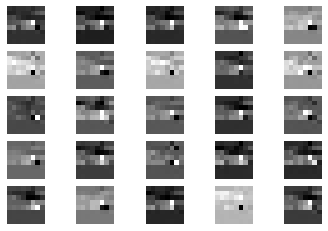

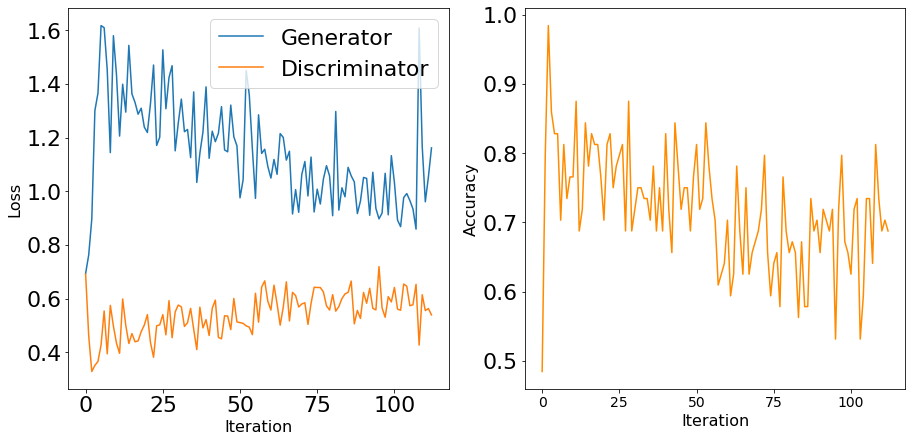

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11201 [D loss: 0.527223, acc.: 78.12%] [G loss: 0.986060]
11202 [D loss: 0.608727, acc.: 62.50%] [G loss: 1.002698]
11203 [D loss: 0.589685, acc.: 70.31%] [G loss: 0.948434]
11204 [D loss: 0.606901, acc.: 62.50%] [G loss: 0.793947]
11205 [D loss: 0.601655, acc.: 65.62%] [G loss: 0.868309]
11206 [D loss: 0.666328, acc.: 57.81%] [G loss: 0.986974]
11207 [D loss: 0.665851, acc.: 65.62%] [G loss: 0.832773]
11208 [D loss: 0.655666, acc.: 60.94%] [G loss: 0.987438]
11209 [D loss: 0.576225, acc.: 65.62%] [G loss: 0.995883]
11210 [D loss: 0.609701, acc.: 70.31%] [G loss: 1.013221]
11211 [D loss: 0.571269, acc.: 65.62%] [G loss: 0.849590]
11212 [D loss: 0.644969, acc.: 59.38%] [G loss: 0.941486]
11213 [D loss: 0.629925, acc.: 65.62%] [G loss: 1.012196]
11214 [D loss: 0.608953, acc.: 64.06%] [G loss: 1.003401]
11215 [D loss: 0.605116, acc.: 68.75%] [G loss: 0.954287]
11216 [D loss: 0.610241, acc.: 68.75%] [G loss: 1.002533]
11217 [D loss: 0.595609, acc.: 60.94%] [G loss: 0.840571]
11218 [D loss:

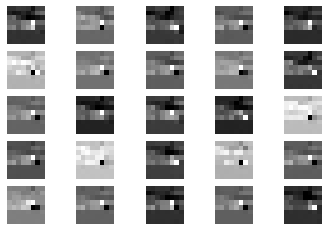

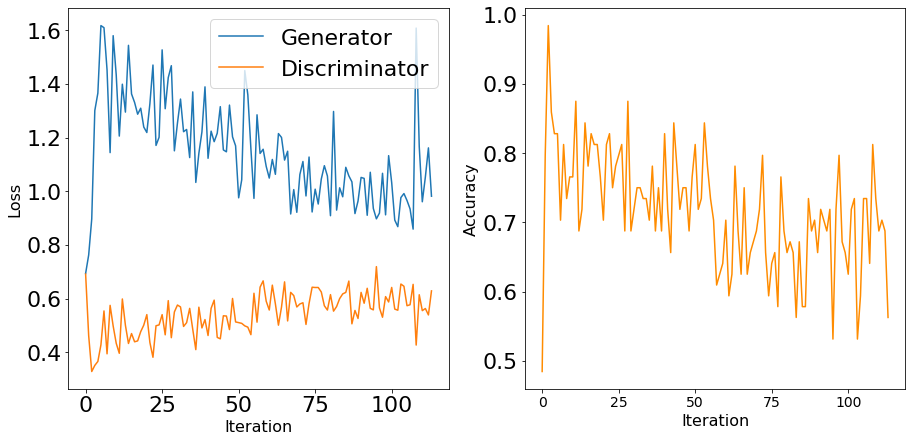

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11301 [D loss: 0.476354, acc.: 81.25%] [G loss: 1.055150]
11302 [D loss: 0.500727, acc.: 78.12%] [G loss: 1.138919]
11303 [D loss: 0.581028, acc.: 75.00%] [G loss: 0.872986]
11304 [D loss: 0.574594, acc.: 71.88%] [G loss: 0.958365]
11305 [D loss: 0.641273, acc.: 65.62%] [G loss: 0.963971]
11306 [D loss: 0.658009, acc.: 64.06%] [G loss: 0.965984]
11307 [D loss: 0.536582, acc.: 75.00%] [G loss: 0.911499]
11308 [D loss: 0.585328, acc.: 60.94%] [G loss: 1.037183]
11309 [D loss: 0.612422, acc.: 67.19%] [G loss: 1.020075]
11310 [D loss: 0.586791, acc.: 62.50%] [G loss: 1.052862]
11311 [D loss: 0.562529, acc.: 68.75%] [G loss: 0.973174]
11312 [D loss: 0.486870, acc.: 79.69%] [G loss: 1.025001]
11313 [D loss: 0.503956, acc.: 78.12%] [G loss: 1.098208]
11314 [D loss: 0.525578, acc.: 73.44%] [G loss: 0.786011]
11315 [D loss: 0.650507, acc.: 62.50%] [G loss: 1.011333]
11316 [D loss: 0.539596, acc.: 78.12%] [G loss: 1.071570]
11317 [D loss: 0.502360, acc.: 73.44%] [G loss: 1.437922]
11318 [D loss:

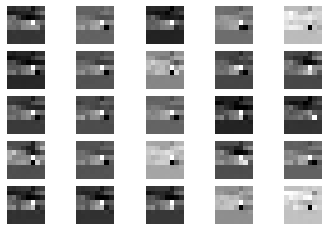

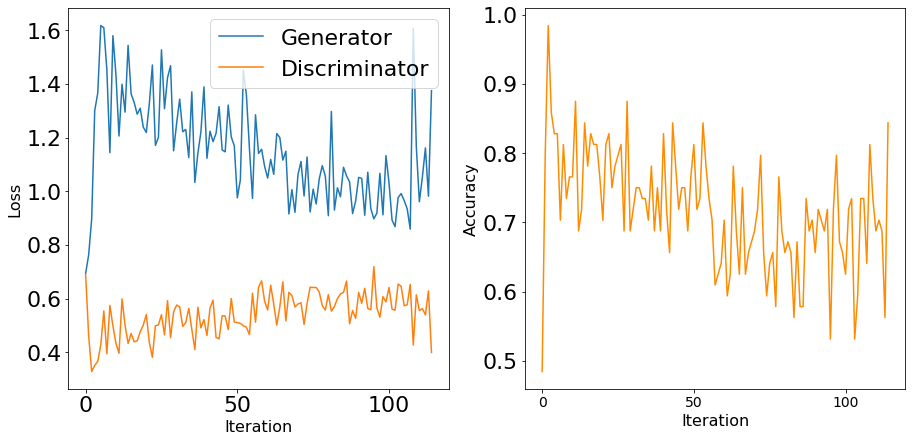

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11401 [D loss: 0.634802, acc.: 60.94%] [G loss: 1.427056]
11402 [D loss: 0.424302, acc.: 82.81%] [G loss: 1.675074]
11403 [D loss: 0.552551, acc.: 75.00%] [G loss: 0.957124]
11404 [D loss: 0.622654, acc.: 65.62%] [G loss: 1.156183]
11405 [D loss: 0.603463, acc.: 70.31%] [G loss: 1.007593]
11406 [D loss: 0.597174, acc.: 70.31%] [G loss: 1.048321]
11407 [D loss: 0.607373, acc.: 65.62%] [G loss: 0.874382]
11408 [D loss: 0.562558, acc.: 70.31%] [G loss: 0.776506]
11409 [D loss: 0.650008, acc.: 64.06%] [G loss: 0.882486]
11410 [D loss: 0.582003, acc.: 65.62%] [G loss: 0.992980]
11411 [D loss: 0.540784, acc.: 71.88%] [G loss: 1.246843]
11412 [D loss: 0.471946, acc.: 76.56%] [G loss: 1.140274]
11413 [D loss: 0.611199, acc.: 60.94%] [G loss: 0.990647]
11414 [D loss: 0.640898, acc.: 60.94%] [G loss: 0.976333]
11415 [D loss: 0.558596, acc.: 70.31%] [G loss: 0.982895]
11416 [D loss: 0.591983, acc.: 60.94%] [G loss: 1.047839]
11417 [D loss: 0.522367, acc.: 75.00%] [G loss: 1.064647]
11418 [D loss:

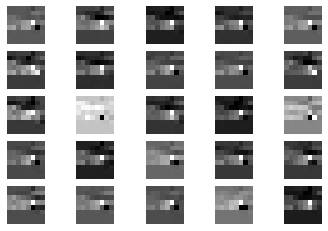

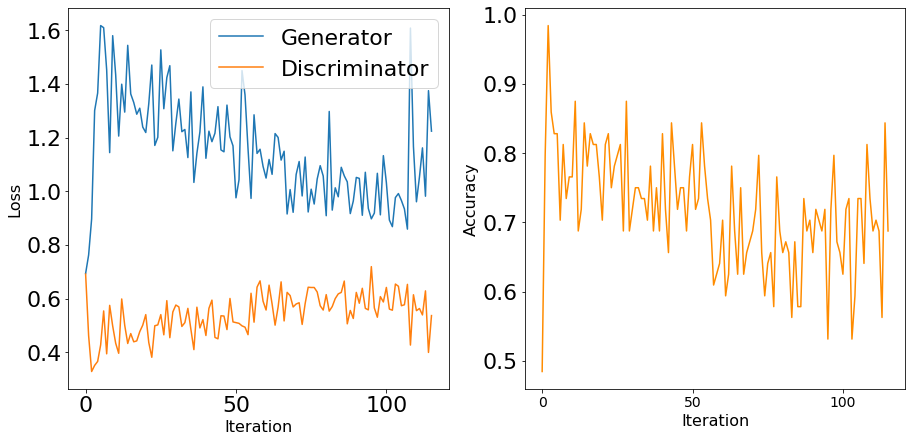

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11501 [D loss: 0.594668, acc.: 68.75%] [G loss: 1.029802]
11502 [D loss: 0.598396, acc.: 56.25%] [G loss: 1.226318]
11503 [D loss: 0.544266, acc.: 73.44%] [G loss: 0.998184]
11504 [D loss: 0.539044, acc.: 81.25%] [G loss: 1.116855]
11505 [D loss: 0.499114, acc.: 78.12%] [G loss: 1.114393]
11506 [D loss: 0.580147, acc.: 68.75%] [G loss: 0.957520]
11507 [D loss: 0.588127, acc.: 71.88%] [G loss: 0.974528]
11508 [D loss: 0.597806, acc.: 67.19%] [G loss: 1.198567]
11509 [D loss: 0.677664, acc.: 60.94%] [G loss: 0.811272]
11510 [D loss: 0.596315, acc.: 67.19%] [G loss: 0.911418]
11511 [D loss: 0.588385, acc.: 65.62%] [G loss: 0.885251]
11512 [D loss: 0.599087, acc.: 64.06%] [G loss: 0.888503]
11513 [D loss: 0.657064, acc.: 64.06%] [G loss: 0.849896]
11514 [D loss: 0.604154, acc.: 65.62%] [G loss: 1.041584]
11515 [D loss: 0.514053, acc.: 78.12%] [G loss: 1.266136]
11516 [D loss: 0.493311, acc.: 73.44%] [G loss: 1.360819]
11517 [D loss: 0.561478, acc.: 62.50%] [G loss: 1.024726]
11518 [D loss:

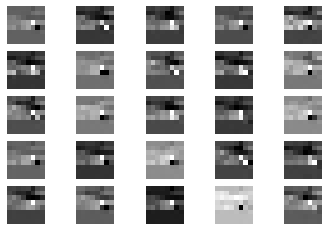

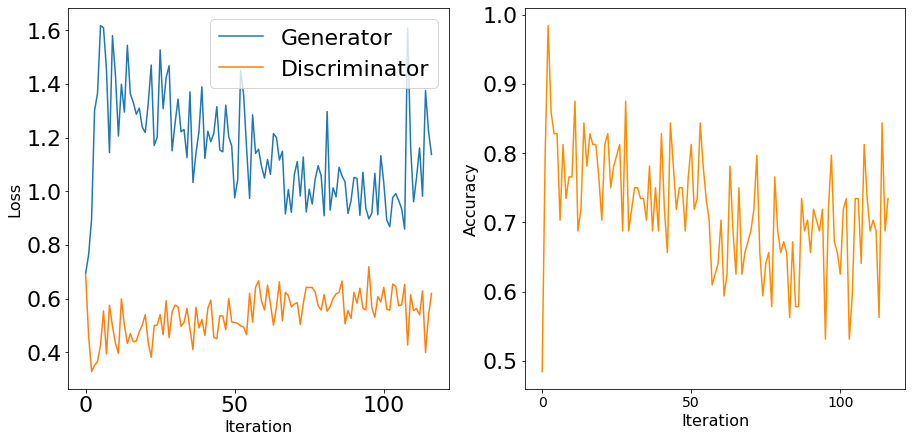

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11601 [D loss: 0.574313, acc.: 70.31%] [G loss: 0.916101]
11602 [D loss: 0.581123, acc.: 64.06%] [G loss: 1.041425]
11603 [D loss: 0.595606, acc.: 68.75%] [G loss: 0.961976]
11604 [D loss: 0.632077, acc.: 64.06%] [G loss: 0.940337]
11605 [D loss: 0.540416, acc.: 71.88%] [G loss: 1.068305]
11606 [D loss: 0.552301, acc.: 71.88%] [G loss: 1.206538]
11607 [D loss: 0.608482, acc.: 65.62%] [G loss: 1.028259]
11608 [D loss: 0.597997, acc.: 65.62%] [G loss: 0.989757]
11609 [D loss: 0.637457, acc.: 67.19%] [G loss: 1.011213]
11610 [D loss: 0.589130, acc.: 67.19%] [G loss: 0.880875]
11611 [D loss: 0.620014, acc.: 65.62%] [G loss: 0.954886]
11612 [D loss: 0.574637, acc.: 71.88%] [G loss: 0.886354]
11613 [D loss: 0.540038, acc.: 73.44%] [G loss: 0.893781]
11614 [D loss: 0.650992, acc.: 59.38%] [G loss: 0.932890]
11615 [D loss: 0.498102, acc.: 81.25%] [G loss: 0.940664]
11616 [D loss: 0.540038, acc.: 75.00%] [G loss: 0.893899]
11617 [D loss: 0.646235, acc.: 56.25%] [G loss: 0.887193]
11618 [D loss:

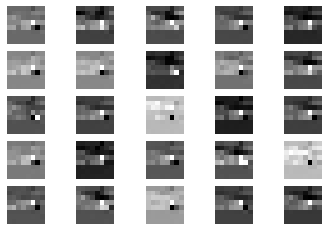

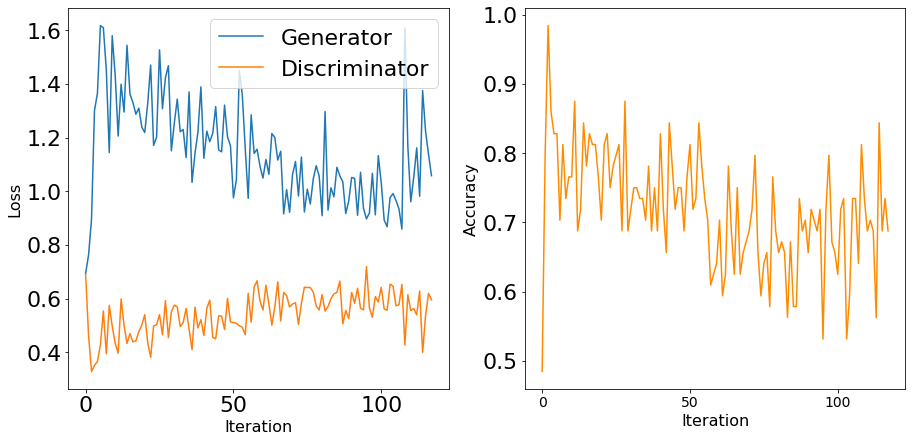

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11701 [D loss: 0.412615, acc.: 82.81%] [G loss: 2.120593]
11702 [D loss: 0.544765, acc.: 71.88%] [G loss: 0.994708]
11703 [D loss: 0.474217, acc.: 75.00%] [G loss: 1.538949]
11704 [D loss: 0.642666, acc.: 64.06%] [G loss: 0.904408]
11705 [D loss: 0.569591, acc.: 68.75%] [G loss: 1.204461]
11706 [D loss: 0.631288, acc.: 62.50%] [G loss: 0.922307]
11707 [D loss: 0.554772, acc.: 67.19%] [G loss: 1.122278]
11708 [D loss: 0.539702, acc.: 75.00%] [G loss: 1.338398]
11709 [D loss: 0.569837, acc.: 70.31%] [G loss: 1.078329]
11710 [D loss: 0.642481, acc.: 67.19%] [G loss: 1.044955]
11711 [D loss: 0.543913, acc.: 76.56%] [G loss: 1.152050]
11712 [D loss: 0.618459, acc.: 62.50%] [G loss: 0.973017]
11713 [D loss: 0.499241, acc.: 75.00%] [G loss: 0.974372]
11714 [D loss: 0.596552, acc.: 65.62%] [G loss: 0.868356]
11715 [D loss: 0.598734, acc.: 64.06%] [G loss: 0.779388]
11716 [D loss: 0.569192, acc.: 62.50%] [G loss: 0.857601]
11717 [D loss: 0.631779, acc.: 67.19%] [G loss: 0.961613]
11718 [D loss:

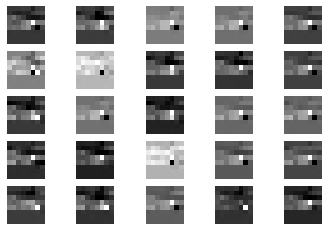

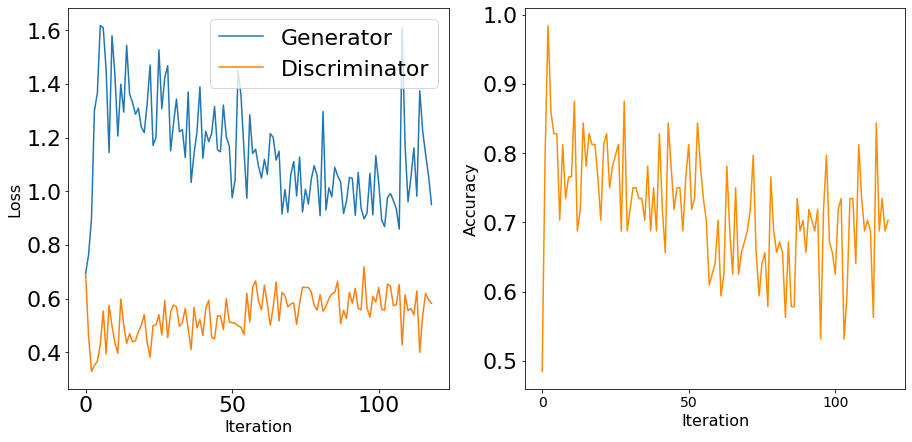

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11801 [D loss: 0.668031, acc.: 59.38%] [G loss: 0.965043]
11802 [D loss: 0.598180, acc.: 62.50%] [G loss: 0.793122]
11803 [D loss: 0.677281, acc.: 57.81%] [G loss: 0.931668]
11804 [D loss: 0.554600, acc.: 73.44%] [G loss: 0.898141]
11805 [D loss: 0.583695, acc.: 70.31%] [G loss: 1.296028]
11806 [D loss: 0.661276, acc.: 57.81%] [G loss: 1.188068]
11807 [D loss: 0.594800, acc.: 64.06%] [G loss: 1.005094]
11808 [D loss: 0.647622, acc.: 64.06%] [G loss: 0.967285]
11809 [D loss: 0.601151, acc.: 68.75%] [G loss: 1.104872]
11810 [D loss: 0.503402, acc.: 75.00%] [G loss: 1.112018]
11811 [D loss: 0.614394, acc.: 71.88%] [G loss: 0.981039]
11812 [D loss: 0.647964, acc.: 62.50%] [G loss: 1.050796]
11813 [D loss: 0.573470, acc.: 68.75%] [G loss: 0.851144]
11814 [D loss: 0.624595, acc.: 67.19%] [G loss: 0.938744]
11815 [D loss: 0.538060, acc.: 73.44%] [G loss: 0.981398]
11816 [D loss: 0.561516, acc.: 60.94%] [G loss: 1.130617]
11817 [D loss: 0.589409, acc.: 64.06%] [G loss: 1.184968]
11818 [D loss:

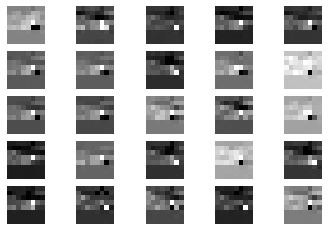

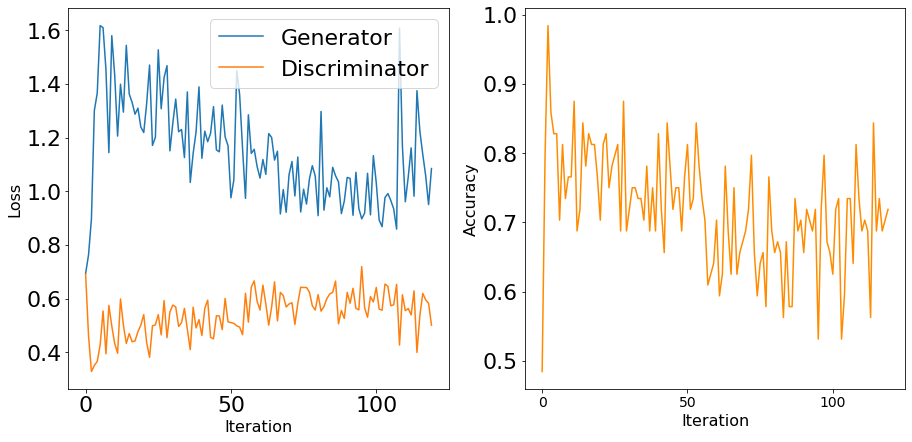

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


11901 [D loss: 0.548748, acc.: 70.31%] [G loss: 1.102310]
11902 [D loss: 0.516981, acc.: 71.88%] [G loss: 1.042535]
11903 [D loss: 0.605679, acc.: 67.19%] [G loss: 0.913853]
11904 [D loss: 0.593094, acc.: 65.62%] [G loss: 0.909075]
11905 [D loss: 0.614449, acc.: 75.00%] [G loss: 0.857040]
11906 [D loss: 0.614532, acc.: 62.50%] [G loss: 0.918906]
11907 [D loss: 0.637424, acc.: 62.50%] [G loss: 1.138443]
11908 [D loss: 0.598380, acc.: 71.88%] [G loss: 0.885625]
11909 [D loss: 0.548206, acc.: 67.19%] [G loss: 1.400650]
11910 [D loss: 0.586116, acc.: 62.50%] [G loss: 1.061694]
11911 [D loss: 0.626844, acc.: 57.81%] [G loss: 0.844641]
11912 [D loss: 0.636409, acc.: 62.50%] [G loss: 1.015583]
11913 [D loss: 0.563191, acc.: 68.75%] [G loss: 0.897452]
11914 [D loss: 0.572617, acc.: 75.00%] [G loss: 0.906621]
11915 [D loss: 0.588590, acc.: 68.75%] [G loss: 0.889964]
11916 [D loss: 0.653211, acc.: 65.62%] [G loss: 1.015596]
11917 [D loss: 0.557592, acc.: 71.88%] [G loss: 1.068735]
11918 [D loss:

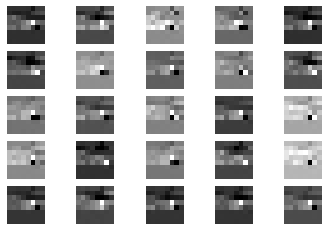

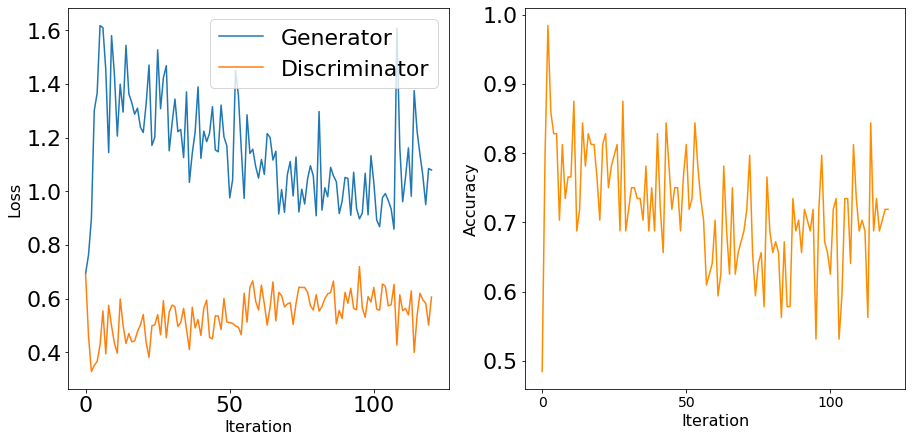

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12001 [D loss: 0.599315, acc.: 65.62%] [G loss: 0.945079]
12002 [D loss: 0.553432, acc.: 73.44%] [G loss: 1.057198]
12003 [D loss: 0.618282, acc.: 57.81%] [G loss: 0.995532]
12004 [D loss: 0.604685, acc.: 71.88%] [G loss: 1.157312]
12005 [D loss: 0.484615, acc.: 81.25%] [G loss: 1.130658]
12006 [D loss: 0.619214, acc.: 59.38%] [G loss: 0.942774]
12007 [D loss: 0.602854, acc.: 68.75%] [G loss: 0.826153]
12008 [D loss: 0.615791, acc.: 68.75%] [G loss: 0.941501]
12009 [D loss: 0.561365, acc.: 67.19%] [G loss: 1.041900]
12010 [D loss: 0.613551, acc.: 65.62%] [G loss: 0.859005]
12011 [D loss: 0.545829, acc.: 71.88%] [G loss: 0.971748]
12012 [D loss: 0.574965, acc.: 73.44%] [G loss: 0.968086]
12013 [D loss: 0.546385, acc.: 73.44%] [G loss: 1.094444]
12014 [D loss: 0.601261, acc.: 64.06%] [G loss: 0.946645]
12015 [D loss: 0.583426, acc.: 67.19%] [G loss: 0.893729]
12016 [D loss: 0.605948, acc.: 62.50%] [G loss: 0.920009]
12017 [D loss: 0.543460, acc.: 75.00%] [G loss: 0.830812]
12018 [D loss:

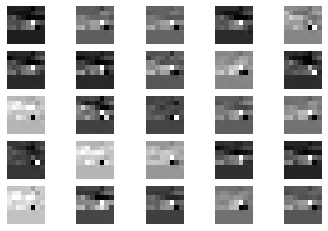

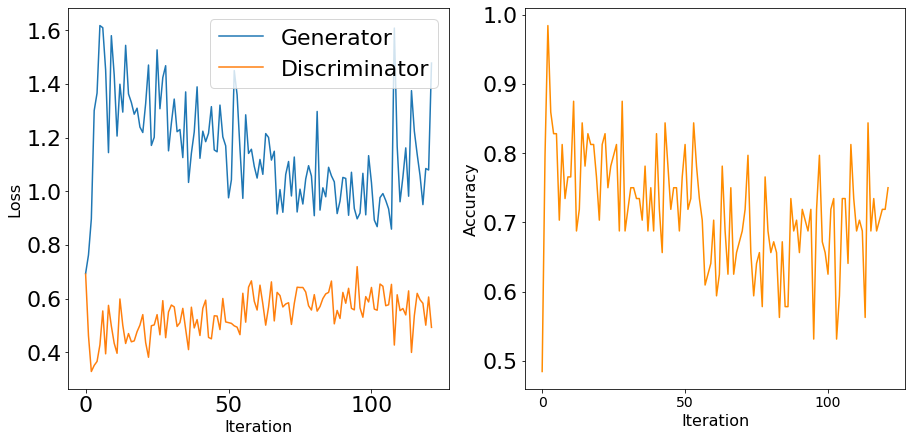

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12101 [D loss: 0.567138, acc.: 71.88%] [G loss: 0.903957]
12102 [D loss: 0.625454, acc.: 60.94%] [G loss: 0.917560]
12103 [D loss: 0.582355, acc.: 68.75%] [G loss: 1.093476]
12104 [D loss: 0.625466, acc.: 65.62%] [G loss: 0.992868]
12105 [D loss: 0.603850, acc.: 65.62%] [G loss: 0.903844]
12106 [D loss: 0.584798, acc.: 70.31%] [G loss: 1.055452]
12107 [D loss: 0.483651, acc.: 82.81%] [G loss: 1.030775]
12108 [D loss: 0.635198, acc.: 62.50%] [G loss: 0.783757]
12109 [D loss: 0.626182, acc.: 68.75%] [G loss: 0.937096]
12110 [D loss: 0.520369, acc.: 76.56%] [G loss: 1.041330]
12111 [D loss: 0.558396, acc.: 70.31%] [G loss: 0.960536]
12112 [D loss: 0.651078, acc.: 62.50%] [G loss: 0.915021]
12113 [D loss: 0.686621, acc.: 56.25%] [G loss: 0.906718]
12114 [D loss: 0.623109, acc.: 67.19%] [G loss: 0.893956]
12115 [D loss: 0.591607, acc.: 76.56%] [G loss: 0.882474]
12116 [D loss: 0.562350, acc.: 62.50%] [G loss: 0.973390]
12117 [D loss: 0.613940, acc.: 62.50%] [G loss: 0.985121]
12118 [D loss:

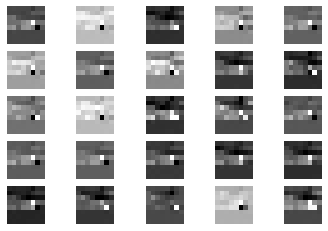

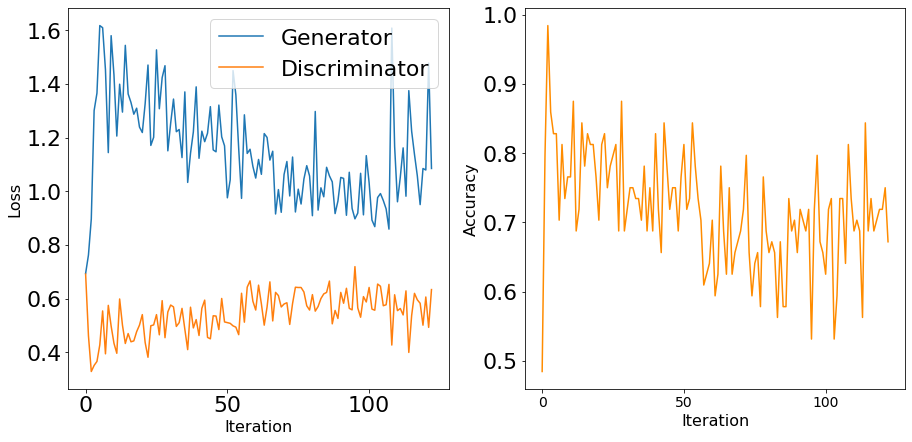

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12201 [D loss: 0.632933, acc.: 65.62%] [G loss: 1.152406]
12202 [D loss: 0.518853, acc.: 71.88%] [G loss: 1.808137]
12203 [D loss: 0.517069, acc.: 75.00%] [G loss: 1.081377]
12204 [D loss: 0.502723, acc.: 79.69%] [G loss: 1.272949]
12205 [D loss: 0.471282, acc.: 79.69%] [G loss: 1.471530]
12206 [D loss: 0.621950, acc.: 70.31%] [G loss: 1.101235]
12207 [D loss: 0.588563, acc.: 71.88%] [G loss: 0.961430]
12208 [D loss: 0.475165, acc.: 81.25%] [G loss: 1.438037]
12209 [D loss: 0.687221, acc.: 65.62%] [G loss: 0.905609]
12210 [D loss: 0.657313, acc.: 56.25%] [G loss: 0.937238]
12211 [D loss: 0.526616, acc.: 78.12%] [G loss: 0.943727]
12212 [D loss: 0.545273, acc.: 71.88%] [G loss: 1.007069]
12213 [D loss: 0.526680, acc.: 73.44%] [G loss: 1.090745]
12214 [D loss: 0.484617, acc.: 81.25%] [G loss: 1.392541]
12215 [D loss: 0.484108, acc.: 84.38%] [G loss: 1.152283]
12216 [D loss: 0.602762, acc.: 70.31%] [G loss: 0.941581]
12217 [D loss: 0.523323, acc.: 82.81%] [G loss: 0.999973]
12218 [D loss:

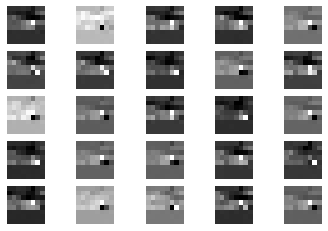

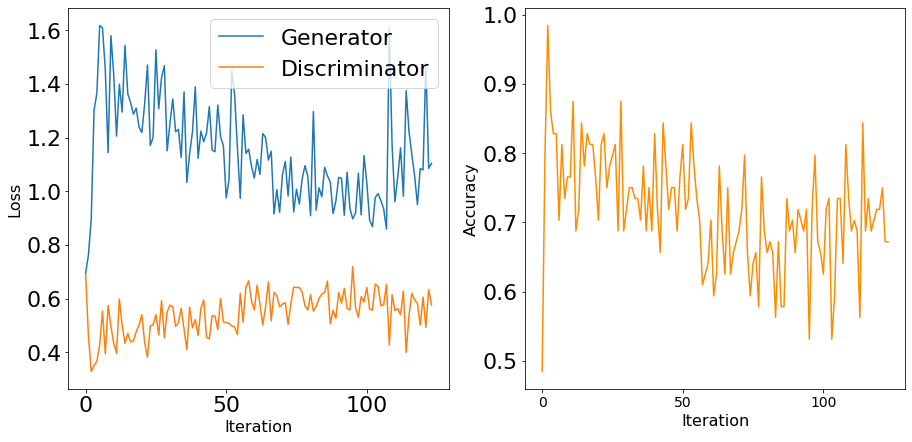

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12301 [D loss: 0.601331, acc.: 68.75%] [G loss: 0.869115]
12302 [D loss: 0.642233, acc.: 62.50%] [G loss: 1.177078]
12303 [D loss: 0.585306, acc.: 65.62%] [G loss: 1.203556]
12304 [D loss: 0.582018, acc.: 71.88%] [G loss: 0.964629]
12305 [D loss: 0.654719, acc.: 59.38%] [G loss: 0.928675]
12306 [D loss: 0.621276, acc.: 60.94%] [G loss: 1.089221]
12307 [D loss: 0.541212, acc.: 76.56%] [G loss: 0.907715]
12308 [D loss: 0.681392, acc.: 57.81%] [G loss: 0.914956]
12309 [D loss: 0.596255, acc.: 71.88%] [G loss: 0.952470]
12310 [D loss: 0.644207, acc.: 60.94%] [G loss: 0.898618]
12311 [D loss: 0.639738, acc.: 59.38%] [G loss: 0.907488]
12312 [D loss: 0.571769, acc.: 64.06%] [G loss: 1.074491]
12313 [D loss: 0.594295, acc.: 67.19%] [G loss: 0.998187]
12314 [D loss: 0.715990, acc.: 53.12%] [G loss: 0.979560]
12315 [D loss: 0.550780, acc.: 76.56%] [G loss: 1.079763]
12316 [D loss: 0.609701, acc.: 60.94%] [G loss: 1.027670]
12317 [D loss: 0.517248, acc.: 75.00%] [G loss: 1.112511]
12318 [D loss:

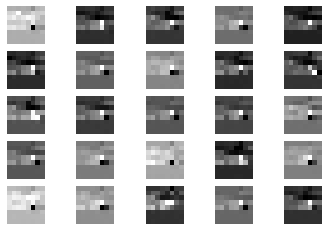

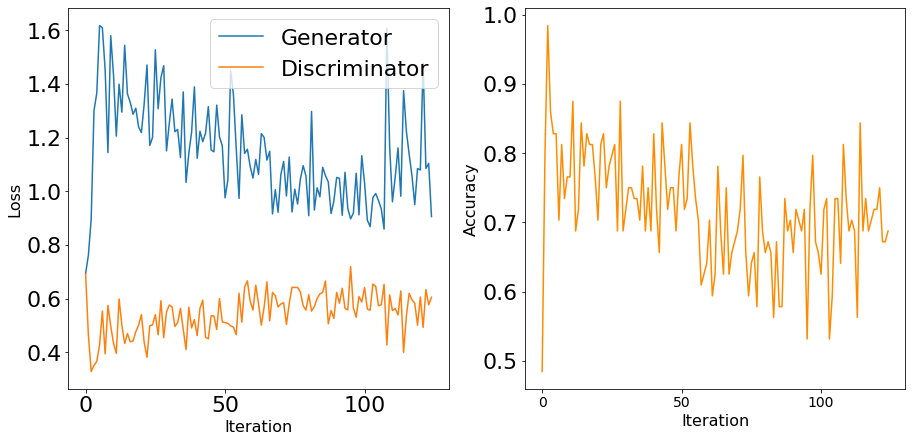

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12401 [D loss: 0.490987, acc.: 82.81%] [G loss: 0.951786]
12402 [D loss: 0.609766, acc.: 71.88%] [G loss: 0.968623]
12403 [D loss: 0.578464, acc.: 67.19%] [G loss: 0.958752]
12404 [D loss: 0.542277, acc.: 70.31%] [G loss: 1.627909]
12405 [D loss: 0.517188, acc.: 78.12%] [G loss: 1.119497]
12406 [D loss: 0.544371, acc.: 67.19%] [G loss: 1.194014]
12407 [D loss: 0.677848, acc.: 53.12%] [G loss: 0.952137]
12408 [D loss: 0.629434, acc.: 57.81%] [G loss: 0.987097]
12409 [D loss: 0.610252, acc.: 64.06%] [G loss: 0.855333]
12410 [D loss: 0.602794, acc.: 71.88%] [G loss: 0.898392]
12411 [D loss: 0.584464, acc.: 73.44%] [G loss: 0.870631]
12412 [D loss: 0.603576, acc.: 62.50%] [G loss: 0.861861]
12413 [D loss: 0.687161, acc.: 56.25%] [G loss: 0.889254]
12414 [D loss: 0.605055, acc.: 60.94%] [G loss: 0.915884]
12415 [D loss: 0.602587, acc.: 62.50%] [G loss: 0.989046]
12416 [D loss: 0.640012, acc.: 62.50%] [G loss: 0.949694]
12417 [D loss: 0.449065, acc.: 79.69%] [G loss: 1.173475]
12418 [D loss:

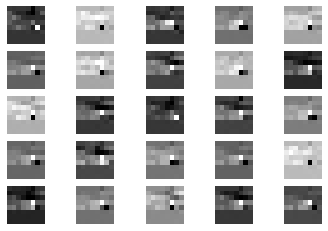

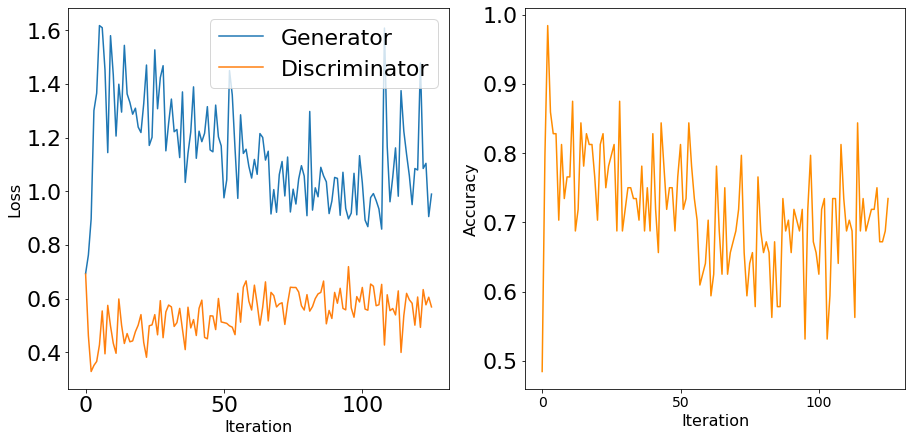

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12501 [D loss: 0.636037, acc.: 68.75%] [G loss: 0.981227]
12502 [D loss: 0.728615, acc.: 51.56%] [G loss: 0.978820]
12503 [D loss: 0.610556, acc.: 67.19%] [G loss: 0.897737]
12504 [D loss: 0.568566, acc.: 67.19%] [G loss: 1.052715]
12505 [D loss: 0.592749, acc.: 71.88%] [G loss: 0.893783]
12506 [D loss: 0.600085, acc.: 68.75%] [G loss: 0.994500]
12507 [D loss: 0.560533, acc.: 73.44%] [G loss: 0.955363]
12508 [D loss: 0.677277, acc.: 60.94%] [G loss: 0.947569]
12509 [D loss: 0.676566, acc.: 59.38%] [G loss: 1.256873]
12510 [D loss: 0.566504, acc.: 60.94%] [G loss: 1.298563]
12511 [D loss: 0.541832, acc.: 76.56%] [G loss: 1.059666]
12512 [D loss: 0.558893, acc.: 71.88%] [G loss: 0.954329]
12513 [D loss: 0.554675, acc.: 71.88%] [G loss: 0.875878]
12514 [D loss: 0.608267, acc.: 59.38%] [G loss: 0.982329]
12515 [D loss: 0.592390, acc.: 71.88%] [G loss: 0.967821]
12516 [D loss: 0.591409, acc.: 68.75%] [G loss: 0.948411]
12517 [D loss: 0.728864, acc.: 56.25%] [G loss: 1.018410]
12518 [D loss:

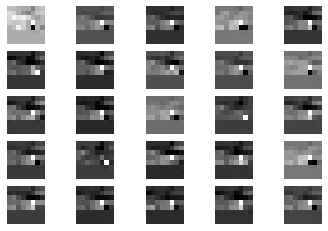

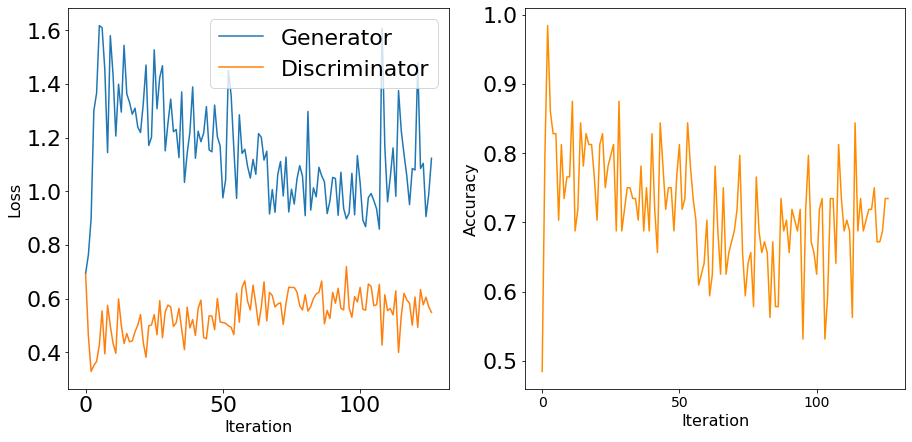

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12601 [D loss: 0.573770, acc.: 70.31%] [G loss: 1.207616]
12602 [D loss: 0.535457, acc.: 76.56%] [G loss: 0.949300]
12603 [D loss: 0.534237, acc.: 73.44%] [G loss: 1.045904]
12604 [D loss: 0.576073, acc.: 70.31%] [G loss: 0.921682]
12605 [D loss: 0.661404, acc.: 67.19%] [G loss: 0.915655]
12606 [D loss: 0.582224, acc.: 71.88%] [G loss: 0.996687]
12607 [D loss: 0.558165, acc.: 68.75%] [G loss: 1.063035]
12608 [D loss: 0.622159, acc.: 64.06%] [G loss: 0.898000]
12609 [D loss: 0.609083, acc.: 67.19%] [G loss: 0.822251]
12610 [D loss: 0.534830, acc.: 75.00%] [G loss: 1.161003]
12611 [D loss: 0.488821, acc.: 75.00%] [G loss: 1.640653]
12612 [D loss: 0.593304, acc.: 73.44%] [G loss: 0.910550]
12613 [D loss: 0.590864, acc.: 62.50%] [G loss: 0.885980]
12614 [D loss: 0.512539, acc.: 82.81%] [G loss: 0.738529]
12615 [D loss: 0.634235, acc.: 59.38%] [G loss: 0.903083]
12616 [D loss: 0.523023, acc.: 70.31%] [G loss: 1.036747]
12617 [D loss: 0.540569, acc.: 71.88%] [G loss: 1.156894]
12618 [D loss:

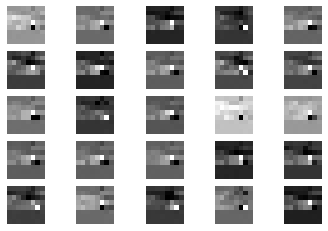

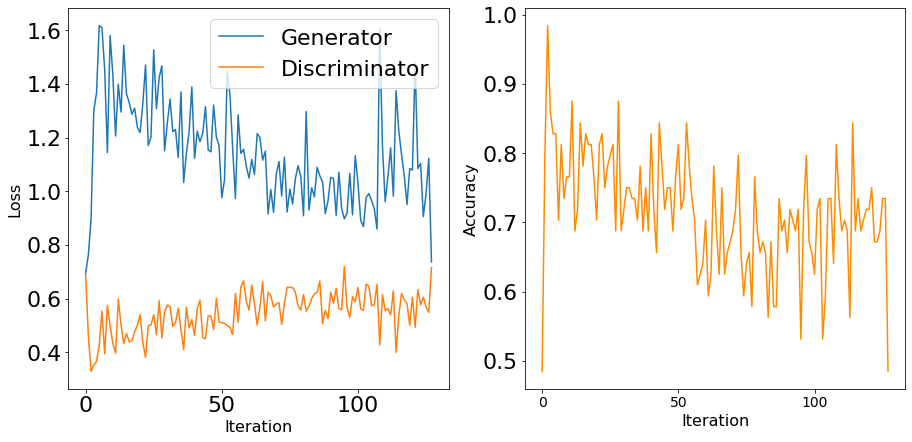

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12701 [D loss: 0.560880, acc.: 68.75%] [G loss: 0.948673]
12702 [D loss: 0.637144, acc.: 64.06%] [G loss: 1.041281]
12703 [D loss: 0.557123, acc.: 70.31%] [G loss: 1.001664]
12704 [D loss: 0.667778, acc.: 60.94%] [G loss: 1.089216]
12705 [D loss: 0.516161, acc.: 75.00%] [G loss: 1.087144]
12706 [D loss: 0.648987, acc.: 64.06%] [G loss: 0.824406]
12707 [D loss: 0.557925, acc.: 68.75%] [G loss: 1.078004]
12708 [D loss: 0.517883, acc.: 79.69%] [G loss: 1.133199]
12709 [D loss: 0.670605, acc.: 59.38%] [G loss: 0.945328]
12710 [D loss: 0.626342, acc.: 62.50%] [G loss: 0.841887]
12711 [D loss: 0.571442, acc.: 70.31%] [G loss: 0.868853]
12712 [D loss: 0.618559, acc.: 68.75%] [G loss: 1.040935]
12713 [D loss: 0.519296, acc.: 75.00%] [G loss: 1.038104]
12714 [D loss: 0.601744, acc.: 70.31%] [G loss: 0.990920]
12715 [D loss: 0.568469, acc.: 70.31%] [G loss: 0.859817]
12716 [D loss: 0.605735, acc.: 67.19%] [G loss: 0.895472]
12717 [D loss: 0.591969, acc.: 65.62%] [G loss: 0.859209]
12718 [D loss:

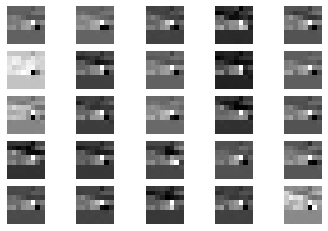

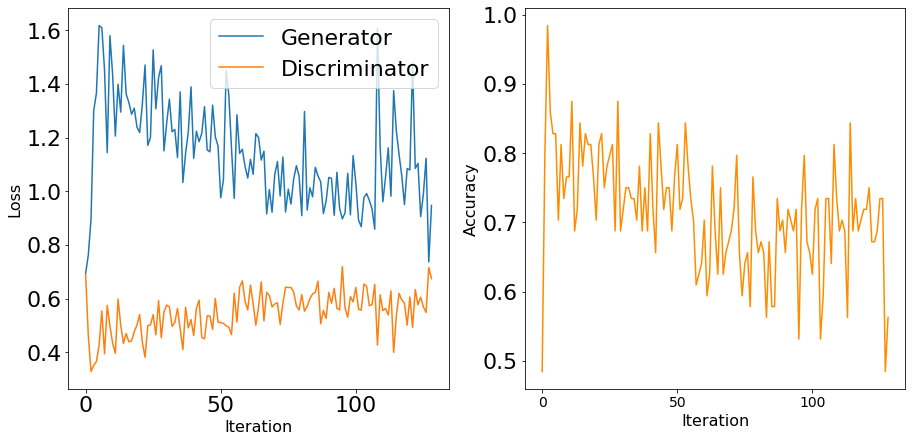

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12801 [D loss: 0.575878, acc.: 62.50%] [G loss: 1.126371]
12802 [D loss: 0.567294, acc.: 68.75%] [G loss: 0.911054]
12803 [D loss: 0.580206, acc.: 57.81%] [G loss: 0.889955]
12804 [D loss: 0.501057, acc.: 79.69%] [G loss: 1.084597]
12805 [D loss: 0.547819, acc.: 70.31%] [G loss: 0.991759]
12806 [D loss: 0.556032, acc.: 70.31%] [G loss: 0.898864]
12807 [D loss: 0.575210, acc.: 71.88%] [G loss: 0.811156]
12808 [D loss: 0.556469, acc.: 73.44%] [G loss: 0.852369]
12809 [D loss: 0.632754, acc.: 59.38%] [G loss: 0.958876]
12810 [D loss: 0.457615, acc.: 79.69%] [G loss: 1.465284]
12811 [D loss: 0.641689, acc.: 60.94%] [G loss: 0.897957]
12812 [D loss: 0.698618, acc.: 60.94%] [G loss: 0.814446]
12813 [D loss: 0.608654, acc.: 64.06%] [G loss: 1.020567]
12814 [D loss: 0.537032, acc.: 71.88%] [G loss: 1.170678]
12815 [D loss: 0.642172, acc.: 70.31%] [G loss: 0.849551]
12816 [D loss: 0.598694, acc.: 67.19%] [G loss: 0.917742]
12817 [D loss: 0.610855, acc.: 71.88%] [G loss: 1.013539]
12818 [D loss:

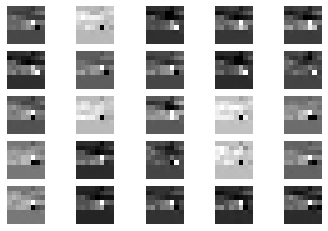

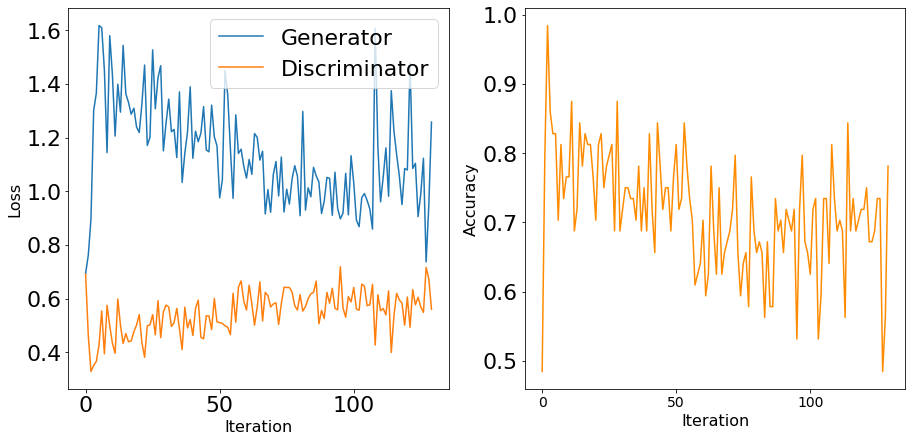

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


12901 [D loss: 0.624306, acc.: 62.50%] [G loss: 1.065804]
12902 [D loss: 0.641355, acc.: 67.19%] [G loss: 1.038184]
12903 [D loss: 0.610089, acc.: 68.75%] [G loss: 0.751095]
12904 [D loss: 0.519293, acc.: 75.00%] [G loss: 0.980572]
12905 [D loss: 0.572552, acc.: 68.75%] [G loss: 1.071808]
12906 [D loss: 0.583103, acc.: 65.62%] [G loss: 1.198323]
12907 [D loss: 0.546417, acc.: 68.75%] [G loss: 0.871743]
12908 [D loss: 0.696148, acc.: 57.81%] [G loss: 0.890996]
12909 [D loss: 0.535452, acc.: 71.88%] [G loss: 0.975018]
12910 [D loss: 0.587851, acc.: 62.50%] [G loss: 0.982662]
12911 [D loss: 0.567824, acc.: 64.06%] [G loss: 0.863038]
12912 [D loss: 0.580613, acc.: 71.88%] [G loss: 1.144037]
12913 [D loss: 0.507035, acc.: 76.56%] [G loss: 1.192377]
12914 [D loss: 0.559218, acc.: 70.31%] [G loss: 1.084376]
12915 [D loss: 0.592704, acc.: 70.31%] [G loss: 0.850052]
12916 [D loss: 0.666591, acc.: 54.69%] [G loss: 0.842221]
12917 [D loss: 0.662058, acc.: 57.81%] [G loss: 0.935154]
12918 [D loss:

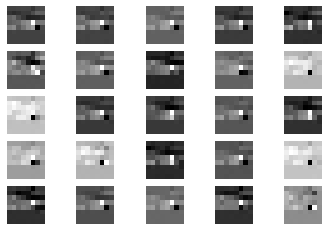

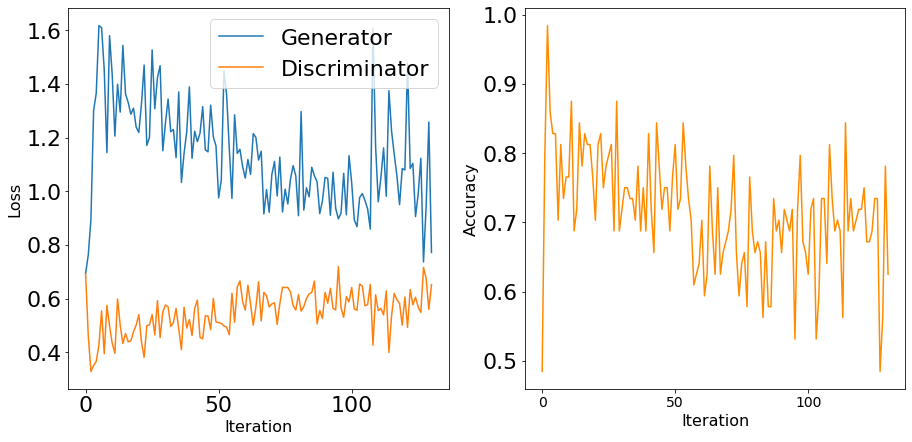

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13001 [D loss: 0.623507, acc.: 62.50%] [G loss: 1.220895]
13002 [D loss: 0.451255, acc.: 82.81%] [G loss: 1.199590]
13003 [D loss: 0.572026, acc.: 65.62%] [G loss: 0.820993]
13004 [D loss: 0.595859, acc.: 68.75%] [G loss: 0.711158]
13005 [D loss: 0.626099, acc.: 65.62%] [G loss: 0.918788]
13006 [D loss: 0.638820, acc.: 57.81%] [G loss: 0.838491]
13007 [D loss: 0.592698, acc.: 60.94%] [G loss: 0.942979]
13008 [D loss: 0.556301, acc.: 68.75%] [G loss: 1.032969]
13009 [D loss: 0.563316, acc.: 71.88%] [G loss: 1.102989]
13010 [D loss: 0.671793, acc.: 60.94%] [G loss: 0.930167]
13011 [D loss: 0.656255, acc.: 60.94%] [G loss: 1.050895]
13012 [D loss: 0.573409, acc.: 67.19%] [G loss: 1.503076]
13013 [D loss: 0.546516, acc.: 73.44%] [G loss: 1.319626]
13014 [D loss: 0.778582, acc.: 48.44%] [G loss: 0.976552]
13015 [D loss: 0.494659, acc.: 75.00%] [G loss: 1.136779]
13016 [D loss: 0.572674, acc.: 65.62%] [G loss: 0.903454]
13017 [D loss: 0.615170, acc.: 60.94%] [G loss: 0.917866]
13018 [D loss:

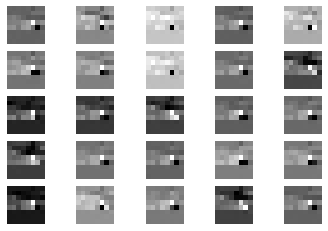

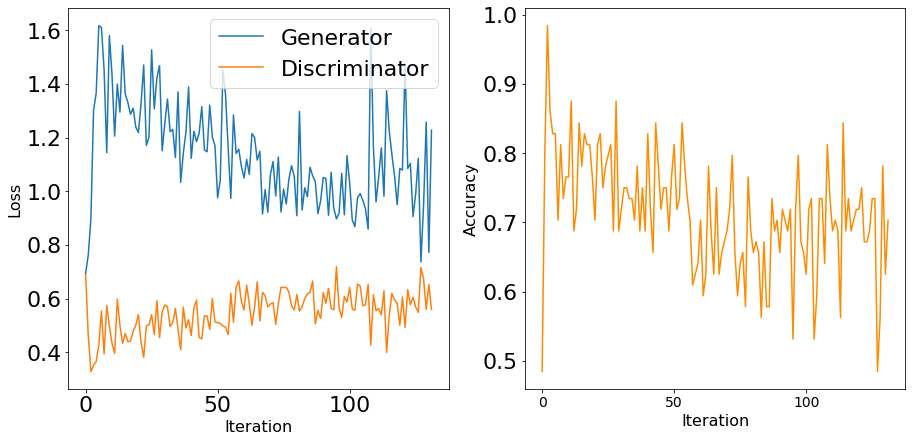

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13101 [D loss: 0.618607, acc.: 65.62%] [G loss: 1.303084]
13102 [D loss: 0.581454, acc.: 71.88%] [G loss: 1.163656]
13103 [D loss: 0.478921, acc.: 79.69%] [G loss: 1.320657]
13104 [D loss: 0.570016, acc.: 68.75%] [G loss: 1.002475]
13105 [D loss: 0.617240, acc.: 62.50%] [G loss: 0.923813]
13106 [D loss: 0.676448, acc.: 64.06%] [G loss: 0.867338]
13107 [D loss: 0.662841, acc.: 64.06%] [G loss: 1.002236]
13108 [D loss: 0.600691, acc.: 64.06%] [G loss: 0.897589]
13109 [D loss: 0.576421, acc.: 68.75%] [G loss: 1.063600]
13110 [D loss: 0.587706, acc.: 75.00%] [G loss: 0.882603]
13111 [D loss: 0.595427, acc.: 68.75%] [G loss: 0.822715]
13112 [D loss: 0.478892, acc.: 78.12%] [G loss: 1.092291]
13113 [D loss: 0.433276, acc.: 82.81%] [G loss: 1.291261]
13114 [D loss: 0.598450, acc.: 65.62%] [G loss: 0.951399]
13115 [D loss: 0.569264, acc.: 68.75%] [G loss: 1.006964]
13116 [D loss: 0.561474, acc.: 75.00%] [G loss: 1.140024]
13117 [D loss: 0.562031, acc.: 71.88%] [G loss: 0.966823]
13118 [D loss:

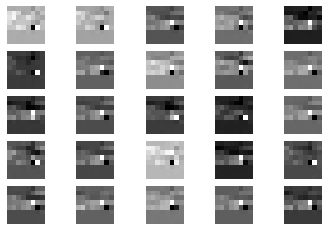

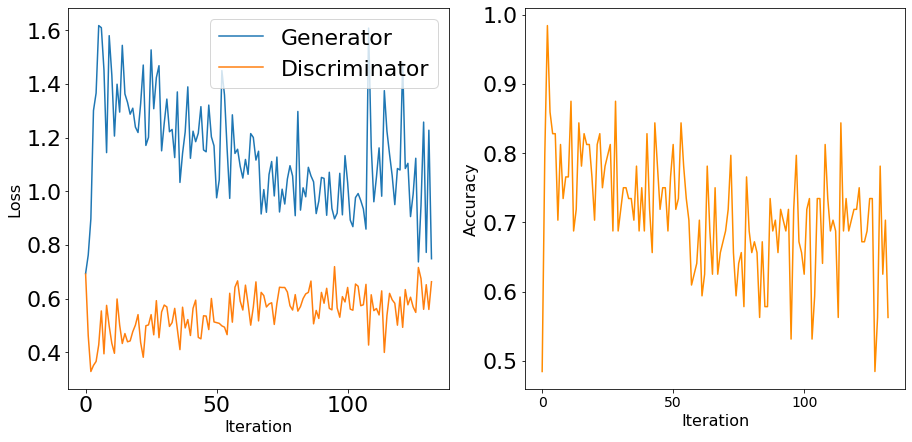

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13201 [D loss: 0.504505, acc.: 82.81%] [G loss: 1.023648]
13202 [D loss: 0.708911, acc.: 54.69%] [G loss: 0.889781]
13203 [D loss: 0.665076, acc.: 60.94%] [G loss: 1.203102]
13204 [D loss: 0.561705, acc.: 70.31%] [G loss: 1.032159]
13205 [D loss: 0.667616, acc.: 68.75%] [G loss: 0.952140]
13206 [D loss: 0.629198, acc.: 64.06%] [G loss: 0.871083]
13207 [D loss: 0.642116, acc.: 65.62%] [G loss: 1.079587]
13208 [D loss: 0.513327, acc.: 75.00%] [G loss: 1.146314]
13209 [D loss: 0.551721, acc.: 70.31%] [G loss: 1.407577]
13210 [D loss: 0.654039, acc.: 56.25%] [G loss: 0.998398]
13211 [D loss: 0.674625, acc.: 54.69%] [G loss: 0.852466]
13212 [D loss: 0.569620, acc.: 73.44%] [G loss: 0.943356]
13213 [D loss: 0.583525, acc.: 70.31%] [G loss: 1.054893]
13214 [D loss: 0.578726, acc.: 65.62%] [G loss: 0.978357]
13215 [D loss: 0.638992, acc.: 57.81%] [G loss: 0.997308]
13216 [D loss: 0.535742, acc.: 71.88%] [G loss: 1.001320]
13217 [D loss: 0.587887, acc.: 71.88%] [G loss: 1.159490]
13218 [D loss:

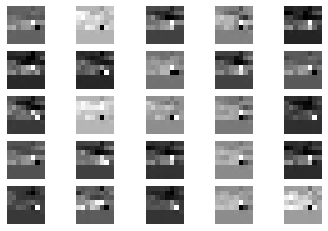

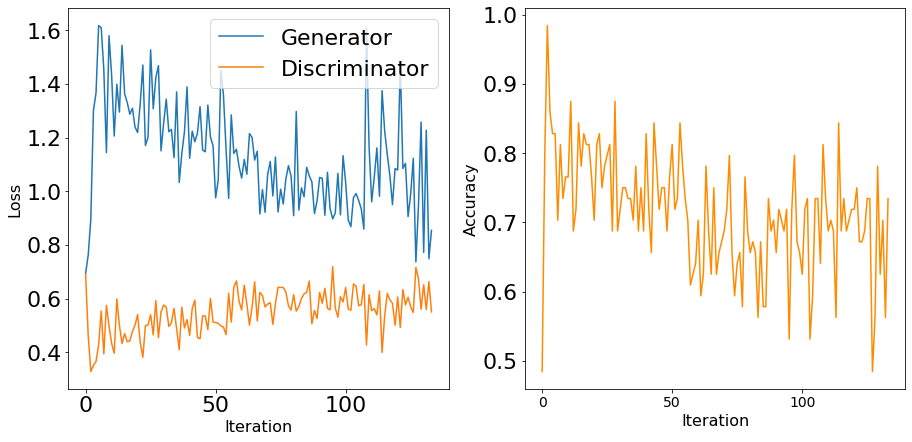

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13301 [D loss: 0.622556, acc.: 62.50%] [G loss: 0.883191]
13302 [D loss: 0.636990, acc.: 60.94%] [G loss: 0.795053]
13303 [D loss: 0.566810, acc.: 68.75%] [G loss: 0.863498]
13304 [D loss: 0.646802, acc.: 62.50%] [G loss: 0.889460]
13305 [D loss: 0.633770, acc.: 64.06%] [G loss: 1.013924]
13306 [D loss: 0.525621, acc.: 75.00%] [G loss: 1.387690]
13307 [D loss: 0.658136, acc.: 73.44%] [G loss: 1.036914]
13308 [D loss: 0.523361, acc.: 75.00%] [G loss: 0.914398]
13309 [D loss: 0.550382, acc.: 68.75%] [G loss: 0.873120]
13310 [D loss: 0.617570, acc.: 62.50%] [G loss: 0.909745]
13311 [D loss: 0.564973, acc.: 68.75%] [G loss: 1.319712]
13312 [D loss: 0.503165, acc.: 75.00%] [G loss: 1.200727]
13313 [D loss: 0.590832, acc.: 60.94%] [G loss: 0.900347]
13314 [D loss: 0.657959, acc.: 62.50%] [G loss: 0.841103]
13315 [D loss: 0.625347, acc.: 65.62%] [G loss: 0.840838]
13316 [D loss: 0.640534, acc.: 70.31%] [G loss: 0.829746]
13317 [D loss: 0.640487, acc.: 62.50%] [G loss: 0.850549]
13318 [D loss:

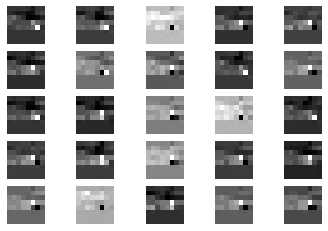

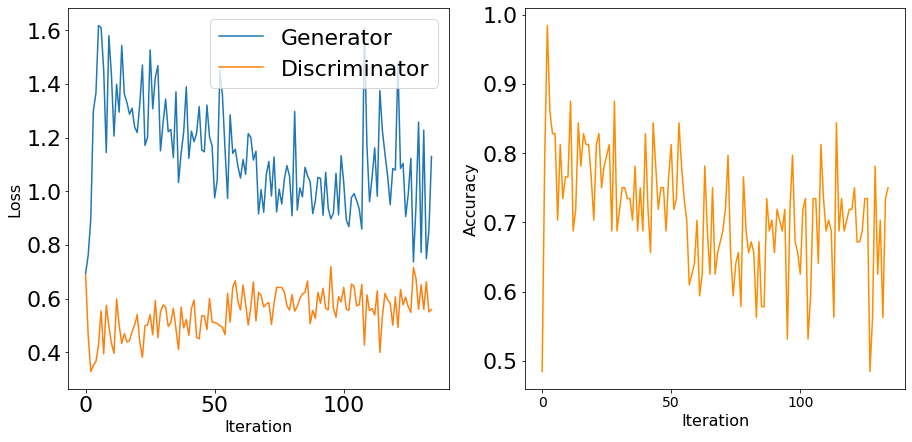

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13401 [D loss: 0.598314, acc.: 68.75%] [G loss: 1.104964]
13402 [D loss: 0.539837, acc.: 60.94%] [G loss: 1.422054]
13403 [D loss: 0.662631, acc.: 60.94%] [G loss: 1.049365]
13404 [D loss: 0.574902, acc.: 68.75%] [G loss: 1.267340]
13405 [D loss: 0.597961, acc.: 65.62%] [G loss: 1.182406]
13406 [D loss: 0.666531, acc.: 59.38%] [G loss: 1.093499]
13407 [D loss: 0.611449, acc.: 67.19%] [G loss: 0.917267]
13408 [D loss: 0.674749, acc.: 64.06%] [G loss: 1.114027]
13409 [D loss: 0.651482, acc.: 54.69%] [G loss: 0.854066]
13410 [D loss: 0.597847, acc.: 62.50%] [G loss: 0.888955]
13411 [D loss: 0.578864, acc.: 64.06%] [G loss: 1.203735]
13412 [D loss: 0.592505, acc.: 64.06%] [G loss: 0.956054]
13413 [D loss: 0.581444, acc.: 64.06%] [G loss: 1.015914]
13414 [D loss: 0.505342, acc.: 73.44%] [G loss: 1.211992]
13415 [D loss: 0.617056, acc.: 70.31%] [G loss: 1.006884]
13416 [D loss: 0.678930, acc.: 56.25%] [G loss: 0.832824]
13417 [D loss: 0.574514, acc.: 75.00%] [G loss: 0.878120]
13418 [D loss:

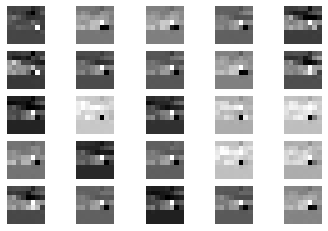

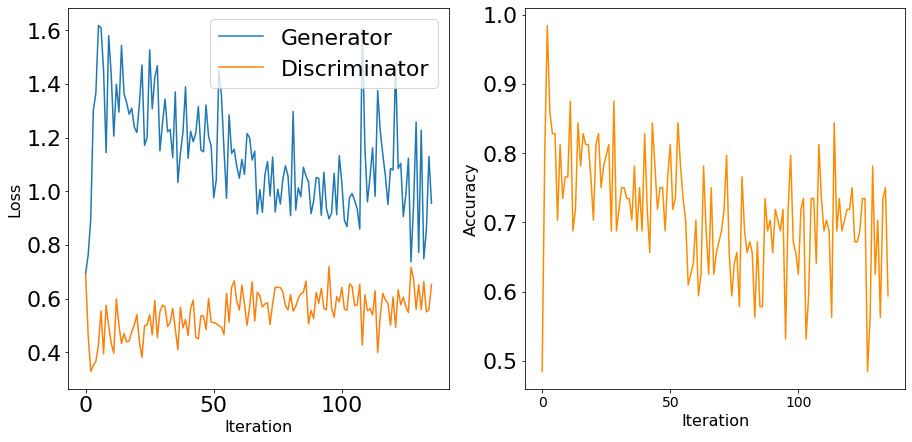

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13501 [D loss: 0.538791, acc.: 70.31%] [G loss: 1.028868]
13502 [D loss: 0.621551, acc.: 67.19%] [G loss: 1.222923]
13503 [D loss: 0.608940, acc.: 60.94%] [G loss: 1.205368]
13504 [D loss: 0.577537, acc.: 67.19%] [G loss: 1.001359]
13505 [D loss: 0.550604, acc.: 73.44%] [G loss: 1.103273]
13506 [D loss: 0.595813, acc.: 68.75%] [G loss: 0.883067]
13507 [D loss: 0.571728, acc.: 68.75%] [G loss: 1.105415]
13508 [D loss: 0.462493, acc.: 76.56%] [G loss: 1.351744]
13509 [D loss: 0.639695, acc.: 60.94%] [G loss: 1.017039]
13510 [D loss: 0.613916, acc.: 59.38%] [G loss: 1.120427]
13511 [D loss: 0.643484, acc.: 67.19%] [G loss: 1.239672]
13512 [D loss: 0.567277, acc.: 75.00%] [G loss: 1.232367]
13513 [D loss: 0.543388, acc.: 75.00%] [G loss: 1.240642]
13514 [D loss: 0.515367, acc.: 70.31%] [G loss: 0.841993]
13515 [D loss: 0.681400, acc.: 54.69%] [G loss: 0.964121]
13516 [D loss: 0.592395, acc.: 73.44%] [G loss: 0.934740]
13517 [D loss: 0.541934, acc.: 76.56%] [G loss: 1.163178]
13518 [D loss:

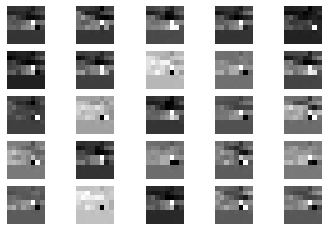

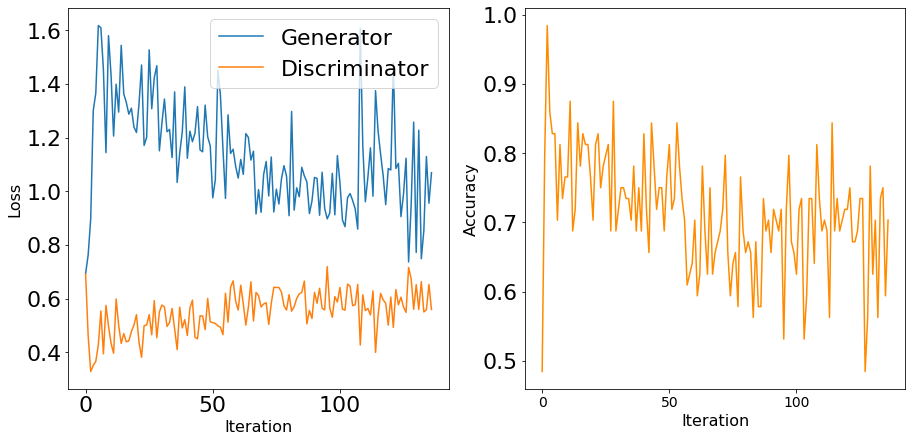

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13601 [D loss: 0.571352, acc.: 76.56%] [G loss: 1.235165]
13602 [D loss: 0.605797, acc.: 67.19%] [G loss: 0.952523]
13603 [D loss: 0.532298, acc.: 76.56%] [G loss: 0.958791]
13604 [D loss: 0.682974, acc.: 56.25%] [G loss: 0.875551]
13605 [D loss: 0.638035, acc.: 62.50%] [G loss: 1.096210]
13606 [D loss: 0.684035, acc.: 56.25%] [G loss: 0.856309]
13607 [D loss: 0.509759, acc.: 76.56%] [G loss: 0.981307]
13608 [D loss: 0.610268, acc.: 68.75%] [G loss: 1.070571]
13609 [D loss: 0.482507, acc.: 81.25%] [G loss: 1.487082]
13610 [D loss: 0.591843, acc.: 70.31%] [G loss: 1.160618]
13611 [D loss: 0.660650, acc.: 62.50%] [G loss: 0.755405]
13612 [D loss: 0.560738, acc.: 62.50%] [G loss: 1.088063]
13613 [D loss: 0.545975, acc.: 75.00%] [G loss: 1.110249]
13614 [D loss: 0.509326, acc.: 79.69%] [G loss: 1.185556]
13615 [D loss: 0.706680, acc.: 56.25%] [G loss: 0.934331]
13616 [D loss: 0.489723, acc.: 73.44%] [G loss: 1.234715]
13617 [D loss: 0.629238, acc.: 62.50%] [G loss: 0.832684]
13618 [D loss:

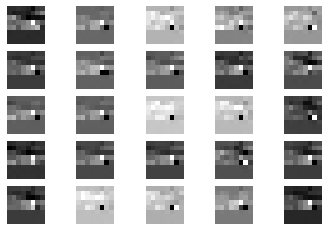

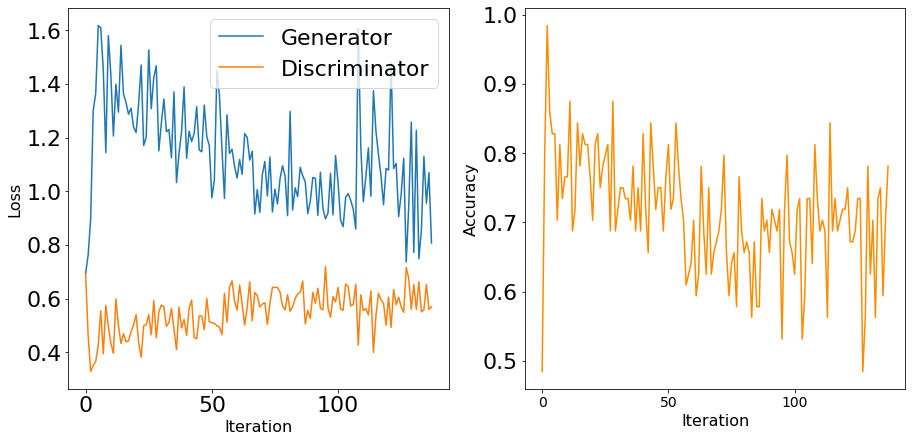

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13701 [D loss: 0.570569, acc.: 59.38%] [G loss: 0.814250]
13702 [D loss: 0.615767, acc.: 65.62%] [G loss: 0.809744]
13703 [D loss: 0.654955, acc.: 60.94%] [G loss: 0.886574]
13704 [D loss: 0.666339, acc.: 65.62%] [G loss: 0.925881]
13705 [D loss: 0.654281, acc.: 60.94%] [G loss: 0.911474]
13706 [D loss: 0.730430, acc.: 45.31%] [G loss: 0.922043]
13707 [D loss: 0.624538, acc.: 62.50%] [G loss: 0.939271]
13708 [D loss: 0.689543, acc.: 54.69%] [G loss: 0.903744]
13709 [D loss: 0.546719, acc.: 73.44%] [G loss: 0.852692]
13710 [D loss: 0.669657, acc.: 64.06%] [G loss: 1.040528]
13711 [D loss: 0.571221, acc.: 68.75%] [G loss: 1.101852]
13712 [D loss: 0.499555, acc.: 75.00%] [G loss: 1.496261]
13713 [D loss: 0.567332, acc.: 64.06%] [G loss: 1.237339]
13714 [D loss: 0.609718, acc.: 62.50%] [G loss: 0.968891]
13715 [D loss: 0.576382, acc.: 73.44%] [G loss: 1.004086]
13716 [D loss: 0.548865, acc.: 73.44%] [G loss: 1.218651]
13717 [D loss: 0.651193, acc.: 62.50%] [G loss: 1.086970]
13718 [D loss:

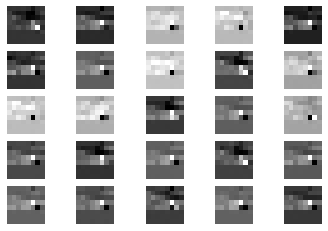

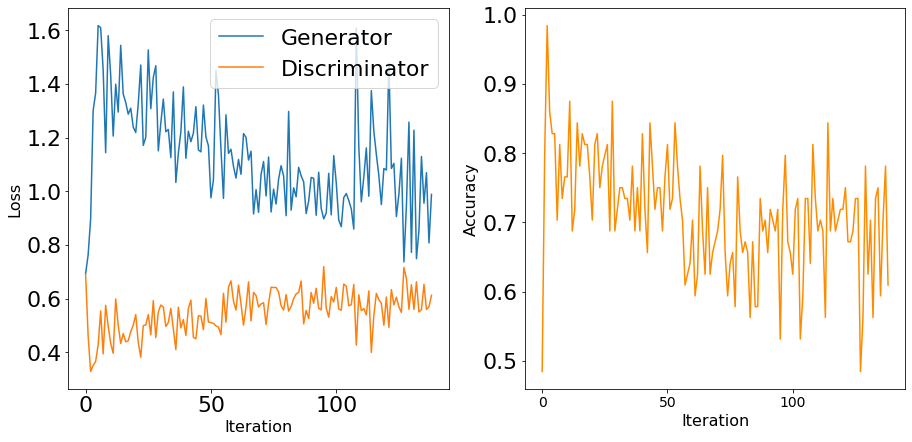

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13801 [D loss: 0.534723, acc.: 70.31%] [G loss: 0.933106]
13802 [D loss: 0.608946, acc.: 64.06%] [G loss: 0.985343]
13803 [D loss: 0.599406, acc.: 64.06%] [G loss: 0.927818]
13804 [D loss: 0.599330, acc.: 75.00%] [G loss: 0.924690]
13805 [D loss: 0.643623, acc.: 60.94%] [G loss: 0.953338]
13806 [D loss: 0.565740, acc.: 78.12%] [G loss: 1.195881]
13807 [D loss: 0.544830, acc.: 68.75%] [G loss: 1.326804]
13808 [D loss: 0.566740, acc.: 71.88%] [G loss: 1.322233]
13809 [D loss: 0.592518, acc.: 68.75%] [G loss: 0.975355]
13810 [D loss: 0.623884, acc.: 73.44%] [G loss: 0.839360]
13811 [D loss: 0.626717, acc.: 59.38%] [G loss: 0.861035]
13812 [D loss: 0.646759, acc.: 67.19%] [G loss: 1.091114]
13813 [D loss: 0.531502, acc.: 71.88%] [G loss: 1.430258]
13814 [D loss: 0.669397, acc.: 62.50%] [G loss: 1.014035]
13815 [D loss: 0.635934, acc.: 56.25%] [G loss: 0.692205]
13816 [D loss: 0.706206, acc.: 57.81%] [G loss: 0.844916]
13817 [D loss: 0.652407, acc.: 65.62%] [G loss: 1.177186]
13818 [D loss:

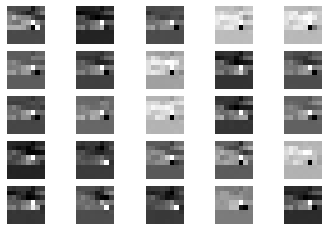

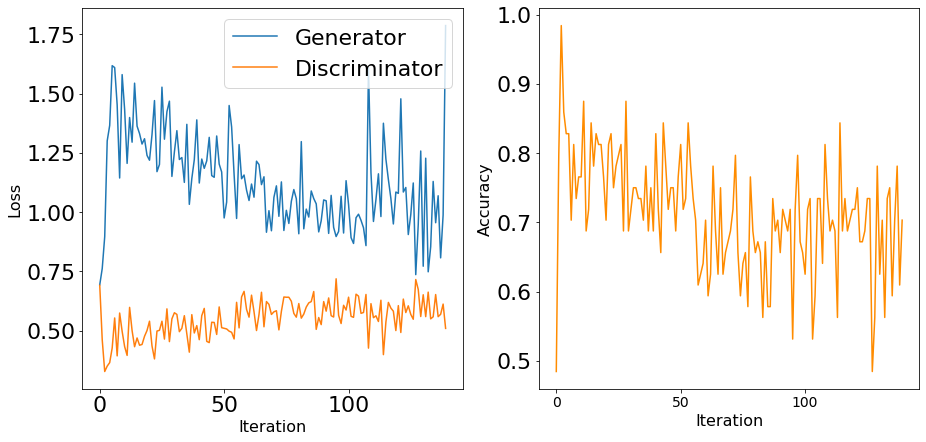

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


13901 [D loss: 0.530945, acc.: 71.88%] [G loss: 1.207155]
13902 [D loss: 0.578693, acc.: 65.62%] [G loss: 1.005721]
13903 [D loss: 0.495072, acc.: 73.44%] [G loss: 1.669971]
13904 [D loss: 0.550325, acc.: 67.19%] [G loss: 0.983201]
13905 [D loss: 0.502206, acc.: 76.56%] [G loss: 1.701809]
13906 [D loss: 0.661970, acc.: 57.81%] [G loss: 0.739096]
13907 [D loss: 0.537436, acc.: 73.44%] [G loss: 1.350022]
13908 [D loss: 0.556422, acc.: 68.75%] [G loss: 0.855101]
13909 [D loss: 0.536745, acc.: 71.88%] [G loss: 1.000564]
13910 [D loss: 0.535263, acc.: 75.00%] [G loss: 0.932521]
13911 [D loss: 0.558543, acc.: 73.44%] [G loss: 0.968013]
13912 [D loss: 0.550825, acc.: 70.31%] [G loss: 0.927617]
13913 [D loss: 0.650633, acc.: 65.62%] [G loss: 0.856341]
13914 [D loss: 0.648520, acc.: 67.19%] [G loss: 0.897991]
13915 [D loss: 0.642199, acc.: 60.94%] [G loss: 0.919151]
13916 [D loss: 0.647353, acc.: 62.50%] [G loss: 0.961721]
13917 [D loss: 0.644769, acc.: 65.62%] [G loss: 0.941829]
13918 [D loss:

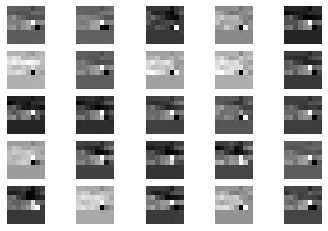

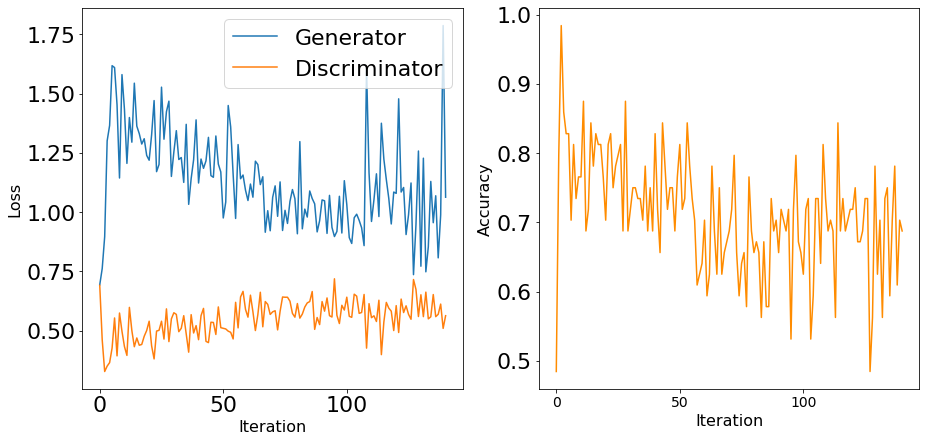

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14001 [D loss: 0.574332, acc.: 65.62%] [G loss: 0.935855]
14002 [D loss: 0.485775, acc.: 76.56%] [G loss: 1.138047]
14003 [D loss: 0.633780, acc.: 65.62%] [G loss: 0.821097]
14004 [D loss: 0.498429, acc.: 73.44%] [G loss: 1.235866]
14005 [D loss: 0.577442, acc.: 70.31%] [G loss: 0.978367]
14006 [D loss: 0.629842, acc.: 70.31%] [G loss: 0.949362]
14007 [D loss: 0.575465, acc.: 65.62%] [G loss: 1.089953]
14008 [D loss: 0.619232, acc.: 64.06%] [G loss: 1.299296]
14009 [D loss: 0.544893, acc.: 62.50%] [G loss: 1.006484]
14010 [D loss: 0.530020, acc.: 73.44%] [G loss: 1.272235]
14011 [D loss: 0.526082, acc.: 68.75%] [G loss: 1.956586]
14012 [D loss: 0.595812, acc.: 59.38%] [G loss: 0.971468]
14013 [D loss: 0.414106, acc.: 84.38%] [G loss: 1.282554]
14014 [D loss: 0.567474, acc.: 75.00%] [G loss: 1.062754]
14015 [D loss: 0.600050, acc.: 59.38%] [G loss: 0.984392]
14016 [D loss: 0.563554, acc.: 73.44%] [G loss: 0.885586]
14017 [D loss: 0.621216, acc.: 67.19%] [G loss: 0.703799]
14018 [D loss:

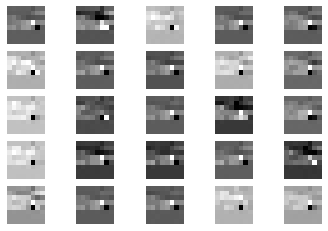

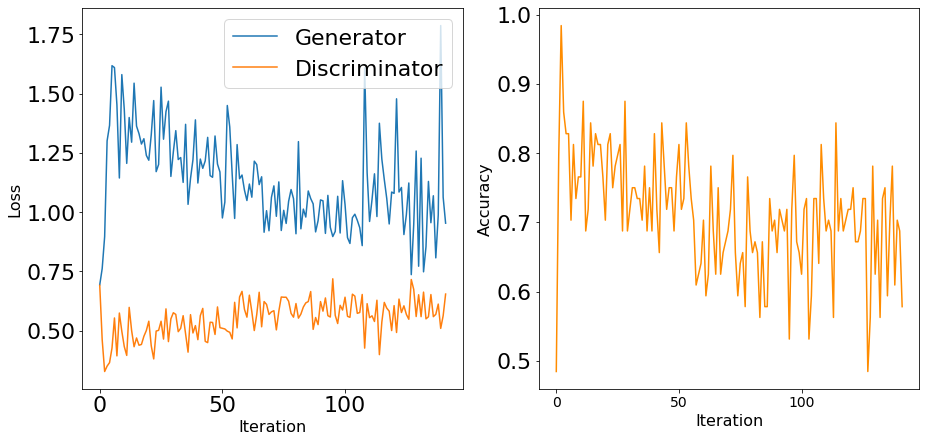

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14101 [D loss: 0.618706, acc.: 73.44%] [G loss: 0.935271]
14102 [D loss: 0.622078, acc.: 64.06%] [G loss: 1.054969]
14103 [D loss: 0.624910, acc.: 73.44%] [G loss: 0.935819]
14104 [D loss: 0.662378, acc.: 56.25%] [G loss: 0.899861]
14105 [D loss: 0.651239, acc.: 57.81%] [G loss: 0.816706]
14106 [D loss: 0.619715, acc.: 64.06%] [G loss: 0.977280]
14107 [D loss: 0.616457, acc.: 73.44%] [G loss: 0.870898]
14108 [D loss: 0.569444, acc.: 65.62%] [G loss: 1.029211]
14109 [D loss: 0.518656, acc.: 79.69%] [G loss: 1.017469]
14110 [D loss: 0.572441, acc.: 71.88%] [G loss: 0.999529]
14111 [D loss: 0.629238, acc.: 60.94%] [G loss: 0.932287]
14112 [D loss: 0.590533, acc.: 62.50%] [G loss: 1.186989]
14113 [D loss: 0.632001, acc.: 65.62%] [G loss: 0.957170]
14114 [D loss: 0.590750, acc.: 68.75%] [G loss: 1.075772]
14115 [D loss: 0.661966, acc.: 59.38%] [G loss: 0.825981]
14116 [D loss: 0.687348, acc.: 56.25%] [G loss: 0.868083]
14117 [D loss: 0.653470, acc.: 57.81%] [G loss: 1.014023]
14118 [D loss:

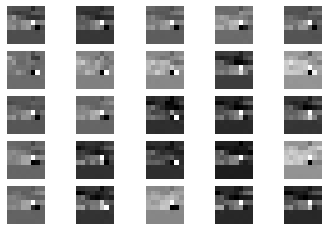

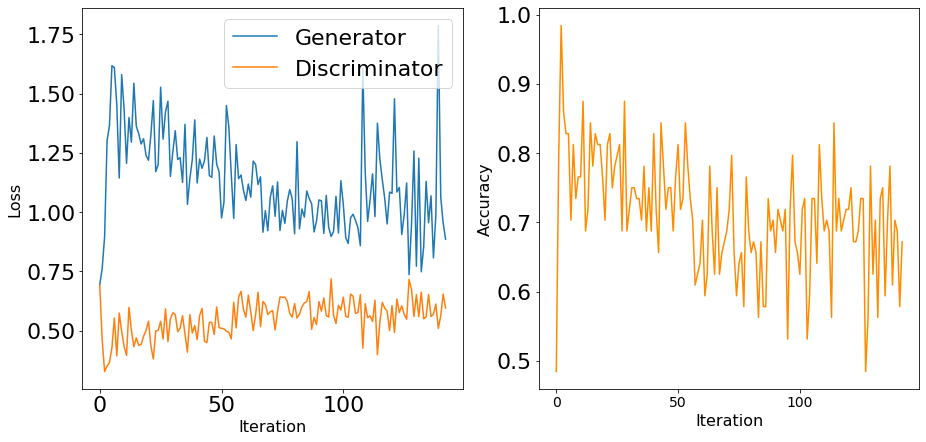

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14201 [D loss: 0.554858, acc.: 68.75%] [G loss: 0.947277]
14202 [D loss: 0.657047, acc.: 60.94%] [G loss: 0.867108]
14203 [D loss: 0.683721, acc.: 57.81%] [G loss: 0.846523]
14204 [D loss: 0.622391, acc.: 67.19%] [G loss: 0.960201]
14205 [D loss: 0.655004, acc.: 60.94%] [G loss: 1.007841]
14206 [D loss: 0.559097, acc.: 65.62%] [G loss: 1.133996]
14207 [D loss: 0.543181, acc.: 76.56%] [G loss: 0.981503]
14208 [D loss: 0.639622, acc.: 57.81%] [G loss: 0.805774]
14209 [D loss: 0.627163, acc.: 57.81%] [G loss: 1.026447]
14210 [D loss: 0.653358, acc.: 64.06%] [G loss: 0.910041]
14211 [D loss: 0.685374, acc.: 53.12%] [G loss: 0.898446]
14212 [D loss: 0.608841, acc.: 67.19%] [G loss: 0.871114]
14213 [D loss: 0.534163, acc.: 76.56%] [G loss: 1.010518]
14214 [D loss: 0.755413, acc.: 48.44%] [G loss: 0.809607]
14215 [D loss: 0.619095, acc.: 60.94%] [G loss: 0.808391]
14216 [D loss: 0.649103, acc.: 62.50%] [G loss: 0.783722]
14217 [D loss: 0.573277, acc.: 75.00%] [G loss: 0.980937]
14218 [D loss:

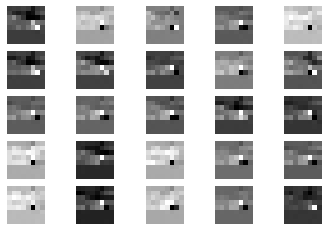

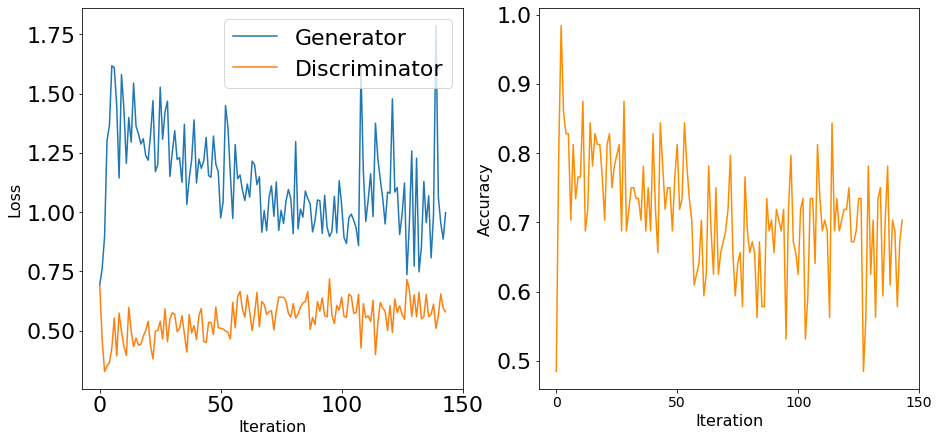

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14301 [D loss: 0.650471, acc.: 59.38%] [G loss: 0.836380]
14302 [D loss: 0.596810, acc.: 62.50%] [G loss: 1.099330]
14303 [D loss: 0.588001, acc.: 67.19%] [G loss: 1.325000]
14304 [D loss: 0.583019, acc.: 65.62%] [G loss: 1.066720]
14305 [D loss: 0.608849, acc.: 65.62%] [G loss: 1.015648]
14306 [D loss: 0.525157, acc.: 71.88%] [G loss: 1.160543]
14307 [D loss: 0.625551, acc.: 59.38%] [G loss: 0.816161]
14308 [D loss: 0.668156, acc.: 60.94%] [G loss: 0.904799]
14309 [D loss: 0.677710, acc.: 56.25%] [G loss: 0.908385]
14310 [D loss: 0.656960, acc.: 54.69%] [G loss: 0.879262]
14311 [D loss: 0.672527, acc.: 64.06%] [G loss: 0.898435]
14312 [D loss: 0.574809, acc.: 64.06%] [G loss: 0.914974]
14313 [D loss: 0.568097, acc.: 62.50%] [G loss: 1.106068]
14314 [D loss: 0.550539, acc.: 71.88%] [G loss: 1.398942]
14315 [D loss: 0.529499, acc.: 73.44%] [G loss: 1.447023]
14316 [D loss: 0.531585, acc.: 68.75%] [G loss: 1.221056]
14317 [D loss: 0.573370, acc.: 64.06%] [G loss: 0.897916]
14318 [D loss:

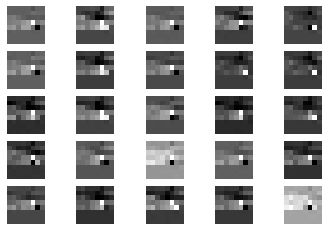

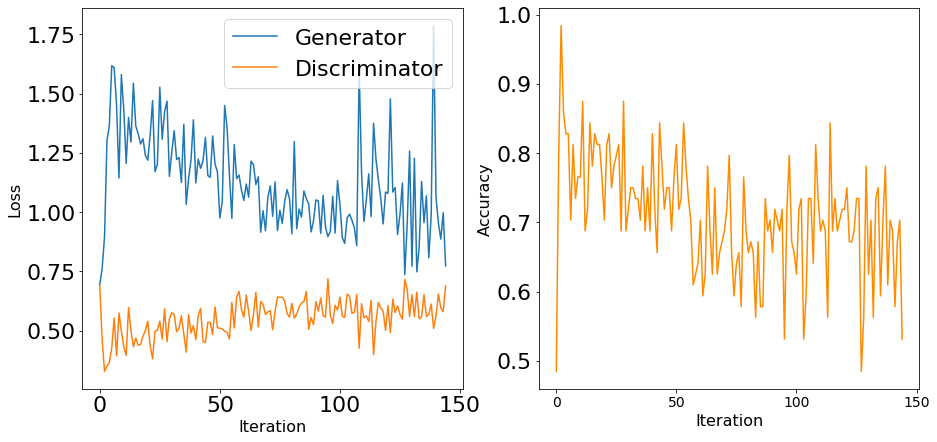

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14401 [D loss: 0.643746, acc.: 59.38%] [G loss: 1.063946]
14402 [D loss: 0.484668, acc.: 79.69%] [G loss: 1.327409]
14403 [D loss: 0.652640, acc.: 62.50%] [G loss: 0.916923]
14404 [D loss: 0.551563, acc.: 68.75%] [G loss: 1.110416]
14405 [D loss: 0.580427, acc.: 67.19%] [G loss: 0.887771]
14406 [D loss: 0.653950, acc.: 53.12%] [G loss: 0.948474]
14407 [D loss: 0.485153, acc.: 78.12%] [G loss: 1.307497]
14408 [D loss: 0.664915, acc.: 68.75%] [G loss: 0.808261]
14409 [D loss: 0.546375, acc.: 75.00%] [G loss: 1.000610]
14410 [D loss: 0.554772, acc.: 67.19%] [G loss: 0.955746]
14411 [D loss: 0.559442, acc.: 68.75%] [G loss: 0.935371]
14412 [D loss: 0.580842, acc.: 68.75%] [G loss: 0.750025]
14413 [D loss: 0.642351, acc.: 59.38%] [G loss: 1.015441]
14414 [D loss: 0.529830, acc.: 73.44%] [G loss: 1.496464]
14415 [D loss: 0.555241, acc.: 65.62%] [G loss: 0.988958]
14416 [D loss: 0.584296, acc.: 67.19%] [G loss: 0.829494]
14417 [D loss: 0.592215, acc.: 68.75%] [G loss: 0.765824]
14418 [D loss:

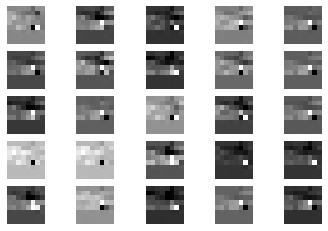

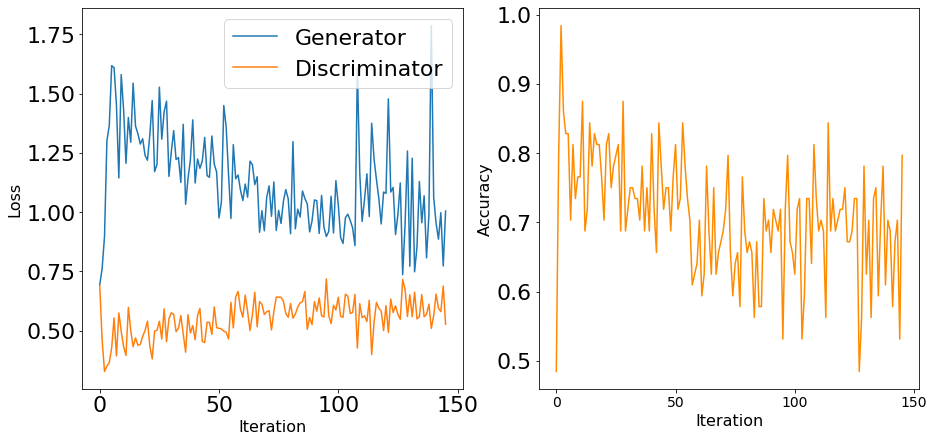

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14501 [D loss: 0.641364, acc.: 64.06%] [G loss: 0.785744]
14502 [D loss: 0.576241, acc.: 67.19%] [G loss: 0.863773]
14503 [D loss: 0.602716, acc.: 67.19%] [G loss: 0.811432]
14504 [D loss: 0.705772, acc.: 53.12%] [G loss: 0.929068]
14505 [D loss: 0.698708, acc.: 56.25%] [G loss: 0.756683]
14506 [D loss: 0.639832, acc.: 64.06%] [G loss: 1.076539]
14507 [D loss: 0.553006, acc.: 68.75%] [G loss: 1.006942]
14508 [D loss: 0.511291, acc.: 82.81%] [G loss: 1.161237]
14509 [D loss: 0.620871, acc.: 62.50%] [G loss: 0.957104]
14510 [D loss: 0.542228, acc.: 71.88%] [G loss: 0.980716]
14511 [D loss: 0.546519, acc.: 71.88%] [G loss: 1.196054]
14512 [D loss: 0.533940, acc.: 75.00%] [G loss: 1.072887]
14513 [D loss: 0.560958, acc.: 68.75%] [G loss: 0.990054]
14514 [D loss: 0.595233, acc.: 60.94%] [G loss: 0.911390]
14515 [D loss: 0.631034, acc.: 65.62%] [G loss: 0.872471]
14516 [D loss: 0.599357, acc.: 65.62%] [G loss: 0.929832]
14517 [D loss: 0.582080, acc.: 65.62%] [G loss: 1.184157]
14518 [D loss:

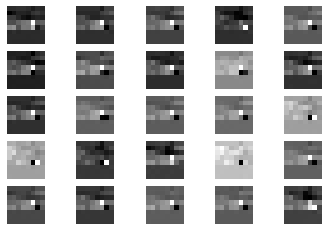

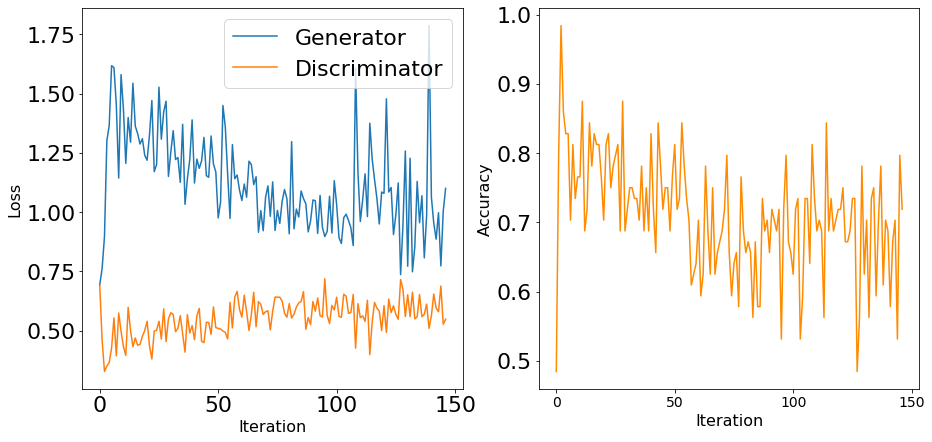

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14601 [D loss: 0.643660, acc.: 60.94%] [G loss: 0.813115]
14602 [D loss: 0.647039, acc.: 60.94%] [G loss: 0.781180]
14603 [D loss: 0.606676, acc.: 71.88%] [G loss: 0.845249]
14604 [D loss: 0.626702, acc.: 56.25%] [G loss: 0.852955]
14605 [D loss: 0.571463, acc.: 70.31%] [G loss: 0.837188]
14606 [D loss: 0.630749, acc.: 64.06%] [G loss: 0.991946]
14607 [D loss: 0.520816, acc.: 73.44%] [G loss: 1.147786]
14608 [D loss: 0.554432, acc.: 73.44%] [G loss: 1.305399]
14609 [D loss: 0.588069, acc.: 73.44%] [G loss: 0.906068]
14610 [D loss: 0.598442, acc.: 64.06%] [G loss: 0.940558]
14611 [D loss: 0.653863, acc.: 57.81%] [G loss: 0.798062]
14612 [D loss: 0.631971, acc.: 65.62%] [G loss: 0.997291]
14613 [D loss: 0.671964, acc.: 56.25%] [G loss: 0.960006]
14614 [D loss: 0.653478, acc.: 64.06%] [G loss: 1.249091]
14615 [D loss: 0.567154, acc.: 64.06%] [G loss: 1.440850]
14616 [D loss: 0.610839, acc.: 67.19%] [G loss: 0.970730]
14617 [D loss: 0.591369, acc.: 75.00%] [G loss: 0.840263]
14618 [D loss:

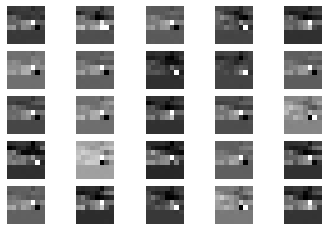

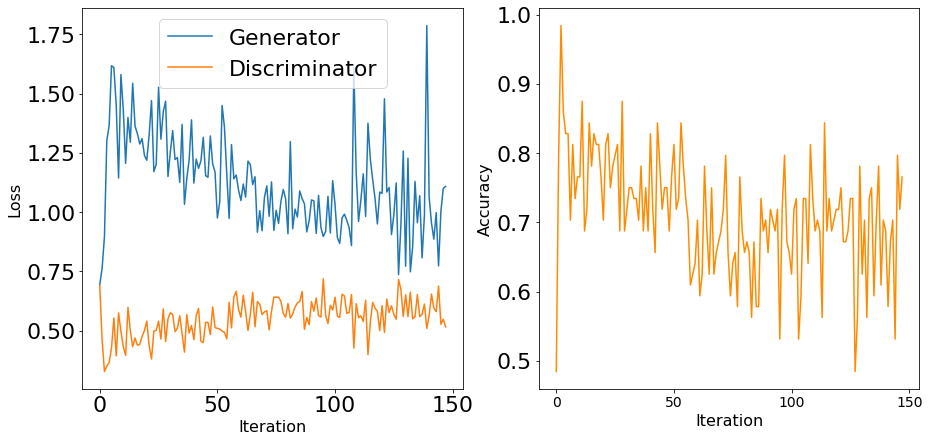

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14701 [D loss: 0.529856, acc.: 71.88%] [G loss: 1.193452]
14702 [D loss: 0.610435, acc.: 64.06%] [G loss: 0.969235]
14703 [D loss: 0.623881, acc.: 71.88%] [G loss: 0.841329]
14704 [D loss: 0.625667, acc.: 67.19%] [G loss: 0.800320]
14705 [D loss: 0.650787, acc.: 57.81%] [G loss: 1.202999]
14706 [D loss: 0.509610, acc.: 75.00%] [G loss: 1.546746]
14707 [D loss: 0.612985, acc.: 64.06%] [G loss: 1.225537]
14708 [D loss: 0.590017, acc.: 65.62%] [G loss: 0.772409]
14709 [D loss: 0.651878, acc.: 60.94%] [G loss: 0.981686]
14710 [D loss: 0.512154, acc.: 75.00%] [G loss: 1.317818]
14711 [D loss: 0.553812, acc.: 76.56%] [G loss: 1.262321]
14712 [D loss: 0.581683, acc.: 67.19%] [G loss: 0.864926]
14713 [D loss: 0.553150, acc.: 73.44%] [G loss: 0.916399]
14714 [D loss: 0.665272, acc.: 57.81%] [G loss: 0.918903]
14715 [D loss: 0.574394, acc.: 68.75%] [G loss: 0.939550]
14716 [D loss: 0.545554, acc.: 70.31%] [G loss: 1.439953]
14717 [D loss: 0.517842, acc.: 76.56%] [G loss: 1.194601]
14718 [D loss:

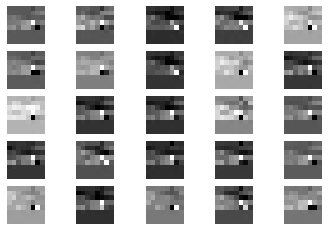

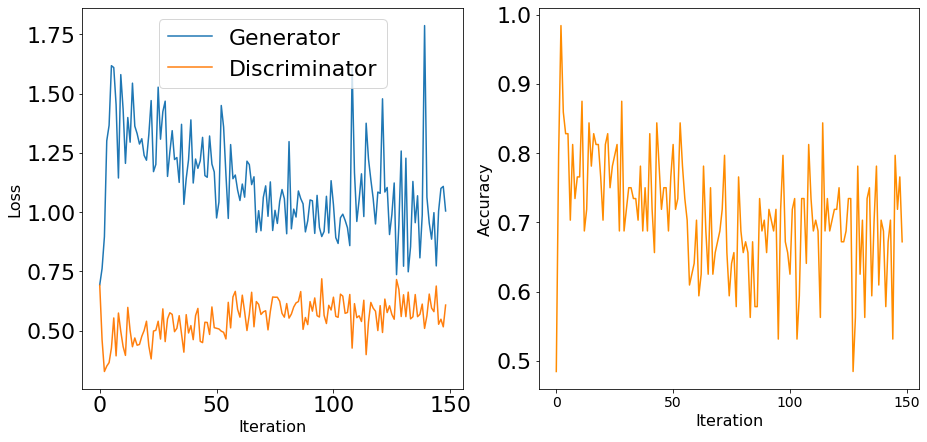

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14801 [D loss: 0.620617, acc.: 67.19%] [G loss: 0.900313]
14802 [D loss: 0.629151, acc.: 65.62%] [G loss: 1.021009]
14803 [D loss: 0.646270, acc.: 56.25%] [G loss: 1.021365]
14804 [D loss: 0.537187, acc.: 71.88%] [G loss: 1.093101]
14805 [D loss: 0.482276, acc.: 79.69%] [G loss: 1.120897]
14806 [D loss: 0.572731, acc.: 67.19%] [G loss: 0.922302]
14807 [D loss: 0.576033, acc.: 70.31%] [G loss: 1.201150]
14808 [D loss: 0.600369, acc.: 65.62%] [G loss: 1.106310]
14809 [D loss: 0.642558, acc.: 59.38%] [G loss: 1.012538]
14810 [D loss: 0.628540, acc.: 62.50%] [G loss: 0.956081]
14811 [D loss: 0.585368, acc.: 65.62%] [G loss: 0.938625]
14812 [D loss: 0.603437, acc.: 65.62%] [G loss: 1.110149]
14813 [D loss: 0.664132, acc.: 62.50%] [G loss: 1.017551]
14814 [D loss: 0.616751, acc.: 71.88%] [G loss: 0.912422]
14815 [D loss: 0.559652, acc.: 71.88%] [G loss: 1.030027]
14816 [D loss: 0.615531, acc.: 68.75%] [G loss: 1.049427]
14817 [D loss: 0.585101, acc.: 73.44%] [G loss: 0.979051]
14818 [D loss:

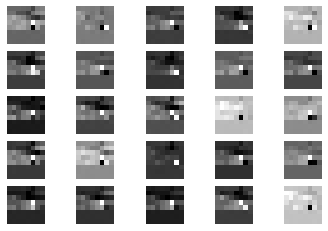

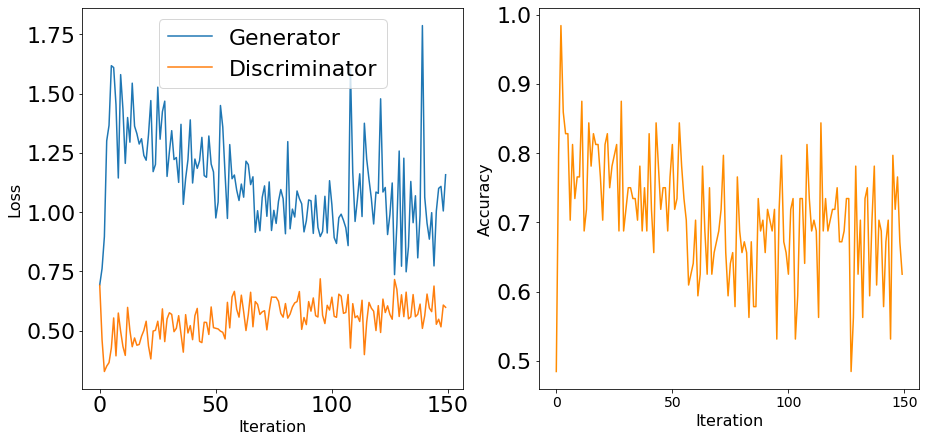

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


14901 [D loss: 0.612492, acc.: 65.62%] [G loss: 0.776566]
14902 [D loss: 0.581915, acc.: 68.75%] [G loss: 0.910365]
14903 [D loss: 0.593362, acc.: 71.88%] [G loss: 1.254770]
14904 [D loss: 0.500775, acc.: 75.00%] [G loss: 1.609437]
14905 [D loss: 0.621138, acc.: 54.69%] [G loss: 0.948316]
14906 [D loss: 0.534893, acc.: 73.44%] [G loss: 1.399330]
14907 [D loss: 0.617862, acc.: 60.94%] [G loss: 0.922318]
14908 [D loss: 0.582902, acc.: 70.31%] [G loss: 0.955555]
14909 [D loss: 0.522066, acc.: 81.25%] [G loss: 1.110825]
14910 [D loss: 0.592211, acc.: 68.75%] [G loss: 0.943873]
14911 [D loss: 0.685142, acc.: 59.38%] [G loss: 0.918567]
14912 [D loss: 0.573997, acc.: 64.06%] [G loss: 1.039653]
14913 [D loss: 0.539662, acc.: 73.44%] [G loss: 1.169018]
14914 [D loss: 0.559085, acc.: 71.88%] [G loss: 1.201568]
14915 [D loss: 0.583692, acc.: 65.62%] [G loss: 0.929464]
14916 [D loss: 0.618654, acc.: 65.62%] [G loss: 1.180639]
14917 [D loss: 0.606209, acc.: 64.06%] [G loss: 1.218274]
14918 [D loss:

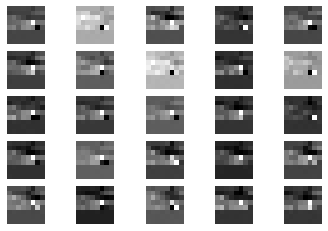

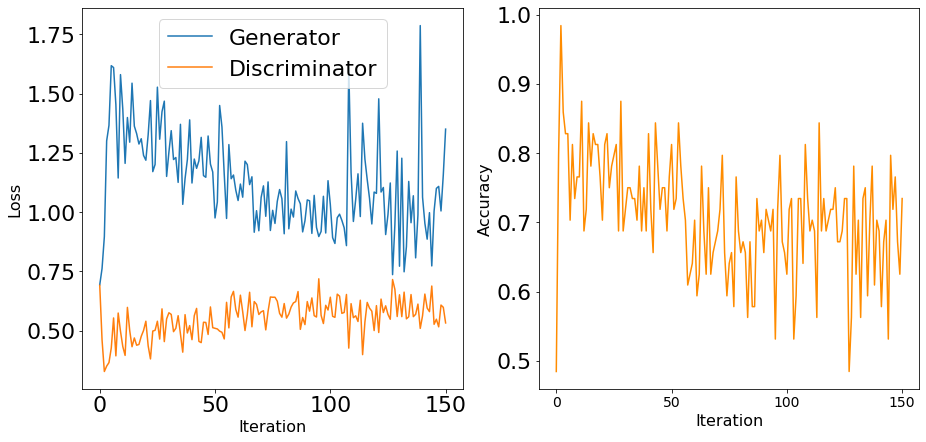

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15001 [D loss: 0.567900, acc.: 65.62%] [G loss: 1.140016]
15002 [D loss: 0.650759, acc.: 67.19%] [G loss: 0.799527]
15003 [D loss: 0.693812, acc.: 46.88%] [G loss: 0.997761]
15004 [D loss: 0.631298, acc.: 60.94%] [G loss: 0.870402]
15005 [D loss: 0.525164, acc.: 70.31%] [G loss: 1.069929]
15006 [D loss: 0.493196, acc.: 67.19%] [G loss: 1.667044]
15007 [D loss: 0.584024, acc.: 68.75%] [G loss: 1.215603]
15008 [D loss: 0.631247, acc.: 65.62%] [G loss: 0.923165]
15009 [D loss: 0.594207, acc.: 73.44%] [G loss: 0.963211]
15010 [D loss: 0.666055, acc.: 59.38%] [G loss: 1.113928]
15011 [D loss: 0.544494, acc.: 76.56%] [G loss: 1.164624]
15012 [D loss: 0.511219, acc.: 73.44%] [G loss: 1.711564]
15013 [D loss: 0.569481, acc.: 71.88%] [G loss: 0.931476]
15014 [D loss: 0.600105, acc.: 71.88%] [G loss: 0.999772]
15015 [D loss: 0.586169, acc.: 73.44%] [G loss: 1.422627]
15016 [D loss: 0.473820, acc.: 79.69%] [G loss: 1.455880]
15017 [D loss: 0.594069, acc.: 65.62%] [G loss: 0.897046]
15018 [D loss:

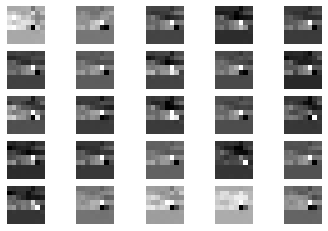

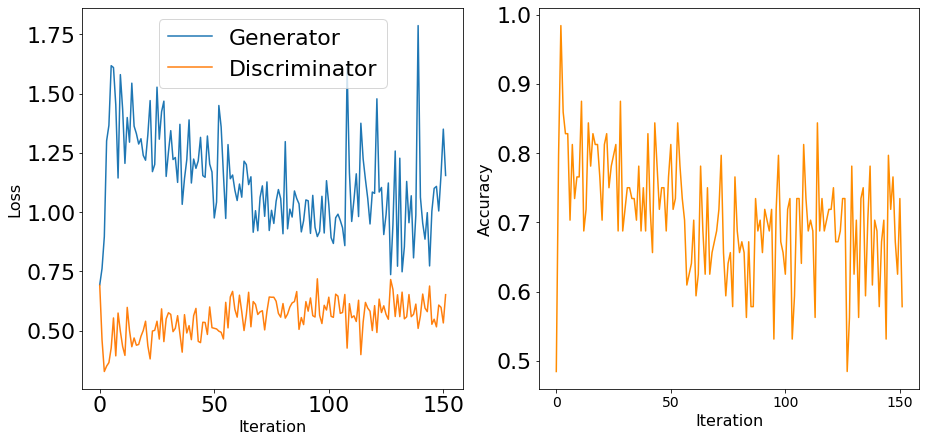

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15101 [D loss: 0.548871, acc.: 68.75%] [G loss: 1.166317]
15102 [D loss: 0.579834, acc.: 64.06%] [G loss: 0.932160]
15103 [D loss: 0.652193, acc.: 60.94%] [G loss: 0.927539]
15104 [D loss: 0.560040, acc.: 71.88%] [G loss: 1.490916]
15105 [D loss: 0.545930, acc.: 71.88%] [G loss: 1.470751]
15106 [D loss: 0.579550, acc.: 71.88%] [G loss: 1.014733]
15107 [D loss: 0.528147, acc.: 79.69%] [G loss: 1.319546]
15108 [D loss: 0.630436, acc.: 65.62%] [G loss: 0.850458]
15109 [D loss: 0.553012, acc.: 73.44%] [G loss: 1.064804]
15110 [D loss: 0.623630, acc.: 68.75%] [G loss: 0.962277]
15111 [D loss: 0.549800, acc.: 73.44%] [G loss: 0.945900]
15112 [D loss: 0.644041, acc.: 60.94%] [G loss: 0.892789]
15113 [D loss: 0.595216, acc.: 70.31%] [G loss: 1.035209]
15114 [D loss: 0.633919, acc.: 59.38%] [G loss: 0.818007]
15115 [D loss: 0.633714, acc.: 64.06%] [G loss: 0.779818]
15116 [D loss: 0.612843, acc.: 65.62%] [G loss: 0.934274]
15117 [D loss: 0.520027, acc.: 75.00%] [G loss: 1.253531]
15118 [D loss:

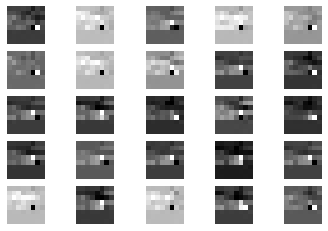

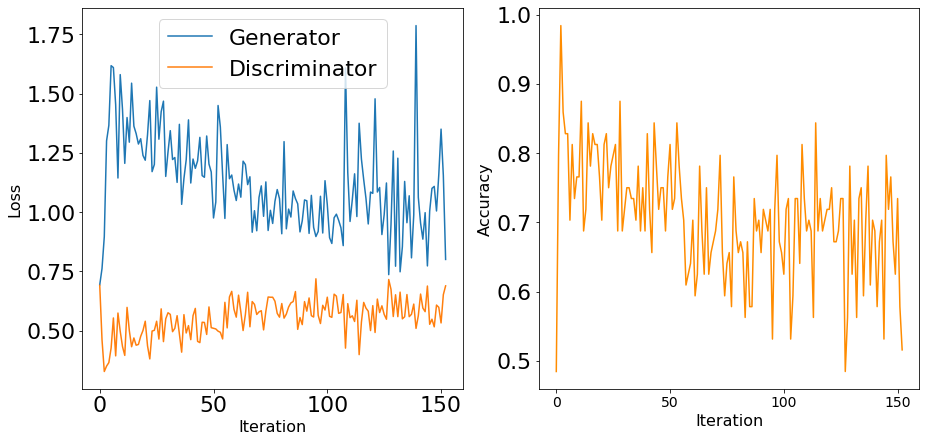

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15201 [D loss: 0.647042, acc.: 60.94%] [G loss: 0.965979]
15202 [D loss: 0.487552, acc.: 78.12%] [G loss: 1.303590]
15203 [D loss: 0.587784, acc.: 68.75%] [G loss: 1.403552]
15204 [D loss: 0.440970, acc.: 81.25%] [G loss: 1.738426]
15205 [D loss: 0.656860, acc.: 65.62%] [G loss: 1.018200]
15206 [D loss: 0.495649, acc.: 71.88%] [G loss: 1.439914]
15207 [D loss: 0.610297, acc.: 59.38%] [G loss: 1.094786]
15208 [D loss: 0.596454, acc.: 67.19%] [G loss: 0.963410]
15209 [D loss: 0.566555, acc.: 64.06%] [G loss: 0.947933]
15210 [D loss: 0.600469, acc.: 64.06%] [G loss: 0.952775]
15211 [D loss: 0.543106, acc.: 78.12%] [G loss: 1.006157]
15212 [D loss: 0.594029, acc.: 60.94%] [G loss: 0.823984]
15213 [D loss: 0.533088, acc.: 70.31%] [G loss: 1.277194]
15214 [D loss: 0.528048, acc.: 73.44%] [G loss: 1.033019]
15215 [D loss: 0.591271, acc.: 59.38%] [G loss: 1.106238]
15216 [D loss: 0.650950, acc.: 60.94%] [G loss: 1.028601]
15217 [D loss: 0.603917, acc.: 67.19%] [G loss: 0.937397]
15218 [D loss:

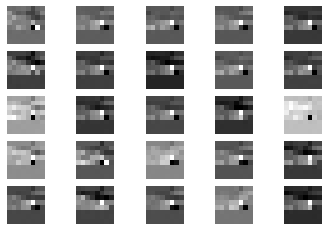

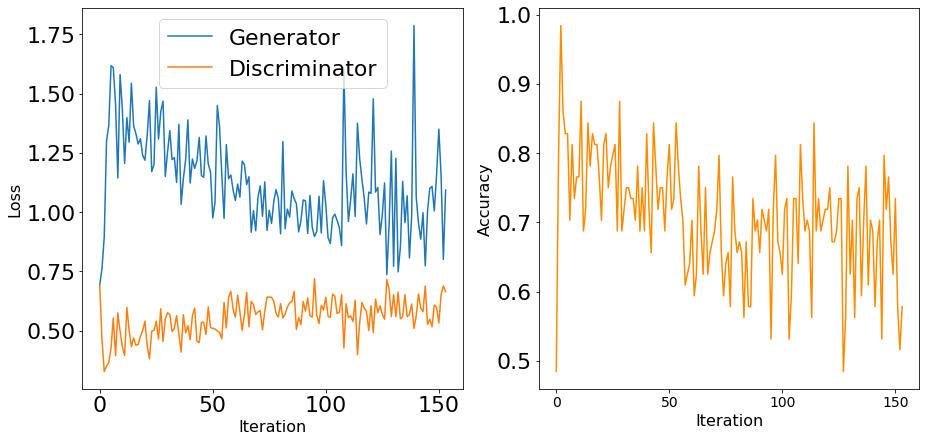

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15301 [D loss: 0.684275, acc.: 50.00%] [G loss: 0.957181]
15302 [D loss: 0.621805, acc.: 60.94%] [G loss: 0.896571]
15303 [D loss: 0.627393, acc.: 60.94%] [G loss: 0.869988]
15304 [D loss: 0.667145, acc.: 56.25%] [G loss: 0.689690]
15305 [D loss: 0.727376, acc.: 46.88%] [G loss: 0.828044]
15306 [D loss: 0.688681, acc.: 57.81%] [G loss: 0.781890]
15307 [D loss: 0.623409, acc.: 70.31%] [G loss: 0.913601]
15308 [D loss: 0.653616, acc.: 62.50%] [G loss: 0.968955]
15309 [D loss: 0.727019, acc.: 51.56%] [G loss: 0.805820]
15310 [D loss: 0.659633, acc.: 57.81%] [G loss: 0.912968]
15311 [D loss: 0.567133, acc.: 70.31%] [G loss: 1.009038]
15312 [D loss: 0.633680, acc.: 62.50%] [G loss: 1.053403]
15313 [D loss: 0.541549, acc.: 70.31%] [G loss: 1.344071]
15314 [D loss: 0.580976, acc.: 70.31%] [G loss: 0.799650]
15315 [D loss: 0.569787, acc.: 67.19%] [G loss: 0.957405]
15316 [D loss: 0.599169, acc.: 71.88%] [G loss: 1.029326]
15317 [D loss: 0.661781, acc.: 57.81%] [G loss: 0.976312]
15318 [D loss:

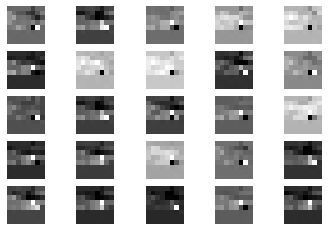

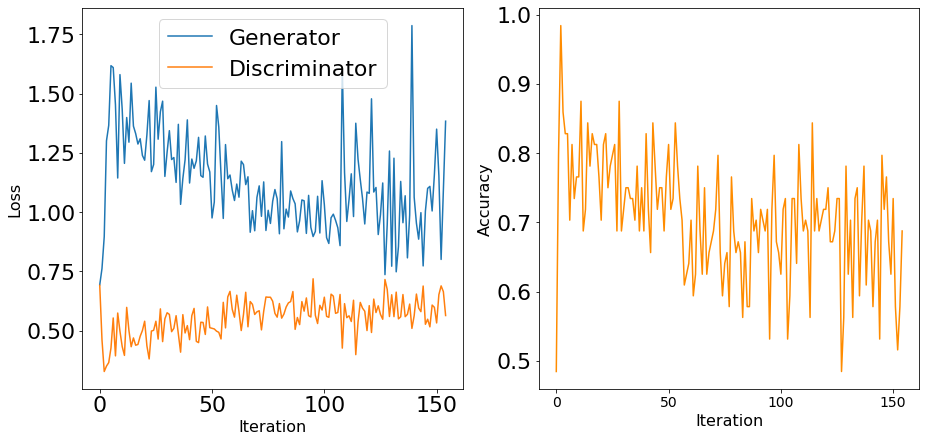

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15401 [D loss: 0.644967, acc.: 59.38%] [G loss: 0.929147]
15402 [D loss: 0.603947, acc.: 62.50%] [G loss: 0.930742]
15403 [D loss: 0.593208, acc.: 64.06%] [G loss: 1.039933]
15404 [D loss: 0.572546, acc.: 67.19%] [G loss: 1.481543]
15405 [D loss: 0.585161, acc.: 71.88%] [G loss: 1.189045]
15406 [D loss: 0.613953, acc.: 64.06%] [G loss: 1.010421]
15407 [D loss: 0.594964, acc.: 67.19%] [G loss: 1.035943]
15408 [D loss: 0.569108, acc.: 73.44%] [G loss: 0.932576]
15409 [D loss: 0.551149, acc.: 70.31%] [G loss: 1.210723]
15410 [D loss: 0.458388, acc.: 78.12%] [G loss: 1.394884]
15411 [D loss: 0.553942, acc.: 71.88%] [G loss: 1.099566]
15412 [D loss: 0.603419, acc.: 68.75%] [G loss: 1.140616]
15413 [D loss: 0.632476, acc.: 67.19%] [G loss: 0.997617]
15414 [D loss: 0.599134, acc.: 70.31%] [G loss: 0.967889]
15415 [D loss: 0.551737, acc.: 76.56%] [G loss: 1.081722]
15416 [D loss: 0.599327, acc.: 71.88%] [G loss: 1.047396]
15417 [D loss: 0.589437, acc.: 65.62%] [G loss: 0.924510]
15418 [D loss:

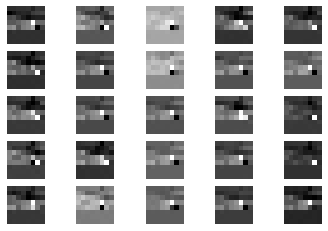

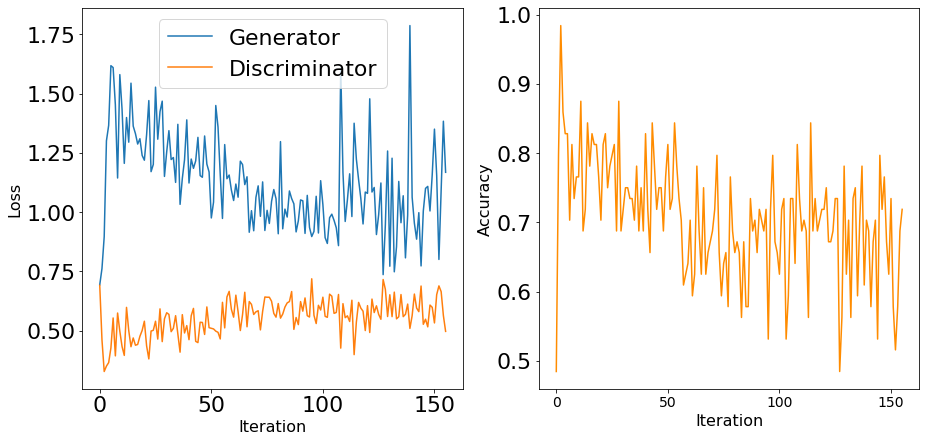

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15501 [D loss: 0.627238, acc.: 65.62%] [G loss: 1.009645]
15502 [D loss: 0.585525, acc.: 64.06%] [G loss: 0.926055]
15503 [D loss: 0.588929, acc.: 65.62%] [G loss: 0.895966]
15504 [D loss: 0.558861, acc.: 68.75%] [G loss: 0.983161]
15505 [D loss: 0.606674, acc.: 67.19%] [G loss: 0.982415]
15506 [D loss: 0.619233, acc.: 60.94%] [G loss: 0.875229]
15507 [D loss: 0.558215, acc.: 70.31%] [G loss: 0.834166]
15508 [D loss: 0.601781, acc.: 65.62%] [G loss: 0.788948]
15509 [D loss: 0.600389, acc.: 68.75%] [G loss: 0.872395]
15510 [D loss: 0.597693, acc.: 65.62%] [G loss: 0.863725]
15511 [D loss: 0.567016, acc.: 75.00%] [G loss: 1.076542]
15512 [D loss: 0.472942, acc.: 75.00%] [G loss: 1.702038]
15513 [D loss: 0.490538, acc.: 75.00%] [G loss: 1.248900]
15514 [D loss: 0.721685, acc.: 53.12%] [G loss: 0.827432]
15515 [D loss: 0.531249, acc.: 68.75%] [G loss: 0.984931]
15516 [D loss: 0.652516, acc.: 60.94%] [G loss: 0.818665]
15517 [D loss: 0.527077, acc.: 71.88%] [G loss: 1.127017]
15518 [D loss:

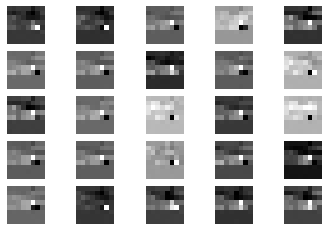

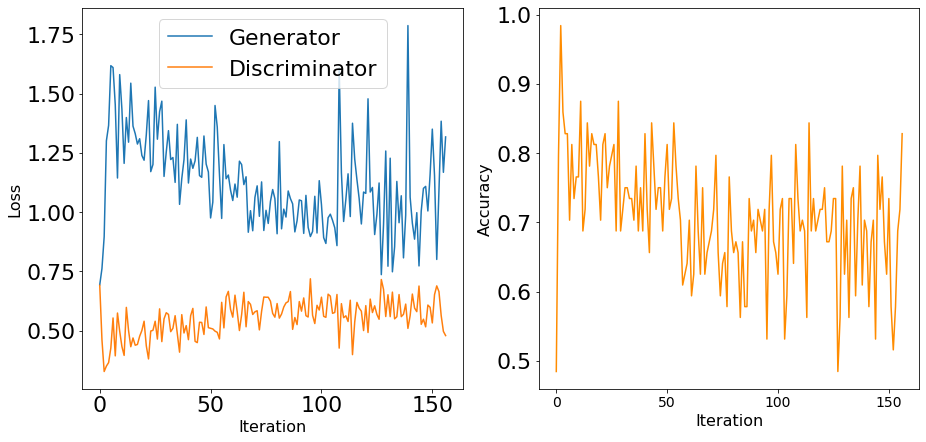

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15601 [D loss: 0.604824, acc.: 64.06%] [G loss: 0.987247]
15602 [D loss: 0.564798, acc.: 75.00%] [G loss: 0.975093]
15603 [D loss: 0.549601, acc.: 73.44%] [G loss: 0.864774]
15604 [D loss: 0.487307, acc.: 78.12%] [G loss: 1.816148]
15605 [D loss: 0.636997, acc.: 65.62%] [G loss: 1.430862]
15606 [D loss: 0.585762, acc.: 73.44%] [G loss: 1.108800]
15607 [D loss: 0.595665, acc.: 67.19%] [G loss: 1.009064]
15608 [D loss: 0.592559, acc.: 59.38%] [G loss: 0.961078]
15609 [D loss: 0.565300, acc.: 71.88%] [G loss: 0.942908]
15610 [D loss: 0.635952, acc.: 59.38%] [G loss: 0.879943]
15611 [D loss: 0.562780, acc.: 76.56%] [G loss: 1.017482]
15612 [D loss: 0.624330, acc.: 60.94%] [G loss: 0.899239]
15613 [D loss: 0.527231, acc.: 73.44%] [G loss: 1.004214]
15614 [D loss: 0.518781, acc.: 78.12%] [G loss: 0.963604]
15615 [D loss: 0.653567, acc.: 57.81%] [G loss: 0.836549]
15616 [D loss: 0.594865, acc.: 67.19%] [G loss: 0.880086]
15617 [D loss: 0.581767, acc.: 65.62%] [G loss: 1.023899]
15618 [D loss:

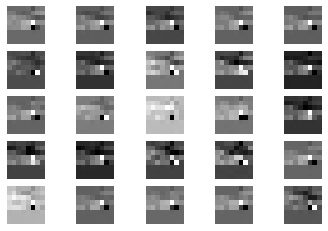

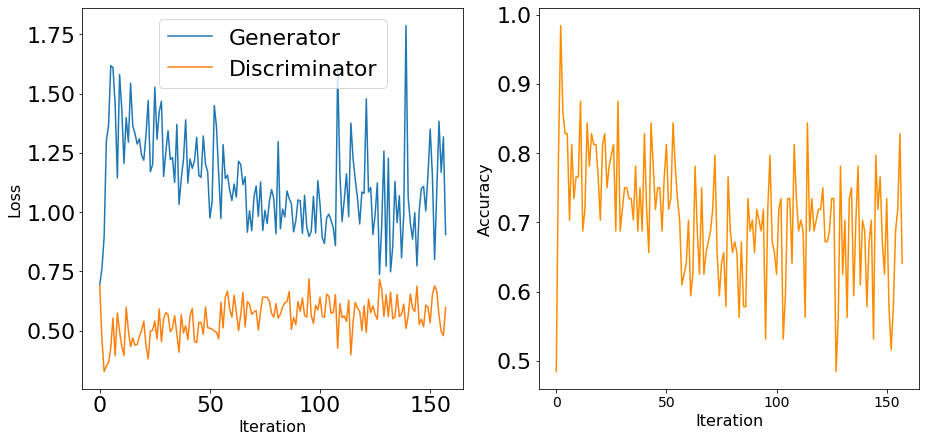

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15701 [D loss: 0.646901, acc.: 51.56%] [G loss: 1.095708]
15702 [D loss: 0.639197, acc.: 65.62%] [G loss: 1.050208]
15703 [D loss: 0.649346, acc.: 65.62%] [G loss: 0.945004]
15704 [D loss: 0.554756, acc.: 75.00%] [G loss: 0.898098]
15705 [D loss: 0.586770, acc.: 71.88%] [G loss: 1.004729]
15706 [D loss: 0.586082, acc.: 67.19%] [G loss: 1.258714]
15707 [D loss: 0.497678, acc.: 68.75%] [G loss: 1.607298]
15708 [D loss: 0.592210, acc.: 59.38%] [G loss: 0.968107]
15709 [D loss: 0.598155, acc.: 71.88%] [G loss: 0.856711]
15710 [D loss: 0.529360, acc.: 71.88%] [G loss: 1.154750]
15711 [D loss: 0.634115, acc.: 62.50%] [G loss: 0.904978]
15712 [D loss: 0.588145, acc.: 68.75%] [G loss: 1.046545]
15713 [D loss: 0.568065, acc.: 75.00%] [G loss: 0.947292]
15714 [D loss: 0.672565, acc.: 56.25%] [G loss: 0.991332]
15715 [D loss: 0.564679, acc.: 73.44%] [G loss: 0.862987]
15716 [D loss: 0.613475, acc.: 67.19%] [G loss: 0.893130]
15717 [D loss: 0.629017, acc.: 67.19%] [G loss: 1.096835]
15718 [D loss:

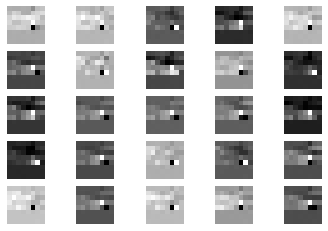

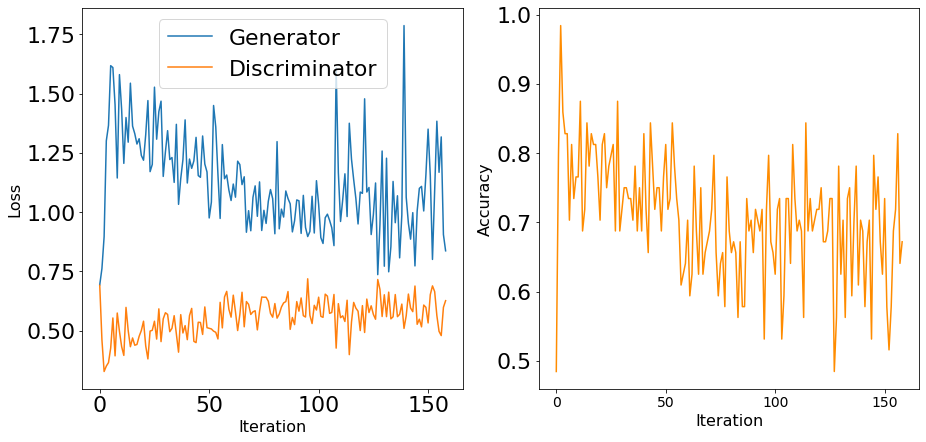

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15801 [D loss: 0.595553, acc.: 67.19%] [G loss: 0.796299]
15802 [D loss: 0.725150, acc.: 51.56%] [G loss: 0.863062]
15803 [D loss: 0.623289, acc.: 64.06%] [G loss: 1.038142]
15804 [D loss: 0.620799, acc.: 67.19%] [G loss: 0.851333]
15805 [D loss: 0.470287, acc.: 84.38%] [G loss: 1.210749]
15806 [D loss: 0.577540, acc.: 67.19%] [G loss: 1.313981]
15807 [D loss: 0.581453, acc.: 68.75%] [G loss: 1.004604]
15808 [D loss: 0.656131, acc.: 65.62%] [G loss: 1.004526]
15809 [D loss: 0.635903, acc.: 57.81%] [G loss: 0.945662]
15810 [D loss: 0.661036, acc.: 59.38%] [G loss: 0.887856]
15811 [D loss: 0.548212, acc.: 71.88%] [G loss: 0.919953]
15812 [D loss: 0.568628, acc.: 78.12%] [G loss: 1.139730]
15813 [D loss: 0.538072, acc.: 70.31%] [G loss: 1.323232]
15814 [D loss: 0.552570, acc.: 75.00%] [G loss: 1.537990]
15815 [D loss: 0.692796, acc.: 57.81%] [G loss: 1.170356]
15816 [D loss: 0.540773, acc.: 70.31%] [G loss: 1.215592]
15817 [D loss: 0.507482, acc.: 70.31%] [G loss: 1.694127]
15818 [D loss:

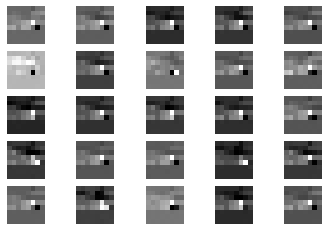

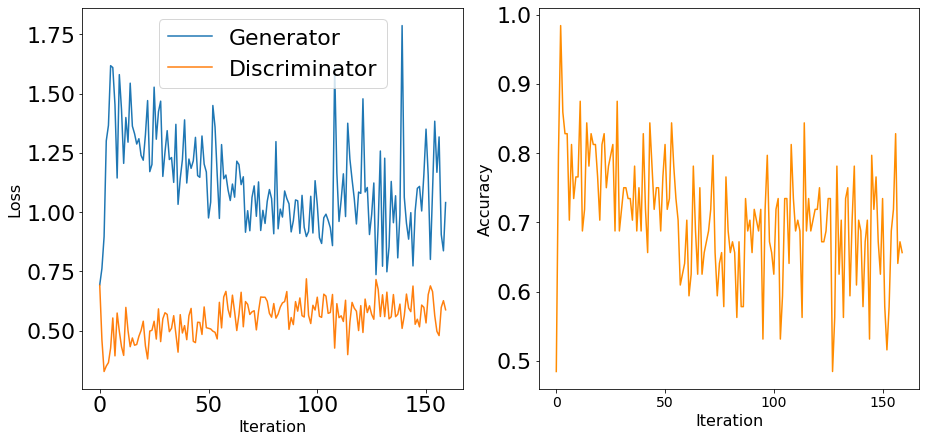

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


15901 [D loss: 0.567879, acc.: 76.56%] [G loss: 1.029759]
15902 [D loss: 0.586596, acc.: 71.88%] [G loss: 1.119542]
15903 [D loss: 0.550074, acc.: 75.00%] [G loss: 1.128542]
15904 [D loss: 0.570793, acc.: 70.31%] [G loss: 0.880440]
15905 [D loss: 0.732591, acc.: 53.12%] [G loss: 0.795110]
15906 [D loss: 0.650417, acc.: 60.94%] [G loss: 0.733907]
15907 [D loss: 0.580697, acc.: 67.19%] [G loss: 1.084892]
15908 [D loss: 0.540403, acc.: 78.12%] [G loss: 1.166190]
15909 [D loss: 0.486342, acc.: 75.00%] [G loss: 1.550823]
15910 [D loss: 0.599119, acc.: 62.50%] [G loss: 1.056825]
15911 [D loss: 0.638134, acc.: 60.94%] [G loss: 1.186730]
15912 [D loss: 0.606607, acc.: 65.62%] [G loss: 1.155952]
15913 [D loss: 0.573041, acc.: 70.31%] [G loss: 1.009932]
15914 [D loss: 0.554464, acc.: 68.75%] [G loss: 1.463242]
15915 [D loss: 0.486558, acc.: 73.44%] [G loss: 1.338452]
15916 [D loss: 0.553036, acc.: 75.00%] [G loss: 0.980073]
15917 [D loss: 0.569935, acc.: 67.19%] [G loss: 1.061026]
15918 [D loss:

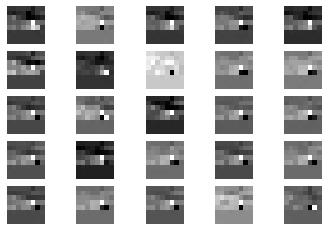

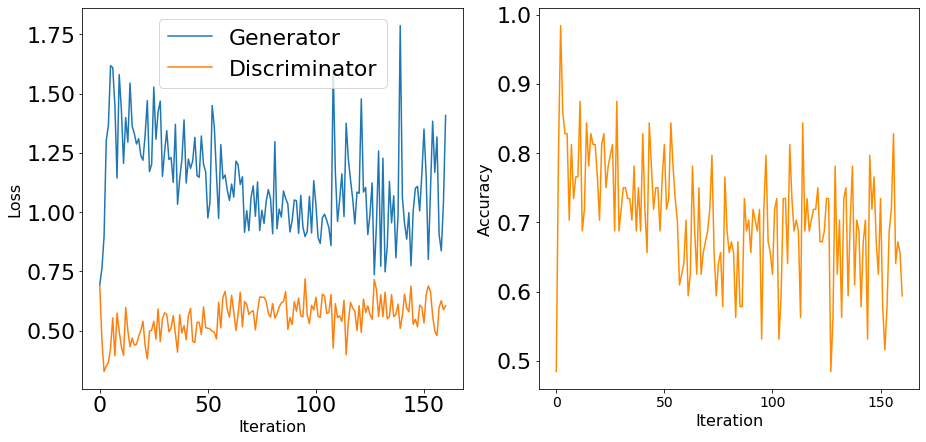

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16001 [D loss: 0.542403, acc.: 78.12%] [G loss: 1.131622]
16002 [D loss: 0.617227, acc.: 65.62%] [G loss: 0.891668]
16003 [D loss: 0.564731, acc.: 71.88%] [G loss: 0.940609]
16004 [D loss: 0.589557, acc.: 68.75%] [G loss: 0.952159]
16005 [D loss: 0.513992, acc.: 79.69%] [G loss: 1.099940]
16006 [D loss: 0.587087, acc.: 73.44%] [G loss: 1.054462]
16007 [D loss: 0.651669, acc.: 57.81%] [G loss: 1.055779]
16008 [D loss: 0.519869, acc.: 75.00%] [G loss: 0.957015]
16009 [D loss: 0.642147, acc.: 59.38%] [G loss: 0.858691]
16010 [D loss: 0.618275, acc.: 64.06%] [G loss: 0.840139]
16011 [D loss: 0.600847, acc.: 70.31%] [G loss: 0.855818]
16012 [D loss: 0.677967, acc.: 59.38%] [G loss: 0.818577]
16013 [D loss: 0.677707, acc.: 68.75%] [G loss: 1.174107]
16014 [D loss: 0.584237, acc.: 70.31%] [G loss: 0.949631]
16015 [D loss: 0.684409, acc.: 56.25%] [G loss: 0.739658]
16016 [D loss: 0.649280, acc.: 62.50%] [G loss: 0.732452]
16017 [D loss: 0.666979, acc.: 62.50%] [G loss: 0.923060]
16018 [D loss:

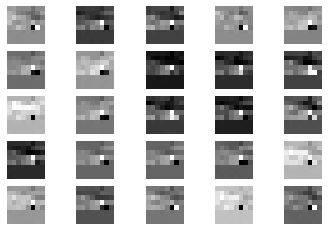

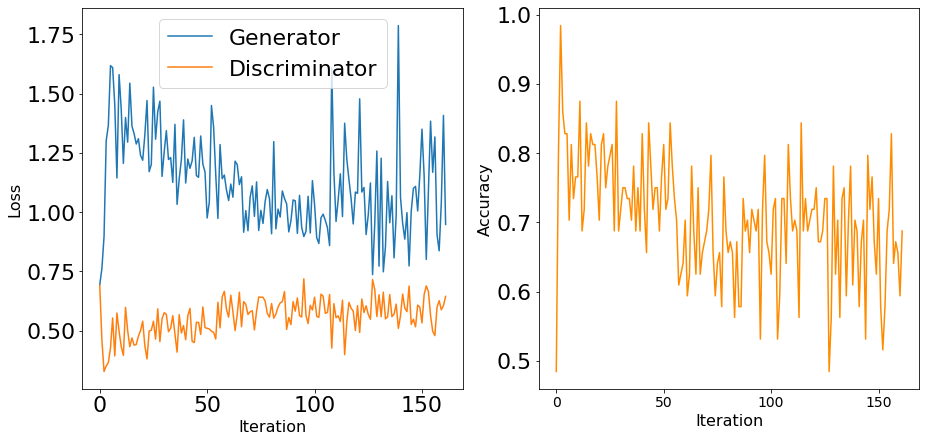

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16101 [D loss: 0.590251, acc.: 67.19%] [G loss: 1.153730]
16102 [D loss: 0.578117, acc.: 70.31%] [G loss: 0.883371]
16103 [D loss: 0.641531, acc.: 56.25%] [G loss: 1.074185]
16104 [D loss: 0.661517, acc.: 65.62%] [G loss: 0.948836]
16105 [D loss: 0.647475, acc.: 59.38%] [G loss: 1.035533]
16106 [D loss: 0.554243, acc.: 64.06%] [G loss: 1.193445]
16107 [D loss: 0.687912, acc.: 57.81%] [G loss: 0.942730]
16108 [D loss: 0.642861, acc.: 59.38%] [G loss: 1.021631]
16109 [D loss: 0.478709, acc.: 73.44%] [G loss: 1.325965]
16110 [D loss: 0.635439, acc.: 57.81%] [G loss: 1.002271]
16111 [D loss: 0.658621, acc.: 59.38%] [G loss: 1.214371]
16112 [D loss: 0.552507, acc.: 76.56%] [G loss: 0.941882]
16113 [D loss: 0.638998, acc.: 60.94%] [G loss: 0.872057]
16114 [D loss: 0.652861, acc.: 64.06%] [G loss: 0.904915]
16115 [D loss: 0.537285, acc.: 76.56%] [G loss: 0.980535]
16116 [D loss: 0.584475, acc.: 67.19%] [G loss: 0.957682]
16117 [D loss: 0.504204, acc.: 78.12%] [G loss: 0.996818]
16118 [D loss:

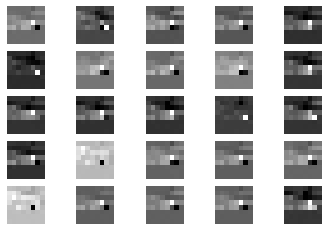

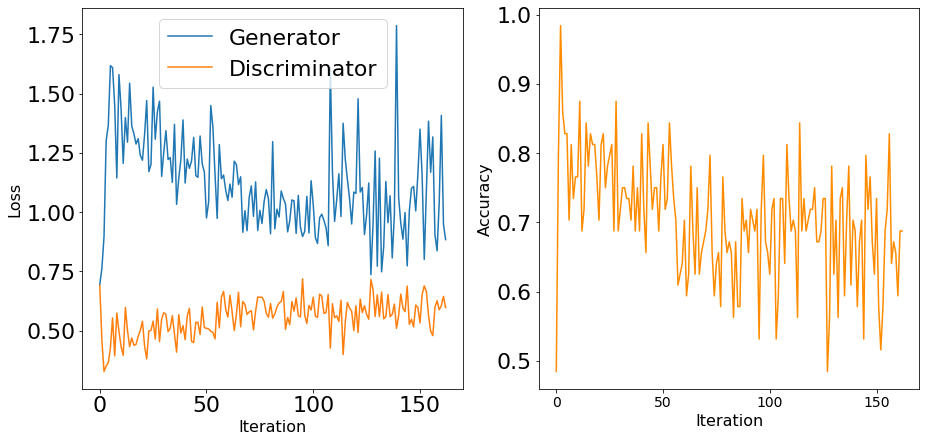

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16201 [D loss: 0.585736, acc.: 68.75%] [G loss: 0.942260]
16202 [D loss: 0.656691, acc.: 64.06%] [G loss: 0.805630]
16203 [D loss: 0.632998, acc.: 60.94%] [G loss: 0.926710]
16204 [D loss: 0.533917, acc.: 67.19%] [G loss: 1.078309]
16205 [D loss: 0.640228, acc.: 65.62%] [G loss: 0.862316]
16206 [D loss: 0.553869, acc.: 68.75%] [G loss: 1.056777]
16207 [D loss: 0.515378, acc.: 70.31%] [G loss: 1.267992]
16208 [D loss: 0.643642, acc.: 60.94%] [G loss: 1.076886]
16209 [D loss: 0.573883, acc.: 67.19%] [G loss: 0.770855]
16210 [D loss: 0.577025, acc.: 68.75%] [G loss: 0.905940]
16211 [D loss: 0.691825, acc.: 53.12%] [G loss: 0.937125]
16212 [D loss: 0.648717, acc.: 67.19%] [G loss: 0.922907]
16213 [D loss: 0.644948, acc.: 64.06%] [G loss: 0.994345]
16214 [D loss: 0.607862, acc.: 67.19%] [G loss: 1.138557]
16215 [D loss: 0.596514, acc.: 71.88%] [G loss: 0.931993]
16216 [D loss: 0.619283, acc.: 64.06%] [G loss: 0.829600]
16217 [D loss: 0.635548, acc.: 60.94%] [G loss: 0.862649]
16218 [D loss:

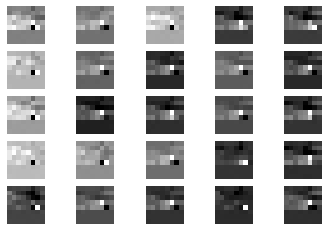

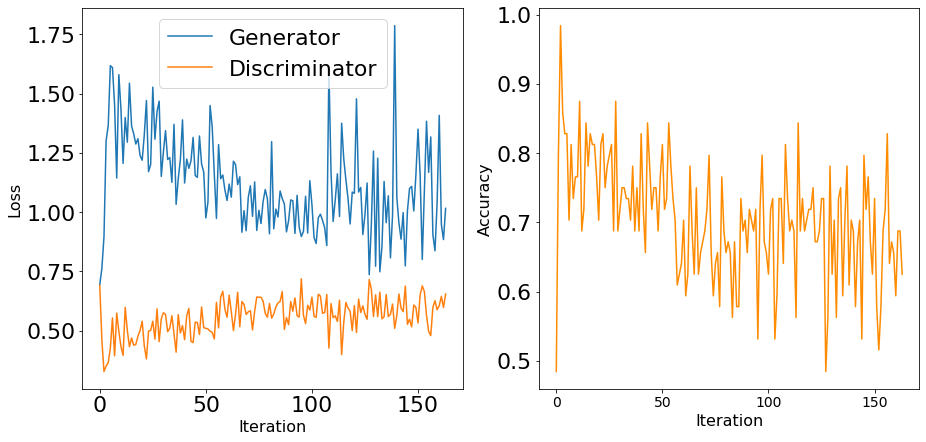

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16301 [D loss: 0.518907, acc.: 67.19%] [G loss: 1.229546]
16302 [D loss: 0.536511, acc.: 68.75%] [G loss: 1.527488]
16303 [D loss: 0.523614, acc.: 76.56%] [G loss: 1.207549]
16304 [D loss: 0.546583, acc.: 75.00%] [G loss: 0.864433]
16305 [D loss: 0.590186, acc.: 71.88%] [G loss: 1.069001]
16306 [D loss: 0.524913, acc.: 75.00%] [G loss: 1.161133]
16307 [D loss: 0.588323, acc.: 70.31%] [G loss: 0.853550]
16308 [D loss: 0.550690, acc.: 73.44%] [G loss: 0.827384]
16309 [D loss: 0.568379, acc.: 75.00%] [G loss: 0.873448]
16310 [D loss: 0.614964, acc.: 68.75%] [G loss: 0.888115]
16311 [D loss: 0.622471, acc.: 68.75%] [G loss: 1.012211]
16312 [D loss: 0.597674, acc.: 60.94%] [G loss: 1.268451]
16313 [D loss: 0.663270, acc.: 62.50%] [G loss: 0.960350]
16314 [D loss: 0.604904, acc.: 70.31%] [G loss: 0.825977]
16315 [D loss: 0.663461, acc.: 62.50%] [G loss: 0.784182]
16316 [D loss: 0.556186, acc.: 67.19%] [G loss: 1.003382]
16317 [D loss: 0.536036, acc.: 70.31%] [G loss: 1.425966]
16318 [D loss:

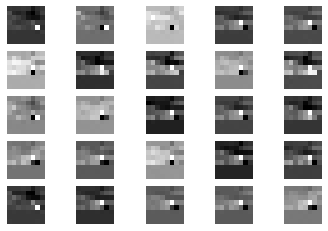

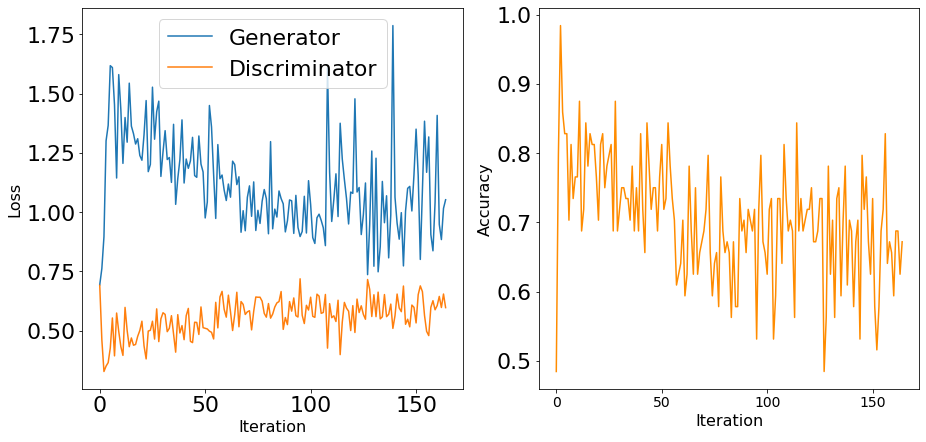

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16401 [D loss: 0.698496, acc.: 56.25%] [G loss: 0.840687]
16402 [D loss: 0.589909, acc.: 71.88%] [G loss: 1.004910]
16403 [D loss: 0.575913, acc.: 68.75%] [G loss: 1.037057]
16404 [D loss: 0.625695, acc.: 64.06%] [G loss: 0.950924]
16405 [D loss: 0.683721, acc.: 64.06%] [G loss: 0.868259]
16406 [D loss: 0.667642, acc.: 64.06%] [G loss: 0.856066]
16407 [D loss: 0.589528, acc.: 71.88%] [G loss: 0.917570]
16408 [D loss: 0.555027, acc.: 76.56%] [G loss: 1.104288]
16409 [D loss: 0.552326, acc.: 68.75%] [G loss: 0.932348]
16410 [D loss: 0.490575, acc.: 73.44%] [G loss: 1.502514]
16411 [D loss: 0.573520, acc.: 68.75%] [G loss: 0.872469]
16412 [D loss: 0.511597, acc.: 82.81%] [G loss: 0.790541]
16413 [D loss: 0.648100, acc.: 64.06%] [G loss: 1.101485]
16414 [D loss: 0.545554, acc.: 68.75%] [G loss: 1.258114]
16415 [D loss: 0.571617, acc.: 75.00%] [G loss: 1.110177]
16416 [D loss: 0.593207, acc.: 65.62%] [G loss: 1.172286]
16417 [D loss: 0.519257, acc.: 73.44%] [G loss: 1.349213]
16418 [D loss:

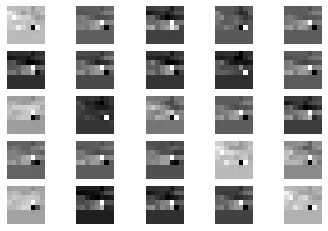

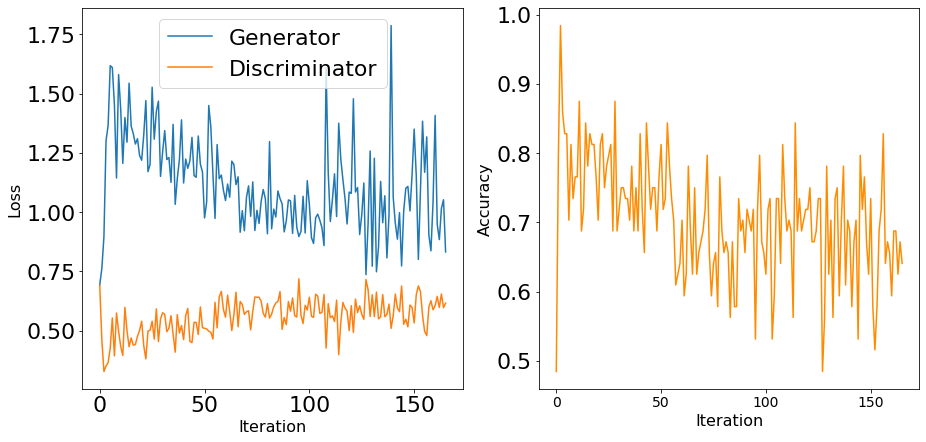

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16501 [D loss: 0.584558, acc.: 75.00%] [G loss: 0.973822]
16502 [D loss: 0.574161, acc.: 65.62%] [G loss: 0.852024]
16503 [D loss: 0.673433, acc.: 56.25%] [G loss: 0.994118]
16504 [D loss: 0.585787, acc.: 70.31%] [G loss: 0.914517]
16505 [D loss: 0.576619, acc.: 68.75%] [G loss: 1.138840]
16506 [D loss: 0.512947, acc.: 76.56%] [G loss: 1.008562]
16507 [D loss: 0.601210, acc.: 64.06%] [G loss: 1.050946]
16508 [D loss: 0.622325, acc.: 59.38%] [G loss: 0.913245]
16509 [D loss: 0.579551, acc.: 68.75%] [G loss: 0.782436]
16510 [D loss: 0.512948, acc.: 75.00%] [G loss: 0.861372]
16511 [D loss: 0.575542, acc.: 70.31%] [G loss: 0.928823]
16512 [D loss: 0.606124, acc.: 65.62%] [G loss: 1.010935]
16513 [D loss: 0.616786, acc.: 65.62%] [G loss: 0.939915]
16514 [D loss: 0.629955, acc.: 57.81%] [G loss: 0.883749]
16515 [D loss: 0.684378, acc.: 54.69%] [G loss: 0.803569]
16516 [D loss: 0.648693, acc.: 57.81%] [G loss: 0.991880]
16517 [D loss: 0.697009, acc.: 53.12%] [G loss: 0.965280]
16518 [D loss:

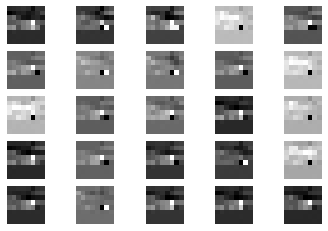

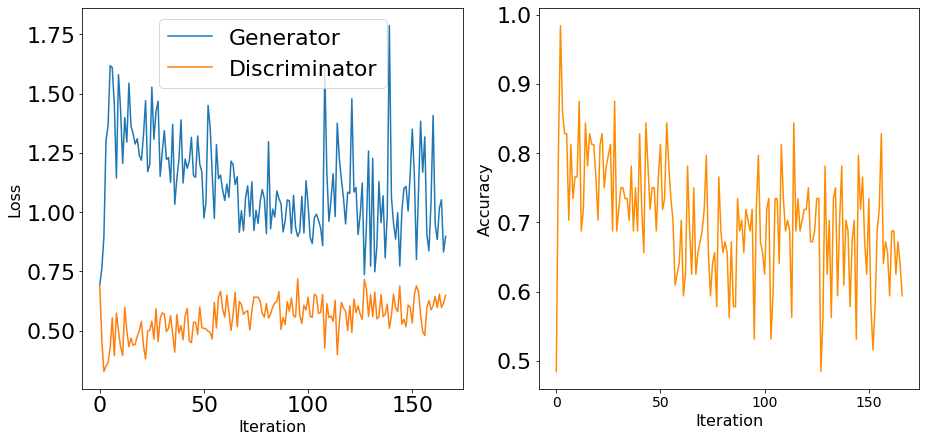

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16601 [D loss: 0.515234, acc.: 71.88%] [G loss: 1.208018]
16602 [D loss: 0.679306, acc.: 60.94%] [G loss: 0.825104]
16603 [D loss: 0.548469, acc.: 65.62%] [G loss: 1.531291]
16604 [D loss: 0.568917, acc.: 65.62%] [G loss: 0.982002]
16605 [D loss: 0.490825, acc.: 75.00%] [G loss: 1.335237]
16606 [D loss: 0.556224, acc.: 71.88%] [G loss: 0.909503]
16607 [D loss: 0.595396, acc.: 67.19%] [G loss: 1.043657]
16608 [D loss: 0.680122, acc.: 53.12%] [G loss: 0.846286]
16609 [D loss: 0.524798, acc.: 70.31%] [G loss: 1.050232]
16610 [D loss: 0.619291, acc.: 65.62%] [G loss: 0.911550]
16611 [D loss: 0.628972, acc.: 67.19%] [G loss: 0.931193]
16612 [D loss: 0.629436, acc.: 59.38%] [G loss: 0.868055]
16613 [D loss: 0.617972, acc.: 57.81%] [G loss: 1.005845]
16614 [D loss: 0.614619, acc.: 67.19%] [G loss: 0.904569]
16615 [D loss: 0.629516, acc.: 68.75%] [G loss: 0.931106]
16616 [D loss: 0.590138, acc.: 71.88%] [G loss: 0.980703]
16617 [D loss: 0.506930, acc.: 75.00%] [G loss: 1.931767]
16618 [D loss:

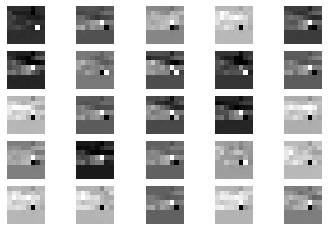

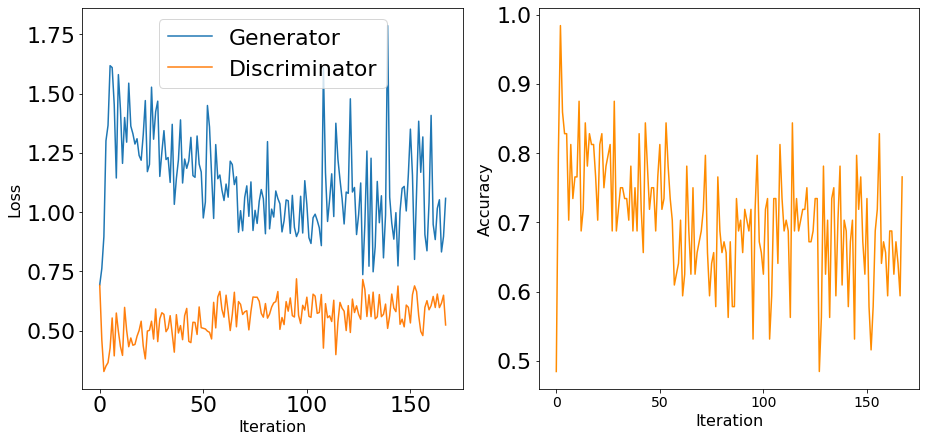

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16701 [D loss: 0.518328, acc.: 67.19%] [G loss: 1.294126]
16702 [D loss: 0.589231, acc.: 68.75%] [G loss: 0.953990]
16703 [D loss: 0.538080, acc.: 75.00%] [G loss: 0.960736]
16704 [D loss: 0.524828, acc.: 75.00%] [G loss: 1.107783]
16705 [D loss: 0.641133, acc.: 65.62%] [G loss: 0.883260]
16706 [D loss: 0.538299, acc.: 71.88%] [G loss: 1.014566]
16707 [D loss: 0.566874, acc.: 68.75%] [G loss: 1.131147]
16708 [D loss: 0.583277, acc.: 64.06%] [G loss: 0.858153]
16709 [D loss: 0.591360, acc.: 71.88%] [G loss: 0.853511]
16710 [D loss: 0.589516, acc.: 67.19%] [G loss: 1.195013]
16711 [D loss: 0.607720, acc.: 62.50%] [G loss: 0.861843]
16712 [D loss: 0.625930, acc.: 64.06%] [G loss: 0.904837]
16713 [D loss: 0.603448, acc.: 67.19%] [G loss: 0.956948]
16714 [D loss: 0.512016, acc.: 68.75%] [G loss: 1.644195]
16715 [D loss: 0.487830, acc.: 79.69%] [G loss: 1.641783]
16716 [D loss: 0.539330, acc.: 78.12%] [G loss: 0.976286]
16717 [D loss: 0.626194, acc.: 64.06%] [G loss: 0.941958]
16718 [D loss:

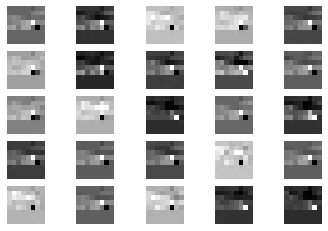

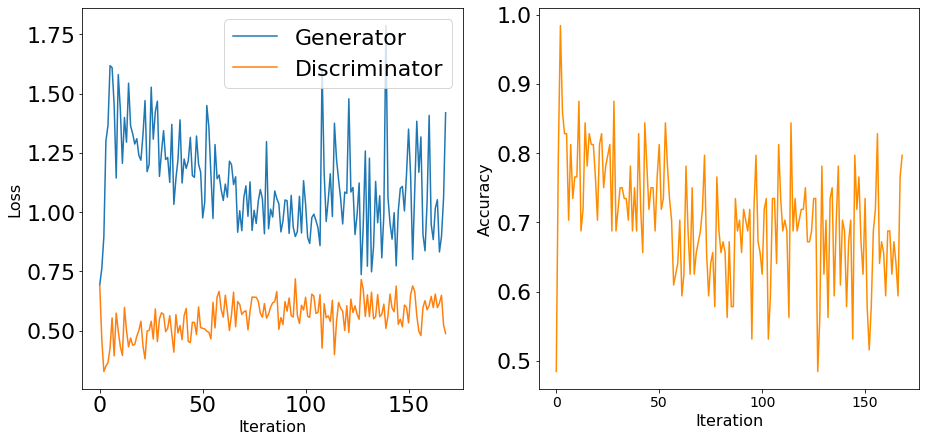

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16801 [D loss: 0.690296, acc.: 51.56%] [G loss: 0.808660]
16802 [D loss: 0.535167, acc.: 65.62%] [G loss: 1.117215]
16803 [D loss: 0.575553, acc.: 75.00%] [G loss: 0.999219]
16804 [D loss: 0.561303, acc.: 73.44%] [G loss: 0.836485]
16805 [D loss: 0.690074, acc.: 60.94%] [G loss: 0.803413]
16806 [D loss: 0.565941, acc.: 70.31%] [G loss: 1.003385]
16807 [D loss: 0.651573, acc.: 67.19%] [G loss: 0.972589]
16808 [D loss: 0.645779, acc.: 64.06%] [G loss: 0.839026]
16809 [D loss: 0.629576, acc.: 60.94%] [G loss: 0.865253]
16810 [D loss: 0.568821, acc.: 70.31%] [G loss: 1.097132]
16811 [D loss: 0.496319, acc.: 81.25%] [G loss: 0.913610]
16812 [D loss: 0.600399, acc.: 64.06%] [G loss: 0.889126]
16813 [D loss: 0.617432, acc.: 70.31%] [G loss: 0.931400]
16814 [D loss: 0.617298, acc.: 65.62%] [G loss: 1.173598]
16815 [D loss: 0.632728, acc.: 64.06%] [G loss: 0.915336]
16816 [D loss: 0.665480, acc.: 56.25%] [G loss: 0.835414]
16817 [D loss: 0.577290, acc.: 68.75%] [G loss: 0.940525]
16818 [D loss:

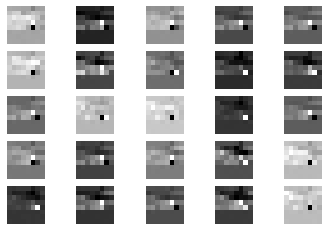

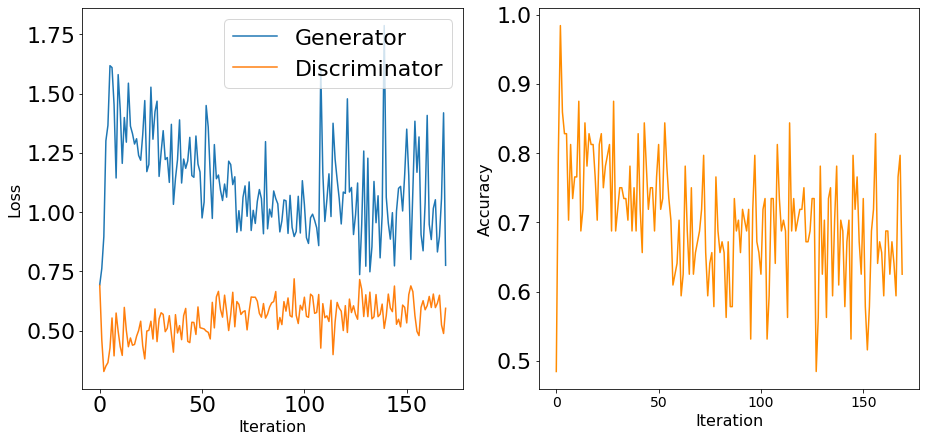

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


16901 [D loss: 0.770249, acc.: 51.56%] [G loss: 0.890545]
16902 [D loss: 0.644064, acc.: 60.94%] [G loss: 0.922103]
16903 [D loss: 0.547937, acc.: 68.75%] [G loss: 1.210073]
16904 [D loss: 0.596632, acc.: 65.62%] [G loss: 0.981414]
16905 [D loss: 0.535014, acc.: 71.88%] [G loss: 1.213177]
16906 [D loss: 0.544509, acc.: 70.31%] [G loss: 1.299961]
16907 [D loss: 0.565201, acc.: 64.06%] [G loss: 1.135964]
16908 [D loss: 0.528346, acc.: 76.56%] [G loss: 1.007689]
16909 [D loss: 0.580093, acc.: 68.75%] [G loss: 1.360898]
16910 [D loss: 0.532012, acc.: 76.56%] [G loss: 1.215134]
16911 [D loss: 0.615270, acc.: 57.81%] [G loss: 0.714481]
16912 [D loss: 0.552003, acc.: 78.12%] [G loss: 0.926980]
16913 [D loss: 0.554847, acc.: 76.56%] [G loss: 0.910440]
16914 [D loss: 0.614260, acc.: 70.31%] [G loss: 0.800646]
16915 [D loss: 0.567581, acc.: 75.00%] [G loss: 0.821312]
16916 [D loss: 0.646023, acc.: 62.50%] [G loss: 0.810602]
16917 [D loss: 0.544624, acc.: 68.75%] [G loss: 1.146047]
16918 [D loss:

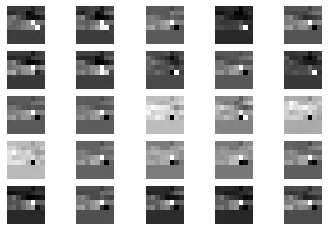

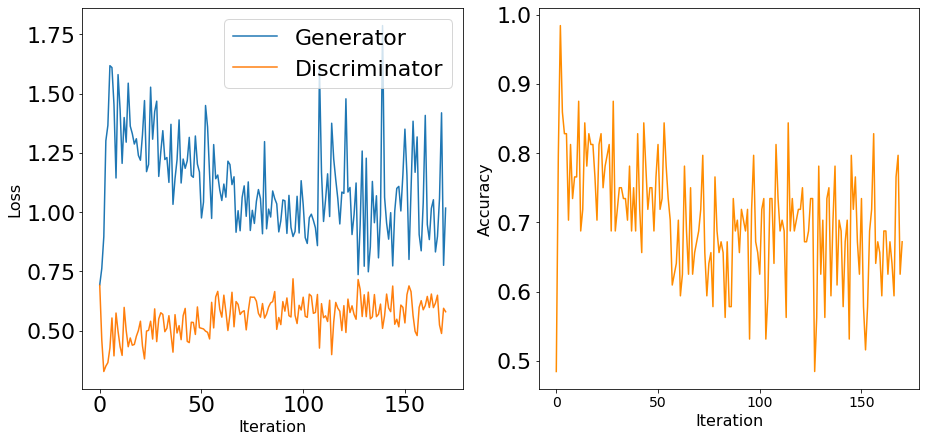

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17001 [D loss: 0.570598, acc.: 75.00%] [G loss: 1.275778]
17002 [D loss: 0.449429, acc.: 79.69%] [G loss: 1.736408]
17003 [D loss: 0.437776, acc.: 82.81%] [G loss: 1.936603]
17004 [D loss: 0.604241, acc.: 60.94%] [G loss: 1.084219]
17005 [D loss: 0.608118, acc.: 70.31%] [G loss: 0.888130]
17006 [D loss: 0.605079, acc.: 65.62%] [G loss: 1.145838]
17007 [D loss: 0.630619, acc.: 56.25%] [G loss: 1.118264]
17008 [D loss: 0.627045, acc.: 62.50%] [G loss: 1.126120]
17009 [D loss: 0.632183, acc.: 64.06%] [G loss: 0.923771]
17010 [D loss: 0.552144, acc.: 67.19%] [G loss: 1.020660]
17011 [D loss: 0.617317, acc.: 68.75%] [G loss: 1.091595]
17012 [D loss: 0.623097, acc.: 60.94%] [G loss: 0.815121]
17013 [D loss: 0.621342, acc.: 62.50%] [G loss: 0.848610]
17014 [D loss: 0.539944, acc.: 76.56%] [G loss: 0.794306]
17015 [D loss: 0.582825, acc.: 71.88%] [G loss: 0.887151]
17016 [D loss: 0.615291, acc.: 65.62%] [G loss: 0.869440]
17017 [D loss: 0.716979, acc.: 48.44%] [G loss: 0.814055]
17018 [D loss:

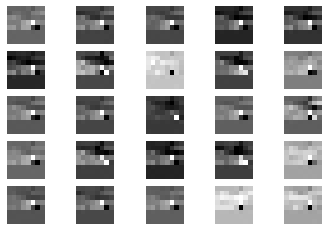

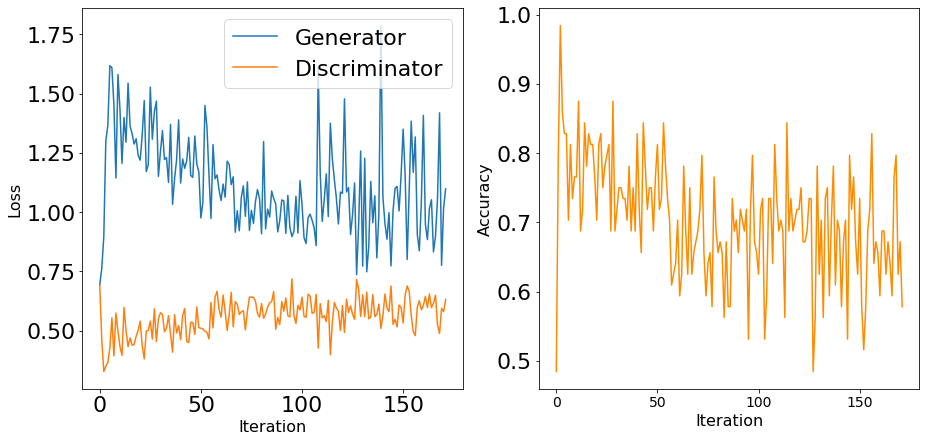

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17101 [D loss: 0.675392, acc.: 62.50%] [G loss: 0.943902]
17102 [D loss: 0.576024, acc.: 68.75%] [G loss: 1.061929]
17103 [D loss: 0.561443, acc.: 78.12%] [G loss: 1.029407]
17104 [D loss: 0.558906, acc.: 68.75%] [G loss: 1.107912]
17105 [D loss: 0.546811, acc.: 75.00%] [G loss: 1.244936]
17106 [D loss: 0.628524, acc.: 62.50%] [G loss: 0.954442]
17107 [D loss: 0.627334, acc.: 64.06%] [G loss: 1.056736]
17108 [D loss: 0.542284, acc.: 65.62%] [G loss: 1.480669]
17109 [D loss: 0.603488, acc.: 67.19%] [G loss: 1.516211]
17110 [D loss: 0.588654, acc.: 65.62%] [G loss: 1.248071]
17111 [D loss: 0.630317, acc.: 62.50%] [G loss: 1.024492]
17112 [D loss: 0.612840, acc.: 62.50%] [G loss: 1.000185]
17113 [D loss: 0.548590, acc.: 68.75%] [G loss: 1.300937]
17114 [D loss: 0.537734, acc.: 68.75%] [G loss: 1.123542]
17115 [D loss: 0.627732, acc.: 70.31%] [G loss: 0.899873]
17116 [D loss: 0.657922, acc.: 62.50%] [G loss: 0.775406]
17117 [D loss: 0.616668, acc.: 67.19%] [G loss: 0.978959]
17118 [D loss:

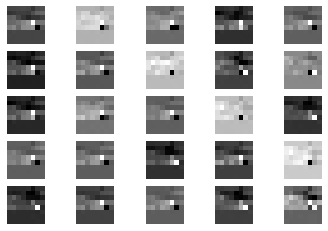

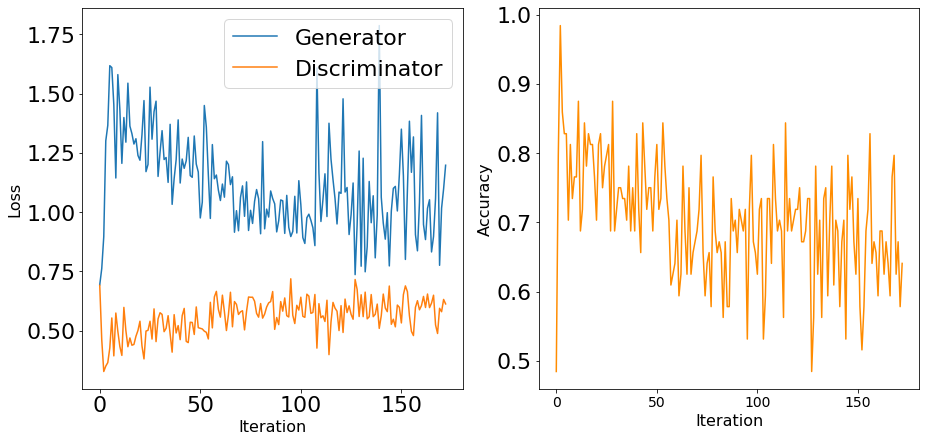

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17201 [D loss: 0.644159, acc.: 62.50%] [G loss: 0.844937]
17202 [D loss: 0.643455, acc.: 57.81%] [G loss: 0.917267]
17203 [D loss: 0.494691, acc.: 75.00%] [G loss: 1.612091]
17204 [D loss: 0.548617, acc.: 73.44%] [G loss: 1.067674]
17205 [D loss: 0.581065, acc.: 62.50%] [G loss: 0.901993]
17206 [D loss: 0.638689, acc.: 64.06%] [G loss: 0.737793]
17207 [D loss: 0.636668, acc.: 68.75%] [G loss: 0.893964]
17208 [D loss: 0.526336, acc.: 67.19%] [G loss: 1.152559]
17209 [D loss: 0.664431, acc.: 65.62%] [G loss: 0.814231]
17210 [D loss: 0.630759, acc.: 64.06%] [G loss: 0.739414]
17211 [D loss: 0.567252, acc.: 70.31%] [G loss: 0.809051]
17212 [D loss: 0.535699, acc.: 79.69%] [G loss: 0.932360]
17213 [D loss: 0.579814, acc.: 71.88%] [G loss: 1.112761]
17214 [D loss: 0.559319, acc.: 70.31%] [G loss: 1.067484]
17215 [D loss: 0.580538, acc.: 68.75%] [G loss: 0.950270]
17216 [D loss: 0.573717, acc.: 67.19%] [G loss: 1.138626]
17217 [D loss: 0.532539, acc.: 76.56%] [G loss: 0.947787]
17218 [D loss:

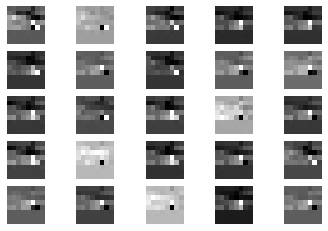

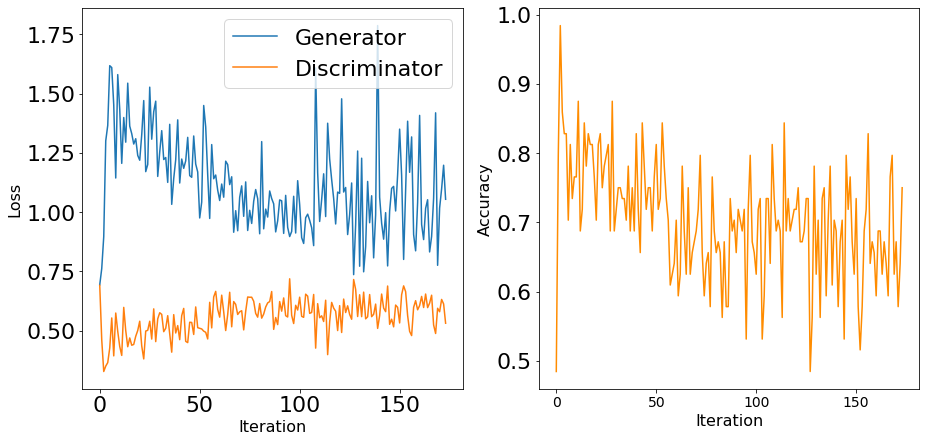

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17301 [D loss: 0.498967, acc.: 78.12%] [G loss: 1.272679]
17302 [D loss: 0.522216, acc.: 73.44%] [G loss: 1.437257]
17303 [D loss: 0.563376, acc.: 67.19%] [G loss: 1.340244]
17304 [D loss: 0.594718, acc.: 65.62%] [G loss: 1.185960]
17305 [D loss: 0.596504, acc.: 70.31%] [G loss: 0.919680]
17306 [D loss: 0.619439, acc.: 67.19%] [G loss: 0.790299]
17307 [D loss: 0.556463, acc.: 73.44%] [G loss: 1.035780]
17308 [D loss: 0.492554, acc.: 68.75%] [G loss: 1.365190]
17309 [D loss: 0.545956, acc.: 73.44%] [G loss: 1.243637]
17310 [D loss: 0.685749, acc.: 50.00%] [G loss: 0.849778]
17311 [D loss: 0.691868, acc.: 57.81%] [G loss: 0.916082]
17312 [D loss: 0.645762, acc.: 54.69%] [G loss: 0.978298]
17313 [D loss: 0.452818, acc.: 84.38%] [G loss: 1.288488]
17314 [D loss: 0.610772, acc.: 59.38%] [G loss: 0.909628]
17315 [D loss: 0.533583, acc.: 70.31%] [G loss: 1.180508]
17316 [D loss: 0.580930, acc.: 68.75%] [G loss: 1.153920]
17317 [D loss: 0.666650, acc.: 54.69%] [G loss: 0.885821]
17318 [D loss:

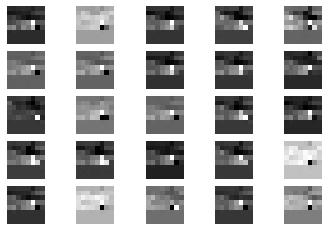

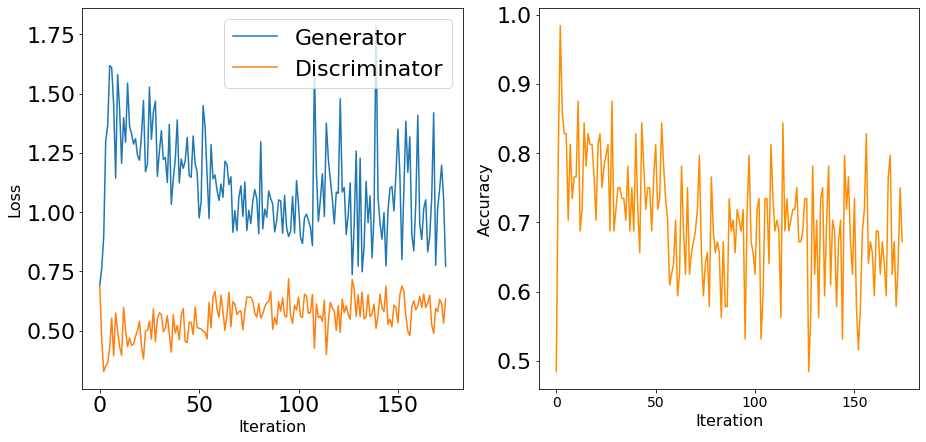

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17401 [D loss: 0.564993, acc.: 67.19%] [G loss: 1.081416]
17402 [D loss: 0.493476, acc.: 76.56%] [G loss: 1.447658]
17403 [D loss: 0.658516, acc.: 64.06%] [G loss: 0.816831]
17404 [D loss: 0.519798, acc.: 71.88%] [G loss: 1.262703]
17405 [D loss: 0.581226, acc.: 68.75%] [G loss: 1.105188]
17406 [D loss: 0.629548, acc.: 60.94%] [G loss: 0.892959]
17407 [D loss: 0.652428, acc.: 56.25%] [G loss: 0.796045]
17408 [D loss: 0.571340, acc.: 68.75%] [G loss: 1.021609]
17409 [D loss: 0.644818, acc.: 64.06%] [G loss: 1.034064]
17410 [D loss: 0.598091, acc.: 68.75%] [G loss: 0.982782]
17411 [D loss: 0.650118, acc.: 62.50%] [G loss: 0.835046]
17412 [D loss: 0.613234, acc.: 73.44%] [G loss: 0.840942]
17413 [D loss: 0.542999, acc.: 73.44%] [G loss: 1.017130]
17414 [D loss: 0.633392, acc.: 67.19%] [G loss: 0.987959]
17415 [D loss: 0.668213, acc.: 57.81%] [G loss: 0.900001]
17416 [D loss: 0.616716, acc.: 60.94%] [G loss: 0.881649]
17417 [D loss: 0.582022, acc.: 64.06%] [G loss: 0.977103]
17418 [D loss:

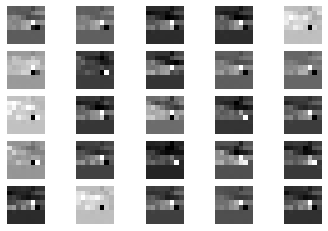

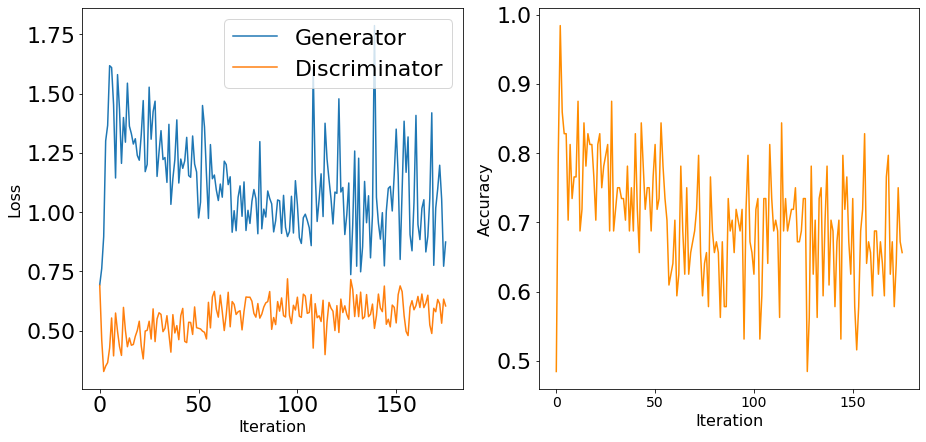

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17501 [D loss: 0.667601, acc.: 60.94%] [G loss: 0.886693]
17502 [D loss: 0.579986, acc.: 68.75%] [G loss: 0.855668]
17503 [D loss: 0.522901, acc.: 75.00%] [G loss: 0.995074]
17504 [D loss: 0.602431, acc.: 67.19%] [G loss: 0.922550]
17505 [D loss: 0.573445, acc.: 71.88%] [G loss: 0.888407]
17506 [D loss: 0.608049, acc.: 64.06%] [G loss: 0.927322]
17507 [D loss: 0.584261, acc.: 71.88%] [G loss: 0.967384]
17508 [D loss: 0.665620, acc.: 59.38%] [G loss: 0.923644]
17509 [D loss: 0.733630, acc.: 54.69%] [G loss: 0.892606]
17510 [D loss: 0.677658, acc.: 65.62%] [G loss: 0.922368]
17511 [D loss: 0.684156, acc.: 59.38%] [G loss: 0.828350]
17512 [D loss: 0.631251, acc.: 65.62%] [G loss: 0.888245]
17513 [D loss: 0.625432, acc.: 59.38%] [G loss: 0.882094]
17514 [D loss: 0.626338, acc.: 64.06%] [G loss: 0.996262]
17515 [D loss: 0.577703, acc.: 64.06%] [G loss: 1.027786]
17516 [D loss: 0.634266, acc.: 62.50%] [G loss: 1.082821]
17517 [D loss: 0.536050, acc.: 71.88%] [G loss: 1.225165]
17518 [D loss:

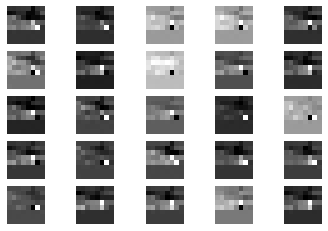

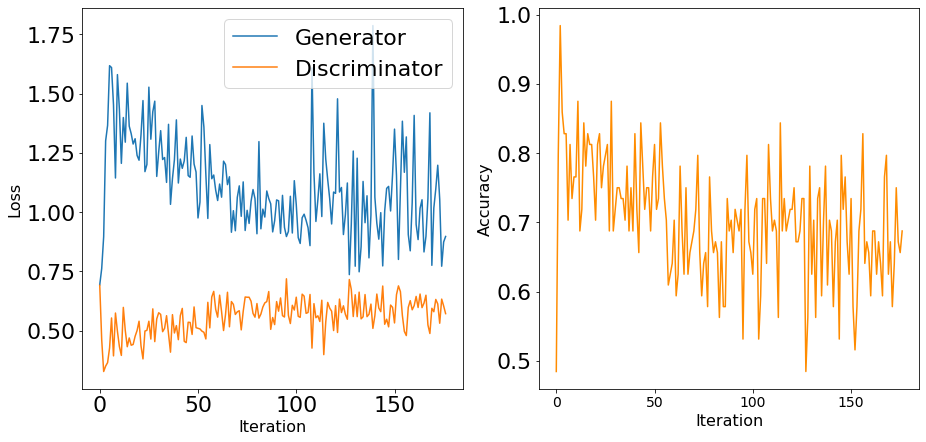

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17601 [D loss: 0.675700, acc.: 54.69%] [G loss: 0.815367]
17602 [D loss: 0.697497, acc.: 53.12%] [G loss: 0.923041]
17603 [D loss: 0.536150, acc.: 79.69%] [G loss: 1.083225]
17604 [D loss: 0.586723, acc.: 68.75%] [G loss: 1.207573]
17605 [D loss: 0.620013, acc.: 67.19%] [G loss: 0.917099]
17606 [D loss: 0.596803, acc.: 64.06%] [G loss: 0.927986]
17607 [D loss: 0.653648, acc.: 56.25%] [G loss: 0.819142]
17608 [D loss: 0.607751, acc.: 65.62%] [G loss: 1.052262]
17609 [D loss: 0.561690, acc.: 76.56%] [G loss: 1.303242]
17610 [D loss: 0.700229, acc.: 59.38%] [G loss: 0.881055]
17611 [D loss: 0.614814, acc.: 65.62%] [G loss: 0.905238]
17612 [D loss: 0.648649, acc.: 64.06%] [G loss: 1.017724]
17613 [D loss: 0.571718, acc.: 65.62%] [G loss: 1.252878]
17614 [D loss: 0.561748, acc.: 70.31%] [G loss: 1.186803]
17615 [D loss: 0.592485, acc.: 70.31%] [G loss: 0.988610]
17616 [D loss: 0.644150, acc.: 67.19%] [G loss: 1.105684]
17617 [D loss: 0.553763, acc.: 70.31%] [G loss: 0.979537]
17618 [D loss:

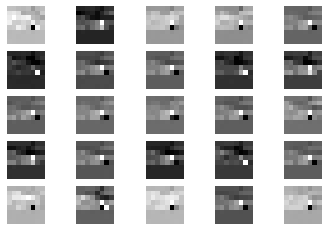

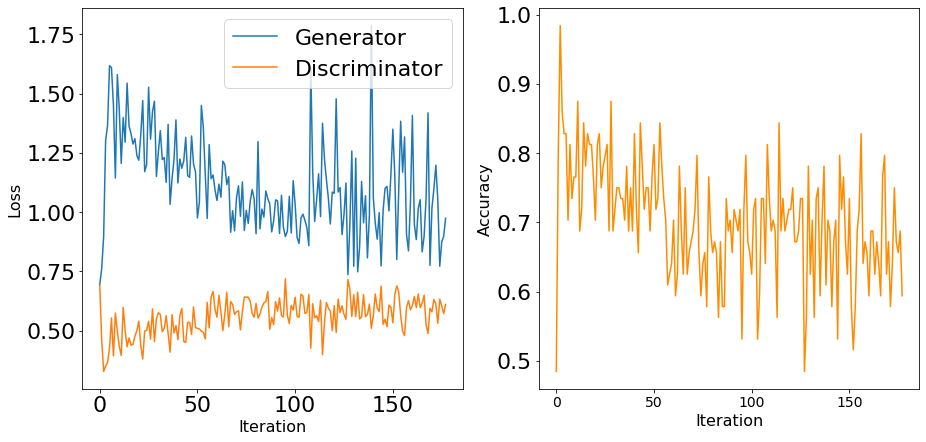

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17701 [D loss: 0.571029, acc.: 71.88%] [G loss: 1.173427]
17702 [D loss: 0.627227, acc.: 56.25%] [G loss: 1.010983]
17703 [D loss: 0.671546, acc.: 54.69%] [G loss: 0.919023]
17704 [D loss: 0.591160, acc.: 60.94%] [G loss: 0.946135]
17705 [D loss: 0.711303, acc.: 54.69%] [G loss: 0.782687]
17706 [D loss: 0.562671, acc.: 81.25%] [G loss: 0.740010]
17707 [D loss: 0.654332, acc.: 57.81%] [G loss: 0.695738]
17708 [D loss: 0.568620, acc.: 71.88%] [G loss: 1.141478]
17709 [D loss: 0.523484, acc.: 75.00%] [G loss: 1.307130]
17710 [D loss: 0.556113, acc.: 73.44%] [G loss: 1.041230]
17711 [D loss: 0.580728, acc.: 65.62%] [G loss: 0.940786]
17712 [D loss: 0.656703, acc.: 54.69%] [G loss: 0.952153]
17713 [D loss: 0.581932, acc.: 65.62%] [G loss: 0.994484]
17714 [D loss: 0.584320, acc.: 60.94%] [G loss: 1.114127]
17715 [D loss: 0.641828, acc.: 57.81%] [G loss: 0.985258]
17716 [D loss: 0.612756, acc.: 64.06%] [G loss: 1.198005]
17717 [D loss: 0.594202, acc.: 65.62%] [G loss: 1.210564]
17718 [D loss:

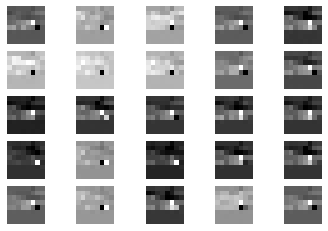

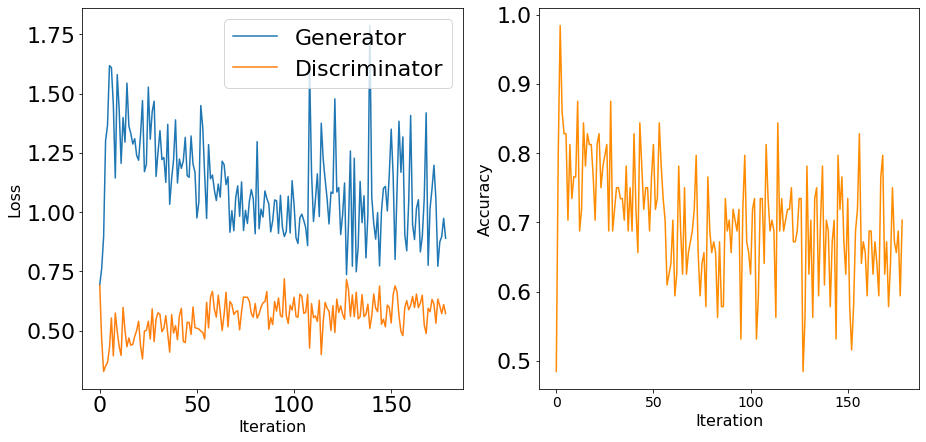

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17801 [D loss: 0.695109, acc.: 56.25%] [G loss: 0.827143]
17802 [D loss: 0.612622, acc.: 67.19%] [G loss: 0.864026]
17803 [D loss: 0.665806, acc.: 60.94%] [G loss: 0.805414]
17804 [D loss: 0.545231, acc.: 75.00%] [G loss: 1.130015]
17805 [D loss: 0.629296, acc.: 64.06%] [G loss: 0.830218]
17806 [D loss: 0.581670, acc.: 68.75%] [G loss: 0.861640]
17807 [D loss: 0.659131, acc.: 57.81%] [G loss: 0.757499]
17808 [D loss: 0.692595, acc.: 57.81%] [G loss: 0.891371]
17809 [D loss: 0.531296, acc.: 73.44%] [G loss: 1.010813]
17810 [D loss: 0.597213, acc.: 70.31%] [G loss: 1.118988]
17811 [D loss: 0.548373, acc.: 73.44%] [G loss: 1.189886]
17812 [D loss: 0.537049, acc.: 71.88%] [G loss: 1.029807]
17813 [D loss: 0.604651, acc.: 67.19%] [G loss: 0.980542]
17814 [D loss: 0.571271, acc.: 67.19%] [G loss: 1.285688]
17815 [D loss: 0.575452, acc.: 65.62%] [G loss: 1.205353]
17816 [D loss: 0.591585, acc.: 70.31%] [G loss: 0.953320]
17817 [D loss: 0.558574, acc.: 75.00%] [G loss: 1.035541]
17818 [D loss:

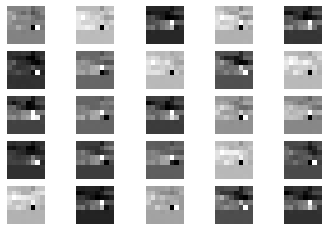

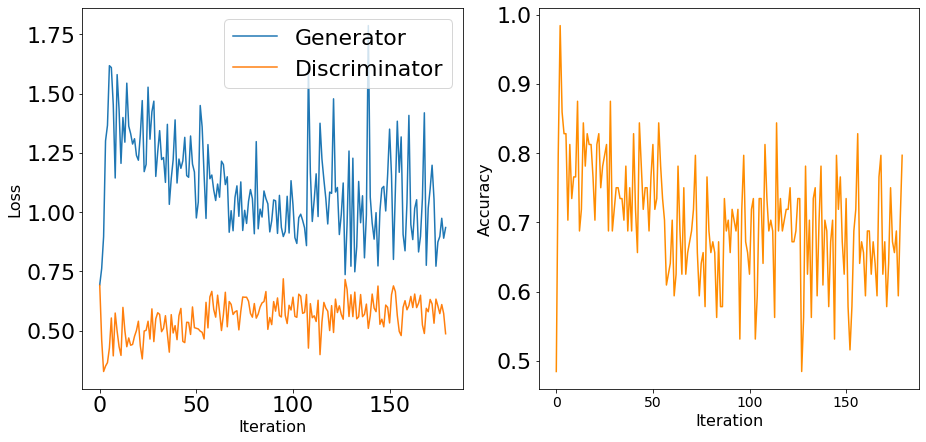

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


17901 [D loss: 0.571006, acc.: 73.44%] [G loss: 0.812409]
17902 [D loss: 0.634215, acc.: 62.50%] [G loss: 0.850670]
17903 [D loss: 0.702113, acc.: 65.62%] [G loss: 0.758406]
17904 [D loss: 0.608068, acc.: 57.81%] [G loss: 0.920070]
17905 [D loss: 0.652571, acc.: 59.38%] [G loss: 0.911340]
17906 [D loss: 0.633668, acc.: 62.50%] [G loss: 0.911076]
17907 [D loss: 0.552140, acc.: 71.88%] [G loss: 1.125463]
17908 [D loss: 0.602141, acc.: 62.50%] [G loss: 1.269058]
17909 [D loss: 0.628713, acc.: 59.38%] [G loss: 0.961164]
17910 [D loss: 0.653441, acc.: 60.94%] [G loss: 0.922413]
17911 [D loss: 0.565907, acc.: 68.75%] [G loss: 1.581153]
17912 [D loss: 0.503856, acc.: 68.75%] [G loss: 1.147748]
17913 [D loss: 0.596760, acc.: 71.88%] [G loss: 0.769152]
17914 [D loss: 0.603836, acc.: 65.62%] [G loss: 0.927401]
17915 [D loss: 0.569217, acc.: 70.31%] [G loss: 1.112008]
17916 [D loss: 0.497435, acc.: 76.56%] [G loss: 1.516427]
17917 [D loss: 0.622534, acc.: 65.62%] [G loss: 1.046991]
17918 [D loss:

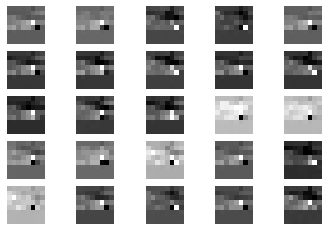

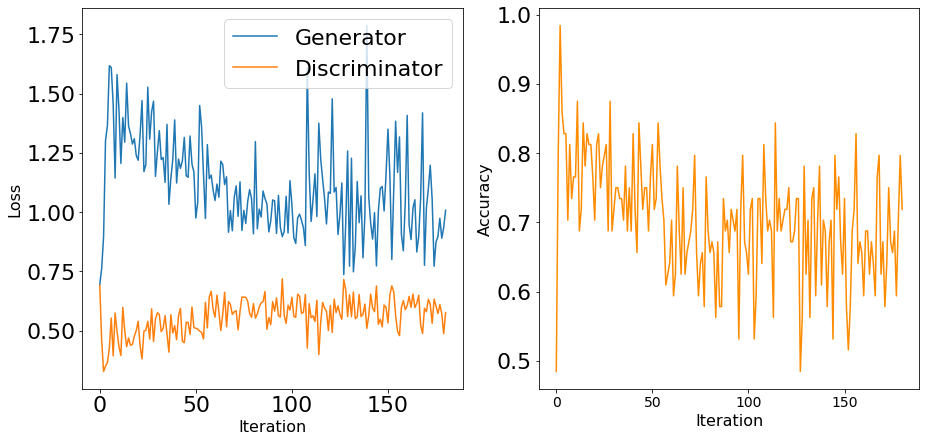

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18001 [D loss: 0.534489, acc.: 70.31%] [G loss: 0.956634]
18002 [D loss: 0.613451, acc.: 62.50%] [G loss: 0.954092]
18003 [D loss: 0.688936, acc.: 54.69%] [G loss: 0.930693]
18004 [D loss: 0.624949, acc.: 65.62%] [G loss: 0.951802]
18005 [D loss: 0.573553, acc.: 68.75%] [G loss: 0.878536]
18006 [D loss: 0.577362, acc.: 71.88%] [G loss: 0.882065]
18007 [D loss: 0.553464, acc.: 70.31%] [G loss: 1.077940]
18008 [D loss: 0.457153, acc.: 85.94%] [G loss: 1.000151]
18009 [D loss: 0.529559, acc.: 73.44%] [G loss: 1.331396]
18010 [D loss: 0.588897, acc.: 71.88%] [G loss: 1.409941]
18011 [D loss: 0.512747, acc.: 78.12%] [G loss: 0.944719]
18012 [D loss: 0.627651, acc.: 65.62%] [G loss: 0.911540]
18013 [D loss: 0.557148, acc.: 68.75%] [G loss: 1.294837]
18014 [D loss: 0.594899, acc.: 64.06%] [G loss: 1.111439]
18015 [D loss: 0.541179, acc.: 68.75%] [G loss: 1.387191]
18016 [D loss: 0.546805, acc.: 78.12%] [G loss: 0.971581]
18017 [D loss: 0.635764, acc.: 70.31%] [G loss: 0.883266]
18018 [D loss:

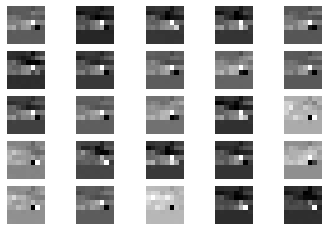

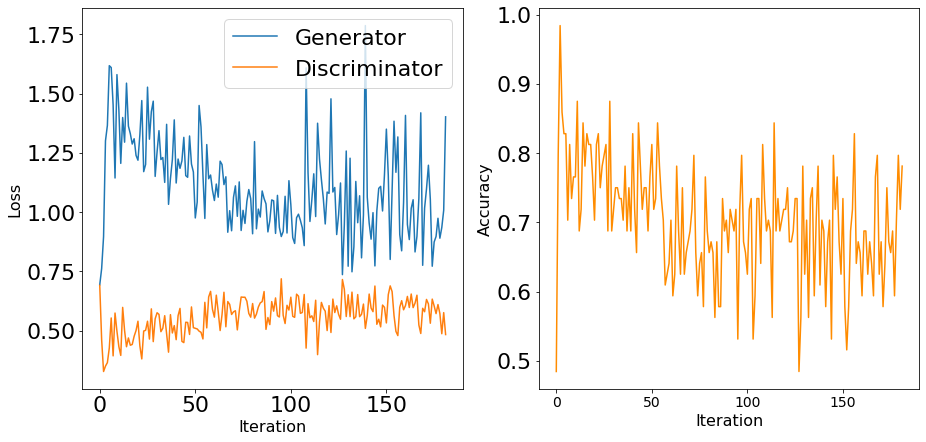

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18101 [D loss: 0.549371, acc.: 75.00%] [G loss: 1.327271]
18102 [D loss: 0.574066, acc.: 70.31%] [G loss: 0.901573]
18103 [D loss: 0.555931, acc.: 76.56%] [G loss: 0.991724]
18104 [D loss: 0.590946, acc.: 62.50%] [G loss: 1.086476]
18105 [D loss: 0.640477, acc.: 62.50%] [G loss: 0.879564]
18106 [D loss: 0.575124, acc.: 67.19%] [G loss: 0.798991]
18107 [D loss: 0.622891, acc.: 68.75%] [G loss: 0.816553]
18108 [D loss: 0.555535, acc.: 67.19%] [G loss: 0.774131]
18109 [D loss: 0.657787, acc.: 60.94%] [G loss: 0.989657]
18110 [D loss: 0.713483, acc.: 53.12%] [G loss: 0.795651]
18111 [D loss: 0.635351, acc.: 59.38%] [G loss: 1.127981]
18112 [D loss: 0.556497, acc.: 76.56%] [G loss: 1.054099]
18113 [D loss: 0.560150, acc.: 71.88%] [G loss: 1.119940]
18114 [D loss: 0.575826, acc.: 67.19%] [G loss: 1.530063]
18115 [D loss: 0.577144, acc.: 71.88%] [G loss: 1.047789]
18116 [D loss: 0.573861, acc.: 67.19%] [G loss: 0.907705]
18117 [D loss: 0.570522, acc.: 73.44%] [G loss: 0.878414]
18118 [D loss:

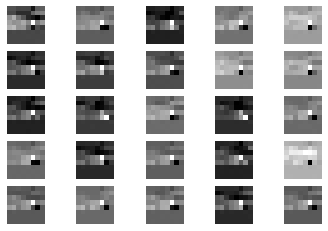

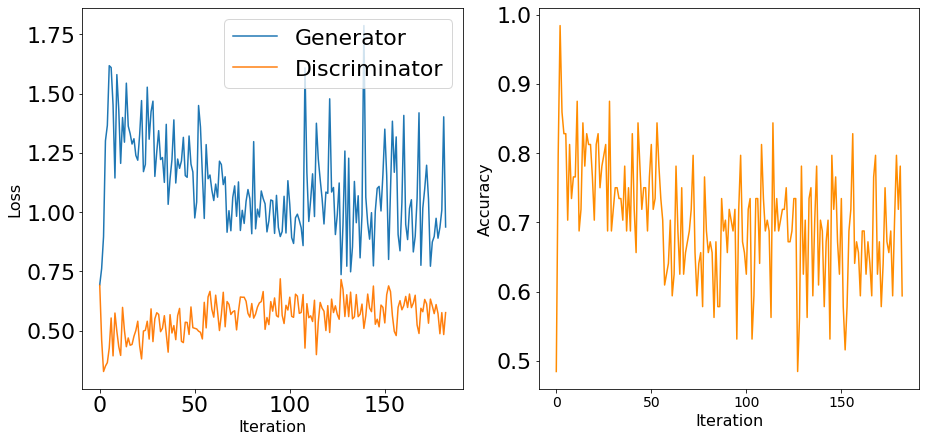

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18201 [D loss: 0.586950, acc.: 67.19%] [G loss: 1.029317]
18202 [D loss: 0.591702, acc.: 75.00%] [G loss: 0.936614]
18203 [D loss: 0.553405, acc.: 68.75%] [G loss: 1.202275]
18204 [D loss: 0.557790, acc.: 71.88%] [G loss: 1.104432]
18205 [D loss: 0.555903, acc.: 76.56%] [G loss: 1.259225]
18206 [D loss: 0.528782, acc.: 75.00%] [G loss: 0.947863]
18207 [D loss: 0.652917, acc.: 59.38%] [G loss: 0.884614]
18208 [D loss: 0.591493, acc.: 65.62%] [G loss: 0.864017]
18209 [D loss: 0.577647, acc.: 76.56%] [G loss: 0.818096]
18210 [D loss: 0.572713, acc.: 67.19%] [G loss: 0.919245]
18211 [D loss: 0.581159, acc.: 67.19%] [G loss: 1.022028]
18212 [D loss: 0.583573, acc.: 65.62%] [G loss: 0.994056]
18213 [D loss: 0.563717, acc.: 65.62%] [G loss: 1.009487]
18214 [D loss: 0.628252, acc.: 60.94%] [G loss: 0.886948]
18215 [D loss: 0.576552, acc.: 70.31%] [G loss: 0.836453]
18216 [D loss: 0.619178, acc.: 62.50%] [G loss: 1.019894]
18217 [D loss: 0.617442, acc.: 68.75%] [G loss: 0.952367]
18218 [D loss:

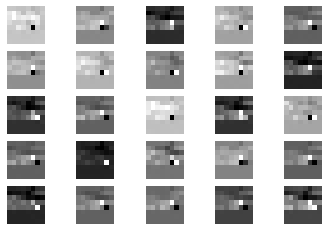

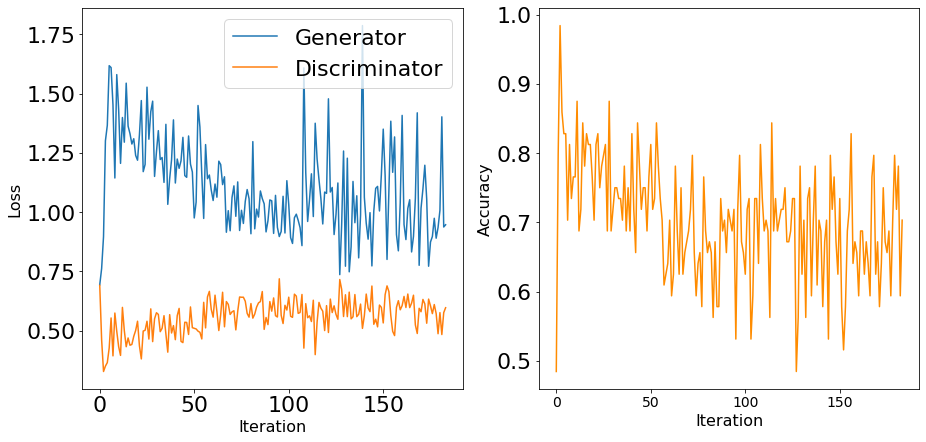

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18301 [D loss: 0.674913, acc.: 48.44%] [G loss: 0.943897]
18302 [D loss: 0.592307, acc.: 70.31%] [G loss: 0.965809]
18303 [D loss: 0.543192, acc.: 70.31%] [G loss: 1.351995]
18304 [D loss: 0.583760, acc.: 68.75%] [G loss: 0.873994]
18305 [D loss: 0.582718, acc.: 68.75%] [G loss: 0.918793]
18306 [D loss: 0.560968, acc.: 68.75%] [G loss: 1.115694]
18307 [D loss: 0.675123, acc.: 56.25%] [G loss: 0.746408]
18308 [D loss: 0.541054, acc.: 67.19%] [G loss: 1.085213]
18309 [D loss: 0.480257, acc.: 75.00%] [G loss: 1.674677]
18310 [D loss: 0.535350, acc.: 68.75%] [G loss: 1.070800]
18311 [D loss: 0.591756, acc.: 67.19%] [G loss: 0.853592]
18312 [D loss: 0.575400, acc.: 68.75%] [G loss: 1.026444]
18313 [D loss: 0.635129, acc.: 65.62%] [G loss: 0.888978]
18314 [D loss: 0.601393, acc.: 70.31%] [G loss: 0.750873]
18315 [D loss: 0.698187, acc.: 56.25%] [G loss: 0.770707]
18316 [D loss: 0.651834, acc.: 65.62%] [G loss: 0.944531]
18317 [D loss: 0.483221, acc.: 76.56%] [G loss: 1.527966]
18318 [D loss:

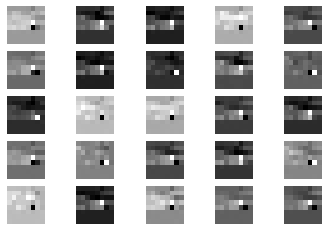

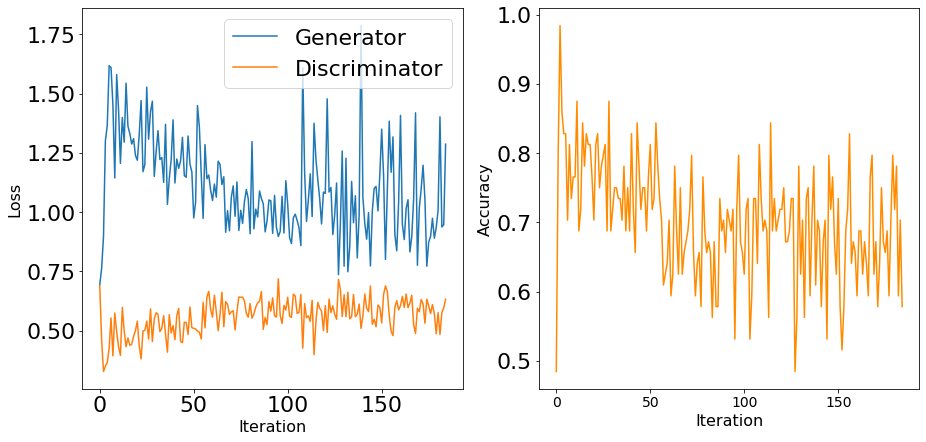

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18401 [D loss: 0.635525, acc.: 65.62%] [G loss: 1.025207]
18402 [D loss: 0.640928, acc.: 65.62%] [G loss: 0.906412]
18403 [D loss: 0.649898, acc.: 57.81%] [G loss: 0.949106]
18404 [D loss: 0.637952, acc.: 64.06%] [G loss: 1.015678]
18405 [D loss: 0.536060, acc.: 68.75%] [G loss: 1.577691]
18406 [D loss: 0.649328, acc.: 65.62%] [G loss: 0.984779]
18407 [D loss: 0.642202, acc.: 60.94%] [G loss: 0.840297]
18408 [D loss: 0.525397, acc.: 73.44%] [G loss: 1.121129]
18409 [D loss: 0.549553, acc.: 73.44%] [G loss: 0.964551]
18410 [D loss: 0.528596, acc.: 81.25%] [G loss: 1.041522]
18411 [D loss: 0.639210, acc.: 56.25%] [G loss: 0.987205]
18412 [D loss: 0.600659, acc.: 65.62%] [G loss: 1.060469]
18413 [D loss: 0.544738, acc.: 64.06%] [G loss: 1.517880]
18414 [D loss: 0.600562, acc.: 70.31%] [G loss: 1.177933]
18415 [D loss: 0.521587, acc.: 65.62%] [G loss: 1.274959]
18416 [D loss: 0.577043, acc.: 65.62%] [G loss: 1.079553]
18417 [D loss: 0.562648, acc.: 70.31%] [G loss: 1.289706]
18418 [D loss:

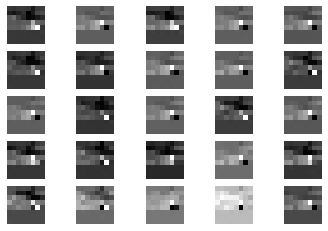

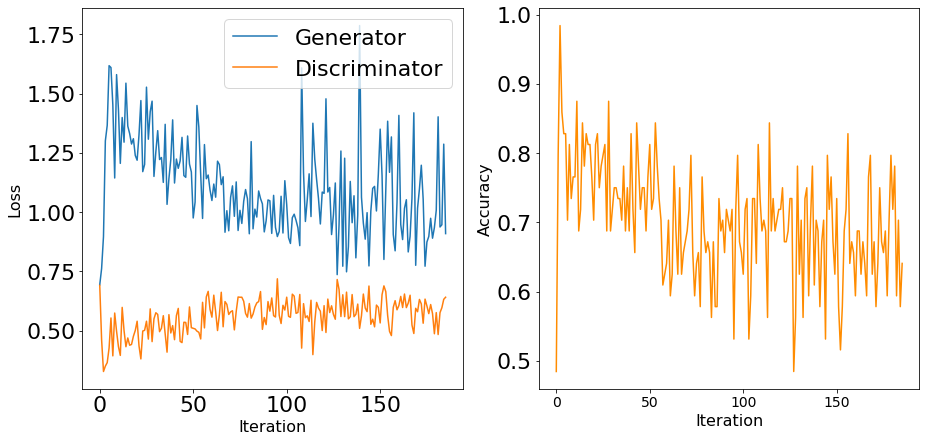

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18501 [D loss: 0.640350, acc.: 67.19%] [G loss: 0.924698]
18502 [D loss: 0.602791, acc.: 65.62%] [G loss: 0.982438]
18503 [D loss: 0.493870, acc.: 71.88%] [G loss: 1.325536]
18504 [D loss: 0.622896, acc.: 57.81%] [G loss: 1.203694]
18505 [D loss: 0.577762, acc.: 73.44%] [G loss: 0.918294]
18506 [D loss: 0.596897, acc.: 70.31%] [G loss: 0.750420]
18507 [D loss: 0.677516, acc.: 64.06%] [G loss: 0.948993]
18508 [D loss: 0.530669, acc.: 70.31%] [G loss: 1.286679]
18509 [D loss: 0.582954, acc.: 68.75%] [G loss: 1.042552]
18510 [D loss: 0.574219, acc.: 70.31%] [G loss: 1.228594]
18511 [D loss: 0.519478, acc.: 70.31%] [G loss: 1.284388]
18512 [D loss: 0.605254, acc.: 71.88%] [G loss: 0.922411]
18513 [D loss: 0.577235, acc.: 75.00%] [G loss: 0.901156]
18514 [D loss: 0.681481, acc.: 59.38%] [G loss: 0.864126]
18515 [D loss: 0.647311, acc.: 62.50%] [G loss: 1.002146]
18516 [D loss: 0.553657, acc.: 64.06%] [G loss: 1.228639]
18517 [D loss: 0.624972, acc.: 59.38%] [G loss: 0.735879]
18518 [D loss:

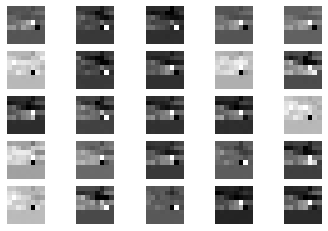

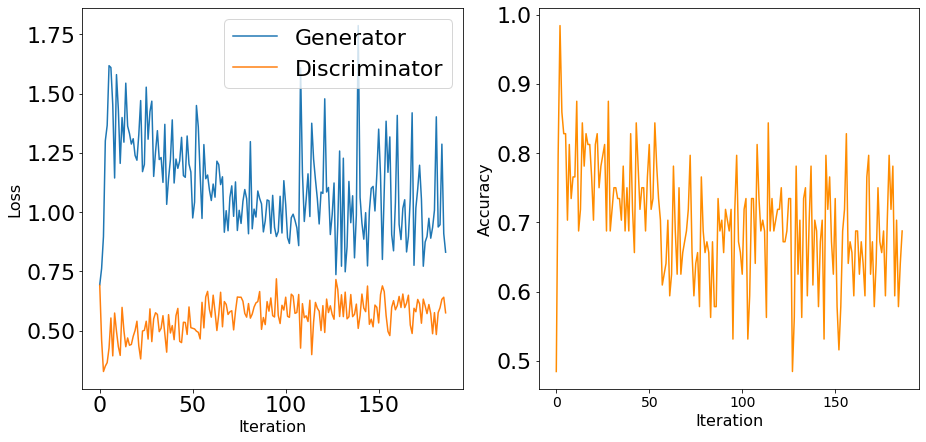

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18601 [D loss: 0.649518, acc.: 60.94%] [G loss: 1.035588]
18602 [D loss: 0.638055, acc.: 67.19%] [G loss: 0.920897]
18603 [D loss: 0.629283, acc.: 62.50%] [G loss: 0.915256]
18604 [D loss: 0.657956, acc.: 59.38%] [G loss: 0.880821]
18605 [D loss: 0.575236, acc.: 62.50%] [G loss: 1.004925]
18606 [D loss: 0.590299, acc.: 64.06%] [G loss: 1.070304]
18607 [D loss: 0.743499, acc.: 46.88%] [G loss: 0.913125]
18608 [D loss: 0.700072, acc.: 57.81%] [G loss: 0.826614]
18609 [D loss: 0.679356, acc.: 64.06%] [G loss: 0.692512]
18610 [D loss: 0.670504, acc.: 67.19%] [G loss: 0.880012]
18611 [D loss: 0.610498, acc.: 70.31%] [G loss: 0.939142]
18612 [D loss: 0.503919, acc.: 71.88%] [G loss: 1.516264]
18613 [D loss: 0.536165, acc.: 70.31%] [G loss: 1.300977]
18614 [D loss: 0.626242, acc.: 68.75%] [G loss: 0.866235]
18615 [D loss: 0.507993, acc.: 76.56%] [G loss: 1.490378]
18616 [D loss: 0.586628, acc.: 64.06%] [G loss: 0.811785]
18617 [D loss: 0.716474, acc.: 57.81%] [G loss: 0.846055]
18618 [D loss:

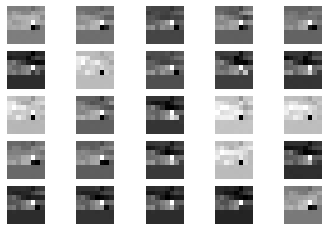

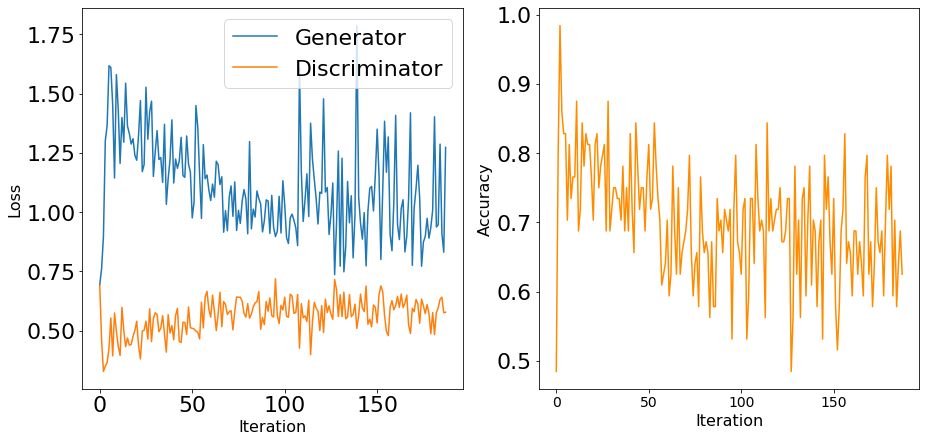

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18701 [D loss: 0.628393, acc.: 65.62%] [G loss: 0.972711]
18702 [D loss: 0.483844, acc.: 73.44%] [G loss: 1.103703]
18703 [D loss: 0.595322, acc.: 67.19%] [G loss: 1.547353]
18704 [D loss: 0.493004, acc.: 71.88%] [G loss: 1.782759]
18705 [D loss: 0.601974, acc.: 59.38%] [G loss: 0.888908]
18706 [D loss: 0.518838, acc.: 76.56%] [G loss: 1.142202]
18707 [D loss: 0.521073, acc.: 79.69%] [G loss: 0.953281]
18708 [D loss: 0.568202, acc.: 73.44%] [G loss: 0.929513]
18709 [D loss: 0.572658, acc.: 70.31%] [G loss: 0.814893]
18710 [D loss: 0.633997, acc.: 64.06%] [G loss: 0.912508]
18711 [D loss: 0.644841, acc.: 54.69%] [G loss: 1.251317]
18712 [D loss: 0.495453, acc.: 76.56%] [G loss: 1.488797]
18713 [D loss: 0.634221, acc.: 67.19%] [G loss: 0.905638]
18714 [D loss: 0.587363, acc.: 65.62%] [G loss: 1.009419]
18715 [D loss: 0.508803, acc.: 76.56%] [G loss: 1.227726]
18716 [D loss: 0.568365, acc.: 78.12%] [G loss: 1.292314]
18717 [D loss: 0.619763, acc.: 65.62%] [G loss: 1.017559]
18718 [D loss:

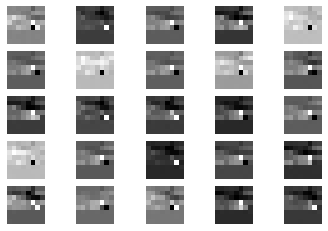

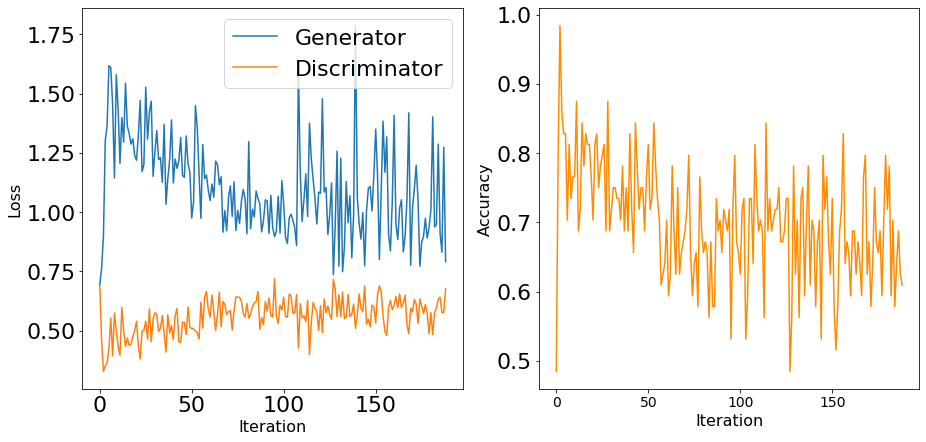

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18801 [D loss: 0.633457, acc.: 70.31%] [G loss: 0.898390]
18802 [D loss: 0.631506, acc.: 65.62%] [G loss: 1.161450]
18803 [D loss: 0.529713, acc.: 76.56%] [G loss: 1.102815]
18804 [D loss: 0.607614, acc.: 67.19%] [G loss: 0.909716]
18805 [D loss: 0.636853, acc.: 59.38%] [G loss: 0.784800]
18806 [D loss: 0.604900, acc.: 70.31%] [G loss: 0.824932]
18807 [D loss: 0.603585, acc.: 68.75%] [G loss: 0.909802]
18808 [D loss: 0.612014, acc.: 68.75%] [G loss: 0.923528]
18809 [D loss: 0.658064, acc.: 53.12%] [G loss: 0.941914]
18810 [D loss: 0.592441, acc.: 70.31%] [G loss: 0.980519]
18811 [D loss: 0.561180, acc.: 71.88%] [G loss: 1.163329]
18812 [D loss: 0.630496, acc.: 57.81%] [G loss: 0.911569]
18813 [D loss: 0.552982, acc.: 67.19%] [G loss: 1.018993]
18814 [D loss: 0.508797, acc.: 76.56%] [G loss: 1.312491]
18815 [D loss: 0.555089, acc.: 68.75%] [G loss: 1.886058]
18816 [D loss: 0.592815, acc.: 70.31%] [G loss: 1.169607]
18817 [D loss: 0.551216, acc.: 73.44%] [G loss: 1.102010]
18818 [D loss:

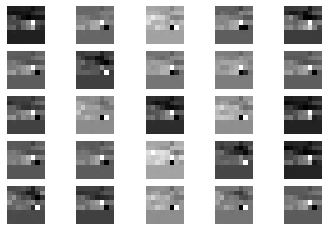

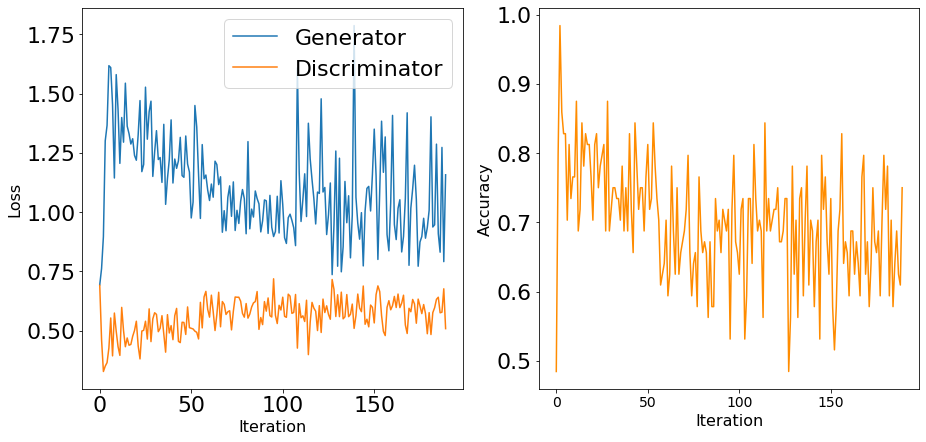

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


18901 [D loss: 0.565400, acc.: 67.19%] [G loss: 0.960110]
18902 [D loss: 0.576019, acc.: 76.56%] [G loss: 0.911806]
18903 [D loss: 0.486699, acc.: 79.69%] [G loss: 1.602144]
18904 [D loss: 0.573796, acc.: 70.31%] [G loss: 1.098416]
18905 [D loss: 0.624026, acc.: 64.06%] [G loss: 1.081479]
18906 [D loss: 0.586105, acc.: 71.88%] [G loss: 0.910792]
18907 [D loss: 0.599007, acc.: 67.19%] [G loss: 0.733450]
18908 [D loss: 0.678099, acc.: 59.38%] [G loss: 1.044829]
18909 [D loss: 0.510324, acc.: 76.56%] [G loss: 0.927146]
18910 [D loss: 0.595274, acc.: 70.31%] [G loss: 0.978734]
18911 [D loss: 0.690869, acc.: 57.81%] [G loss: 0.791176]
18912 [D loss: 0.594518, acc.: 65.62%] [G loss: 1.198496]
18913 [D loss: 0.594302, acc.: 60.94%] [G loss: 1.157887]
18914 [D loss: 0.657091, acc.: 59.38%] [G loss: 0.966763]
18915 [D loss: 0.499461, acc.: 75.00%] [G loss: 1.517276]
18916 [D loss: 0.571084, acc.: 70.31%] [G loss: 1.843506]
18917 [D loss: 0.592075, acc.: 67.19%] [G loss: 1.019666]
18918 [D loss:

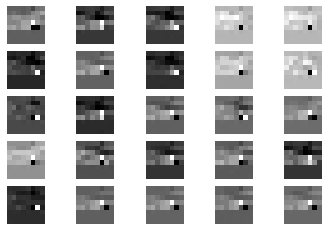

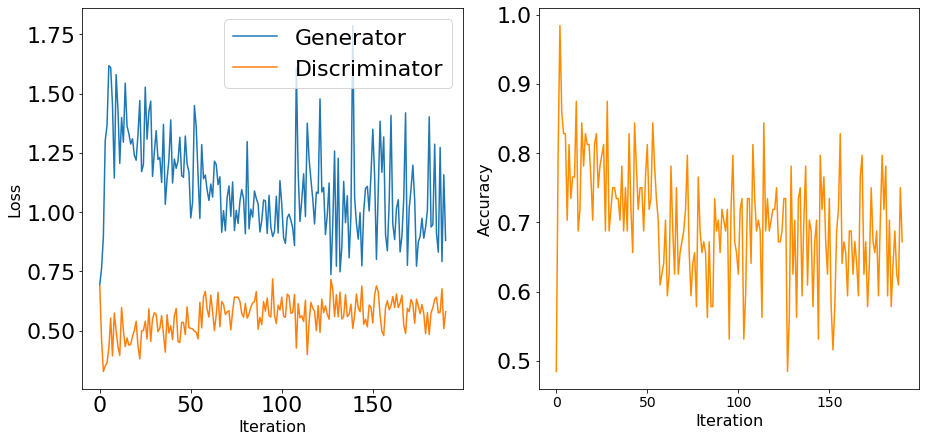

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19001 [D loss: 0.624220, acc.: 57.81%] [G loss: 1.379709]
19002 [D loss: 0.654051, acc.: 60.94%] [G loss: 0.762600]
19003 [D loss: 0.573189, acc.: 70.31%] [G loss: 0.794215]
19004 [D loss: 0.539407, acc.: 73.44%] [G loss: 0.803552]
19005 [D loss: 0.730611, acc.: 57.81%] [G loss: 0.873539]
19006 [D loss: 0.617492, acc.: 64.06%] [G loss: 0.847047]
19007 [D loss: 0.536766, acc.: 78.12%] [G loss: 0.892079]
19008 [D loss: 0.612545, acc.: 64.06%] [G loss: 0.940691]
19009 [D loss: 0.590786, acc.: 67.19%] [G loss: 1.166024]
19010 [D loss: 0.561929, acc.: 65.62%] [G loss: 1.452479]
19011 [D loss: 0.546764, acc.: 75.00%] [G loss: 1.308918]
19012 [D loss: 0.684279, acc.: 51.56%] [G loss: 0.948693]
19013 [D loss: 0.527976, acc.: 67.19%] [G loss: 1.162524]
19014 [D loss: 0.607498, acc.: 68.75%] [G loss: 1.183911]
19015 [D loss: 0.559594, acc.: 70.31%] [G loss: 1.052362]
19016 [D loss: 0.543483, acc.: 70.31%] [G loss: 1.099233]
19017 [D loss: 0.545359, acc.: 71.88%] [G loss: 0.839558]
19018 [D loss:

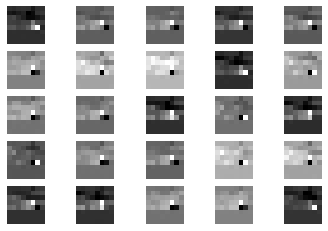

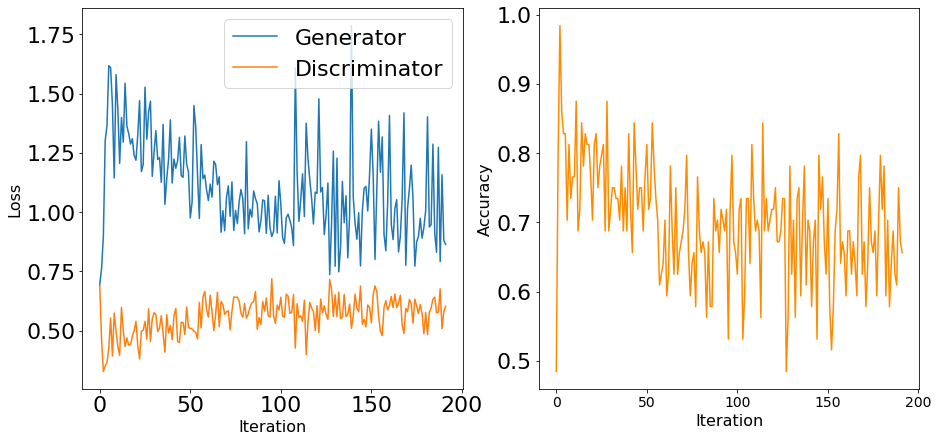

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19101 [D loss: 0.604700, acc.: 65.62%] [G loss: 0.986177]
19102 [D loss: 0.610564, acc.: 65.62%] [G loss: 0.912491]
19103 [D loss: 0.642605, acc.: 65.62%] [G loss: 0.796414]
19104 [D loss: 0.636597, acc.: 64.06%] [G loss: 0.943552]
19105 [D loss: 0.593439, acc.: 64.06%] [G loss: 0.917432]
19106 [D loss: 0.505089, acc.: 79.69%] [G loss: 1.063630]
19107 [D loss: 0.584501, acc.: 68.75%] [G loss: 1.425984]
19108 [D loss: 0.637857, acc.: 65.62%] [G loss: 1.032933]
19109 [D loss: 0.611905, acc.: 67.19%] [G loss: 0.956654]
19110 [D loss: 0.679511, acc.: 54.69%] [G loss: 0.959284]
19111 [D loss: 0.620837, acc.: 62.50%] [G loss: 0.923392]
19112 [D loss: 0.607027, acc.: 65.62%] [G loss: 1.013372]
19113 [D loss: 0.612377, acc.: 64.06%] [G loss: 1.587586]
19114 [D loss: 0.512462, acc.: 73.44%] [G loss: 1.555432]
19115 [D loss: 0.577297, acc.: 71.88%] [G loss: 0.990508]
19116 [D loss: 0.595536, acc.: 67.19%] [G loss: 1.023249]
19117 [D loss: 0.539844, acc.: 73.44%] [G loss: 0.969916]
19118 [D loss:

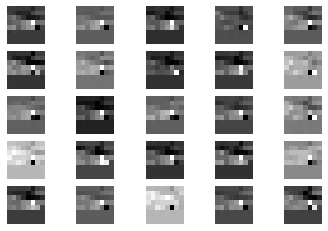

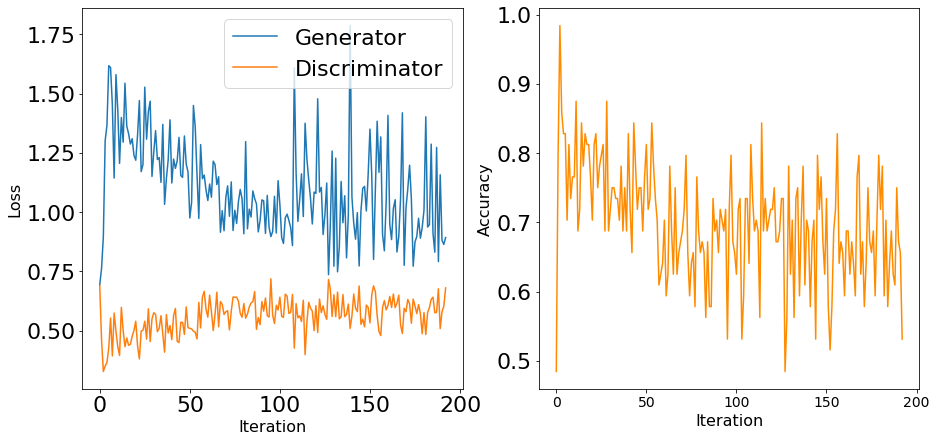

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19201 [D loss: 0.491666, acc.: 78.12%] [G loss: 1.259538]
19202 [D loss: 0.599570, acc.: 67.19%] [G loss: 1.118163]
19203 [D loss: 0.613073, acc.: 71.88%] [G loss: 0.994823]
19204 [D loss: 0.601716, acc.: 62.50%] [G loss: 1.171443]
19205 [D loss: 0.505308, acc.: 85.94%] [G loss: 1.113932]
19206 [D loss: 0.648228, acc.: 57.81%] [G loss: 0.869878]
19207 [D loss: 0.569454, acc.: 68.75%] [G loss: 0.795945]
19208 [D loss: 0.582518, acc.: 71.88%] [G loss: 1.129297]
19209 [D loss: 0.555692, acc.: 68.75%] [G loss: 0.956452]
19210 [D loss: 0.656798, acc.: 62.50%] [G loss: 0.816645]
19211 [D loss: 0.564451, acc.: 67.19%] [G loss: 0.925471]
19212 [D loss: 0.526537, acc.: 76.56%] [G loss: 1.232660]
19213 [D loss: 0.635286, acc.: 57.81%] [G loss: 1.050673]
19214 [D loss: 0.639013, acc.: 64.06%] [G loss: 0.967954]
19215 [D loss: 0.553398, acc.: 64.06%] [G loss: 1.145934]
19216 [D loss: 0.527163, acc.: 73.44%] [G loss: 1.012803]
19217 [D loss: 0.556938, acc.: 79.69%] [G loss: 0.977831]
19218 [D loss:

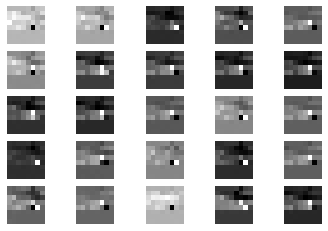

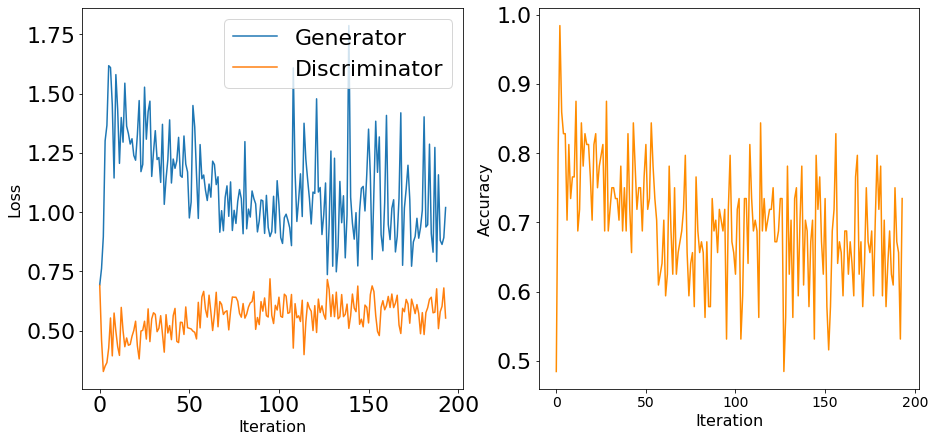

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19301 [D loss: 0.599053, acc.: 57.81%] [G loss: 0.949428]
19302 [D loss: 0.568094, acc.: 68.75%] [G loss: 0.956943]
19303 [D loss: 0.580825, acc.: 67.19%] [G loss: 0.864400]
19304 [D loss: 0.586343, acc.: 65.62%] [G loss: 1.148926]
19305 [D loss: 0.554649, acc.: 76.56%] [G loss: 1.103195]
19306 [D loss: 0.691229, acc.: 56.25%] [G loss: 0.941663]
19307 [D loss: 0.621883, acc.: 65.62%] [G loss: 0.918181]
19308 [D loss: 0.680995, acc.: 59.38%] [G loss: 0.870925]
19309 [D loss: 0.714336, acc.: 53.12%] [G loss: 0.744667]
19310 [D loss: 0.668256, acc.: 59.38%] [G loss: 0.869037]
19311 [D loss: 0.583649, acc.: 71.88%] [G loss: 1.039163]
19312 [D loss: 0.527233, acc.: 76.56%] [G loss: 1.225541]
19313 [D loss: 0.658006, acc.: 65.62%] [G loss: 0.810960]
19314 [D loss: 0.640786, acc.: 64.06%] [G loss: 0.959480]
19315 [D loss: 0.540027, acc.: 73.44%] [G loss: 1.183359]
19316 [D loss: 0.542784, acc.: 73.44%] [G loss: 1.080250]
19317 [D loss: 0.555685, acc.: 73.44%] [G loss: 1.406514]
19318 [D loss:

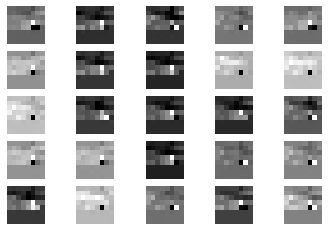

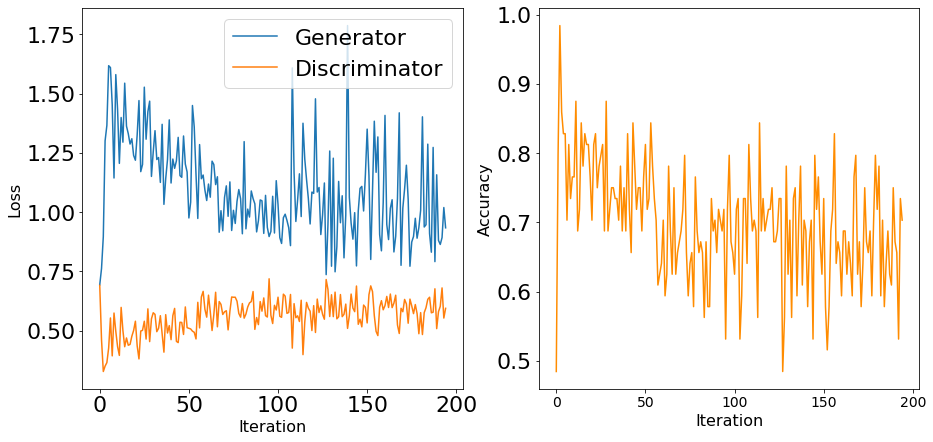

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19401 [D loss: 0.582260, acc.: 71.88%] [G loss: 1.179746]
19402 [D loss: 0.545466, acc.: 73.44%] [G loss: 1.146729]
19403 [D loss: 0.608312, acc.: 67.19%] [G loss: 1.165129]
19404 [D loss: 0.576432, acc.: 73.44%] [G loss: 1.082741]
19405 [D loss: 0.542487, acc.: 67.19%] [G loss: 0.881112]
19406 [D loss: 0.628867, acc.: 68.75%] [G loss: 0.992632]
19407 [D loss: 0.573440, acc.: 60.94%] [G loss: 1.227150]
19408 [D loss: 0.492940, acc.: 78.12%] [G loss: 1.281325]
19409 [D loss: 0.516695, acc.: 75.00%] [G loss: 1.702498]
19410 [D loss: 0.466323, acc.: 70.31%] [G loss: 2.612384]
19411 [D loss: 0.676717, acc.: 60.94%] [G loss: 0.894784]
19412 [D loss: 0.557878, acc.: 75.00%] [G loss: 1.032565]
19413 [D loss: 0.536758, acc.: 75.00%] [G loss: 1.076773]
19414 [D loss: 0.623491, acc.: 67.19%] [G loss: 1.049635]
19415 [D loss: 0.507607, acc.: 78.12%] [G loss: 1.220671]
19416 [D loss: 0.497635, acc.: 76.56%] [G loss: 1.244066]
19417 [D loss: 0.532033, acc.: 79.69%] [G loss: 0.909501]
19418 [D loss:

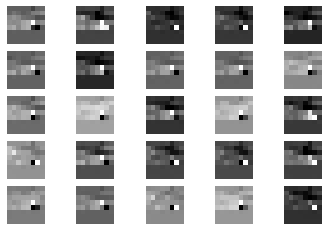

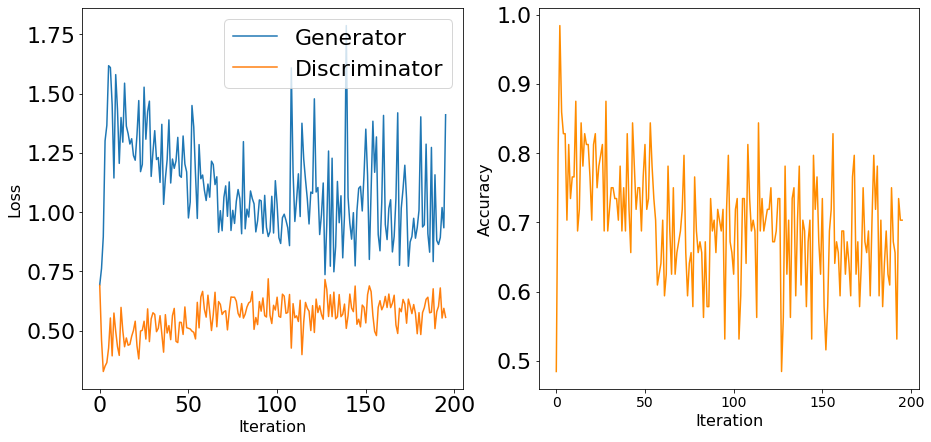

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19501 [D loss: 0.529473, acc.: 76.56%] [G loss: 1.766905]
19502 [D loss: 0.641604, acc.: 54.69%] [G loss: 1.022082]
19503 [D loss: 0.506445, acc.: 84.38%] [G loss: 1.121481]
19504 [D loss: 0.572401, acc.: 70.31%] [G loss: 1.118165]
19505 [D loss: 0.616245, acc.: 70.31%] [G loss: 1.063431]
19506 [D loss: 0.570048, acc.: 70.31%] [G loss: 1.010112]
19507 [D loss: 0.658283, acc.: 53.12%] [G loss: 0.845282]
19508 [D loss: 0.561800, acc.: 71.88%] [G loss: 1.194714]
19509 [D loss: 0.528939, acc.: 70.31%] [G loss: 1.102297]
19510 [D loss: 0.604840, acc.: 71.88%] [G loss: 0.941197]
19511 [D loss: 0.591569, acc.: 71.88%] [G loss: 1.231441]
19512 [D loss: 0.555342, acc.: 71.88%] [G loss: 0.995835]
19513 [D loss: 0.683088, acc.: 59.38%] [G loss: 1.083133]
19514 [D loss: 0.568993, acc.: 73.44%] [G loss: 1.128713]
19515 [D loss: 0.707345, acc.: 51.56%] [G loss: 1.143735]
19516 [D loss: 0.562602, acc.: 73.44%] [G loss: 0.989398]
19517 [D loss: 0.608433, acc.: 70.31%] [G loss: 0.949443]
19518 [D loss:

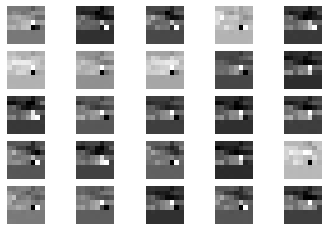

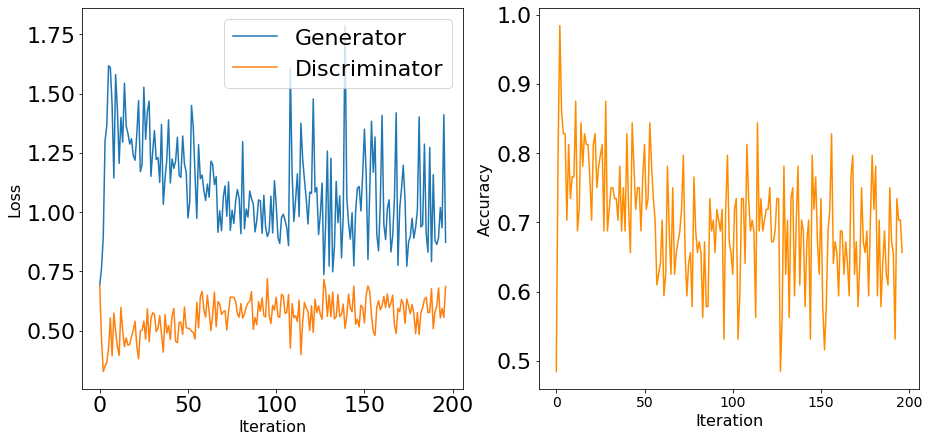

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19601 [D loss: 0.626911, acc.: 62.50%] [G loss: 0.765336]
19602 [D loss: 0.672585, acc.: 59.38%] [G loss: 0.778399]
19603 [D loss: 0.680853, acc.: 59.38%] [G loss: 1.012690]
19604 [D loss: 0.504653, acc.: 73.44%] [G loss: 1.287195]
19605 [D loss: 0.577625, acc.: 65.62%] [G loss: 1.200345]
19606 [D loss: 0.596813, acc.: 67.19%] [G loss: 0.866821]
19607 [D loss: 0.610912, acc.: 71.88%] [G loss: 0.836320]
19608 [D loss: 0.526580, acc.: 75.00%] [G loss: 0.969885]
19609 [D loss: 0.604911, acc.: 68.75%] [G loss: 1.068816]
19610 [D loss: 0.546184, acc.: 71.88%] [G loss: 0.970201]
19611 [D loss: 0.655855, acc.: 59.38%] [G loss: 0.880593]
19612 [D loss: 0.594625, acc.: 70.31%] [G loss: 0.890309]
19613 [D loss: 0.618288, acc.: 64.06%] [G loss: 0.851887]
19614 [D loss: 0.738421, acc.: 51.56%] [G loss: 0.832376]
19615 [D loss: 0.552745, acc.: 70.31%] [G loss: 1.273218]
19616 [D loss: 0.636044, acc.: 68.75%] [G loss: 0.844932]
19617 [D loss: 0.592857, acc.: 65.62%] [G loss: 0.787566]
19618 [D loss:

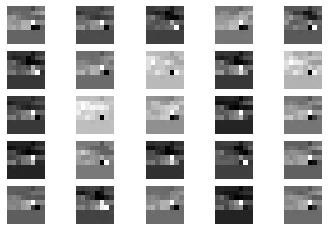

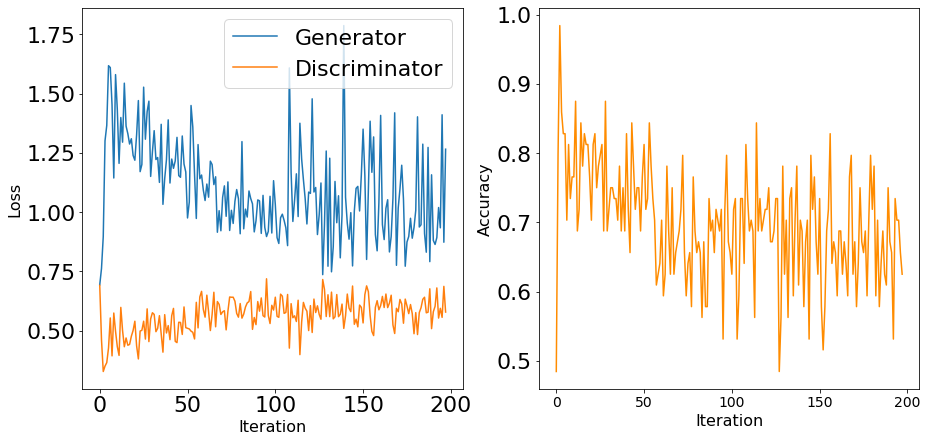

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19701 [D loss: 0.537270, acc.: 68.75%] [G loss: 1.893625]
19702 [D loss: 0.485580, acc.: 78.12%] [G loss: 1.104535]
19703 [D loss: 0.597183, acc.: 67.19%] [G loss: 0.979172]
19704 [D loss: 0.520301, acc.: 79.69%] [G loss: 1.256593]
19705 [D loss: 0.563185, acc.: 68.75%] [G loss: 1.060859]
19706 [D loss: 0.656457, acc.: 57.81%] [G loss: 1.068854]
19707 [D loss: 0.565873, acc.: 67.19%] [G loss: 1.069933]
19708 [D loss: 0.579543, acc.: 71.88%] [G loss: 0.950434]
19709 [D loss: 0.528520, acc.: 73.44%] [G loss: 1.137132]
19710 [D loss: 0.503963, acc.: 75.00%] [G loss: 1.530552]
19711 [D loss: 0.612448, acc.: 67.19%] [G loss: 0.948490]
19712 [D loss: 0.615271, acc.: 62.50%] [G loss: 1.208742]
19713 [D loss: 0.608077, acc.: 70.31%] [G loss: 0.954118]
19714 [D loss: 0.637380, acc.: 62.50%] [G loss: 0.802628]
19715 [D loss: 0.635730, acc.: 62.50%] [G loss: 0.880427]
19716 [D loss: 0.619757, acc.: 62.50%] [G loss: 0.829338]
19717 [D loss: 0.589048, acc.: 68.75%] [G loss: 0.953836]
19718 [D loss:

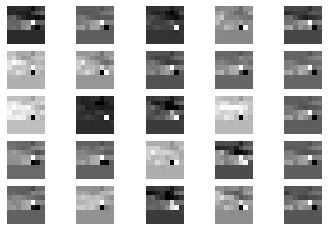

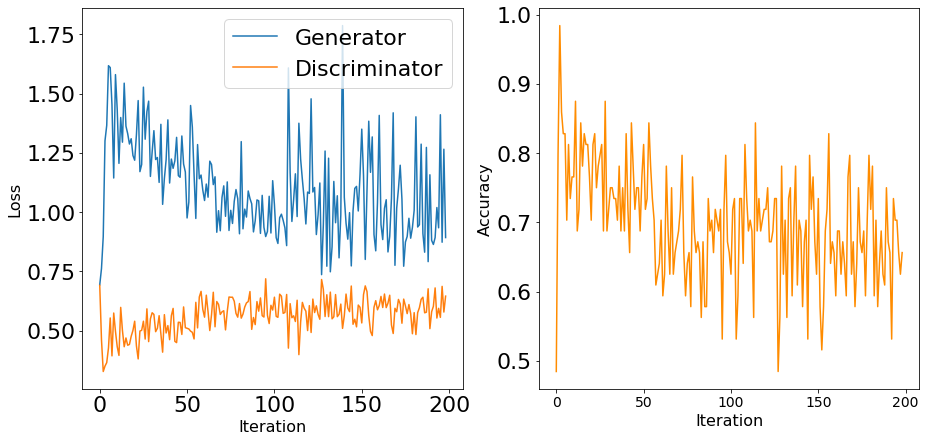

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19801 [D loss: 0.622758, acc.: 59.38%] [G loss: 0.798847]
19802 [D loss: 0.659128, acc.: 54.69%] [G loss: 0.900198]
19803 [D loss: 0.656007, acc.: 60.94%] [G loss: 0.840975]
19804 [D loss: 0.614679, acc.: 65.62%] [G loss: 1.011404]
19805 [D loss: 0.525283, acc.: 76.56%] [G loss: 1.498767]
19806 [D loss: 0.620104, acc.: 64.06%] [G loss: 1.087180]
19807 [D loss: 0.612613, acc.: 68.75%] [G loss: 0.990933]
19808 [D loss: 0.556592, acc.: 60.94%] [G loss: 1.305116]
19809 [D loss: 0.583396, acc.: 60.94%] [G loss: 1.518774]
19810 [D loss: 0.567494, acc.: 70.31%] [G loss: 1.265411]
19811 [D loss: 0.500296, acc.: 75.00%] [G loss: 1.203529]
19812 [D loss: 0.637672, acc.: 65.62%] [G loss: 0.925666]
19813 [D loss: 0.584836, acc.: 71.88%] [G loss: 1.121570]
19814 [D loss: 0.551435, acc.: 68.75%] [G loss: 1.338571]
19815 [D loss: 0.647728, acc.: 60.94%] [G loss: 0.976612]
19816 [D loss: 0.605564, acc.: 70.31%] [G loss: 0.987628]
19817 [D loss: 0.674232, acc.: 56.25%] [G loss: 1.130885]
19818 [D loss:

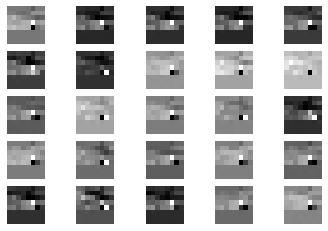

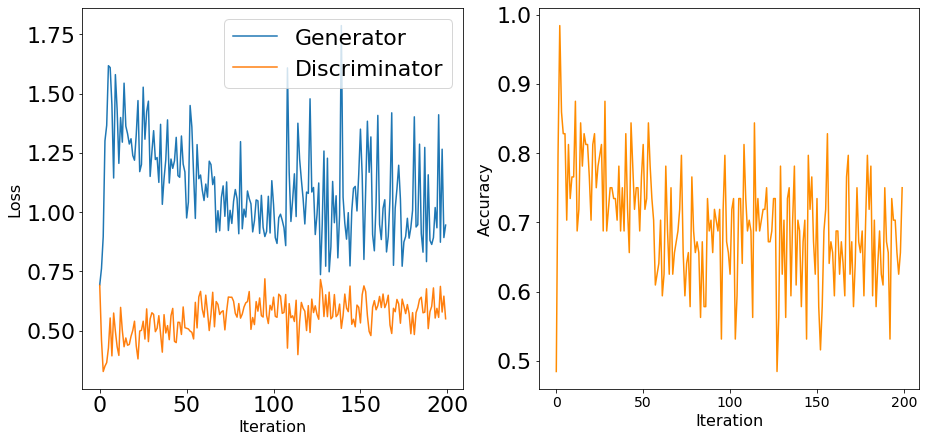

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


19901 [D loss: 0.603412, acc.: 67.19%] [G loss: 1.006705]
19902 [D loss: 0.601854, acc.: 71.88%] [G loss: 0.986694]
19903 [D loss: 0.575701, acc.: 73.44%] [G loss: 0.855005]
19904 [D loss: 0.666973, acc.: 59.38%] [G loss: 0.764761]
19905 [D loss: 0.607980, acc.: 65.62%] [G loss: 0.874086]
19906 [D loss: 0.696086, acc.: 56.25%] [G loss: 0.922664]
19907 [D loss: 0.601496, acc.: 64.06%] [G loss: 0.997611]
19908 [D loss: 0.584581, acc.: 65.62%] [G loss: 0.907597]
19909 [D loss: 0.613512, acc.: 68.75%] [G loss: 0.764127]
19910 [D loss: 0.666112, acc.: 59.38%] [G loss: 0.761418]
19911 [D loss: 0.588316, acc.: 64.06%] [G loss: 1.099807]
19912 [D loss: 0.581276, acc.: 67.19%] [G loss: 1.269285]
19913 [D loss: 0.597272, acc.: 68.75%] [G loss: 1.087026]
19914 [D loss: 0.610220, acc.: 60.94%] [G loss: 0.900431]
19915 [D loss: 0.651769, acc.: 53.12%] [G loss: 0.726285]
19916 [D loss: 0.731873, acc.: 51.56%] [G loss: 0.822006]
19917 [D loss: 0.613353, acc.: 68.75%] [G loss: 1.016212]
19918 [D loss:

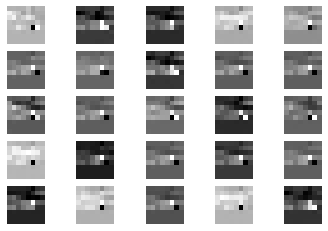

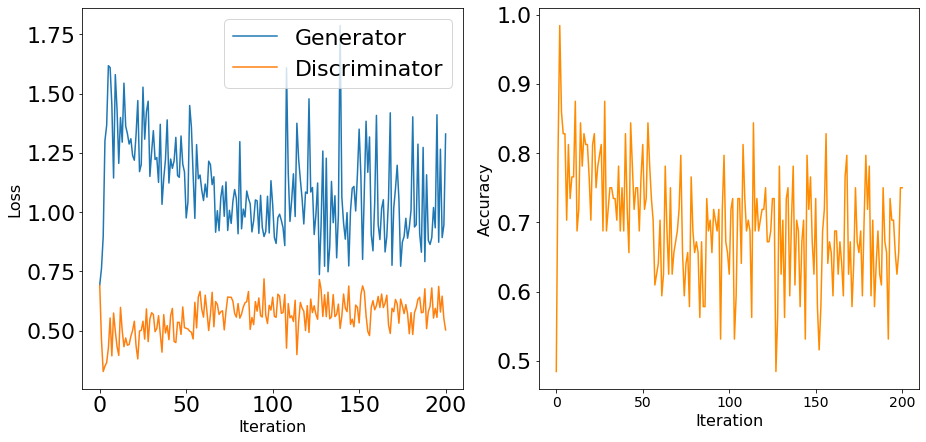

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20001 [D loss: 0.624838, acc.: 64.06%] [G loss: 1.123581]
20002 [D loss: 0.698984, acc.: 57.81%] [G loss: 0.849497]
20003 [D loss: 0.685137, acc.: 57.81%] [G loss: 1.115581]
20004 [D loss: 0.581789, acc.: 70.31%] [G loss: 1.180402]
20005 [D loss: 0.693506, acc.: 51.56%] [G loss: 1.063739]
20006 [D loss: 0.596388, acc.: 64.06%] [G loss: 0.995684]
20007 [D loss: 0.655117, acc.: 59.38%] [G loss: 1.031659]
20008 [D loss: 0.666982, acc.: 54.69%] [G loss: 0.975166]
20009 [D loss: 0.665424, acc.: 60.94%] [G loss: 0.990723]
20010 [D loss: 0.548037, acc.: 73.44%] [G loss: 0.977210]
20011 [D loss: 0.555171, acc.: 73.44%] [G loss: 1.034372]
20012 [D loss: 0.612674, acc.: 64.06%] [G loss: 0.842078]
20013 [D loss: 0.682377, acc.: 57.81%] [G loss: 0.861769]
20014 [D loss: 0.650767, acc.: 65.62%] [G loss: 0.807487]
20015 [D loss: 0.628634, acc.: 59.38%] [G loss: 0.885944]
20016 [D loss: 0.534102, acc.: 81.25%] [G loss: 0.919935]
20017 [D loss: 0.623996, acc.: 62.50%] [G loss: 0.891574]
20018 [D loss:

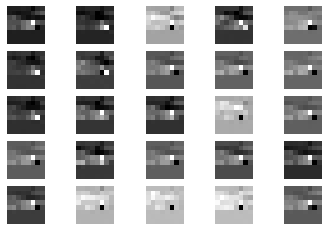

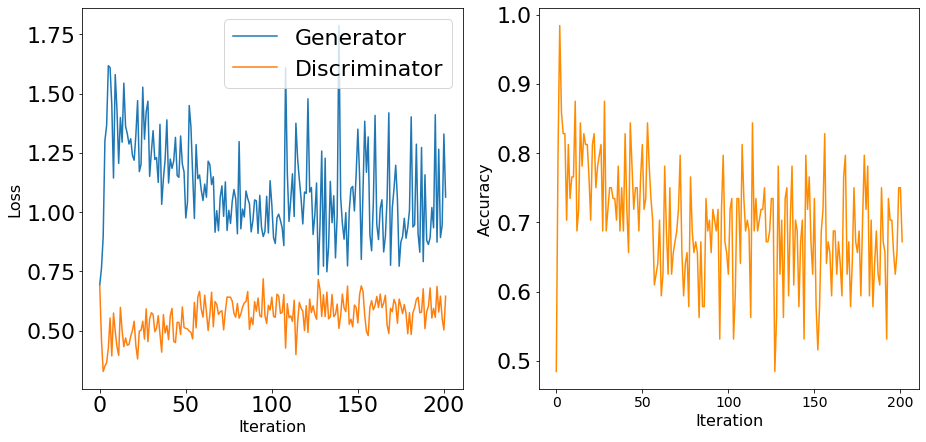

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20101 [D loss: 0.704674, acc.: 59.38%] [G loss: 0.827680]
20102 [D loss: 0.637510, acc.: 64.06%] [G loss: 0.968847]
20103 [D loss: 0.634081, acc.: 65.62%] [G loss: 0.911812]
20104 [D loss: 0.654025, acc.: 60.94%] [G loss: 0.963460]
20105 [D loss: 0.628611, acc.: 60.94%] [G loss: 0.810117]
20106 [D loss: 0.667372, acc.: 59.38%] [G loss: 0.882631]
20107 [D loss: 0.659015, acc.: 60.94%] [G loss: 1.045436]
20108 [D loss: 0.659814, acc.: 64.06%] [G loss: 1.096703]
20109 [D loss: 0.594421, acc.: 67.19%] [G loss: 0.922195]
20110 [D loss: 0.544775, acc.: 71.88%] [G loss: 1.078015]
20111 [D loss: 0.554721, acc.: 73.44%] [G loss: 1.500462]
20112 [D loss: 0.504246, acc.: 82.81%] [G loss: 0.958273]
20113 [D loss: 0.607007, acc.: 67.19%] [G loss: 0.931113]
20114 [D loss: 0.586139, acc.: 65.62%] [G loss: 1.165195]
20115 [D loss: 0.479513, acc.: 73.44%] [G loss: 1.189604]
20116 [D loss: 0.630084, acc.: 62.50%] [G loss: 0.940997]
20117 [D loss: 0.583787, acc.: 71.88%] [G loss: 0.960590]
20118 [D loss:

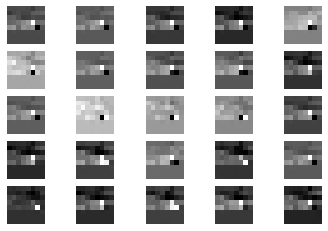

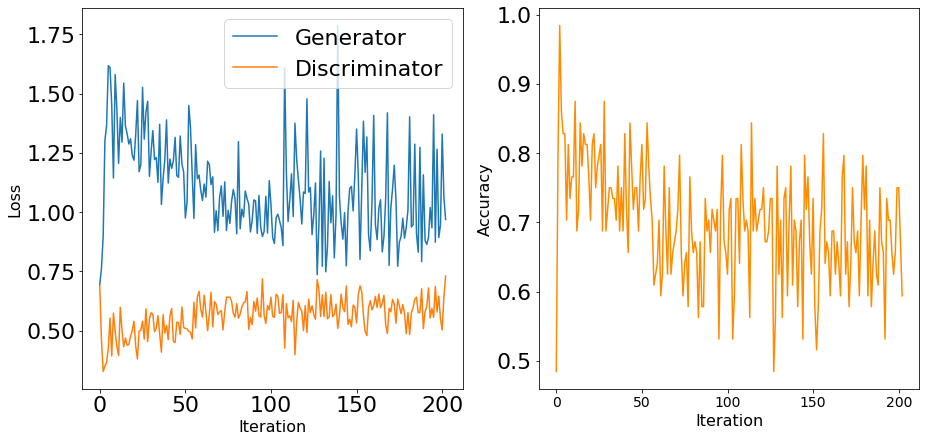

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20201 [D loss: 0.473391, acc.: 81.25%] [G loss: 1.508983]
20202 [D loss: 0.577280, acc.: 70.31%] [G loss: 1.083311]
20203 [D loss: 0.627928, acc.: 65.62%] [G loss: 1.100649]
20204 [D loss: 0.545754, acc.: 65.62%] [G loss: 1.353402]
20205 [D loss: 0.564798, acc.: 73.44%] [G loss: 1.033585]
20206 [D loss: 0.561582, acc.: 75.00%] [G loss: 0.793657]
20207 [D loss: 0.650112, acc.: 62.50%] [G loss: 1.177589]
20208 [D loss: 0.546243, acc.: 71.88%] [G loss: 1.291392]
20209 [D loss: 0.562423, acc.: 68.75%] [G loss: 1.045662]
20210 [D loss: 0.618853, acc.: 60.94%] [G loss: 0.860515]
20211 [D loss: 0.578569, acc.: 67.19%] [G loss: 0.845345]
20212 [D loss: 0.615177, acc.: 64.06%] [G loss: 0.772025]
20213 [D loss: 0.586481, acc.: 67.19%] [G loss: 0.896029]
20214 [D loss: 0.516958, acc.: 70.31%] [G loss: 1.014235]
20215 [D loss: 0.664753, acc.: 60.94%] [G loss: 0.797356]
20216 [D loss: 0.617859, acc.: 65.62%] [G loss: 0.830162]
20217 [D loss: 0.614201, acc.: 64.06%] [G loss: 0.842034]
20218 [D loss:

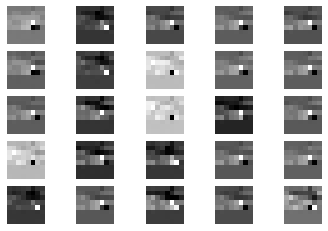

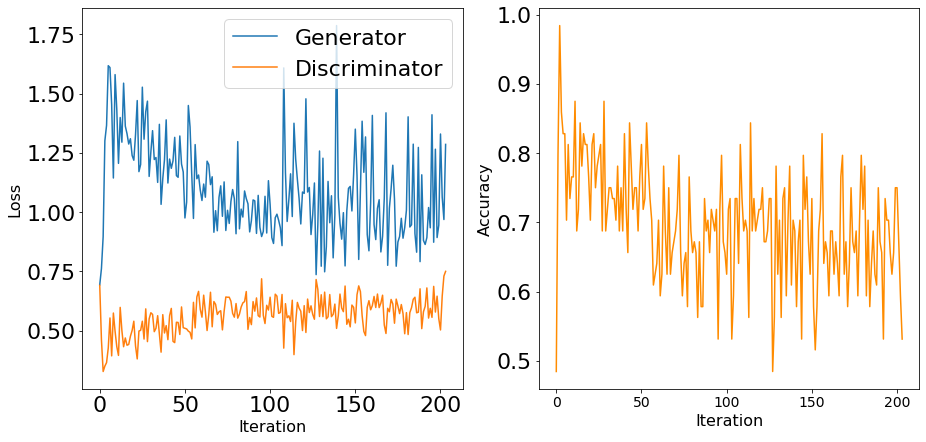

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20301 [D loss: 0.517222, acc.: 71.88%] [G loss: 1.495619]
20302 [D loss: 0.631574, acc.: 76.56%] [G loss: 1.142146]
20303 [D loss: 0.641094, acc.: 62.50%] [G loss: 0.901370]
20304 [D loss: 0.606804, acc.: 71.88%] [G loss: 1.090418]
20305 [D loss: 0.539695, acc.: 73.44%] [G loss: 1.377582]
20306 [D loss: 0.543007, acc.: 75.00%] [G loss: 0.955018]
20307 [D loss: 0.538103, acc.: 76.56%] [G loss: 1.296007]
20308 [D loss: 0.491839, acc.: 70.31%] [G loss: 1.629208]
20309 [D loss: 0.541649, acc.: 71.88%] [G loss: 1.115031]
20310 [D loss: 0.530477, acc.: 70.31%] [G loss: 1.467530]
20311 [D loss: 0.508801, acc.: 71.88%] [G loss: 1.477049]
20312 [D loss: 0.576845, acc.: 65.62%] [G loss: 0.997512]
20313 [D loss: 0.535320, acc.: 71.88%] [G loss: 1.454423]
20314 [D loss: 0.498173, acc.: 75.00%] [G loss: 1.471057]
20315 [D loss: 0.620804, acc.: 65.62%] [G loss: 0.806587]
20316 [D loss: 0.560127, acc.: 78.12%] [G loss: 1.244856]
20317 [D loss: 0.601265, acc.: 70.31%] [G loss: 1.009082]
20318 [D loss:

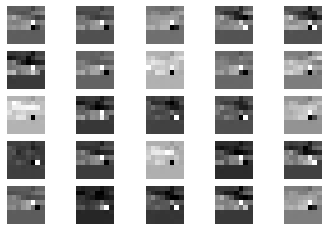

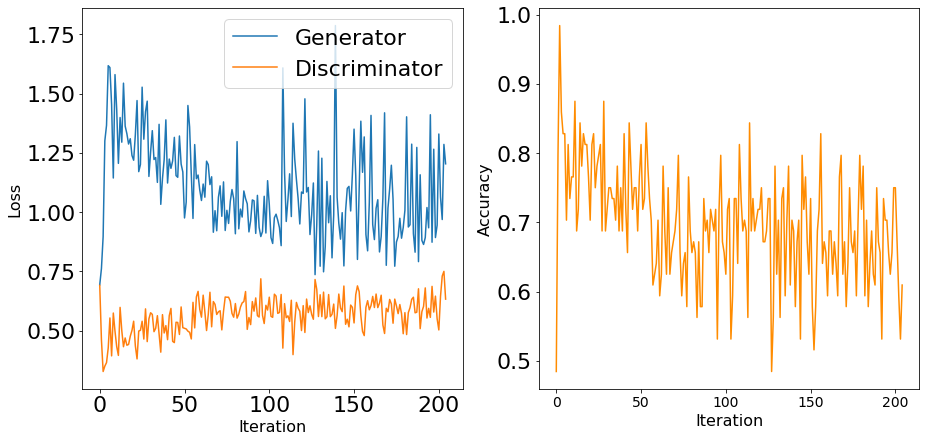

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20401 [D loss: 0.599909, acc.: 62.50%] [G loss: 0.775443]
20402 [D loss: 0.723847, acc.: 48.44%] [G loss: 0.928172]
20403 [D loss: 0.516977, acc.: 71.88%] [G loss: 1.284166]
20404 [D loss: 0.561309, acc.: 73.44%] [G loss: 1.011343]
20405 [D loss: 0.575089, acc.: 71.88%] [G loss: 0.876921]
20406 [D loss: 0.591747, acc.: 65.62%] [G loss: 1.001122]
20407 [D loss: 0.567406, acc.: 67.19%] [G loss: 1.182070]
20408 [D loss: 0.616360, acc.: 67.19%] [G loss: 0.936587]
20409 [D loss: 0.582006, acc.: 73.44%] [G loss: 0.920506]
20410 [D loss: 0.569589, acc.: 70.31%] [G loss: 0.998776]
20411 [D loss: 0.642216, acc.: 57.81%] [G loss: 0.987457]
20412 [D loss: 0.546146, acc.: 67.19%] [G loss: 1.570672]
20413 [D loss: 0.602401, acc.: 64.06%] [G loss: 1.160137]
20414 [D loss: 0.568371, acc.: 65.62%] [G loss: 0.955688]
20415 [D loss: 0.574087, acc.: 70.31%] [G loss: 1.187080]
20416 [D loss: 0.626318, acc.: 64.06%] [G loss: 0.906321]
20417 [D loss: 0.577389, acc.: 73.44%] [G loss: 0.746363]
20418 [D loss:

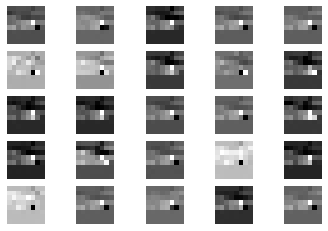

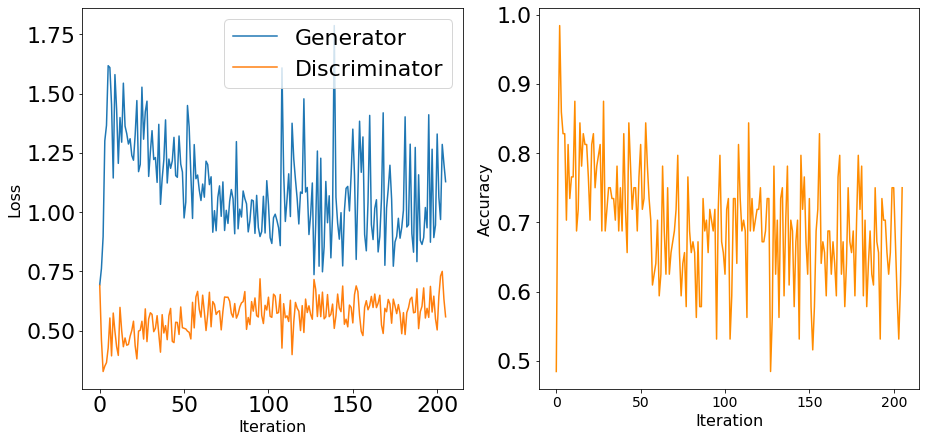

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20501 [D loss: 0.619784, acc.: 65.62%] [G loss: 0.868486]
20502 [D loss: 0.628285, acc.: 64.06%] [G loss: 1.007110]
20503 [D loss: 0.602105, acc.: 64.06%] [G loss: 1.132010]
20504 [D loss: 0.556802, acc.: 65.62%] [G loss: 1.170442]
20505 [D loss: 0.529660, acc.: 71.88%] [G loss: 1.731115]
20506 [D loss: 0.553266, acc.: 76.56%] [G loss: 1.093310]
20507 [D loss: 0.571851, acc.: 65.62%] [G loss: 1.110675]
20508 [D loss: 0.553624, acc.: 75.00%] [G loss: 1.214403]
20509 [D loss: 0.512484, acc.: 68.75%] [G loss: 1.670092]
20510 [D loss: 0.546618, acc.: 75.00%] [G loss: 0.858112]
20511 [D loss: 0.559745, acc.: 76.56%] [G loss: 0.855861]
20512 [D loss: 0.586411, acc.: 67.19%] [G loss: 0.837938]
20513 [D loss: 0.718405, acc.: 54.69%] [G loss: 0.798951]
20514 [D loss: 0.655541, acc.: 57.81%] [G loss: 0.965826]
20515 [D loss: 0.620519, acc.: 62.50%] [G loss: 0.883705]
20516 [D loss: 0.542176, acc.: 73.44%] [G loss: 1.021163]
20517 [D loss: 0.613351, acc.: 64.06%] [G loss: 0.857540]
20518 [D loss:

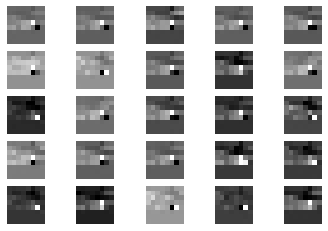

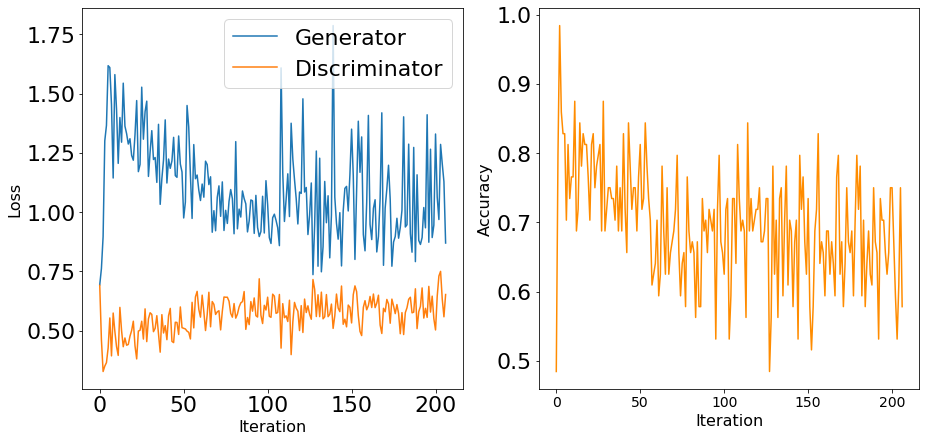

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20601 [D loss: 0.620063, acc.: 65.62%] [G loss: 1.183301]
20602 [D loss: 0.563887, acc.: 62.50%] [G loss: 1.114370]
20603 [D loss: 0.623515, acc.: 68.75%] [G loss: 0.730892]
20604 [D loss: 0.708997, acc.: 54.69%] [G loss: 0.966545]
20605 [D loss: 0.581615, acc.: 67.19%] [G loss: 0.958928]
20606 [D loss: 0.674704, acc.: 54.69%] [G loss: 0.956112]
20607 [D loss: 0.580473, acc.: 68.75%] [G loss: 0.797967]
20608 [D loss: 0.563371, acc.: 73.44%] [G loss: 0.843921]
20609 [D loss: 0.698221, acc.: 54.69%] [G loss: 0.836970]
20610 [D loss: 0.621253, acc.: 64.06%] [G loss: 1.091783]
20611 [D loss: 0.575111, acc.: 68.75%] [G loss: 1.419644]
20612 [D loss: 0.566951, acc.: 70.31%] [G loss: 1.127074]
20613 [D loss: 0.631224, acc.: 65.62%] [G loss: 0.899646]
20614 [D loss: 0.684621, acc.: 54.69%] [G loss: 0.798445]
20615 [D loss: 0.628392, acc.: 62.50%] [G loss: 0.732469]
20616 [D loss: 0.678732, acc.: 64.06%] [G loss: 0.776453]
20617 [D loss: 0.686641, acc.: 53.12%] [G loss: 0.853129]
20618 [D loss:

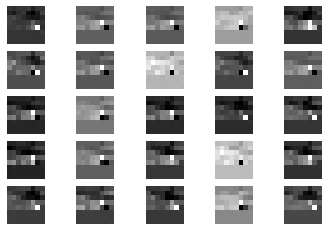

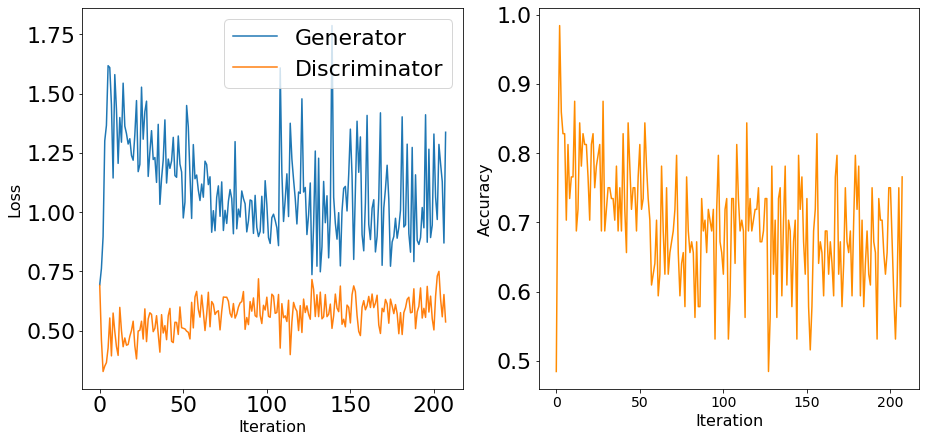

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20701 [D loss: 0.518658, acc.: 71.88%] [G loss: 1.316286]
20702 [D loss: 0.523192, acc.: 71.88%] [G loss: 1.219024]
20703 [D loss: 0.550247, acc.: 75.00%] [G loss: 0.841417]
20704 [D loss: 0.571831, acc.: 70.31%] [G loss: 1.215951]
20705 [D loss: 0.607553, acc.: 57.81%] [G loss: 0.833870]
20706 [D loss: 0.608139, acc.: 54.69%] [G loss: 0.922391]
20707 [D loss: 0.597225, acc.: 70.31%] [G loss: 0.816266]
20708 [D loss: 0.573886, acc.: 68.75%] [G loss: 1.014221]
20709 [D loss: 0.474289, acc.: 78.12%] [G loss: 0.997019]
20710 [D loss: 0.614251, acc.: 65.62%] [G loss: 0.929540]
20711 [D loss: 0.505300, acc.: 73.44%] [G loss: 1.238959]
20712 [D loss: 0.618579, acc.: 60.94%] [G loss: 0.832217]
20713 [D loss: 0.648171, acc.: 62.50%] [G loss: 0.903908]
20714 [D loss: 0.579734, acc.: 67.19%] [G loss: 0.802596]
20715 [D loss: 0.602754, acc.: 65.62%] [G loss: 0.754989]
20716 [D loss: 0.633572, acc.: 59.38%] [G loss: 0.850790]
20717 [D loss: 0.657072, acc.: 59.38%] [G loss: 0.693240]
20718 [D loss:

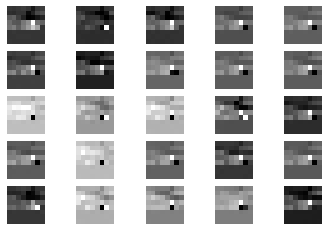

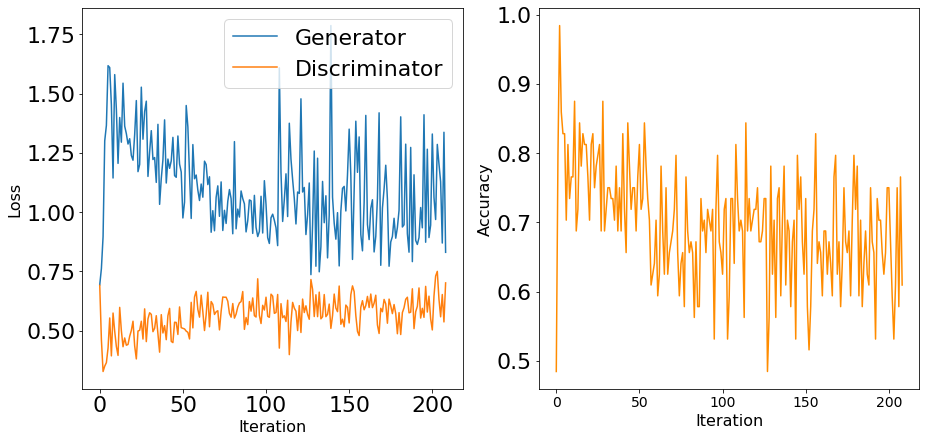

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20801 [D loss: 0.585768, acc.: 68.75%] [G loss: 0.832518]
20802 [D loss: 0.629597, acc.: 67.19%] [G loss: 1.042087]
20803 [D loss: 0.568594, acc.: 68.75%] [G loss: 1.279787]
20804 [D loss: 0.548632, acc.: 73.44%] [G loss: 1.213715]
20805 [D loss: 0.608349, acc.: 68.75%] [G loss: 0.922352]
20806 [D loss: 0.615408, acc.: 60.94%] [G loss: 0.870845]
20807 [D loss: 0.559094, acc.: 70.31%] [G loss: 1.010002]
20808 [D loss: 0.523514, acc.: 71.88%] [G loss: 1.367389]
20809 [D loss: 0.512869, acc.: 75.00%] [G loss: 1.183273]
20810 [D loss: 0.625708, acc.: 62.50%] [G loss: 0.909523]
20811 [D loss: 0.628738, acc.: 64.06%] [G loss: 0.953764]
20812 [D loss: 0.563112, acc.: 65.62%] [G loss: 1.261485]
20813 [D loss: 0.602963, acc.: 65.62%] [G loss: 0.790081]
20814 [D loss: 0.613299, acc.: 70.31%] [G loss: 0.900557]
20815 [D loss: 0.488013, acc.: 75.00%] [G loss: 1.594158]
20816 [D loss: 0.589552, acc.: 71.88%] [G loss: 1.173570]
20817 [D loss: 0.550165, acc.: 78.12%] [G loss: 1.305881]
20818 [D loss:

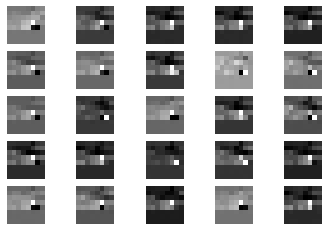

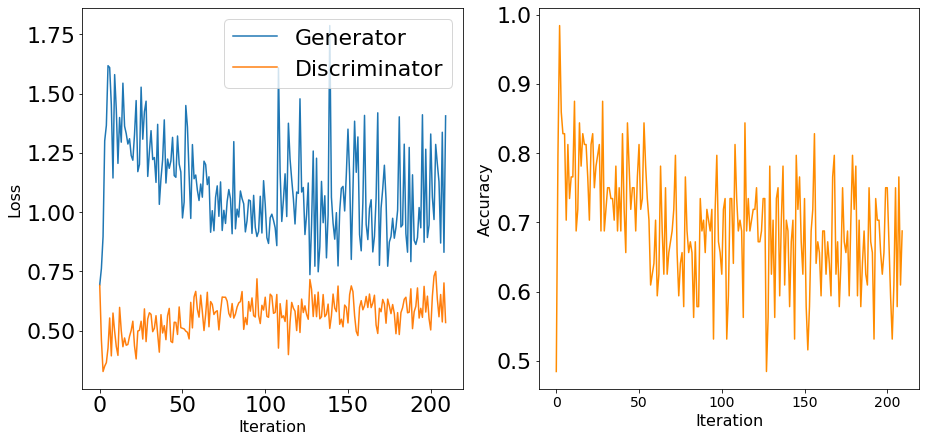

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


20901 [D loss: 0.652770, acc.: 56.25%] [G loss: 1.054057]
20902 [D loss: 0.628366, acc.: 62.50%] [G loss: 0.898350]
20903 [D loss: 0.601880, acc.: 59.38%] [G loss: 0.764881]
20904 [D loss: 0.643538, acc.: 65.62%] [G loss: 0.798541]
20905 [D loss: 0.598858, acc.: 65.62%] [G loss: 1.067066]
20906 [D loss: 0.619013, acc.: 57.81%] [G loss: 1.008572]
20907 [D loss: 0.621465, acc.: 59.38%] [G loss: 1.022786]
20908 [D loss: 0.661533, acc.: 64.06%] [G loss: 0.705827]
20909 [D loss: 0.583894, acc.: 73.44%] [G loss: 0.919246]
20910 [D loss: 0.576519, acc.: 73.44%] [G loss: 0.903966]
20911 [D loss: 0.616920, acc.: 59.38%] [G loss: 0.952478]
20912 [D loss: 0.555080, acc.: 70.31%] [G loss: 0.992809]
20913 [D loss: 0.571379, acc.: 62.50%] [G loss: 1.112100]
20914 [D loss: 0.673450, acc.: 60.94%] [G loss: 0.675792]
20915 [D loss: 0.570382, acc.: 62.50%] [G loss: 1.446457]
20916 [D loss: 0.502786, acc.: 76.56%] [G loss: 1.425919]
20917 [D loss: 0.628971, acc.: 64.06%] [G loss: 0.705837]
20918 [D loss:

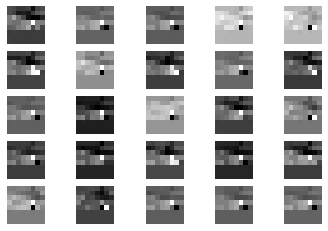

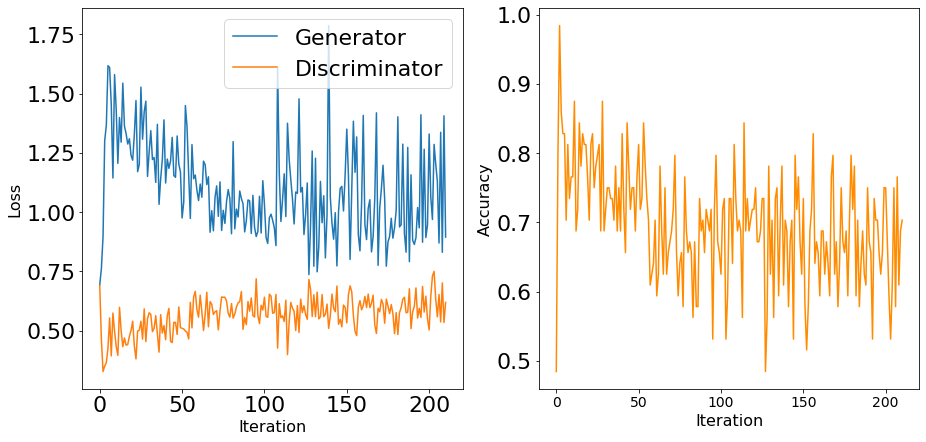

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21001 [D loss: 0.638541, acc.: 65.62%] [G loss: 0.809613]
21002 [D loss: 0.602444, acc.: 65.62%] [G loss: 1.581268]
21003 [D loss: 0.443531, acc.: 81.25%] [G loss: 1.657439]
21004 [D loss: 0.672994, acc.: 59.38%] [G loss: 0.918351]
21005 [D loss: 0.520820, acc.: 71.88%] [G loss: 1.664071]
21006 [D loss: 0.459433, acc.: 79.69%] [G loss: 1.411566]
21007 [D loss: 0.667887, acc.: 50.00%] [G loss: 0.854603]
21008 [D loss: 0.594547, acc.: 68.75%] [G loss: 0.973810]
21009 [D loss: 0.580612, acc.: 70.31%] [G loss: 0.830046]
21010 [D loss: 0.549724, acc.: 71.88%] [G loss: 0.940688]
21011 [D loss: 0.515933, acc.: 73.44%] [G loss: 1.516498]
21012 [D loss: 0.388945, acc.: 79.69%] [G loss: 1.489970]
21013 [D loss: 0.590553, acc.: 60.94%] [G loss: 1.117452]
21014 [D loss: 0.485013, acc.: 79.69%] [G loss: 1.545268]
21015 [D loss: 0.610078, acc.: 65.62%] [G loss: 0.825735]
21016 [D loss: 0.643874, acc.: 59.38%] [G loss: 0.900562]
21017 [D loss: 0.531267, acc.: 73.44%] [G loss: 0.997847]
21018 [D loss:

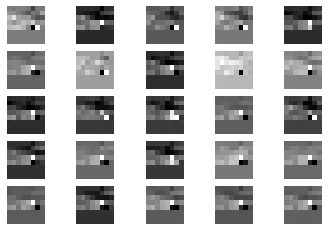

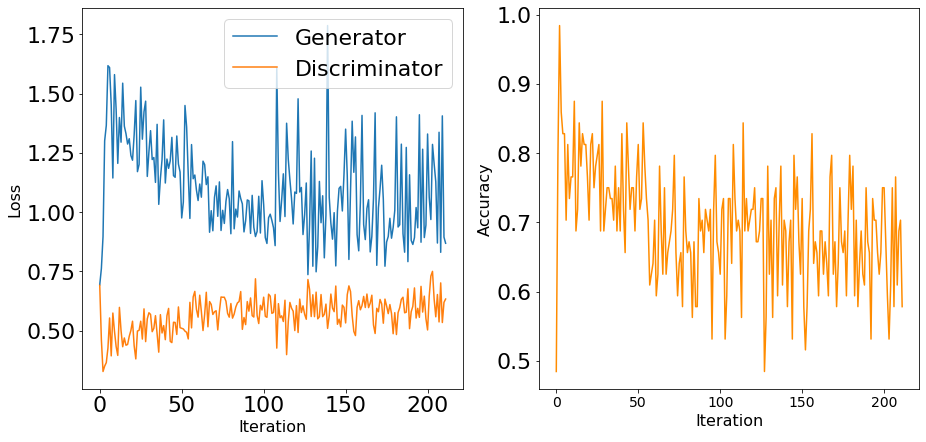

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21101 [D loss: 0.616755, acc.: 65.62%] [G loss: 0.975396]
21102 [D loss: 0.687953, acc.: 60.94%] [G loss: 0.764260]
21103 [D loss: 0.598946, acc.: 64.06%] [G loss: 0.759972]
21104 [D loss: 0.698292, acc.: 48.44%] [G loss: 0.906342]
21105 [D loss: 0.629723, acc.: 56.25%] [G loss: 0.900993]
21106 [D loss: 0.715525, acc.: 56.25%] [G loss: 0.757407]
21107 [D loss: 0.619826, acc.: 62.50%] [G loss: 0.998675]
21108 [D loss: 0.511026, acc.: 71.88%] [G loss: 1.489568]
21109 [D loss: 0.639012, acc.: 62.50%] [G loss: 1.103008]
21110 [D loss: 0.607571, acc.: 65.62%] [G loss: 1.377694]
21111 [D loss: 0.488408, acc.: 71.88%] [G loss: 1.493422]
21112 [D loss: 0.528931, acc.: 67.19%] [G loss: 1.132602]
21113 [D loss: 0.608342, acc.: 60.94%] [G loss: 0.941235]
21114 [D loss: 0.603225, acc.: 64.06%] [G loss: 0.984160]
21115 [D loss: 0.642825, acc.: 62.50%] [G loss: 0.971545]
21116 [D loss: 0.549120, acc.: 73.44%] [G loss: 1.064879]
21117 [D loss: 0.629369, acc.: 59.38%] [G loss: 0.846347]
21118 [D loss:

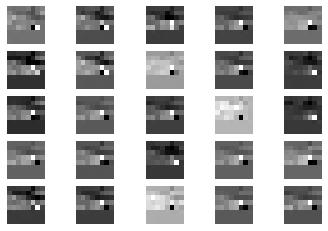

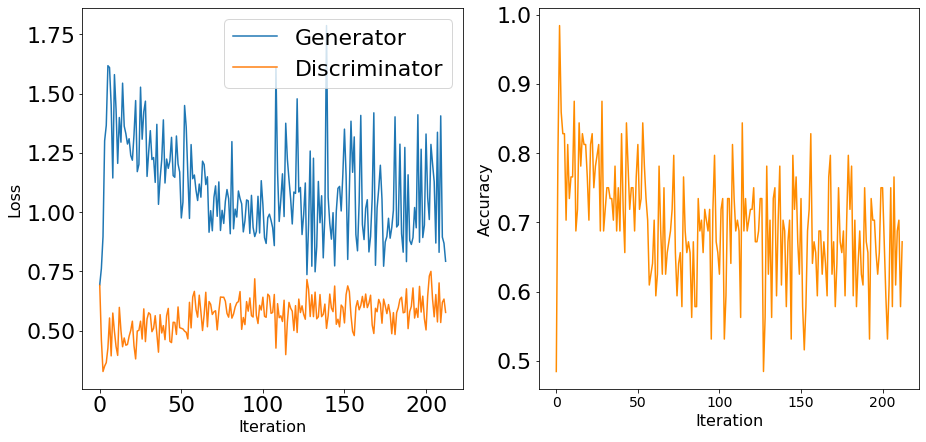

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21201 [D loss: 0.549822, acc.: 71.88%] [G loss: 1.041864]
21202 [D loss: 0.514357, acc.: 75.00%] [G loss: 0.798530]
21203 [D loss: 0.653459, acc.: 56.25%] [G loss: 0.890429]
21204 [D loss: 0.713423, acc.: 45.31%] [G loss: 0.842710]
21205 [D loss: 0.585560, acc.: 70.31%] [G loss: 0.887926]
21206 [D loss: 0.643755, acc.: 70.31%] [G loss: 0.977939]
21207 [D loss: 0.536362, acc.: 78.12%] [G loss: 1.216185]
21208 [D loss: 0.628909, acc.: 57.81%] [G loss: 0.999631]
21209 [D loss: 0.577423, acc.: 71.88%] [G loss: 1.115083]
21210 [D loss: 0.597560, acc.: 59.38%] [G loss: 1.100610]
21211 [D loss: 0.603805, acc.: 65.62%] [G loss: 1.118193]
21212 [D loss: 0.571048, acc.: 68.75%] [G loss: 0.952963]
21213 [D loss: 0.552364, acc.: 68.75%] [G loss: 0.915304]
21214 [D loss: 0.566885, acc.: 73.44%] [G loss: 0.839652]
21215 [D loss: 0.652266, acc.: 54.69%] [G loss: 0.939548]
21216 [D loss: 0.693880, acc.: 42.19%] [G loss: 0.771534]
21217 [D loss: 0.631511, acc.: 62.50%] [G loss: 0.903293]
21218 [D loss:

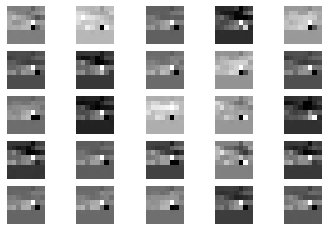

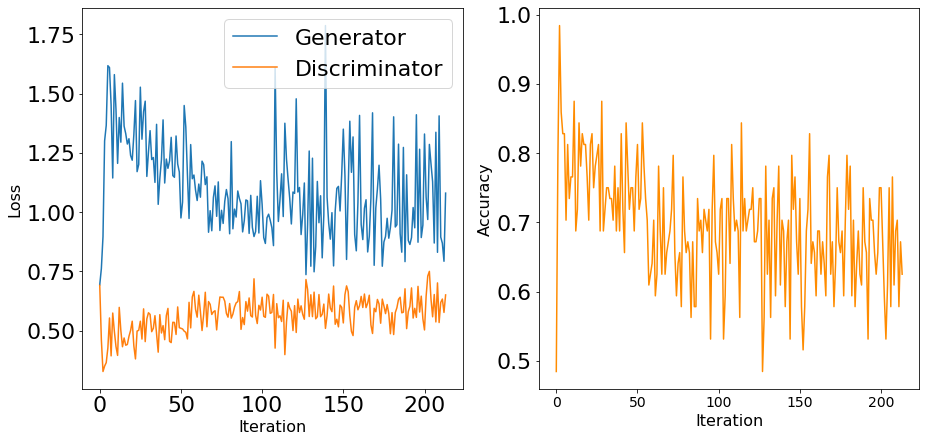

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21301 [D loss: 0.521367, acc.: 71.88%] [G loss: 1.474477]
21302 [D loss: 0.660824, acc.: 54.69%] [G loss: 1.264731]
21303 [D loss: 0.603409, acc.: 70.31%] [G loss: 0.913628]
21304 [D loss: 0.513370, acc.: 79.69%] [G loss: 1.369361]
21305 [D loss: 0.629878, acc.: 57.81%] [G loss: 1.098946]
21306 [D loss: 0.631182, acc.: 59.38%] [G loss: 0.909084]
21307 [D loss: 0.583599, acc.: 71.88%] [G loss: 0.975161]
21308 [D loss: 0.669863, acc.: 59.38%] [G loss: 1.138235]
21309 [D loss: 0.605721, acc.: 62.50%] [G loss: 0.868844]
21310 [D loss: 0.605402, acc.: 64.06%] [G loss: 0.904343]
21311 [D loss: 0.665305, acc.: 59.38%] [G loss: 0.965777]
21312 [D loss: 0.526635, acc.: 75.00%] [G loss: 1.011166]
21313 [D loss: 0.587604, acc.: 67.19%] [G loss: 1.069918]
21314 [D loss: 0.680880, acc.: 53.12%] [G loss: 1.230307]
21315 [D loss: 0.606267, acc.: 60.94%] [G loss: 0.817408]
21316 [D loss: 0.700867, acc.: 59.38%] [G loss: 1.236128]
21317 [D loss: 0.555750, acc.: 71.88%] [G loss: 1.207986]
21318 [D loss:

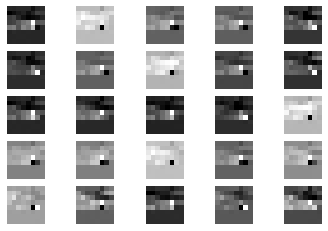

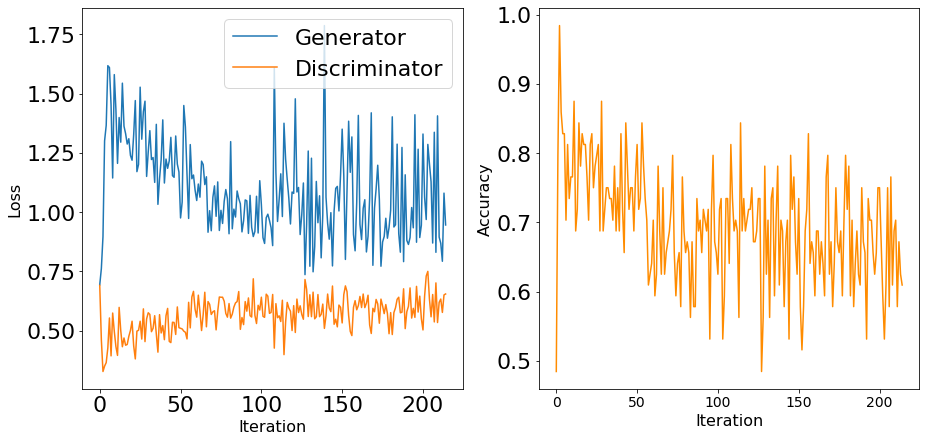

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21401 [D loss: 0.641027, acc.: 67.19%] [G loss: 0.913185]
21402 [D loss: 0.549009, acc.: 73.44%] [G loss: 0.949657]
21403 [D loss: 0.647280, acc.: 62.50%] [G loss: 1.006254]
21404 [D loss: 0.704753, acc.: 54.69%] [G loss: 0.884440]
21405 [D loss: 0.579169, acc.: 70.31%] [G loss: 0.908503]
21406 [D loss: 0.572014, acc.: 62.50%] [G loss: 0.999478]
21407 [D loss: 0.511405, acc.: 73.44%] [G loss: 1.391821]
21408 [D loss: 0.582874, acc.: 60.94%] [G loss: 1.060300]
21409 [D loss: 0.645066, acc.: 57.81%] [G loss: 1.059826]
21410 [D loss: 0.661977, acc.: 50.00%] [G loss: 0.977261]
21411 [D loss: 0.569276, acc.: 62.50%] [G loss: 1.488081]
21412 [D loss: 0.640489, acc.: 60.94%] [G loss: 0.904442]
21413 [D loss: 0.586584, acc.: 75.00%] [G loss: 0.880671]
21414 [D loss: 0.557111, acc.: 71.88%] [G loss: 1.184249]
21415 [D loss: 0.655186, acc.: 62.50%] [G loss: 0.915347]
21416 [D loss: 0.616615, acc.: 73.44%] [G loss: 0.882551]
21417 [D loss: 0.642733, acc.: 64.06%] [G loss: 1.222289]
21418 [D loss:

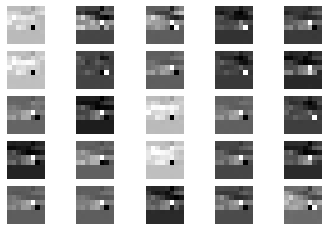

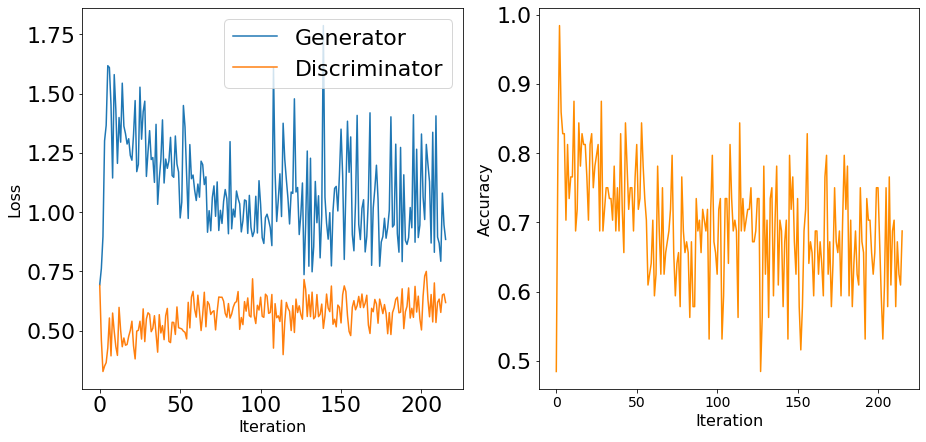

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21501 [D loss: 0.634454, acc.: 60.94%] [G loss: 0.862250]
21502 [D loss: 0.627929, acc.: 70.31%] [G loss: 0.900831]
21503 [D loss: 0.558951, acc.: 71.88%] [G loss: 0.963821]
21504 [D loss: 0.534880, acc.: 68.75%] [G loss: 1.276798]
21505 [D loss: 0.581669, acc.: 65.62%] [G loss: 0.923932]
21506 [D loss: 0.657193, acc.: 59.38%] [G loss: 0.684019]
21507 [D loss: 0.730328, acc.: 57.81%] [G loss: 0.980950]
21508 [D loss: 0.596738, acc.: 67.19%] [G loss: 0.958718]
21509 [D loss: 0.582490, acc.: 70.31%] [G loss: 1.003767]
21510 [D loss: 0.744254, acc.: 51.56%] [G loss: 0.873817]
21511 [D loss: 0.638634, acc.: 60.94%] [G loss: 1.191526]
21512 [D loss: 0.598952, acc.: 60.94%] [G loss: 0.995829]
21513 [D loss: 0.617061, acc.: 59.38%] [G loss: 1.227818]
21514 [D loss: 0.592770, acc.: 64.06%] [G loss: 1.412856]
21515 [D loss: 0.544565, acc.: 71.88%] [G loss: 1.101738]
21516 [D loss: 0.656361, acc.: 67.19%] [G loss: 0.894262]
21517 [D loss: 0.555060, acc.: 65.62%] [G loss: 0.988236]
21518 [D loss:

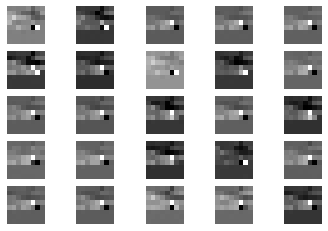

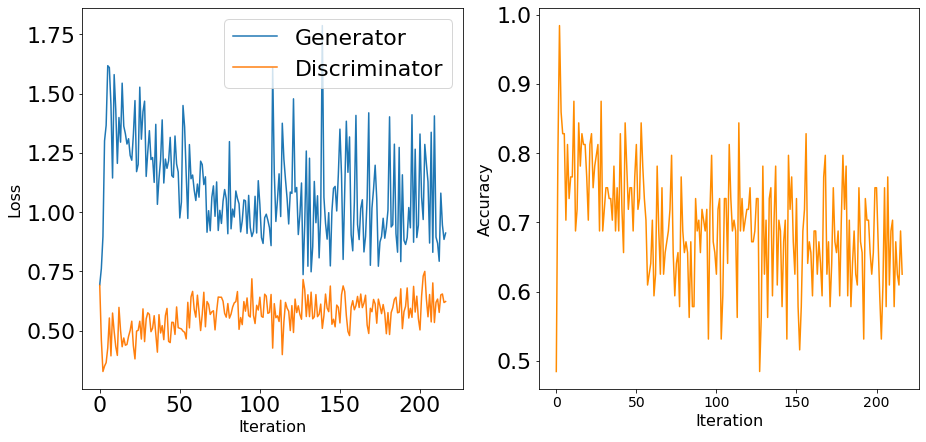

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21601 [D loss: 0.653695, acc.: 64.06%] [G loss: 0.852116]
21602 [D loss: 0.576589, acc.: 68.75%] [G loss: 0.876641]
21603 [D loss: 0.599880, acc.: 65.62%] [G loss: 1.014539]
21604 [D loss: 0.530650, acc.: 79.69%] [G loss: 1.381331]
21605 [D loss: 0.553666, acc.: 65.62%] [G loss: 2.069498]
21606 [D loss: 0.551620, acc.: 73.44%] [G loss: 1.439867]
21607 [D loss: 0.629934, acc.: 67.19%] [G loss: 0.857623]
21608 [D loss: 0.531015, acc.: 75.00%] [G loss: 1.112972]
21609 [D loss: 0.626783, acc.: 62.50%] [G loss: 0.812225]
21610 [D loss: 0.651540, acc.: 60.94%] [G loss: 0.797759]
21611 [D loss: 0.615429, acc.: 64.06%] [G loss: 0.865383]
21612 [D loss: 0.594578, acc.: 70.31%] [G loss: 0.842553]
21613 [D loss: 0.603644, acc.: 68.75%] [G loss: 0.994619]
21614 [D loss: 0.614486, acc.: 70.31%] [G loss: 0.926188]
21615 [D loss: 0.598020, acc.: 65.62%] [G loss: 0.920847]
21616 [D loss: 0.721219, acc.: 45.31%] [G loss: 0.917332]
21617 [D loss: 0.543383, acc.: 71.88%] [G loss: 1.130132]
21618 [D loss:

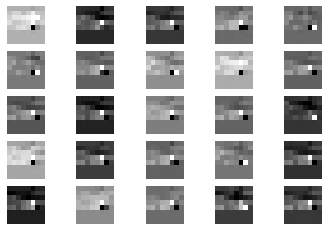

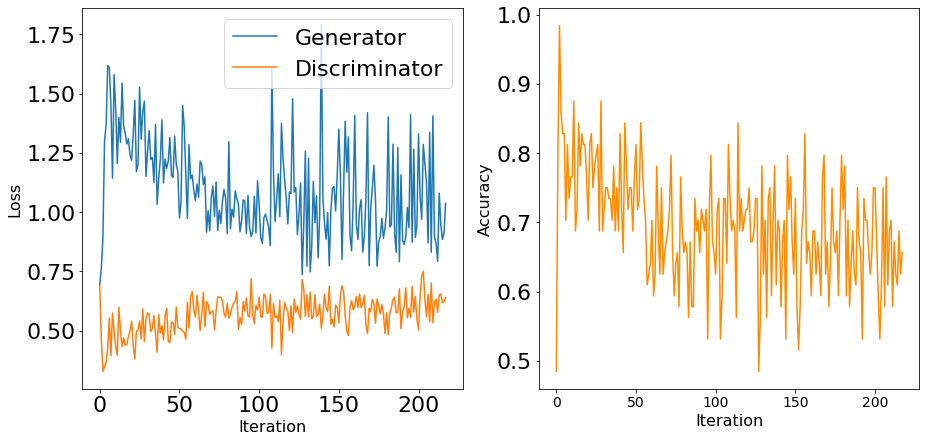

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21701 [D loss: 0.720318, acc.: 53.12%] [G loss: 0.869170]
21702 [D loss: 0.623051, acc.: 67.19%] [G loss: 0.824608]
21703 [D loss: 0.587253, acc.: 62.50%] [G loss: 0.806939]
21704 [D loss: 0.643547, acc.: 64.06%] [G loss: 0.965021]
21705 [D loss: 0.508745, acc.: 75.00%] [G loss: 1.255250]
21706 [D loss: 0.602753, acc.: 70.31%] [G loss: 0.916407]
21707 [D loss: 0.607829, acc.: 65.62%] [G loss: 0.886119]
21708 [D loss: 0.481568, acc.: 78.12%] [G loss: 1.333981]
21709 [D loss: 0.577224, acc.: 65.62%] [G loss: 1.354282]
21710 [D loss: 0.544669, acc.: 70.31%] [G loss: 1.895020]
21711 [D loss: 0.567151, acc.: 68.75%] [G loss: 1.311588]
21712 [D loss: 0.629763, acc.: 64.06%] [G loss: 0.854318]
21713 [D loss: 0.529902, acc.: 75.00%] [G loss: 1.070556]
21714 [D loss: 0.584246, acc.: 75.00%] [G loss: 1.042805]
21715 [D loss: 0.537274, acc.: 76.56%] [G loss: 1.802547]
21716 [D loss: 0.581919, acc.: 68.75%] [G loss: 1.111314]
21717 [D loss: 0.607899, acc.: 73.44%] [G loss: 0.716935]
21718 [D loss:

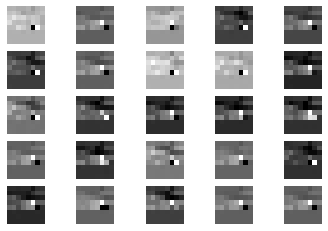

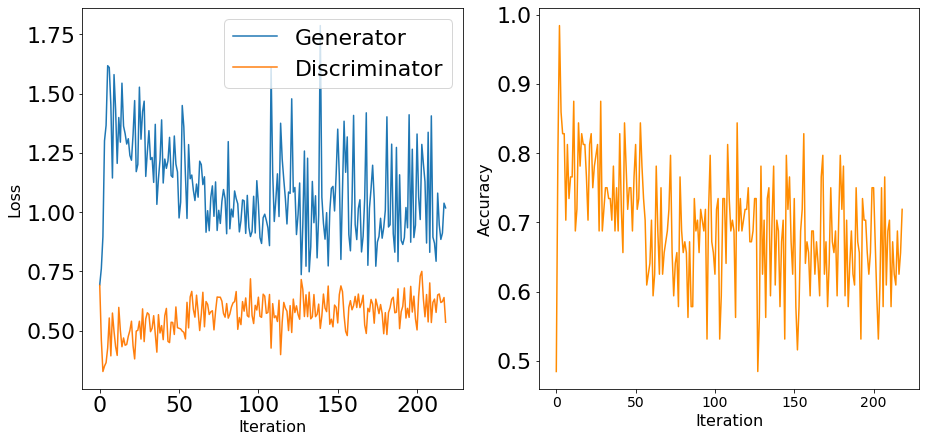

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21801 [D loss: 0.698425, acc.: 51.56%] [G loss: 1.044961]
21802 [D loss: 0.626183, acc.: 60.94%] [G loss: 1.678741]
21803 [D loss: 0.617458, acc.: 60.94%] [G loss: 1.196901]
21804 [D loss: 0.552911, acc.: 68.75%] [G loss: 1.533039]
21805 [D loss: 0.527082, acc.: 71.88%] [G loss: 1.296501]
21806 [D loss: 0.602247, acc.: 67.19%] [G loss: 0.713395]
21807 [D loss: 0.650023, acc.: 62.50%] [G loss: 0.960057]
21808 [D loss: 0.678969, acc.: 56.25%] [G loss: 0.924328]
21809 [D loss: 0.659886, acc.: 65.62%] [G loss: 0.781305]
21810 [D loss: 0.658636, acc.: 54.69%] [G loss: 0.905241]
21811 [D loss: 0.626732, acc.: 57.81%] [G loss: 0.749551]
21812 [D loss: 0.658868, acc.: 54.69%] [G loss: 0.727690]
21813 [D loss: 0.653538, acc.: 60.94%] [G loss: 0.845840]
21814 [D loss: 0.684075, acc.: 57.81%] [G loss: 0.934086]
21815 [D loss: 0.631354, acc.: 57.81%] [G loss: 0.982311]
21816 [D loss: 0.572137, acc.: 67.19%] [G loss: 1.051402]
21817 [D loss: 0.541491, acc.: 78.12%] [G loss: 0.999258]
21818 [D loss:

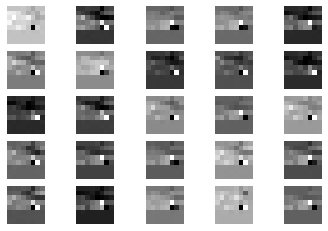

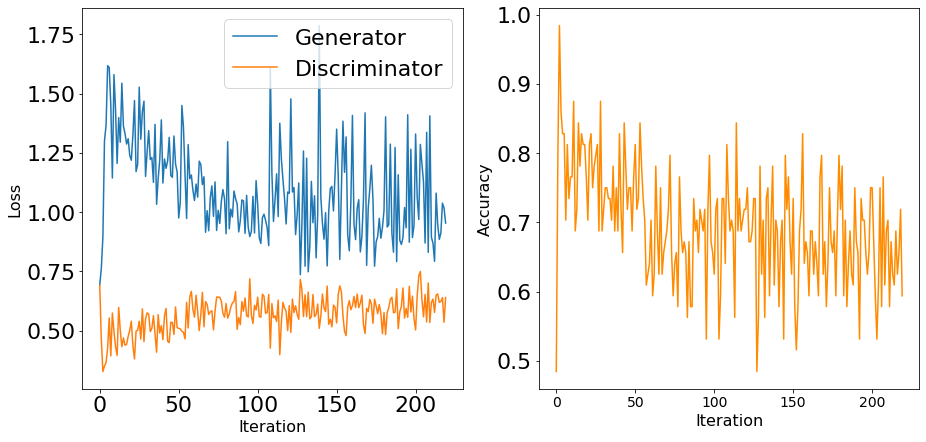

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


21901 [D loss: 0.669834, acc.: 65.62%] [G loss: 0.855587]
21902 [D loss: 0.634772, acc.: 60.94%] [G loss: 0.849572]
21903 [D loss: 0.607019, acc.: 67.19%] [G loss: 0.982116]
21904 [D loss: 0.534675, acc.: 70.31%] [G loss: 1.080415]
21905 [D loss: 0.602915, acc.: 62.50%] [G loss: 0.925656]
21906 [D loss: 0.578831, acc.: 60.94%] [G loss: 0.905340]
21907 [D loss: 0.603425, acc.: 65.62%] [G loss: 0.730914]
21908 [D loss: 0.619630, acc.: 64.06%] [G loss: 0.872893]
21909 [D loss: 0.636604, acc.: 67.19%] [G loss: 0.918923]
21910 [D loss: 0.565611, acc.: 67.19%] [G loss: 1.044642]
21911 [D loss: 0.660989, acc.: 62.50%] [G loss: 0.932411]
21912 [D loss: 0.619934, acc.: 65.62%] [G loss: 0.982692]
21913 [D loss: 0.635061, acc.: 64.06%] [G loss: 0.984553]
21914 [D loss: 0.603369, acc.: 71.88%] [G loss: 0.915304]
21915 [D loss: 0.577380, acc.: 64.06%] [G loss: 1.059419]
21916 [D loss: 0.718384, acc.: 48.44%] [G loss: 0.782561]
21917 [D loss: 0.645096, acc.: 60.94%] [G loss: 0.912494]
21918 [D loss:

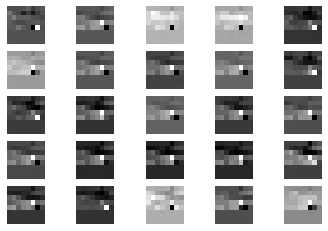

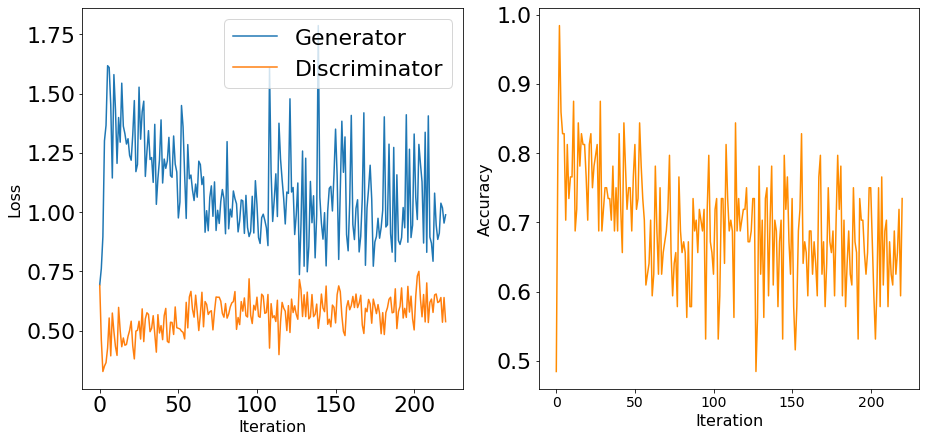

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22001 [D loss: 0.576719, acc.: 67.19%] [G loss: 0.917197]
22002 [D loss: 0.628062, acc.: 64.06%] [G loss: 0.810109]
22003 [D loss: 0.647944, acc.: 54.69%] [G loss: 0.761456]
22004 [D loss: 0.666330, acc.: 62.50%] [G loss: 0.923807]
22005 [D loss: 0.666182, acc.: 60.94%] [G loss: 0.833224]
22006 [D loss: 0.592547, acc.: 75.00%] [G loss: 1.022368]
22007 [D loss: 0.675846, acc.: 59.38%] [G loss: 0.772970]
22008 [D loss: 0.680650, acc.: 64.06%] [G loss: 0.831247]
22009 [D loss: 0.577666, acc.: 64.06%] [G loss: 0.804542]
22010 [D loss: 0.614520, acc.: 64.06%] [G loss: 1.024945]
22011 [D loss: 0.526810, acc.: 79.69%] [G loss: 1.181857]
22012 [D loss: 0.590032, acc.: 57.81%] [G loss: 1.052680]
22013 [D loss: 0.680962, acc.: 59.38%] [G loss: 1.083313]
22014 [D loss: 0.624564, acc.: 59.38%] [G loss: 1.189983]
22015 [D loss: 0.518747, acc.: 75.00%] [G loss: 1.143227]
22016 [D loss: 0.667603, acc.: 57.81%] [G loss: 1.024513]
22017 [D loss: 0.557940, acc.: 73.44%] [G loss: 0.904957]
22018 [D loss:

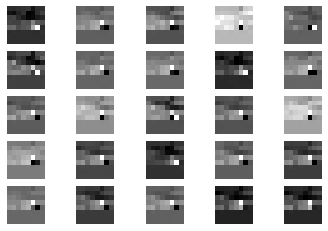

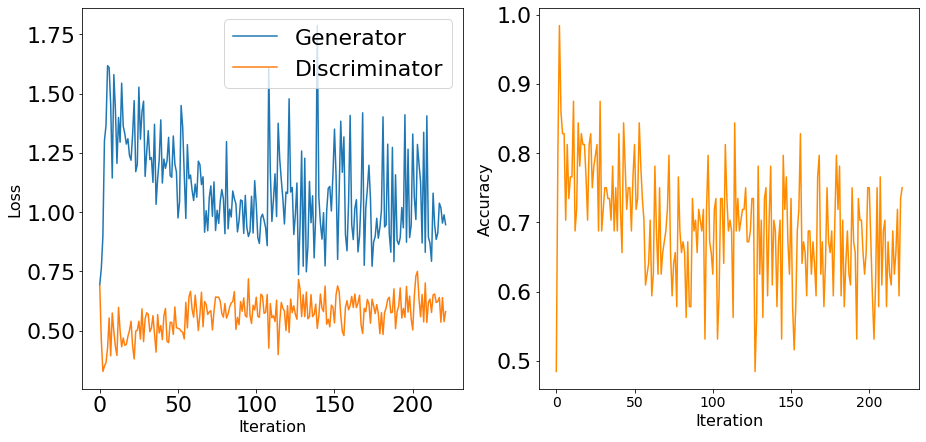

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22101 [D loss: 0.582274, acc.: 75.00%] [G loss: 0.882670]
22102 [D loss: 0.653885, acc.: 54.69%] [G loss: 0.781599]
22103 [D loss: 0.609989, acc.: 75.00%] [G loss: 1.084677]
22104 [D loss: 0.597429, acc.: 68.75%] [G loss: 1.037111]
22105 [D loss: 0.595318, acc.: 59.38%] [G loss: 0.865695]
22106 [D loss: 0.595392, acc.: 70.31%] [G loss: 0.856897]
22107 [D loss: 0.550370, acc.: 78.12%] [G loss: 0.946879]
22108 [D loss: 0.732261, acc.: 56.25%] [G loss: 0.876580]
22109 [D loss: 0.674037, acc.: 64.06%] [G loss: 1.124475]
22110 [D loss: 0.527967, acc.: 76.56%] [G loss: 1.264263]
22111 [D loss: 0.472225, acc.: 78.12%] [G loss: 1.434347]
22112 [D loss: 0.588985, acc.: 64.06%] [G loss: 0.985608]
22113 [D loss: 0.438528, acc.: 79.69%] [G loss: 1.723128]
22114 [D loss: 0.615762, acc.: 65.62%] [G loss: 0.951174]
22115 [D loss: 0.586271, acc.: 76.56%] [G loss: 1.019352]
22116 [D loss: 0.531591, acc.: 78.12%] [G loss: 1.015905]
22117 [D loss: 0.656547, acc.: 59.38%] [G loss: 0.908781]
22118 [D loss:

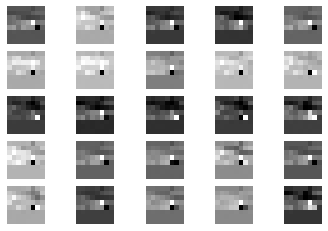

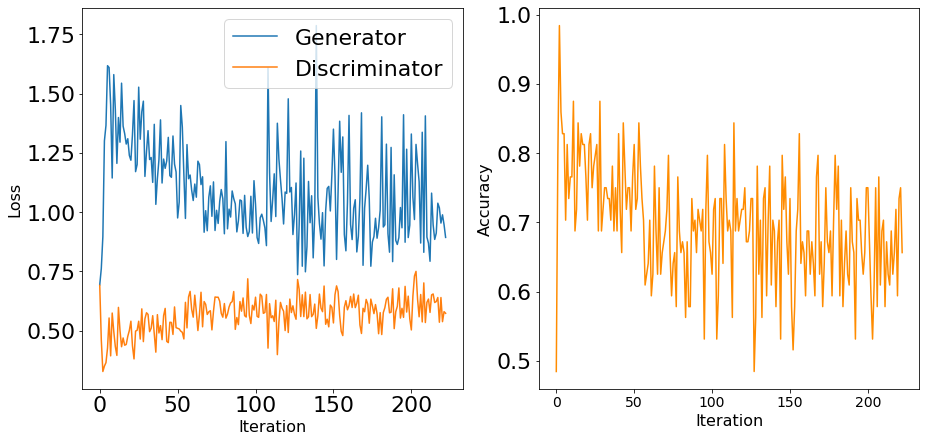

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22201 [D loss: 0.585472, acc.: 68.75%] [G loss: 0.844465]
22202 [D loss: 0.580573, acc.: 68.75%] [G loss: 0.959229]
22203 [D loss: 0.666496, acc.: 59.38%] [G loss: 0.868840]
22204 [D loss: 0.667781, acc.: 53.12%] [G loss: 0.944473]
22205 [D loss: 0.639522, acc.: 65.62%] [G loss: 0.830676]
22206 [D loss: 0.592445, acc.: 73.44%] [G loss: 0.815195]
22207 [D loss: 0.576056, acc.: 67.19%] [G loss: 0.947178]
22208 [D loss: 0.534756, acc.: 68.75%] [G loss: 1.240538]
22209 [D loss: 0.577965, acc.: 71.88%] [G loss: 1.534564]
22210 [D loss: 0.572032, acc.: 73.44%] [G loss: 1.071752]
22211 [D loss: 0.609719, acc.: 65.62%] [G loss: 0.960669]
22212 [D loss: 0.543667, acc.: 65.62%] [G loss: 1.263714]
22213 [D loss: 0.518909, acc.: 68.75%] [G loss: 2.317475]
22214 [D loss: 0.492373, acc.: 70.31%] [G loss: 1.410647]
22215 [D loss: 0.540439, acc.: 76.56%] [G loss: 1.043336]
22216 [D loss: 0.583410, acc.: 65.62%] [G loss: 1.313034]
22217 [D loss: 0.616217, acc.: 70.31%] [G loss: 0.886007]
22218 [D loss:

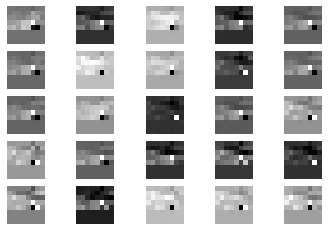

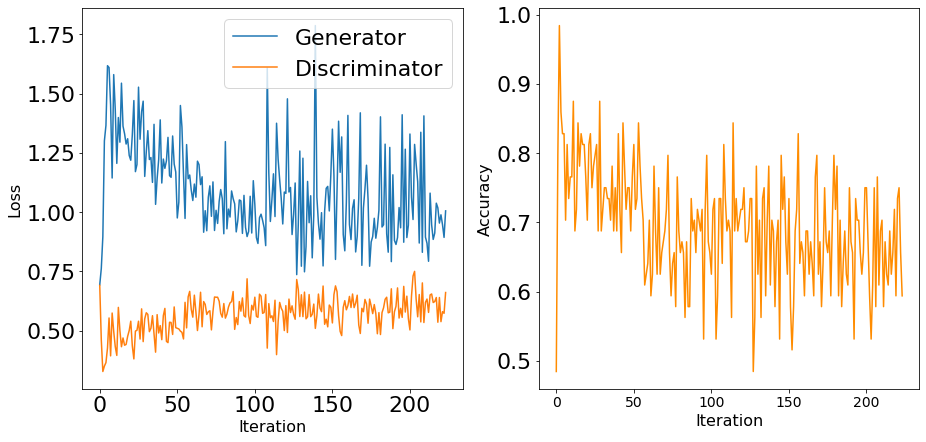

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22301 [D loss: 0.558427, acc.: 70.31%] [G loss: 1.078895]
22302 [D loss: 0.571518, acc.: 64.06%] [G loss: 0.980426]
22303 [D loss: 0.624238, acc.: 64.06%] [G loss: 0.775683]
22304 [D loss: 0.575341, acc.: 65.62%] [G loss: 0.899472]
22305 [D loss: 0.635966, acc.: 64.06%] [G loss: 0.736341]
22306 [D loss: 0.511101, acc.: 76.56%] [G loss: 1.154395]
22307 [D loss: 0.517242, acc.: 73.44%] [G loss: 1.320412]
22308 [D loss: 0.514621, acc.: 73.44%] [G loss: 1.330578]
22309 [D loss: 0.641097, acc.: 64.06%] [G loss: 1.050272]
22310 [D loss: 0.642179, acc.: 57.81%] [G loss: 0.924819]
22311 [D loss: 0.619411, acc.: 65.62%] [G loss: 1.680999]
22312 [D loss: 0.522918, acc.: 71.88%] [G loss: 2.615220]
22313 [D loss: 0.542783, acc.: 73.44%] [G loss: 1.211465]
22314 [D loss: 0.637734, acc.: 60.94%] [G loss: 0.957187]
22315 [D loss: 0.591323, acc.: 64.06%] [G loss: 1.093618]
22316 [D loss: 0.459669, acc.: 82.81%] [G loss: 0.941460]
22317 [D loss: 0.593054, acc.: 67.19%] [G loss: 0.832328]
22318 [D loss:

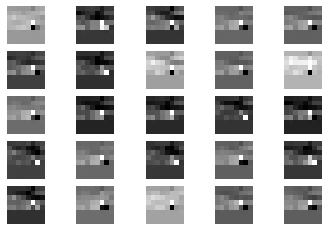

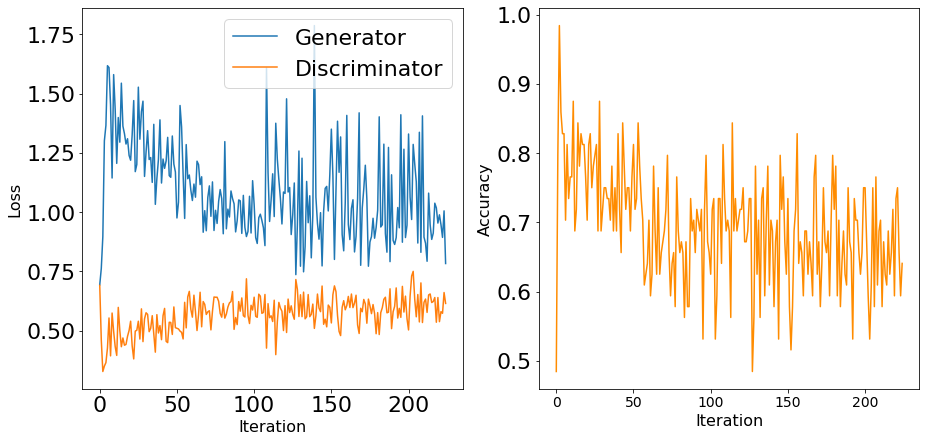

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22401 [D loss: 0.619440, acc.: 65.62%] [G loss: 0.832048]
22402 [D loss: 0.675224, acc.: 57.81%] [G loss: 0.890091]
22403 [D loss: 0.627874, acc.: 65.62%] [G loss: 0.818560]
22404 [D loss: 0.581127, acc.: 68.75%] [G loss: 0.882604]
22405 [D loss: 0.593779, acc.: 68.75%] [G loss: 1.088762]
22406 [D loss: 0.629778, acc.: 60.94%] [G loss: 0.671310]
22407 [D loss: 0.590166, acc.: 68.75%] [G loss: 0.911489]
22408 [D loss: 0.646544, acc.: 60.94%] [G loss: 0.905901]
22409 [D loss: 0.608986, acc.: 62.50%] [G loss: 1.009130]
22410 [D loss: 0.511265, acc.: 82.81%] [G loss: 1.553134]
22411 [D loss: 0.482682, acc.: 76.56%] [G loss: 1.213610]
22412 [D loss: 0.677023, acc.: 64.06%] [G loss: 0.791937]
22413 [D loss: 0.622971, acc.: 67.19%] [G loss: 1.313059]
22414 [D loss: 0.647962, acc.: 57.81%] [G loss: 1.115527]
22415 [D loss: 0.683138, acc.: 64.06%] [G loss: 0.806667]
22416 [D loss: 0.553170, acc.: 68.75%] [G loss: 1.404210]
22417 [D loss: 0.601093, acc.: 67.19%] [G loss: 0.713466]
22418 [D loss:

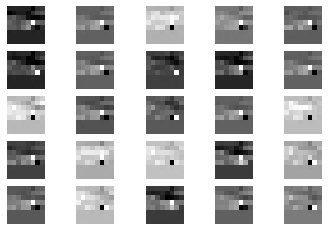

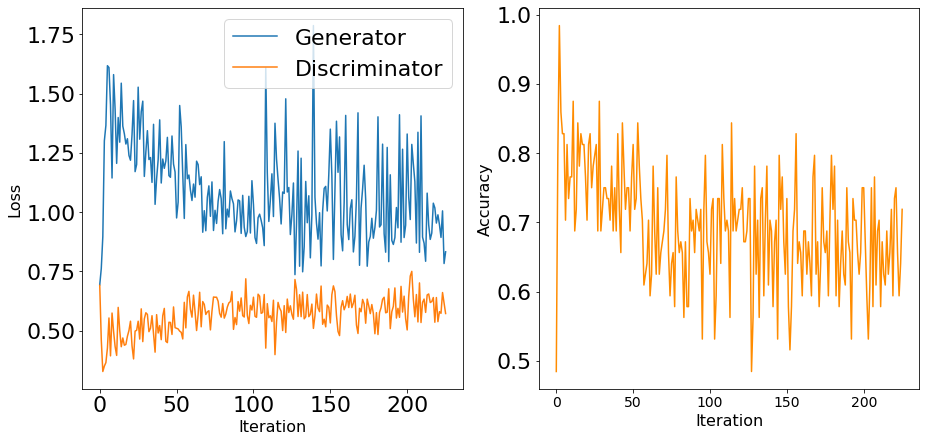

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22501 [D loss: 0.570272, acc.: 71.88%] [G loss: 0.834724]
22502 [D loss: 0.659383, acc.: 62.50%] [G loss: 0.944472]
22503 [D loss: 0.588983, acc.: 73.44%] [G loss: 0.937798]
22504 [D loss: 0.683082, acc.: 60.94%] [G loss: 1.002796]
22505 [D loss: 0.660527, acc.: 56.25%] [G loss: 0.713577]
22506 [D loss: 0.577244, acc.: 67.19%] [G loss: 0.965039]
22507 [D loss: 0.673723, acc.: 54.69%] [G loss: 0.980540]
22508 [D loss: 0.542784, acc.: 70.31%] [G loss: 0.826021]
22509 [D loss: 0.733419, acc.: 48.44%] [G loss: 0.894068]
22510 [D loss: 0.547780, acc.: 76.56%] [G loss: 1.178680]
22511 [D loss: 0.547307, acc.: 73.44%] [G loss: 1.293871]
22512 [D loss: 0.652089, acc.: 60.94%] [G loss: 0.796241]
22513 [D loss: 0.663508, acc.: 57.81%] [G loss: 0.957180]
22514 [D loss: 0.564611, acc.: 70.31%] [G loss: 0.895071]
22515 [D loss: 0.547717, acc.: 73.44%] [G loss: 0.921366]
22516 [D loss: 0.649622, acc.: 62.50%] [G loss: 0.866789]
22517 [D loss: 0.621892, acc.: 65.62%] [G loss: 0.984438]
22518 [D loss:

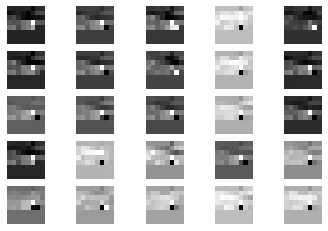

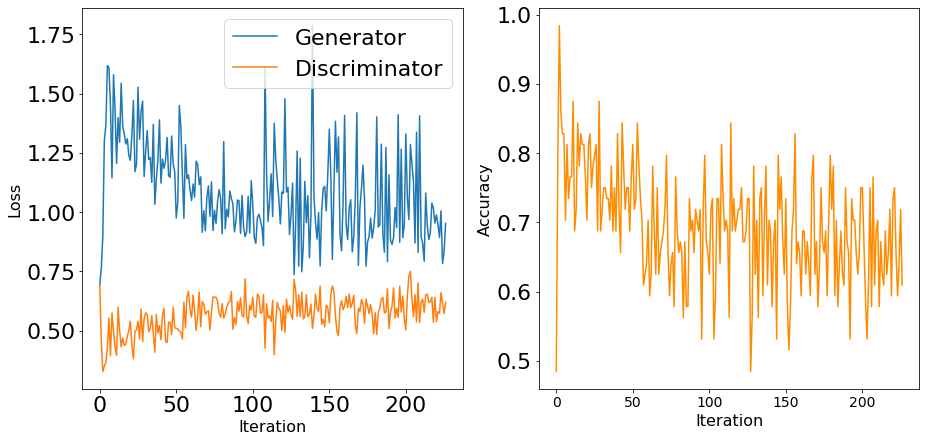

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22601 [D loss: 0.650871, acc.: 62.50%] [G loss: 0.830145]
22602 [D loss: 0.673937, acc.: 54.69%] [G loss: 0.715274]
22603 [D loss: 0.665194, acc.: 62.50%] [G loss: 0.737661]
22604 [D loss: 0.622523, acc.: 68.75%] [G loss: 0.912678]
22605 [D loss: 0.537639, acc.: 71.88%] [G loss: 1.105672]
22606 [D loss: 0.550256, acc.: 68.75%] [G loss: 1.402499]
22607 [D loss: 0.578967, acc.: 70.31%] [G loss: 1.229331]
22608 [D loss: 0.675270, acc.: 56.25%] [G loss: 0.851699]
22609 [D loss: 0.620013, acc.: 56.25%] [G loss: 0.920656]
22610 [D loss: 0.590770, acc.: 59.38%] [G loss: 1.308628]
22611 [D loss: 0.590465, acc.: 65.62%] [G loss: 1.213482]
22612 [D loss: 0.682311, acc.: 53.12%] [G loss: 0.872687]
22613 [D loss: 0.635978, acc.: 70.31%] [G loss: 0.801304]
22614 [D loss: 0.664809, acc.: 60.94%] [G loss: 0.817110]
22615 [D loss: 0.562674, acc.: 75.00%] [G loss: 1.037643]
22616 [D loss: 0.580653, acc.: 70.31%] [G loss: 1.237458]
22617 [D loss: 0.563382, acc.: 75.00%] [G loss: 0.952309]
22618 [D loss:

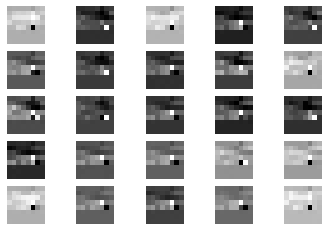

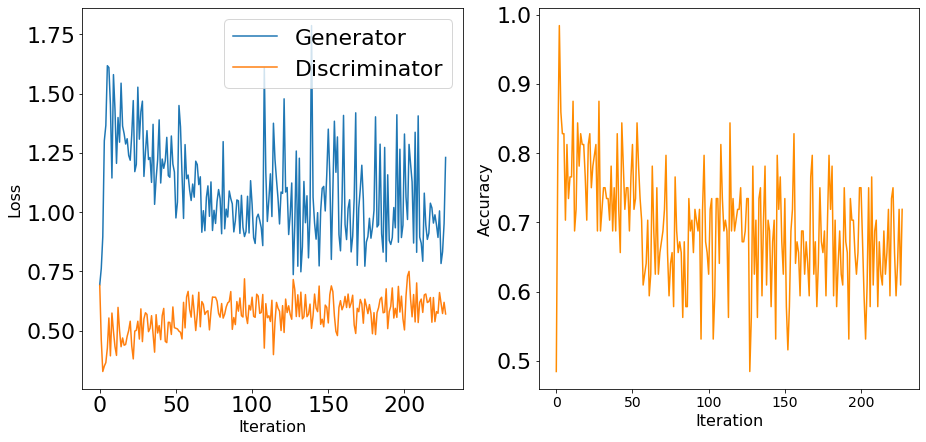

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22701 [D loss: 0.613703, acc.: 62.50%] [G loss: 0.907725]
22702 [D loss: 0.566163, acc.: 73.44%] [G loss: 0.866000]
22703 [D loss: 0.658331, acc.: 65.62%] [G loss: 0.836165]
22704 [D loss: 0.693934, acc.: 48.44%] [G loss: 0.857954]
22705 [D loss: 0.628664, acc.: 67.19%] [G loss: 1.027559]
22706 [D loss: 0.513435, acc.: 75.00%] [G loss: 1.489978]
22707 [D loss: 0.583613, acc.: 71.88%] [G loss: 1.269926]
22708 [D loss: 0.586847, acc.: 68.75%] [G loss: 0.973879]
22709 [D loss: 0.667926, acc.: 59.38%] [G loss: 0.846434]
22710 [D loss: 0.632090, acc.: 64.06%] [G loss: 0.889543]
22711 [D loss: 0.516944, acc.: 73.44%] [G loss: 1.257826]
22712 [D loss: 0.540060, acc.: 70.31%] [G loss: 1.137489]
22713 [D loss: 0.660278, acc.: 59.38%] [G loss: 0.797338]
22714 [D loss: 0.477344, acc.: 78.12%] [G loss: 1.251196]
22715 [D loss: 0.603155, acc.: 64.06%] [G loss: 0.864609]
22716 [D loss: 0.642045, acc.: 64.06%] [G loss: 0.863643]
22717 [D loss: 0.720001, acc.: 53.12%] [G loss: 0.901320]
22718 [D loss:

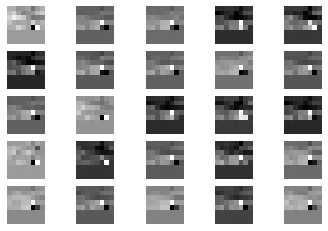

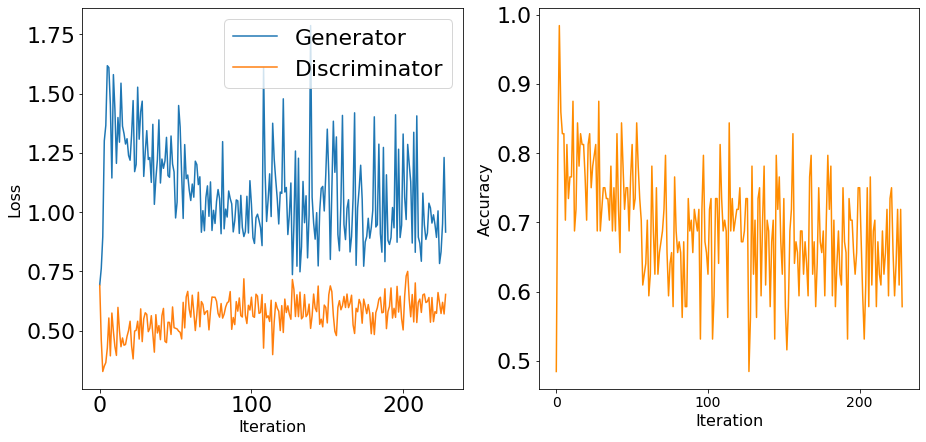

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22801 [D loss: 0.596655, acc.: 70.31%] [G loss: 0.843510]
22802 [D loss: 0.621623, acc.: 62.50%] [G loss: 0.957788]
22803 [D loss: 0.660457, acc.: 60.94%] [G loss: 0.841164]
22804 [D loss: 0.630843, acc.: 70.31%] [G loss: 0.863712]
22805 [D loss: 0.611388, acc.: 59.38%] [G loss: 0.995185]
22806 [D loss: 0.571951, acc.: 67.19%] [G loss: 1.274426]
22807 [D loss: 0.671867, acc.: 57.81%] [G loss: 1.024700]
22808 [D loss: 0.579251, acc.: 71.88%] [G loss: 1.076744]
22809 [D loss: 0.658290, acc.: 57.81%] [G loss: 0.902858]
22810 [D loss: 0.662869, acc.: 59.38%] [G loss: 0.913832]
22811 [D loss: 0.597921, acc.: 62.50%] [G loss: 0.804828]
22812 [D loss: 0.653954, acc.: 59.38%] [G loss: 0.763843]
22813 [D loss: 0.623771, acc.: 67.19%] [G loss: 0.917318]
22814 [D loss: 0.616059, acc.: 70.31%] [G loss: 0.960629]
22815 [D loss: 0.594351, acc.: 68.75%] [G loss: 0.945255]
22816 [D loss: 0.560288, acc.: 71.88%] [G loss: 1.431206]
22817 [D loss: 0.560979, acc.: 75.00%] [G loss: 1.101338]
22818 [D loss:

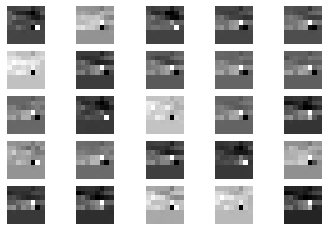

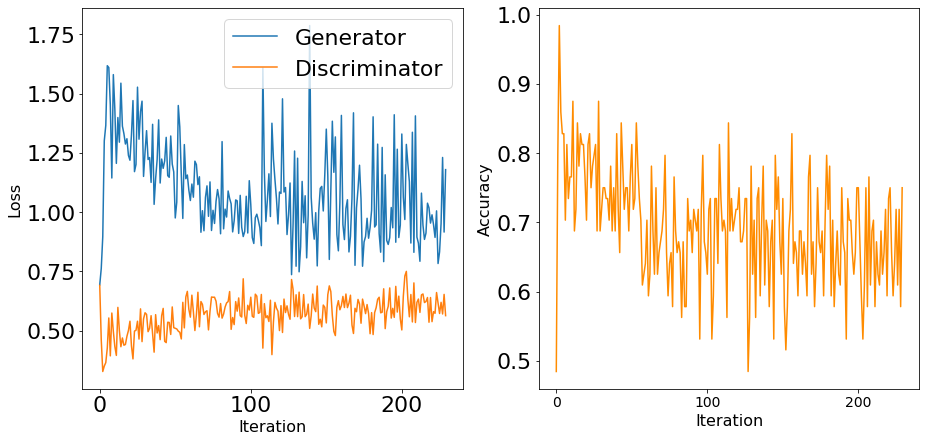

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


22901 [D loss: 0.473389, acc.: 76.56%] [G loss: 1.548664]
22902 [D loss: 0.524515, acc.: 75.00%] [G loss: 1.410464]
22903 [D loss: 0.520082, acc.: 71.88%] [G loss: 1.505696]
22904 [D loss: 0.478230, acc.: 79.69%] [G loss: 1.053753]
22905 [D loss: 0.521898, acc.: 76.56%] [G loss: 1.597976]
22906 [D loss: 0.699255, acc.: 59.38%] [G loss: 0.936746]
22907 [D loss: 0.622214, acc.: 64.06%] [G loss: 1.169313]
22908 [D loss: 0.581928, acc.: 71.88%] [G loss: 0.913538]
22909 [D loss: 0.601716, acc.: 60.94%] [G loss: 1.093047]
22910 [D loss: 0.643880, acc.: 67.19%] [G loss: 0.898759]
22911 [D loss: 0.677899, acc.: 57.81%] [G loss: 0.844221]
22912 [D loss: 0.680625, acc.: 57.81%] [G loss: 0.855614]
22913 [D loss: 0.621597, acc.: 70.31%] [G loss: 1.218744]
22914 [D loss: 0.516179, acc.: 73.44%] [G loss: 1.500399]
22915 [D loss: 0.570985, acc.: 71.88%] [G loss: 1.084051]
22916 [D loss: 0.517074, acc.: 76.56%] [G loss: 1.056064]
22917 [D loss: 0.662338, acc.: 54.69%] [G loss: 1.066306]
22918 [D loss:

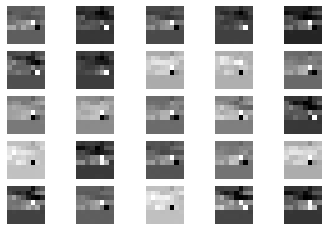

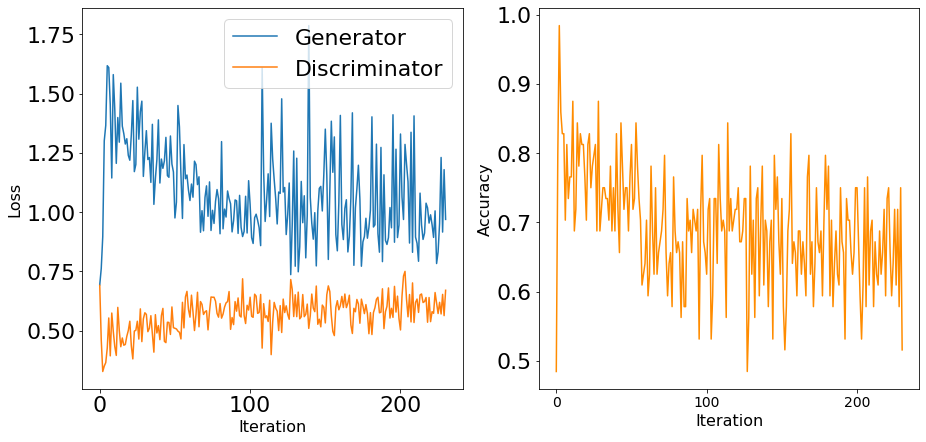

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23001 [D loss: 0.655244, acc.: 62.50%] [G loss: 0.844655]
23002 [D loss: 0.578272, acc.: 60.94%] [G loss: 1.013866]
23003 [D loss: 0.640544, acc.: 59.38%] [G loss: 0.992617]
23004 [D loss: 0.604301, acc.: 71.88%] [G loss: 0.793407]
23005 [D loss: 0.583475, acc.: 70.31%] [G loss: 0.871377]
23006 [D loss: 0.641281, acc.: 62.50%] [G loss: 0.923522]
23007 [D loss: 0.631241, acc.: 60.94%] [G loss: 0.966953]
23008 [D loss: 0.575646, acc.: 70.31%] [G loss: 0.981924]
23009 [D loss: 0.658131, acc.: 56.25%] [G loss: 1.024703]
23010 [D loss: 0.624160, acc.: 64.06%] [G loss: 0.779382]
23011 [D loss: 0.645949, acc.: 65.62%] [G loss: 0.879011]
23012 [D loss: 0.581148, acc.: 68.75%] [G loss: 1.131066]
23013 [D loss: 0.485869, acc.: 73.44%] [G loss: 1.486040]
23014 [D loss: 0.619149, acc.: 56.25%] [G loss: 1.139330]
23015 [D loss: 0.626823, acc.: 60.94%] [G loss: 1.008122]
23016 [D loss: 0.643414, acc.: 60.94%] [G loss: 0.979774]
23017 [D loss: 0.523330, acc.: 75.00%] [G loss: 1.638299]
23018 [D loss:

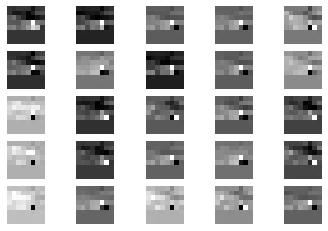

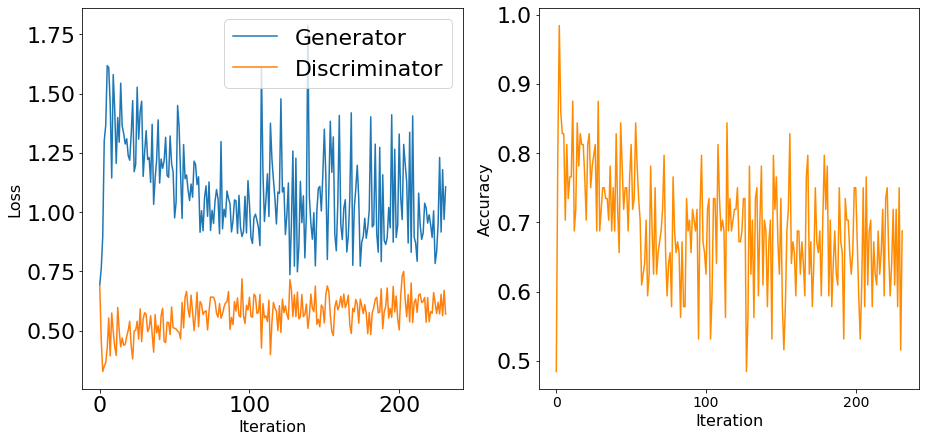

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23101 [D loss: 0.597728, acc.: 68.75%] [G loss: 0.795166]
23102 [D loss: 0.504193, acc.: 81.25%] [G loss: 1.046799]
23103 [D loss: 0.651048, acc.: 62.50%] [G loss: 1.131222]
23104 [D loss: 0.540694, acc.: 71.88%] [G loss: 1.591951]
23105 [D loss: 0.644682, acc.: 62.50%] [G loss: 1.209825]
23106 [D loss: 0.542785, acc.: 78.12%] [G loss: 1.059919]
23107 [D loss: 0.618211, acc.: 56.25%] [G loss: 0.841451]
23108 [D loss: 0.593319, acc.: 65.62%] [G loss: 0.978364]
23109 [D loss: 0.557689, acc.: 76.56%] [G loss: 1.077330]
23110 [D loss: 0.563017, acc.: 76.56%] [G loss: 1.133324]
23111 [D loss: 0.673956, acc.: 60.94%] [G loss: 0.837230]
23112 [D loss: 0.499958, acc.: 78.12%] [G loss: 1.011221]
23113 [D loss: 0.605011, acc.: 68.75%] [G loss: 1.229794]
23114 [D loss: 0.558281, acc.: 70.31%] [G loss: 1.156509]
23115 [D loss: 0.602959, acc.: 65.62%] [G loss: 0.932093]
23116 [D loss: 0.540039, acc.: 76.56%] [G loss: 1.123165]
23117 [D loss: 0.659537, acc.: 56.25%] [G loss: 0.888366]
23118 [D loss:

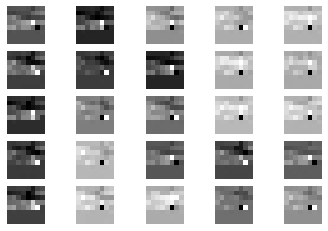

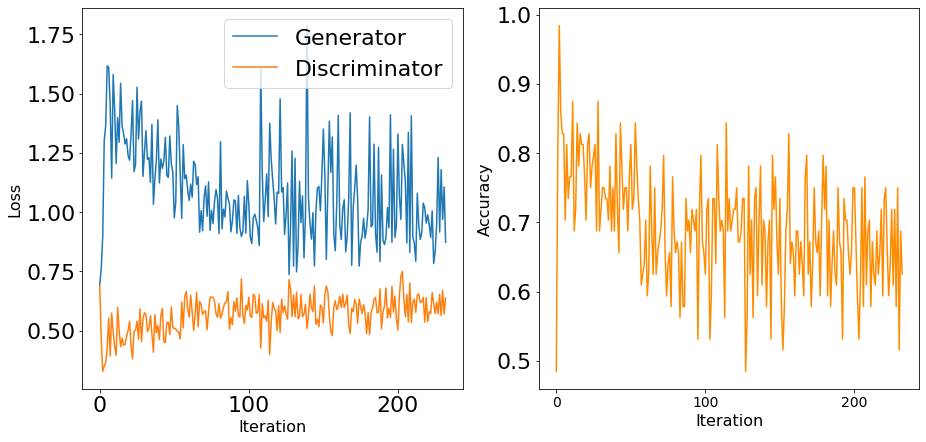

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23201 [D loss: 0.710996, acc.: 53.12%] [G loss: 0.844703]
23202 [D loss: 0.688975, acc.: 54.69%] [G loss: 1.078361]
23203 [D loss: 0.667768, acc.: 57.81%] [G loss: 0.798641]
23204 [D loss: 0.522910, acc.: 71.88%] [G loss: 1.222166]
23205 [D loss: 0.578352, acc.: 62.50%] [G loss: 1.172481]
23206 [D loss: 0.674227, acc.: 53.12%] [G loss: 0.853691]
23207 [D loss: 0.669161, acc.: 54.69%] [G loss: 1.040019]
23208 [D loss: 0.641787, acc.: 60.94%] [G loss: 1.043667]
23209 [D loss: 0.619815, acc.: 64.06%] [G loss: 0.917852]
23210 [D loss: 0.555351, acc.: 75.00%] [G loss: 1.003268]
23211 [D loss: 0.652396, acc.: 53.12%] [G loss: 0.945976]
23212 [D loss: 0.540962, acc.: 71.88%] [G loss: 1.337023]
23213 [D loss: 0.586984, acc.: 75.00%] [G loss: 1.142924]
23214 [D loss: 0.645569, acc.: 62.50%] [G loss: 0.845571]
23215 [D loss: 0.573051, acc.: 67.19%] [G loss: 0.890697]
23216 [D loss: 0.664432, acc.: 56.25%] [G loss: 0.896131]
23217 [D loss: 0.584166, acc.: 71.88%] [G loss: 0.973717]
23218 [D loss:

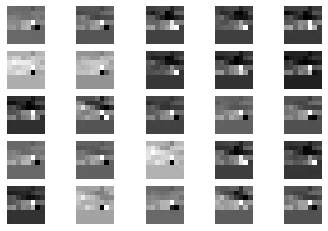

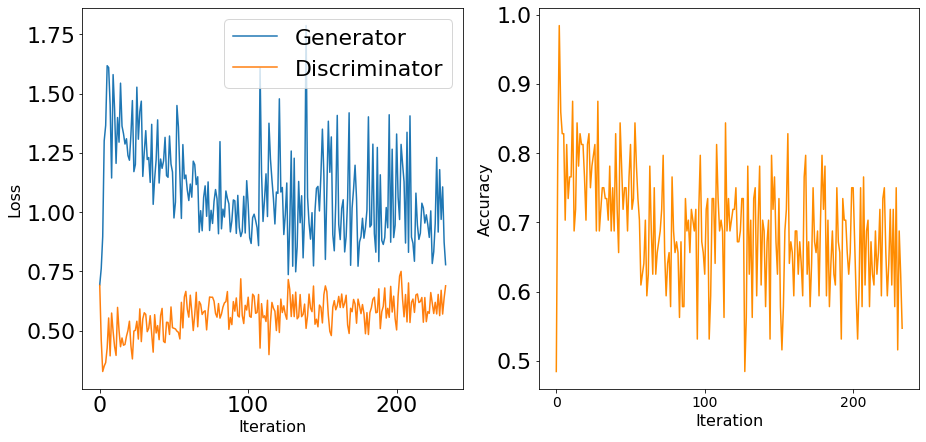

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23301 [D loss: 0.601258, acc.: 62.50%] [G loss: 0.980580]
23302 [D loss: 0.605848, acc.: 65.62%] [G loss: 0.845427]
23303 [D loss: 0.591085, acc.: 70.31%] [G loss: 0.847316]
23304 [D loss: 0.663069, acc.: 62.50%] [G loss: 0.849185]
23305 [D loss: 0.616368, acc.: 62.50%] [G loss: 0.946669]
23306 [D loss: 0.603425, acc.: 70.31%] [G loss: 0.880403]
23307 [D loss: 0.663040, acc.: 57.81%] [G loss: 1.357638]
23308 [D loss: 0.497404, acc.: 70.31%] [G loss: 1.271014]
23309 [D loss: 0.645183, acc.: 57.81%] [G loss: 0.762408]
23310 [D loss: 0.597008, acc.: 64.06%] [G loss: 0.756831]
23311 [D loss: 0.527720, acc.: 82.81%] [G loss: 0.895835]
23312 [D loss: 0.576651, acc.: 68.75%] [G loss: 0.929550]
23313 [D loss: 0.596383, acc.: 71.88%] [G loss: 0.882828]
23314 [D loss: 0.483141, acc.: 76.56%] [G loss: 1.286412]
23315 [D loss: 0.605667, acc.: 65.62%] [G loss: 0.987672]
23316 [D loss: 0.581304, acc.: 70.31%] [G loss: 0.979521]
23317 [D loss: 0.593802, acc.: 71.88%] [G loss: 1.038170]
23318 [D loss:

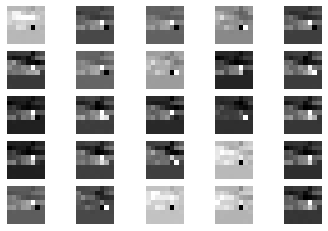

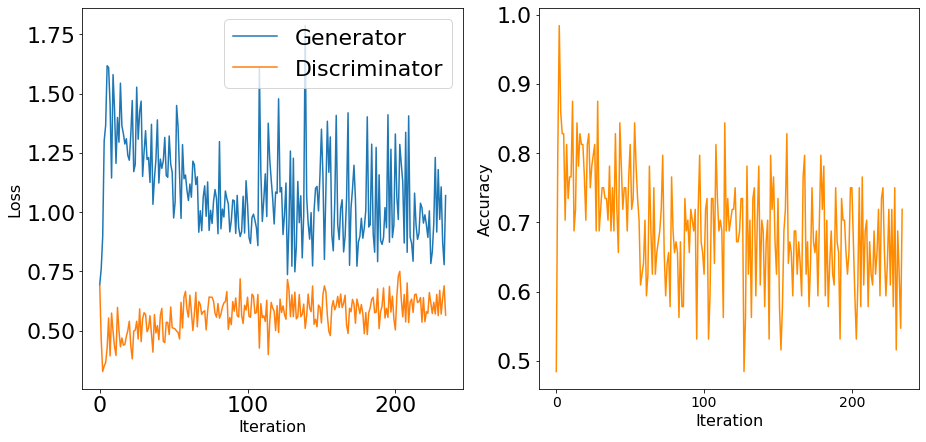

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23401 [D loss: 0.621935, acc.: 65.62%] [G loss: 0.938713]
23402 [D loss: 0.602774, acc.: 62.50%] [G loss: 1.219035]
23403 [D loss: 0.532569, acc.: 71.88%] [G loss: 1.241137]
23404 [D loss: 0.562795, acc.: 71.88%] [G loss: 0.896164]
23405 [D loss: 0.612667, acc.: 70.31%] [G loss: 0.935970]
23406 [D loss: 0.610303, acc.: 60.94%] [G loss: 0.924143]
23407 [D loss: 0.567737, acc.: 78.12%] [G loss: 0.906138]
23408 [D loss: 0.627526, acc.: 60.94%] [G loss: 0.905750]
23409 [D loss: 0.683277, acc.: 50.00%] [G loss: 0.766501]
23410 [D loss: 0.593898, acc.: 67.19%] [G loss: 0.965777]
23411 [D loss: 0.664411, acc.: 53.12%] [G loss: 0.984613]
23412 [D loss: 0.587397, acc.: 67.19%] [G loss: 0.958382]
23413 [D loss: 0.620070, acc.: 62.50%] [G loss: 0.760148]
23414 [D loss: 0.595578, acc.: 70.31%] [G loss: 1.053614]
23415 [D loss: 0.589029, acc.: 73.44%] [G loss: 0.908230]
23416 [D loss: 0.618563, acc.: 68.75%] [G loss: 0.940179]
23417 [D loss: 0.566339, acc.: 70.31%] [G loss: 1.240444]
23418 [D loss:

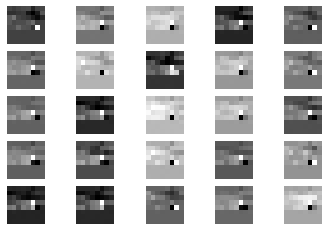

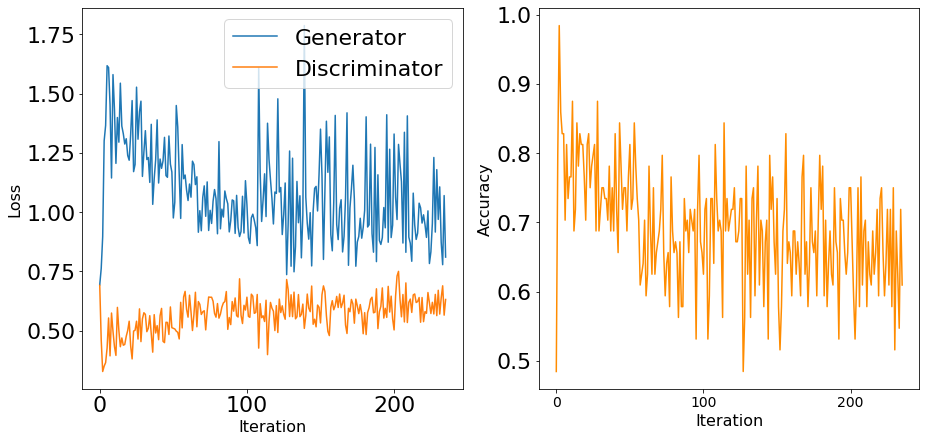

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23501 [D loss: 0.592830, acc.: 68.75%] [G loss: 1.138033]
23502 [D loss: 0.609926, acc.: 64.06%] [G loss: 1.042971]
23503 [D loss: 0.590073, acc.: 68.75%] [G loss: 1.010902]
23504 [D loss: 0.605441, acc.: 60.94%] [G loss: 0.891604]
23505 [D loss: 0.610716, acc.: 65.62%] [G loss: 1.249445]
23506 [D loss: 0.580589, acc.: 57.81%] [G loss: 1.127608]
23507 [D loss: 0.552294, acc.: 68.75%] [G loss: 1.200487]
23508 [D loss: 0.433876, acc.: 75.00%] [G loss: 1.945856]
23509 [D loss: 0.616238, acc.: 54.69%] [G loss: 1.357881]
23510 [D loss: 0.513776, acc.: 68.75%] [G loss: 1.498220]
23511 [D loss: 0.636051, acc.: 57.81%] [G loss: 0.927817]
23512 [D loss: 0.602923, acc.: 64.06%] [G loss: 0.915968]
23513 [D loss: 0.625589, acc.: 65.62%] [G loss: 0.933397]
23514 [D loss: 0.684283, acc.: 53.12%] [G loss: 0.737053]
23515 [D loss: 0.718925, acc.: 42.19%] [G loss: 0.824375]
23516 [D loss: 0.628832, acc.: 64.06%] [G loss: 0.868113]
23517 [D loss: 0.604507, acc.: 70.31%] [G loss: 1.142146]
23518 [D loss:

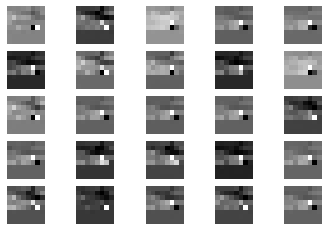

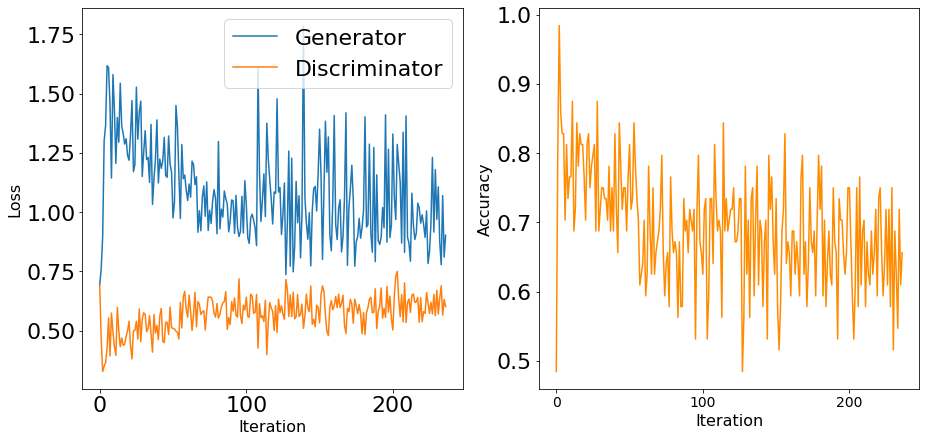

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23601 [D loss: 0.623209, acc.: 67.19%] [G loss: 0.854843]
23602 [D loss: 0.591941, acc.: 70.31%] [G loss: 0.990633]
23603 [D loss: 0.668181, acc.: 53.12%] [G loss: 1.004453]
23604 [D loss: 0.643475, acc.: 62.50%] [G loss: 0.765329]
23605 [D loss: 0.664543, acc.: 62.50%] [G loss: 0.899332]
23606 [D loss: 0.550617, acc.: 75.00%] [G loss: 0.980061]
23607 [D loss: 0.699918, acc.: 60.94%] [G loss: 0.879537]
23608 [D loss: 0.628710, acc.: 65.62%] [G loss: 0.991084]
23609 [D loss: 0.692432, acc.: 46.88%] [G loss: 0.858032]
23610 [D loss: 0.521884, acc.: 70.31%] [G loss: 1.622550]
23611 [D loss: 0.559384, acc.: 76.56%] [G loss: 1.453354]
23612 [D loss: 0.544943, acc.: 71.88%] [G loss: 1.373851]
23613 [D loss: 0.543980, acc.: 78.12%] [G loss: 0.974166]
23614 [D loss: 0.621054, acc.: 65.62%] [G loss: 0.815887]
23615 [D loss: 0.584014, acc.: 67.19%] [G loss: 1.439316]
23616 [D loss: 0.599150, acc.: 64.06%] [G loss: 1.184739]
23617 [D loss: 0.550808, acc.: 68.75%] [G loss: 1.196863]
23618 [D loss:

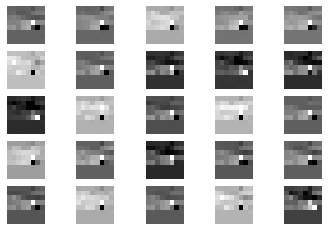

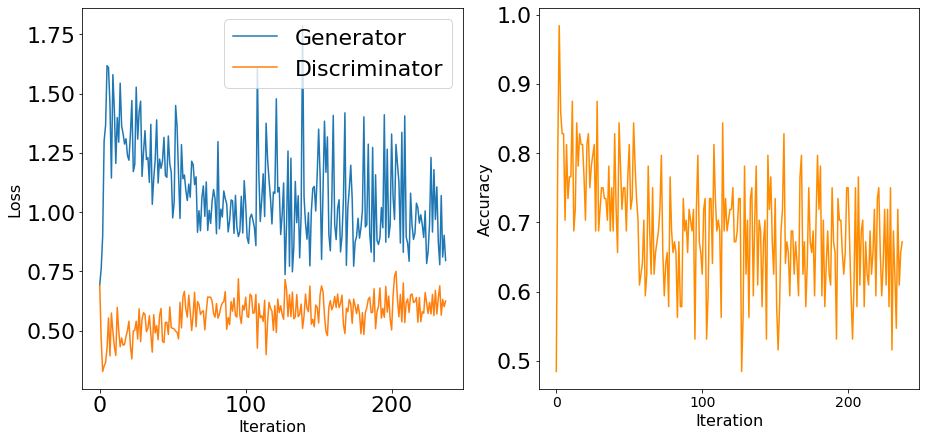

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23701 [D loss: 0.650304, acc.: 57.81%] [G loss: 0.790731]
23702 [D loss: 0.598885, acc.: 64.06%] [G loss: 0.750299]
23703 [D loss: 0.596570, acc.: 67.19%] [G loss: 0.781746]
23704 [D loss: 0.625767, acc.: 67.19%] [G loss: 1.019564]
23705 [D loss: 0.585338, acc.: 71.88%] [G loss: 0.919621]
23706 [D loss: 0.574112, acc.: 64.06%] [G loss: 1.096554]
23707 [D loss: 0.604272, acc.: 65.62%] [G loss: 1.322943]
23708 [D loss: 0.547910, acc.: 78.12%] [G loss: 1.089553]
23709 [D loss: 0.624978, acc.: 62.50%] [G loss: 0.983879]
23710 [D loss: 0.669980, acc.: 57.81%] [G loss: 0.932876]
23711 [D loss: 0.657059, acc.: 65.62%] [G loss: 0.880068]
23712 [D loss: 0.530416, acc.: 75.00%] [G loss: 0.989244]
23713 [D loss: 0.561981, acc.: 68.75%] [G loss: 0.995344]
23714 [D loss: 0.668005, acc.: 60.94%] [G loss: 0.967833]
23715 [D loss: 0.595617, acc.: 62.50%] [G loss: 0.944796]
23716 [D loss: 0.694557, acc.: 57.81%] [G loss: 0.966726]
23717 [D loss: 0.624174, acc.: 67.19%] [G loss: 1.004442]
23718 [D loss:

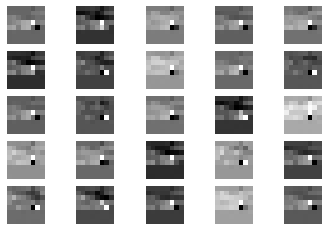

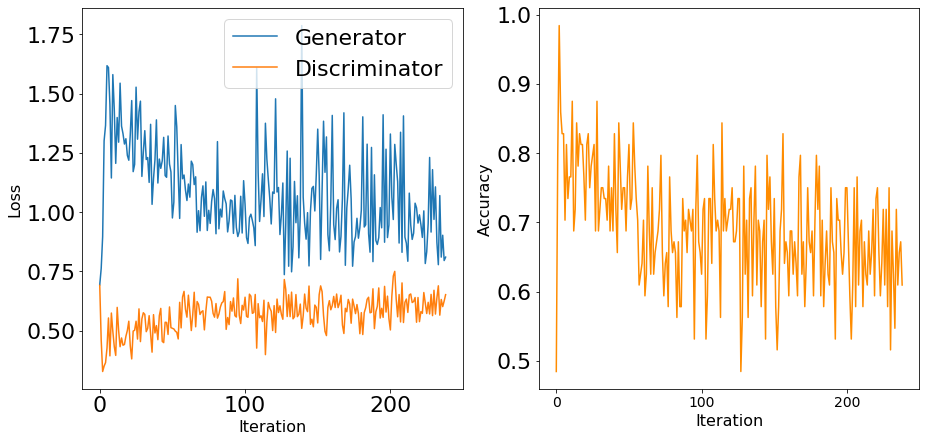

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23801 [D loss: 0.646724, acc.: 57.81%] [G loss: 0.871337]
23802 [D loss: 0.614400, acc.: 65.62%] [G loss: 1.113668]
23803 [D loss: 0.527304, acc.: 73.44%] [G loss: 1.414427]
23804 [D loss: 0.591729, acc.: 70.31%] [G loss: 1.094275]
23805 [D loss: 0.564093, acc.: 64.06%] [G loss: 1.268400]
23806 [D loss: 0.588092, acc.: 67.19%] [G loss: 1.130159]
23807 [D loss: 0.634561, acc.: 67.19%] [G loss: 1.167882]
23808 [D loss: 0.654353, acc.: 56.25%] [G loss: 0.768414]
23809 [D loss: 0.594693, acc.: 67.19%] [G loss: 0.799136]
23810 [D loss: 0.573236, acc.: 64.06%] [G loss: 1.117081]
23811 [D loss: 0.591808, acc.: 68.75%] [G loss: 0.953137]
23812 [D loss: 0.613628, acc.: 67.19%] [G loss: 0.943514]
23813 [D loss: 0.689451, acc.: 56.25%] [G loss: 0.865651]
23814 [D loss: 0.553849, acc.: 71.88%] [G loss: 0.979717]
23815 [D loss: 0.623216, acc.: 60.94%] [G loss: 1.093287]
23816 [D loss: 0.571108, acc.: 71.88%] [G loss: 1.191683]
23817 [D loss: 0.604601, acc.: 65.62%] [G loss: 0.924162]
23818 [D loss:

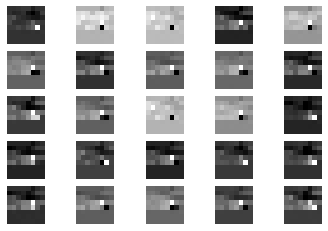

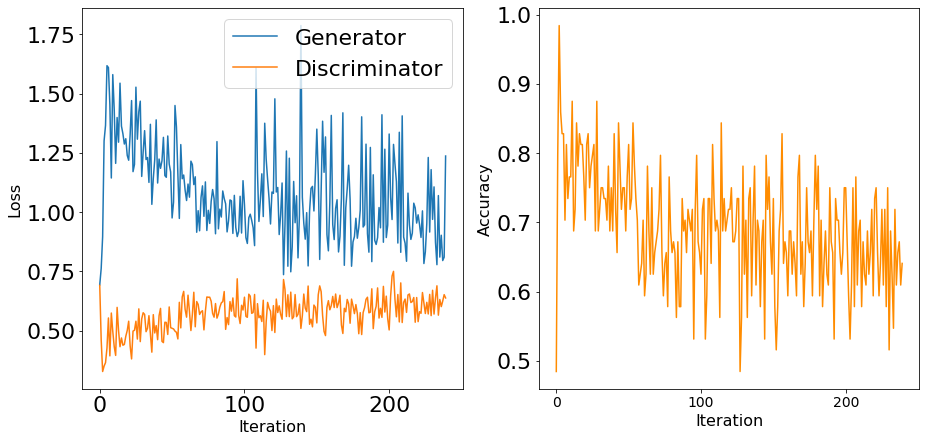

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


23901 [D loss: 0.678237, acc.: 50.00%] [G loss: 0.789563]
23902 [D loss: 0.633792, acc.: 59.38%] [G loss: 0.997309]
23903 [D loss: 0.668277, acc.: 65.62%] [G loss: 0.790406]
23904 [D loss: 0.640280, acc.: 68.75%] [G loss: 0.803919]
23905 [D loss: 0.628369, acc.: 59.38%] [G loss: 0.802500]
23906 [D loss: 0.615817, acc.: 68.75%] [G loss: 0.939023]
23907 [D loss: 0.690270, acc.: 54.69%] [G loss: 0.896268]
23908 [D loss: 0.721096, acc.: 57.81%] [G loss: 0.809493]
23909 [D loss: 0.670630, acc.: 54.69%] [G loss: 0.863335]
23910 [D loss: 0.577625, acc.: 71.88%] [G loss: 1.088321]
23911 [D loss: 0.565302, acc.: 71.88%] [G loss: 1.138115]
23912 [D loss: 0.540022, acc.: 73.44%] [G loss: 1.164159]
23913 [D loss: 0.607579, acc.: 62.50%] [G loss: 1.084017]
23914 [D loss: 0.516372, acc.: 73.44%] [G loss: 1.132942]
23915 [D loss: 0.586633, acc.: 68.75%] [G loss: 0.995228]
23916 [D loss: 0.648874, acc.: 65.62%] [G loss: 1.081627]
23917 [D loss: 0.590633, acc.: 70.31%] [G loss: 0.913737]
23918 [D loss:

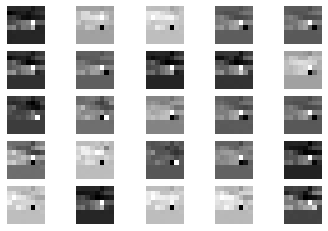

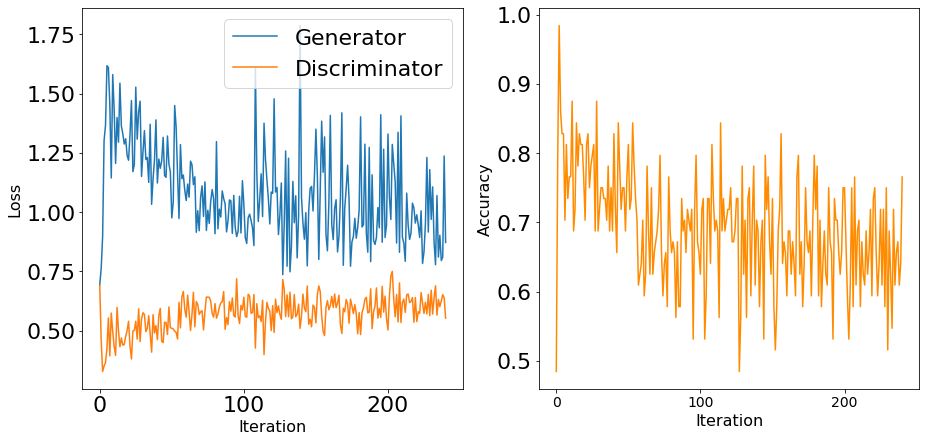

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24001 [D loss: 0.579792, acc.: 67.19%] [G loss: 0.870076]
24002 [D loss: 0.557538, acc.: 73.44%] [G loss: 0.900025]
24003 [D loss: 0.609969, acc.: 62.50%] [G loss: 1.051295]
24004 [D loss: 0.568886, acc.: 71.88%] [G loss: 1.037599]
24005 [D loss: 0.674374, acc.: 65.62%] [G loss: 0.966107]
24006 [D loss: 0.614668, acc.: 60.94%] [G loss: 1.528325]
24007 [D loss: 0.554333, acc.: 73.44%] [G loss: 1.026408]
24008 [D loss: 0.591397, acc.: 64.06%] [G loss: 0.986628]
24009 [D loss: 0.531554, acc.: 78.12%] [G loss: 1.121033]
24010 [D loss: 0.666219, acc.: 54.69%] [G loss: 1.012588]
24011 [D loss: 0.652620, acc.: 62.50%] [G loss: 1.091810]
24012 [D loss: 0.545316, acc.: 65.62%] [G loss: 0.991198]
24013 [D loss: 0.612358, acc.: 64.06%] [G loss: 0.888107]
24014 [D loss: 0.634975, acc.: 60.94%] [G loss: 1.184873]
24015 [D loss: 0.655509, acc.: 59.38%] [G loss: 0.965040]
24016 [D loss: 0.607802, acc.: 68.75%] [G loss: 1.205912]
24017 [D loss: 0.637043, acc.: 60.94%] [G loss: 1.014016]
24018 [D loss:

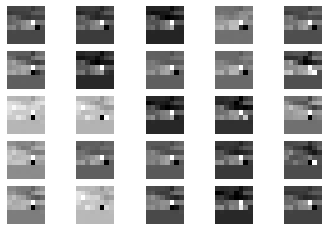

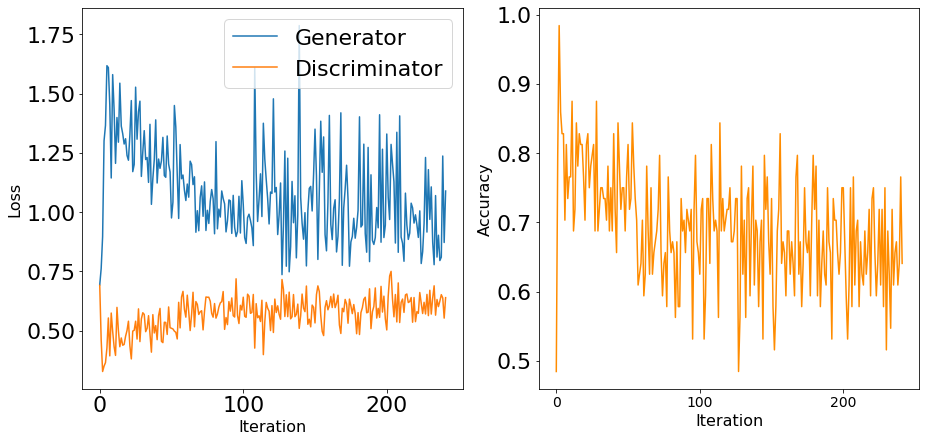

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24101 [D loss: 0.570290, acc.: 71.88%] [G loss: 0.770692]
24102 [D loss: 0.588908, acc.: 67.19%] [G loss: 1.194064]
24103 [D loss: 0.592776, acc.: 71.88%] [G loss: 1.059470]
24104 [D loss: 0.532626, acc.: 70.31%] [G loss: 0.980657]
24105 [D loss: 0.464807, acc.: 79.69%] [G loss: 1.590282]
24106 [D loss: 0.565125, acc.: 68.75%] [G loss: 1.137879]
24107 [D loss: 0.627794, acc.: 62.50%] [G loss: 1.100456]
24108 [D loss: 0.457838, acc.: 76.56%] [G loss: 1.998036]
24109 [D loss: 0.540747, acc.: 67.19%] [G loss: 1.904601]
24110 [D loss: 0.500322, acc.: 76.56%] [G loss: 1.469462]
24111 [D loss: 0.563643, acc.: 67.19%] [G loss: 1.361587]
24112 [D loss: 0.597269, acc.: 65.62%] [G loss: 0.976230]
24113 [D loss: 0.526875, acc.: 68.75%] [G loss: 1.420812]
24114 [D loss: 0.584705, acc.: 65.62%] [G loss: 1.186446]
24115 [D loss: 0.494656, acc.: 79.69%] [G loss: 1.587483]
24116 [D loss: 0.583708, acc.: 71.88%] [G loss: 1.265728]
24117 [D loss: 0.512067, acc.: 70.31%] [G loss: 1.586449]
24118 [D loss:

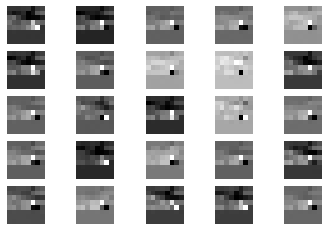

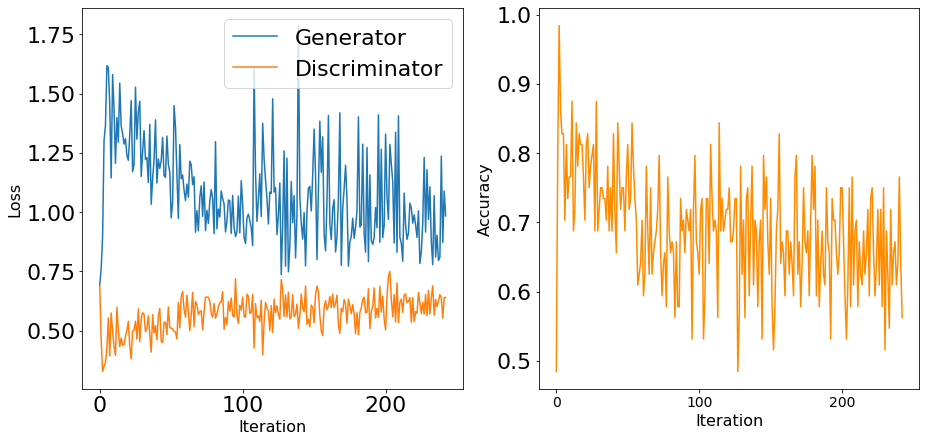

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24201 [D loss: 0.600412, acc.: 71.88%] [G loss: 0.933514]
24202 [D loss: 0.604886, acc.: 67.19%] [G loss: 0.958392]
24203 [D loss: 0.591927, acc.: 67.19%] [G loss: 1.040055]
24204 [D loss: 0.625354, acc.: 56.25%] [G loss: 1.142640]
24205 [D loss: 0.612215, acc.: 64.06%] [G loss: 0.844838]
24206 [D loss: 0.567282, acc.: 76.56%] [G loss: 0.917946]
24207 [D loss: 0.586102, acc.: 67.19%] [G loss: 1.095571]
24208 [D loss: 0.664321, acc.: 53.12%] [G loss: 1.177639]
24209 [D loss: 0.578165, acc.: 75.00%] [G loss: 1.007601]
24210 [D loss: 0.609197, acc.: 62.50%] [G loss: 0.937975]
24211 [D loss: 0.572180, acc.: 67.19%] [G loss: 1.077378]
24212 [D loss: 0.565844, acc.: 62.50%] [G loss: 1.289647]
24213 [D loss: 0.630836, acc.: 64.06%] [G loss: 1.000838]
24214 [D loss: 0.549514, acc.: 70.31%] [G loss: 0.990975]
24215 [D loss: 0.620103, acc.: 71.88%] [G loss: 0.932307]
24216 [D loss: 0.546311, acc.: 70.31%] [G loss: 1.011506]
24217 [D loss: 0.547573, acc.: 68.75%] [G loss: 1.082907]
24218 [D loss:

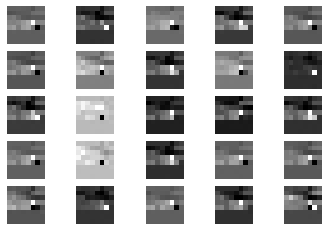

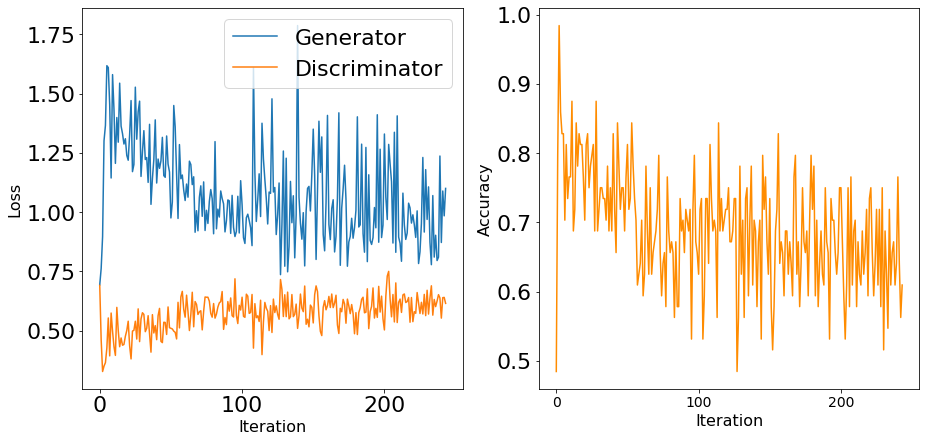

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24301 [D loss: 0.597026, acc.: 73.44%] [G loss: 1.491741]
24302 [D loss: 0.476728, acc.: 73.44%] [G loss: 1.595716]
24303 [D loss: 0.565436, acc.: 68.75%] [G loss: 0.802088]
24304 [D loss: 0.648930, acc.: 62.50%] [G loss: 0.866674]
24305 [D loss: 0.671914, acc.: 62.50%] [G loss: 0.836999]
24306 [D loss: 0.675953, acc.: 56.25%] [G loss: 0.869794]
24307 [D loss: 0.611991, acc.: 67.19%] [G loss: 0.981389]
24308 [D loss: 0.555960, acc.: 71.88%] [G loss: 0.814169]
24309 [D loss: 0.633405, acc.: 60.94%] [G loss: 0.972942]
24310 [D loss: 0.565032, acc.: 70.31%] [G loss: 1.003288]
24311 [D loss: 0.536135, acc.: 75.00%] [G loss: 1.075053]
24312 [D loss: 0.657404, acc.: 57.81%] [G loss: 1.209977]
24313 [D loss: 0.545051, acc.: 70.31%] [G loss: 1.050815]
24314 [D loss: 0.533419, acc.: 71.88%] [G loss: 1.269004]
24315 [D loss: 0.569431, acc.: 71.88%] [G loss: 1.193026]
24316 [D loss: 0.546135, acc.: 75.00%] [G loss: 0.959780]
24317 [D loss: 0.660931, acc.: 57.81%] [G loss: 0.770481]
24318 [D loss:

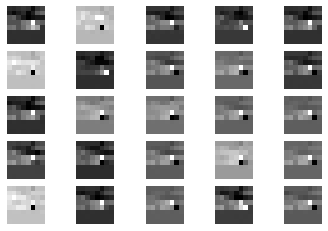

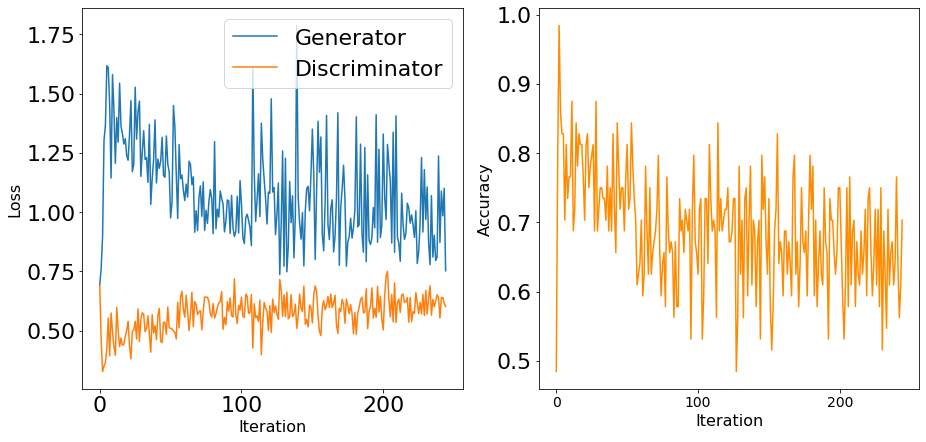

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24401 [D loss: 0.646870, acc.: 62.50%] [G loss: 0.729933]
24402 [D loss: 0.567521, acc.: 73.44%] [G loss: 1.038043]
24403 [D loss: 0.650387, acc.: 65.62%] [G loss: 0.780634]
24404 [D loss: 0.632780, acc.: 62.50%] [G loss: 0.971474]
24405 [D loss: 0.674323, acc.: 56.25%] [G loss: 0.836471]
24406 [D loss: 0.678622, acc.: 51.56%] [G loss: 0.953008]
24407 [D loss: 0.653127, acc.: 57.81%] [G loss: 1.040348]
24408 [D loss: 0.579204, acc.: 65.62%] [G loss: 0.934632]
24409 [D loss: 0.649429, acc.: 60.94%] [G loss: 0.702250]
24410 [D loss: 0.575277, acc.: 68.75%] [G loss: 1.005714]
24411 [D loss: 0.651815, acc.: 56.25%] [G loss: 1.323425]
24412 [D loss: 0.546055, acc.: 73.44%] [G loss: 1.349582]
24413 [D loss: 0.669574, acc.: 59.38%] [G loss: 0.857000]
24414 [D loss: 0.576628, acc.: 68.75%] [G loss: 1.036825]
24415 [D loss: 0.550818, acc.: 67.19%] [G loss: 1.081658]
24416 [D loss: 0.632311, acc.: 62.50%] [G loss: 0.893946]
24417 [D loss: 0.551510, acc.: 71.88%] [G loss: 1.005539]
24418 [D loss:

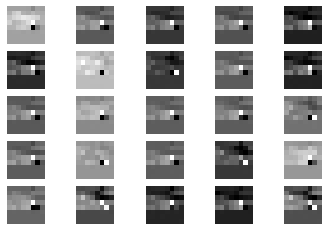

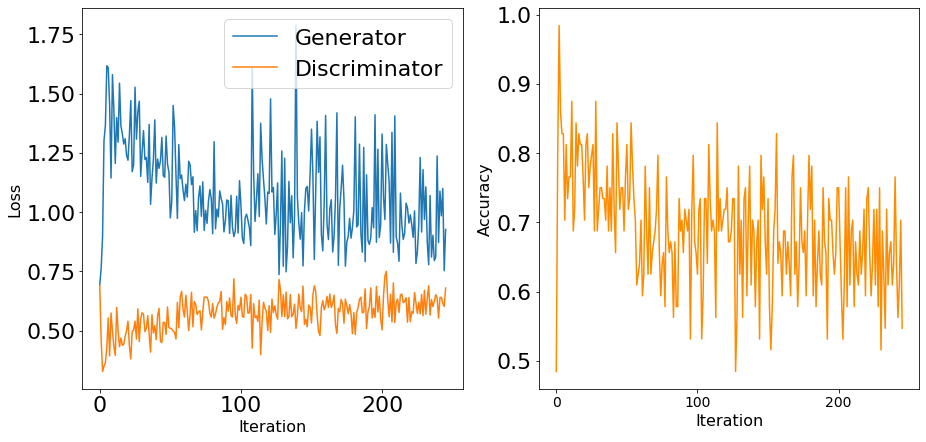

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24501 [D loss: 0.539649, acc.: 65.62%] [G loss: 1.107852]
24502 [D loss: 0.564184, acc.: 68.75%] [G loss: 1.619717]
24503 [D loss: 0.536347, acc.: 73.44%] [G loss: 1.363490]
24504 [D loss: 0.588607, acc.: 62.50%] [G loss: 1.057464]
24505 [D loss: 0.584209, acc.: 60.94%] [G loss: 0.927818]
24506 [D loss: 0.604471, acc.: 70.31%] [G loss: 1.072273]
24507 [D loss: 0.567296, acc.: 75.00%] [G loss: 0.960051]
24508 [D loss: 0.604337, acc.: 64.06%] [G loss: 0.865912]
24509 [D loss: 0.579914, acc.: 68.75%] [G loss: 0.819089]
24510 [D loss: 0.674528, acc.: 57.81%] [G loss: 0.828180]
24511 [D loss: 0.675015, acc.: 64.06%] [G loss: 0.858468]
24512 [D loss: 0.594271, acc.: 62.50%] [G loss: 1.074950]
24513 [D loss: 0.541073, acc.: 65.62%] [G loss: 0.980977]
24514 [D loss: 0.606513, acc.: 68.75%] [G loss: 0.761080]
24515 [D loss: 0.623014, acc.: 64.06%] [G loss: 0.822741]
24516 [D loss: 0.627337, acc.: 64.06%] [G loss: 0.781985]
24517 [D loss: 0.548527, acc.: 73.44%] [G loss: 0.881519]
24518 [D loss:

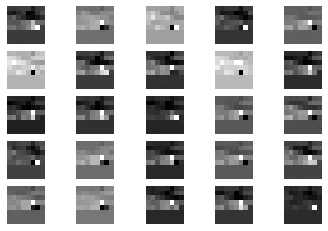

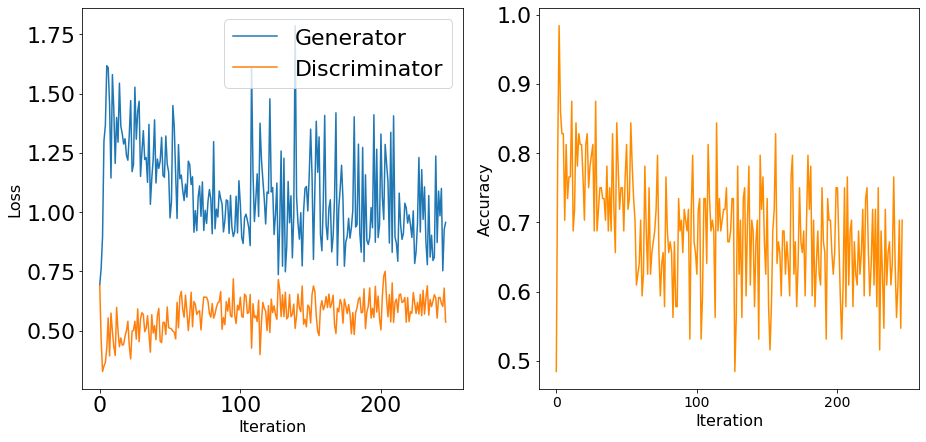

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24601 [D loss: 0.627026, acc.: 67.19%] [G loss: 1.141669]
24602 [D loss: 0.544380, acc.: 70.31%] [G loss: 1.311472]
24603 [D loss: 0.619092, acc.: 64.06%] [G loss: 0.937326]
24604 [D loss: 0.649253, acc.: 62.50%] [G loss: 1.057107]
24605 [D loss: 0.473625, acc.: 78.12%] [G loss: 1.009676]
24606 [D loss: 0.590836, acc.: 70.31%] [G loss: 1.108865]
24607 [D loss: 0.557099, acc.: 70.31%] [G loss: 1.350821]
24608 [D loss: 0.668584, acc.: 67.19%] [G loss: 0.956372]
24609 [D loss: 0.521787, acc.: 71.88%] [G loss: 1.216810]
24610 [D loss: 0.653718, acc.: 60.94%] [G loss: 0.963527]
24611 [D loss: 0.529311, acc.: 78.12%] [G loss: 1.119411]
24612 [D loss: 0.554699, acc.: 78.12%] [G loss: 1.065831]
24613 [D loss: 0.561324, acc.: 71.88%] [G loss: 1.068614]
24614 [D loss: 0.611638, acc.: 65.62%] [G loss: 0.980160]
24615 [D loss: 0.606637, acc.: 67.19%] [G loss: 0.826883]
24616 [D loss: 0.683227, acc.: 64.06%] [G loss: 0.932536]
24617 [D loss: 0.730087, acc.: 46.88%] [G loss: 1.061337]
24618 [D loss:

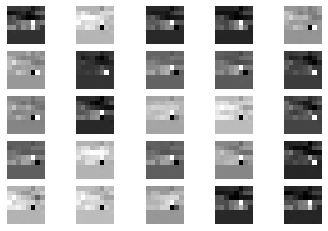

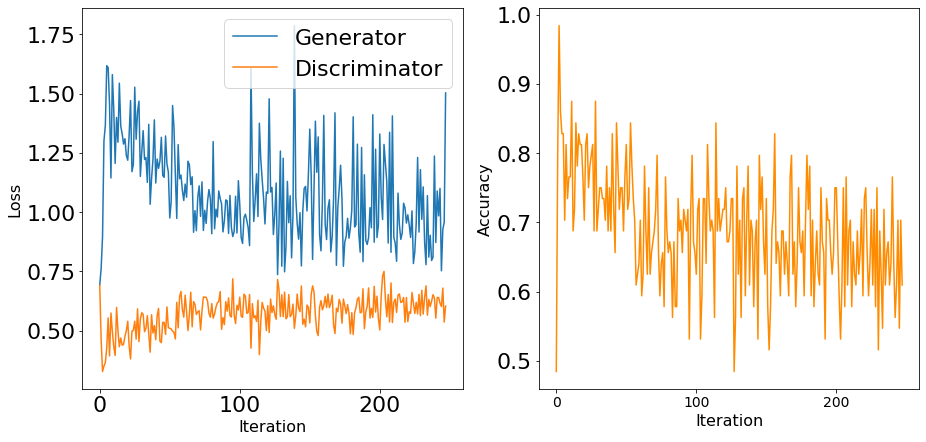

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24701 [D loss: 0.563573, acc.: 68.75%] [G loss: 1.104293]
24702 [D loss: 0.492556, acc.: 78.12%] [G loss: 1.385788]
24703 [D loss: 0.527364, acc.: 71.88%] [G loss: 1.478383]
24704 [D loss: 0.664822, acc.: 57.81%] [G loss: 0.988402]
24705 [D loss: 0.667084, acc.: 64.06%] [G loss: 0.900036]
24706 [D loss: 0.512026, acc.: 71.88%] [G loss: 1.358939]
24707 [D loss: 0.536294, acc.: 65.62%] [G loss: 1.113088]
24708 [D loss: 0.631134, acc.: 62.50%] [G loss: 1.182235]
24709 [D loss: 0.587574, acc.: 68.75%] [G loss: 1.005387]
24710 [D loss: 0.632120, acc.: 70.31%] [G loss: 0.825013]
24711 [D loss: 0.644128, acc.: 60.94%] [G loss: 1.028243]
24712 [D loss: 0.619753, acc.: 65.62%] [G loss: 1.033800]
24713 [D loss: 0.596307, acc.: 65.62%] [G loss: 1.128841]
24714 [D loss: 0.579628, acc.: 70.31%] [G loss: 1.010624]
24715 [D loss: 0.589404, acc.: 64.06%] [G loss: 0.910970]
24716 [D loss: 0.535418, acc.: 68.75%] [G loss: 1.016860]
24717 [D loss: 0.670855, acc.: 67.19%] [G loss: 0.814885]
24718 [D loss:

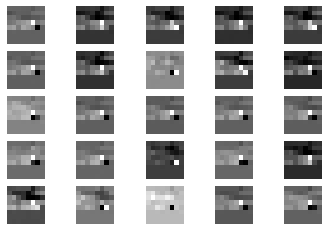

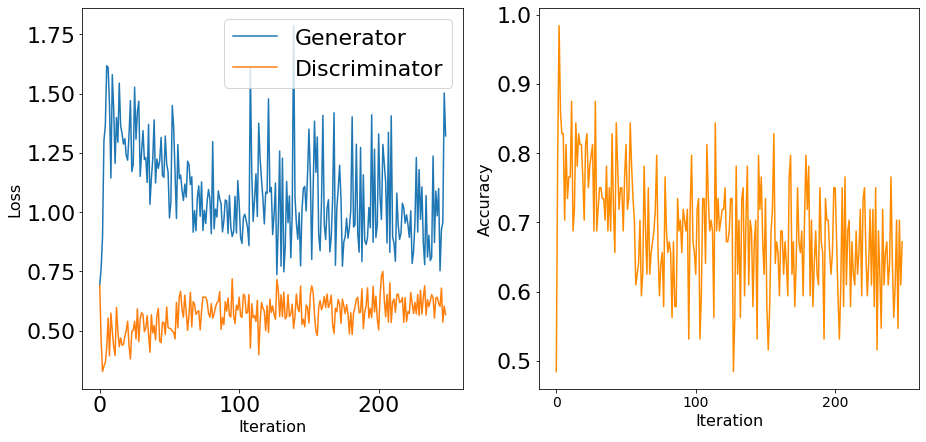

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24801 [D loss: 0.604515, acc.: 60.94%] [G loss: 0.983167]
24802 [D loss: 0.593782, acc.: 75.00%] [G loss: 0.968211]
24803 [D loss: 0.591973, acc.: 65.62%] [G loss: 1.090154]
24804 [D loss: 0.580442, acc.: 64.06%] [G loss: 1.213297]
24805 [D loss: 0.572363, acc.: 67.19%] [G loss: 1.285839]
24806 [D loss: 0.572452, acc.: 75.00%] [G loss: 1.119824]
24807 [D loss: 0.616539, acc.: 65.62%] [G loss: 0.883590]
24808 [D loss: 0.478441, acc.: 81.25%] [G loss: 1.216728]
24809 [D loss: 0.544833, acc.: 79.69%] [G loss: 1.282667]
24810 [D loss: 0.564161, acc.: 73.44%] [G loss: 0.996332]
24811 [D loss: 0.586276, acc.: 67.19%] [G loss: 0.857732]
24812 [D loss: 0.638374, acc.: 62.50%] [G loss: 0.902296]
24813 [D loss: 0.636289, acc.: 70.31%] [G loss: 1.061187]
24814 [D loss: 0.663837, acc.: 51.56%] [G loss: 1.036467]
24815 [D loss: 0.593724, acc.: 70.31%] [G loss: 0.777937]
24816 [D loss: 0.618355, acc.: 60.94%] [G loss: 0.870175]
24817 [D loss: 0.532677, acc.: 71.88%] [G loss: 1.339844]
24818 [D loss:

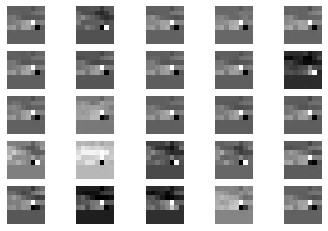

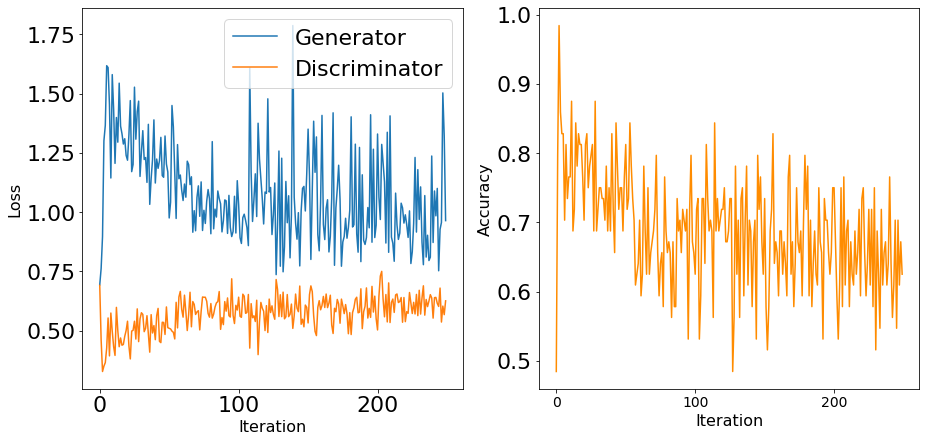

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


24901 [D loss: 0.592090, acc.: 67.19%] [G loss: 0.815324]
24902 [D loss: 0.594285, acc.: 68.75%] [G loss: 0.761560]
24903 [D loss: 0.650381, acc.: 68.75%] [G loss: 0.934944]
24904 [D loss: 0.571061, acc.: 70.31%] [G loss: 1.189577]
24905 [D loss: 0.597812, acc.: 68.75%] [G loss: 1.047582]
24906 [D loss: 0.654510, acc.: 56.25%] [G loss: 0.861397]
24907 [D loss: 0.645770, acc.: 64.06%] [G loss: 1.354967]
24908 [D loss: 0.542165, acc.: 73.44%] [G loss: 1.767589]
24909 [D loss: 0.594175, acc.: 68.75%] [G loss: 1.172165]
24910 [D loss: 0.662576, acc.: 56.25%] [G loss: 0.881563]
24911 [D loss: 0.655213, acc.: 59.38%] [G loss: 0.856290]
24912 [D loss: 0.505920, acc.: 75.00%] [G loss: 1.227841]
24913 [D loss: 0.616715, acc.: 62.50%] [G loss: 1.056514]
24914 [D loss: 0.506697, acc.: 79.69%] [G loss: 1.138621]
24915 [D loss: 0.607154, acc.: 70.31%] [G loss: 1.056147]
24916 [D loss: 0.595551, acc.: 60.94%] [G loss: 1.048360]
24917 [D loss: 0.637256, acc.: 65.62%] [G loss: 0.956678]
24918 [D loss:

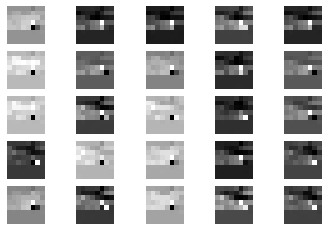

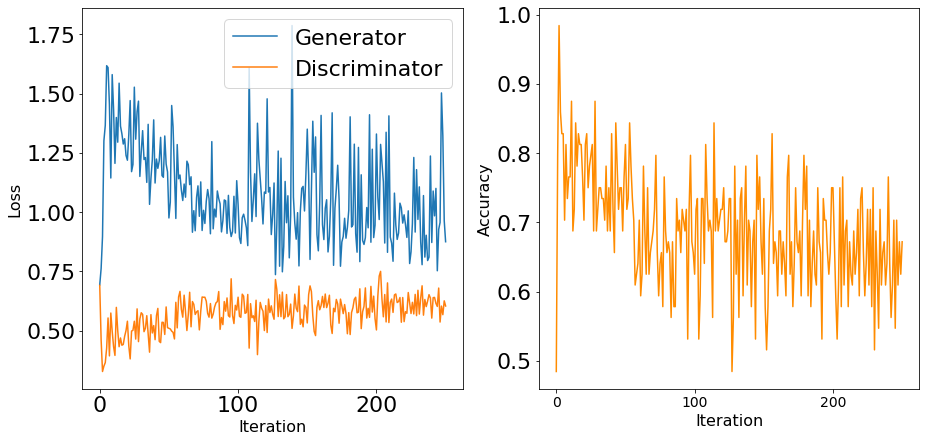

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


25001 [D loss: 0.700045, acc.: 51.56%] [G loss: 0.807565]
25002 [D loss: 0.717027, acc.: 46.88%] [G loss: 0.759640]
25003 [D loss: 0.606951, acc.: 68.75%] [G loss: 0.957260]
25004 [D loss: 0.594936, acc.: 64.06%] [G loss: 1.320464]
25005 [D loss: 0.671777, acc.: 60.94%] [G loss: 1.017923]
25006 [D loss: 0.688323, acc.: 59.38%] [G loss: 0.970777]
25007 [D loss: 0.561349, acc.: 68.75%] [G loss: 1.220734]
25008 [D loss: 0.565570, acc.: 70.31%] [G loss: 1.332133]
25009 [D loss: 0.596097, acc.: 70.31%] [G loss: 1.055699]
25010 [D loss: 0.680028, acc.: 50.00%] [G loss: 0.887097]
25011 [D loss: 0.635887, acc.: 60.94%] [G loss: 0.779418]
25012 [D loss: 0.616638, acc.: 65.62%] [G loss: 0.862483]
25013 [D loss: 0.650784, acc.: 53.12%] [G loss: 0.759919]
25014 [D loss: 0.584212, acc.: 71.88%] [G loss: 1.141825]
25015 [D loss: 0.449747, acc.: 76.56%] [G loss: 1.905360]
25016 [D loss: 0.597229, acc.: 70.31%] [G loss: 0.900439]
25017 [D loss: 0.641392, acc.: 62.50%] [G loss: 1.130631]
25018 [D loss:

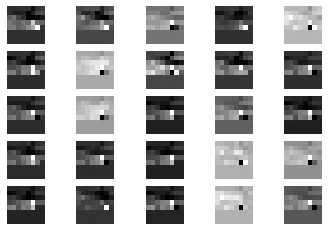

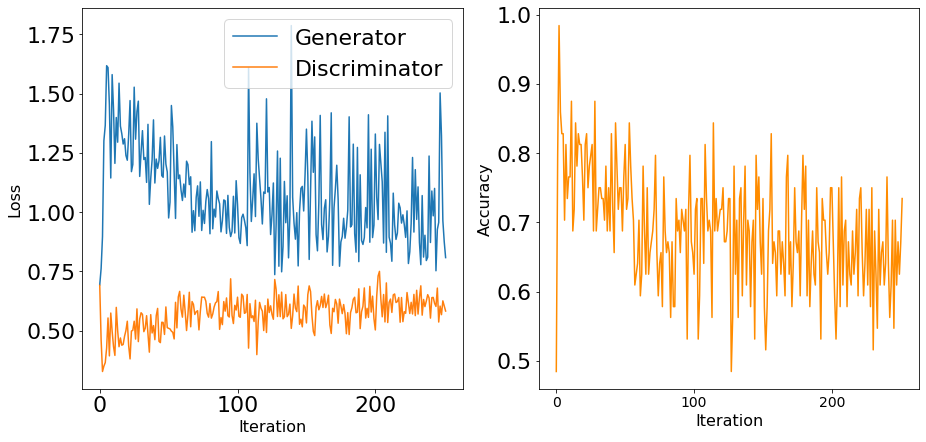

C:\Users\Oliver\anaconda3\lib\site-packages\keras\engine\training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


25101 [D loss: 0.662859, acc.: 59.38%] [G loss: 0.906243]
25102 [D loss: 0.590912, acc.: 64.06%] [G loss: 0.981117]
25103 [D loss: 0.663048, acc.: 65.62%] [G loss: 1.270959]
25104 [D loss: 0.525907, acc.: 75.00%] [G loss: 1.236603]
25105 [D loss: 0.635175, acc.: 60.94%] [G loss: 0.834954]
25106 [D loss: 0.660221, acc.: 57.81%] [G loss: 0.708476]
25107 [D loss: 0.645252, acc.: 59.38%] [G loss: 0.924062]
25108 [D loss: 0.681107, acc.: 56.25%] [G loss: 0.857188]
25109 [D loss: 0.563749, acc.: 71.88%] [G loss: 1.133334]
25110 [D loss: 0.586764, acc.: 68.75%] [G loss: 1.040920]
25111 [D loss: 0.589013, acc.: 73.44%] [G loss: 0.807571]
25112 [D loss: 0.557605, acc.: 71.88%] [G loss: 1.178061]
25113 [D loss: 0.544729, acc.: 73.44%] [G loss: 1.133448]
25114 [D loss: 0.648857, acc.: 65.62%] [G loss: 0.915523]
25115 [D loss: 0.492530, acc.: 82.81%] [G loss: 1.037977]
25116 [D loss: 0.625188, acc.: 65.62%] [G loss: 1.241388]
25117 [D loss: 0.663312, acc.: 64.06%] [G loss: 1.524628]
25118 [D loss:

KeyboardInterrupt: 

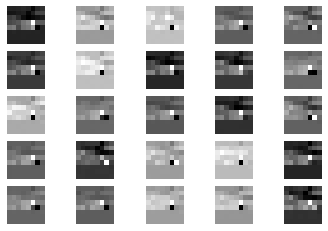

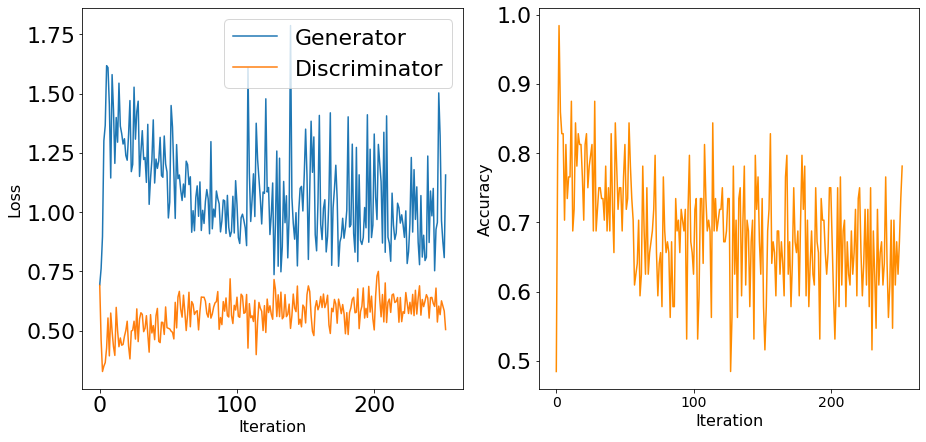

In [78]:
from __future__ import print_function, division

from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam

import matplotlib.pyplot as plt

import sys

import numpy as np
d_hist = []
g_hist = []
d_accu = []
class DCGAN():
    def __init__(self):
        # Input shape
        self.img_rows = 8
        self.img_cols = 8
        self.channels = 1
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = 100
        
        optimizer = Adam(0.0002, 0.5)
        

        # Build and compile the discriminator
        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

        # Build the generator
        self.generator = self.build_generator()

        # The generator takes noise as input and generates imgs
        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)

        # For the combined model we will only train the generator
        self.discriminator.trainable = False

        # The discriminator takes generated images as input and determines validity
        valid = self.discriminator(img)

        # The combined model  (stacked generator and discriminator)
        # Trains the generator to fool the discriminator
        self.combined = Model(z, valid)
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer)

    def build_generator(self):

        model = Sequential()

        model.add(Dense(1 * 8 * 8, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((8, 8, 1)))
        #model.add(UpSampling2D())
        model.add(Conv2D(128, kernel_size=2, padding="same"))
        #model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        #model.add(UpSampling2D())
        model.add(Conv2D(64, kernel_size=2, padding="same"))
        #model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(Conv2D(self.channels, kernel_size=2, padding="same"))
        #model.add(Activation("tanh"))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)

    def build_discriminator(self):

        model = Sequential()

        model.add(Conv2D(8, kernel_size=2, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.5))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        #model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.5))
        #model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
        #model.add(BatchNormalization(momentum=0.8))
        #model.add(LeakyReLU(alpha=0.2))
        #model.add(Dropout(0.5))
        #model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
        #model.add(BatchNormalization(momentum=0.8))
        #model.add(LeakyReLU(alpha=0.2))
        #model.add(Dropout(0.5))
        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))

        model.summary()

        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)

    def train(self, epochs, batch_size=128, save_interval=50):

        # Load the dataset
        pickle_in = open("X_NN_With_Coeffs.pickle", "rb")
        X_train = pickle.load(pickle_in)
        
        X_train = np.reshape(X_train, (-1,8,8))
        
        
        #X_train[:,39:-1] = 0
        
        #print(X_train[0:10,:,:])
        # Rescale -1 to 1
        #X_train = X_train / 127.5 - 1.
        X_train = np.expand_dims(X_train, axis=3)
        
        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))
        
        

        for epoch in range(epochs):

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random half of images
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            # Sample noise and generate a batch of new images
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.generator.predict(noise)

            # Train the discriminator (real classified as ones and generated as zeros)
            d_loss_real = self.discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # ---------------------
            #  Train Generator
            # ---------------------

            # Train the generator (wants discriminator to mistake images as real)
            g_loss = self.combined.train_on_batch(noise, valid)

            # Plot the progress
            print ("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))

            # If at save interval => save generated image samples
            if epoch % (2*save_interval) == 0:
                self.save_imgs(epoch, d_loss, g_loss)

    def save_imgs(self, epoch, d_loss, g_loss):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)
       
        predictions = np.reshape(gen_imgs[0],(64))
        
        print(predictions.shape)
        realfit = computeModelCoeffsFit([predictions[37:39]],np.reshape(predictions[39:-1],(8,3)))
        print(realfit)
        print(predictions[37:])
        # Rescale images 0 - 1
        #gen_imgs = 0.5 * gen_imgs + 0.5
        self.generator.save('generator')
        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow(gen_imgs[cnt, :,:,0], cmap='gray')
                axs[i,j].axis('off')
                cnt += 1
        fig.savefig("images/mnist_%d.svg" % epoch)
        d_hist.append(d_loss[0])
        d_accu.append(d_loss[1])
        g_hist.append(g_loss)
        fig, ax = plt.subplots(1,2)
        fig.set_figheight(7)
        fig.set_figwidth(15)
        ax[0].set_xlabel(r'Iteration', fontsize=16)
        ax[0].set_ylabel(r'Loss', fontsize=16)
        ax[1].set_xlabel(r'Iteration', fontsize=16)
        ax[1].set_ylabel(r'Accuracy', fontsize=16)
        plt.xticks(fontsize=14)
        p1 = ax[0].plot(g_hist)    
        p2 = ax[0].plot(d_hist)
        p3 = ax[1].plot(d_accu, color='darkorange')

        ax[0].legend((p1[0], p2[0]), ('Generator', 'Discriminator'))
        
        plt.savefig('gendis/gendis3.svg')
        plt.show()               
        plt.close()


if __name__ == '__main__':
    dcgan = DCGAN()
    dcgan.train(epochs=40000, batch_size=32, save_interval=50)

[[-0.97152722 -0.86600957 -0.73072769 -0.55848745 -0.36933155  0.1069951
  -1.74565748 -1.87943892]
 [-2.02611636 -2.16546482 -2.24412846 -1.91854723  1.48373669  1.61882799
   1.70758174  1.70421815]
 [ 1.56770634  0.49383364 -0.95490327 -0.85912124 -0.78660361 -0.74326195
  -0.73933097 -0.90429734]
 [-0.69764571 -0.80416057 -0.91863556 -1.02977817 -1.1028275  -0.92352268
  -0.43771364 -0.66057826]
 [-1.38231075 -0.45955493 -1.16431412 -1.10420148 -0.78368808  1.22024046
   1.22024046 -1.01222144]
 [ 0.68519216  0.07829467 -1.68874144 -1.07289304 -1.13357965  1.41344649
   1.41431345 -0.7170268 ]
 [-1.00253309  0.9619928  -1.31961258 -0.65143736 -0.84736649 -0.44661984
  -0.16935034  0.1821213 ]
 [-1.66574697 -1.0121842   1.38550225  0.17726193 -1.176819    0.22822203
  -0.68001435  2.23823267]]


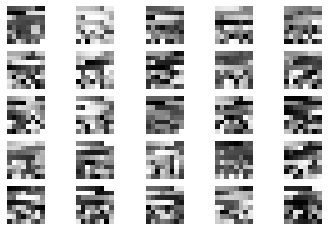

In [65]:
from sklearn.preprocessing import StandardScaler
def print_imgs():
    r, c = 5, 5   
    pickle_in = open("X_NN_With_Coeffs.pickle", "rb")
    X_train = pickle.load(pickle_in)
    scaler = StandardScaler()
    ## fit scaler on data
    scaler.fit(X_train)
    ## apply transform
    X_train = scaler.transform(X_train)
    X_train = np.reshape(X_train, (-1,8,8))
    idx = np.random.randint(0, 10000, r*c)

    gen_imgs = X_train[idx]
    print(gen_imgs[0])
    # Rescale images 0 - 1
    #gen_imgs = 0.5 * gen_imgs + 0.5        
    fig, axs = plt.subplots(r, c)
    cnt = 0
    for i in range(r):
        for j in range(c):
            axs[i,j].imshow(gen_imgs[cnt, :,:], cmap='gray')
            axs[i,j].axis('off')
            cnt += 1

    plt.show()               
    plt.close()
print_imgs()

In [80]:
from tensorflow import keras
import sys
import numpy as np
import pickle
import matplotlib.pyplot as plt 
np.set_printoptions(threshold=sys.maxsize)



model = keras.models.load_model('generator')
chi2=[]
plt.rcParams.update({'font.size': 22})
latent_space =[]

def saveData(filename, data):
    pickle_out = open(filename, "wb")
    pickle.dump(data, pickle_out)
    pickle_out.close()  

numSamples = 100000
dim = 100
noise = np.random.normal(0, 1, (numSamples, dim))

gen_imgs = model.predict(noise)


gen_imgs = np.reshape(gen_imgs,(numSamples, 64))

bestCoeff=[]
bestFit=999999
for i in range(numSamples):
    print(i)
    
    predictions = gen_imgs[i]
    #v = computeModelFit(predictions,X_experimental,modelErrors,expErrors)
    realfit = computeModelCoeffsFit([predictions[37:39]],np.reshape(predictions[39:-1],(8,3)))
    #realfit = computeModelCoeffsFit([predictions[37:39]],[])
    
    chi2.append(np.round(realfit,1))
    if(realfit<bestFit):
        print(realfit)
        print(predictions)
        bestFit = realfit
        
    



label = np.sort(chi2)[0]

print(label)



    


0
81717.79825552223
[ 2.73234658e-02  4.03836817e-02  5.97982369e-02  1.36139899e-01
 -9.08351224e-03 -7.19936669e-01  9.71909314e-02  4.03945386e-01
 -8.43760550e-01 -5.08376420e-01 -2.83764482e-01 -1.00678779e-01
 -6.15597963e-01  2.25357115e-01  1.00999260e+00  1.11742401e+00
  8.05769384e-01  1.07486033e+00  2.29248792e-01 -6.53809011e-01
 -8.74939799e-01 -4.73514676e-01 -3.60333055e-01 -2.31957853e-01
  9.86662507e-01  1.21272707e+00  1.51999974e+00  2.14073157e+00
  2.54775786e+00  6.13428545e+00  1.63041925e+00  1.57620466e+00
  2.24418330e+00  2.54536438e+00  1.15331101e+00  2.14356160e+00
  2.71018839e+00  4.58035612e+00  8.70323718e-01  6.47719875e-02
 -1.13865575e-02  5.88877611e-02  2.77821068e-03  6.44969661e-03
  1.83386691e-02 -1.25514558e-02  1.25512900e-02 -5.83070628e-02
  4.47423197e-04 -2.34290026e-04 -7.22601078e-04  6.08289894e-03
 -3.73471435e-03 -1.17358100e-03  8.27206019e-03  8.98365863e-04
 -8.94340407e-03 -1.60767231e-03  2.25523952e-03  2.04014592e-04
 -9.3

81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
4133.24914566781
[ 5.56616075e-02  1.21038379e-02 -1.05270237e-01 -9.09488946e-02
 -6.89414330e-04 -6.54259622e-01  7.88157210e-02  4.30312455e-01
  6.51304424e-01  4.50669706e-01  3.87556516e-02 -1.79659754e-01
 -2.66827017e-01  1.34291410e-01  6.38009787e-01  8.49216819e-01
  9.49990094e-01  1.44488239e+00  1.06650329e+00  9.42353129e-01
  2.08591580e-01 -3.35771501e-01 -4.01946515e-01 -4.71746743e-01
  1.01554072e+00  4.27823752e-01  3.08383077e-01  4.22008574e-01
  3.90359223e-01  9.19181168e-01  3.49250197e-01  3.76200497e-01
  2.72279590e-01  2.94818044e-01  9.07841504e-01  6.57006919e-01
  3.22426975e-01 -3.01121736e+00  1.48701191e+00  3.03301036e-01
 -2.48512160e-03  7.03351665e-03  1.

1100
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
1201
1202
1203
1204
1205
1206
1207
1208
1209
1210
1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
1291
1292
1293
1294
1295
1296
1297
1298
1299


2740
2741
2742
2743
2744
2745
2746
2747
2748
2749
2750
2751
2752
2753
2754
2755
2756
2757
2758
2759
2760
2761
2762
2763
2764
2765
2766
2767
2768
2769
2770
2771
2772
2773
2774
2775
2776
2777
2778
2779
2780
2781
2782
2783
2784
2785
2786
2787
2788
2789
2790
2791
2792
2793
2794
2795
2796
2797
2798
2799
2800
2801
2802
2803
2804
2805
2806
2807
2808
2809
2810
2811
2812
2813
2814
2815
2816
2817
2818
2819
2820
2821
2822
2823
2824
2825
2826
2827
2828
2829
2830
2831
2832
2833
2834
2835
2836
2837
2838
2839
2840
2841
2842
2843
2844
2845
2846
2847
2848
2849
2850
2851
2852
2853
2854
2855
2856
2857
2858
2859
2860
2861
2862
2863
2864
2865
2866
2867
2868
2869
2870
2871
2872
2873
2874
2875
2876
2877
2878
2879
2880
2881
2882
2883
2884
2885
2886
2887
2888
2889
2890
2891
2892
2893
2894
2895
2896
2897
2898
2899
2900
2901
2902
2903
2904
2905
2906
2907
2908
2909
2910
2911
2912
2913
2914
2915
2916
2917
2918
2919
2920
2921
2922
2923
2924
2925
2926
2927
2928
2929
2930
2931
2932
2933
2934
2935
2936
2937
2938
2939


4287
4288
4289
4290
4291
4292
4293
4294
4295
4296
4297
4298
4299
4300
4301
4302
4303
4304
4305
4306
4307
4308
4309
4310
4311
4312
4313
4314
4315
4316
4317
4318
4319
4320
4321
4322
4323
4324
4325
4326
4327
4328
4329
4330
4331
4332
4333
4334
4335
4336
4337
4338
4339
4340
4341
4342
4343
4344
4345
4346
4347
4348
4349
4350
4351
4352
4353
4354
4355
4356
4357
4358
4359
4360
4361
4362
4363
4364
4365
4366
4367
4368
4369
4370
4371
4372
4373
4374
4375
4376
4377
4378
4379
4380
4381
4382
4383
4384
4385
4386
4387
4388
4389
4390
4391
4392
4393
4394
4395
4396
4397
4398
4399
4400
4401
4402
4403
4404
4405
4406
4407
4408
4409
4410
4411
4412
4413
4414
4415
4416
4417
4418
4419
4420
4421
4422
4423
4424
4425
4426
4427
4428
4429
4430
4431
4432
4433
4434
4435
4436
4437
4438
4439
4440
4441
4442
4443
4444
4445
4446
4447
4448
4449
4450
4451
4452
4453
4454
4455
4456
4457
4458
4459
4460
4461
4462
4463
4464
4465
4466
4467
4468
4469
4470
4471
4472
4473
4474
4475
4476
4477
4478
4479
4480
4481
4482
4483
4484
4485
4486


5926
5927
5928
5929
5930
5931
5932
5933
5934
5935
5936
5937
5938
5939
5940
5941
5942
5943
5944
5945
5946
5947
5948
5949
5950
5951
5952
5953
5954
5955
5956
5957
5958
5959
5960
5961
5962
5963
5964
5965
5966
5967
5968
5969
5970
5971
5972
5973
5974
5975
5976
5977
5978
5979
5980
5981
5982
5983
5984
5985
5986
5987
5988
5989
5990
5991
5992
5993
5994
5995
5996
5997
5998
5999
6000
6001
6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015
6016
6017
6018
6019
6020
6021
6022
6023
6024
6025
6026
6027
6028
6029
6030
6031
6032
6033
6034
6035
6036
6037
6038
6039
6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055
6056
6057
6058
6059
6060
6061
6062
6063
6064
6065
6066
6067
6068
6069
6070
6071
6072
6073
6074
6075
6076
6077
6078
6079
6080
6081
6082
6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093
6094
6095
6096
6097
6098
6099
6100
6101
6102
6103
6104
6105
6106
6107
6108
6109
6110
6111
6112
6113
6114
6115
6116
6117
6118
6119
6120
6121
6122
6123
6124
6125


7565
7566
7567
7568
7569
7570
7571
7572
7573
7574
7575
7576
7577
7578
7579
7580
7581
7582
7583
7584
7585
7586
7587
7588
7589
7590
7591
7592
7593
7594
7595
7596
7597
7598
7599
7600
7601
7602
7603
7604
7605
7606
7607
7608
7609
7610
7611
7612
7613
7614
7615
7616
7617
7618
7619
7620
7621
7622
7623
7624
7625
7626
7627
7628
7629
7630
7631
7632
7633
7634
7635
7636
7637
7638
7639
7640
7641
7642
7643
7644
7645
7646
7647
7648
7649
7650
7651
7652
7653
7654
7655
7656
7657
7658
7659
7660
7661
7662
7663
7664
7665
7666
7667
7668
7669
7670
7671
7672
7673
7674
7675
7676
7677
7678
7679
7680
7681
7682
7683
7684
7685
7686
7687
7688
7689
7690
7691
7692
7693
7694
7695
7696
7697
7698
7699
7700
7701
7702
7703
7704
7705
7706
7707
7708
7709
7710
7711
7712
7713
7714
7715
7716
7717
7718
7719
7720
7721
7722
7723
7724
7725
7726
7727
7728
7729
7730
7731
7732
7733
7734
7735
7736
7737
7738
7739
7740
7741
7742
7743
7744
7745
7746
7747
7748
7749
7750
7751
7752
7753
7754
7755
7756
7757
7758
7759
7760
7761
7762
7763
7764


9205
9206
9207
9208
9209
9210
9211
9212
9213
9214
9215
9216
9217
9218
9219
9220
9221
9222
9223
9224
9225
9226
9227
9228
9229
9230
9231
9232
9233
9234
9235
9236
9237
9238
9239
9240
9241
9242
9243
9244
9245
9246
9247
9248
9249
9250
9251
9252
9253
9254
9255
9256
9257
9258
9259
9260
9261
9262
9263
9264
9265
9266
9267
9268
9269
9270
9271
9272
9273
9274
9275
9276
9277
9278
9279
9280
9281
9282
9283
9284
9285
9286
9287
9288
9289
9290
9291
9292
9293
9294
9295
9296
9297
9298
9299
9300
9301
9302
9303
9304
9305
9306
9307
9308
9309
9310
9311
9312
9313
9314
9315
9316
9317
9318
9319
9320
9321
9322
9323
9324
9325
9326
9327
9328
9329
9330
9331
9332
9333
9334
9335
9336
9337
9338
9339
9340
9341
9342
9343
9344
9345
9346
9347
9348
9349
9350
9351
9352
9353
9354
9355
9356
9357
9358
9359
9360
9361
9362
9363
9364
9365
9366
9367
9368
9369
9370
9371
9372
9373
9374
9375
9376
9377
9378
9379
9380
9381
9382
9383
9384
9385
9386
9387
9388
9389
9390
9391
9392
9393
9394
9395
9396
9397
9398
9399
9400
9401
9402
9403
9404


10703
10704
10705
10706
10707
10708
10709
10710
10711
10712
10713
10714
10715
10716
10717
10718
10719
10720
10721
10722
10723
10724
10725
10726
10727
10728
10729
10730
10731
10732
10733
10734
10735
10736
10737
10738
10739
10740
10741
10742
10743
10744
10745
10746
10747
10748
10749
10750
10751
10752
10753
10754
10755
10756
10757
10758
10759
10760
10761
10762
10763
10764
10765
10766
10767
10768
10769
10770
10771
10772
10773
10774
10775
10776
10777
10778
10779
10780
10781
10782
10783
10784
10785
10786
10787
10788
10789
10790
10791
10792
10793
10794
10795
10796
10797
10798
10799
10800
10801
10802
10803
10804
10805
10806
10807
10808
10809
10810
10811
10812
10813
10814
10815
10816
10817
10818
10819
10820
10821
10822
10823
10824
10825
10826
10827
10828
10829
10830
10831
10832
10833
10834
10835
10836
10837
10838
10839
10840
10841
10842
10843
10844
10845
10846
10847
10848
10849
10850
10851
10852
10853
10854
10855
10856
10857
10858
10859
10860
10861
10862
10863
10864
10865
10866
10867
10868
1086

12069
12070
12071
12072
12073
12074
12075
12076
12077
12078
12079
12080
12081
12082
12083
12084
12085
12086
12087
12088
12089
12090
12091
12092
12093
12094
12095
12096
12097
12098
12099
12100
12101
12102
12103
12104
12105
12106
12107
12108
12109
12110
12111
12112
12113
12114
12115
12116
12117
12118
12119
12120
12121
12122
12123
12124
12125
12126
12127
12128
12129
12130
12131
12132
12133
12134
12135
12136
12137
12138
12139
12140
12141
12142
12143
12144
12145
12146
12147
12148
12149
12150
12151
12152
12153
12154
12155
12156
12157
12158
12159
12160
12161
12162
12163
12164
12165
12166
12167
12168
12169
12170
12171
12172
12173
12174
12175
12176
12177
12178
12179
12180
12181
12182
12183
12184
12185
12186
12187
12188
12189
12190
12191
12192
12193
12194
12195
12196
12197
12198
12199
12200
12201
12202
12203
12204
12205
12206
12207
12208
12209
12210
12211
12212
12213
12214
12215
12216
12217
12218
12219
12220
12221
12222
12223
12224
12225
12226
12227
12228
12229
12230
12231
12232
12233
12234
1223

13435
13436
13437
13438
13439
13440
13441
13442
13443
13444
13445
13446
13447
13448
13449
13450
13451
13452
13453
13454
13455
13456
13457
13458
13459
13460
13461
13462
13463
13464
13465
13466
13467
13468
13469
13470
13471
13472
13473
13474
13475
13476
13477
13478
13479
13480
13481
13482
13483
13484
13485
13486
13487
13488
13489
13490
13491
13492
13493
13494
13495
13496
13497
13498
13499
13500
13501
13502
13503
13504
13505
13506
13507
13508
13509
13510
13511
13512
13513
13514
13515
13516
13517
13518
13519
13520
13521
13522
13523
13524
13525
13526
13527
13528
13529
13530
13531
13532
13533
13534
13535
13536
13537
13538
13539
13540
13541
13542
13543
13544
13545
13546
13547
13548
13549
13550
13551
13552
13553
13554
13555
13556
13557
13558
13559
13560
13561
13562
13563
13564
13565
13566
13567
13568
13569
13570
13571
13572
13573
13574
13575
13576
13577
13578
13579
13580
13581
13582
13583
13584
13585
13586
13587
13588
13589
13590
13591
13592
13593
13594
13595
13596
13597
13598
13599
13600
1360

14800
14801
14802
14803
14804
14805
14806
14807
14808
14809
14810
14811
14812
14813
14814
14815
14816
14817
14818
14819
14820
14821
14822
14823
14824
14825
14826
14827
14828
14829
14830
14831
14832
14833
14834
14835
14836
14837
14838
14839
14840
14841
14842
14843
14844
14845
14846
14847
14848
14849
14850
14851
14852
14853
14854
14855
14856
14857
14858
14859
14860
14861
14862
14863
14864
14865
14866
14867
14868
14869
14870
14871
14872
14873
14874
14875
14876
14877
14878
14879
14880
14881
14882
14883
14884
14885
14886
14887
14888
14889
14890
14891
14892
14893
14894
14895
14896
14897
14898
14899
14900
14901
14902
14903
14904
14905
14906
14907
14908
14909
14910
14911
14912
14913
14914
14915
14916
14917
14918
14919
14920
14921
14922
14923
14924
14925
14926
14927
14928
14929
14930
14931
14932
14933
14934
14935
14936
14937
14938
14939
14940
14941
14942
14943
14944
14945
14946
14947
14948
14949
14950
14951
14952
14953
14954
14955
14956
14957
14958
14959
14960
14961
14962
14963
14964
14965
1496

16166
16167
16168
16169
16170
16171
16172
16173
16174
16175
16176
16177
16178
16179
16180
16181
16182
16183
16184
16185
16186
16187
16188
16189
16190
16191
16192
16193
16194
16195
16196
16197
16198
16199
16200
16201
16202
16203
16204
16205
16206
16207
16208
16209
16210
16211
16212
16213
16214
16215
16216
16217
16218
16219
16220
16221
16222
16223
16224
16225
16226
16227
16228
16229
16230
16231
16232
16233
16234
16235
16236
16237
16238
16239
16240
16241
16242
16243
16244
16245
16246
16247
16248
16249
16250
16251
16252
16253
16254
16255
16256
16257
16258
16259
16260
16261
16262
16263
16264
16265
16266
16267
16268
16269
16270
16271
16272
16273
16274
16275
16276
16277
16278
16279
16280
16281
16282
16283
16284
16285
16286
16287
16288
16289
16290
16291
16292
16293
16294
16295
16296
16297
16298
16299
16300
16301
16302
16303
16304
16305
16306
16307
16308
16309
16310
16311
16312
16313
16314
16315
16316
16317
16318
16319
16320
16321
16322
16323
16324
16325
16326
16327
16328
16329
16330
16331
1633

17532
17533
17534
17535
17536
17537
17538
17539
17540
17541
17542
17543
17544
17545
17546
17547
17548
17549
17550
17551
17552
17553
17554
17555
17556
17557
17558
17559
17560
17561
17562
17563
17564
17565
17566
17567
17568
17569
17570
17571
17572
17573
17574
17575
17576
17577
17578
17579
17580
17581
17582
17583
17584
17585
17586
17587
17588
17589
17590
17591
17592
17593
17594
17595
17596
17597
17598
17599
17600
17601
17602
17603
17604
17605
17606
17607
17608
17609
17610
17611
17612
17613
17614
17615
17616
17617
17618
17619
17620
17621
17622
17623
17624
17625
17626
17627
17628
17629
17630
17631
17632
17633
17634
17635
17636
17637
17638
17639
17640
17641
17642
17643
17644
17645
17646
17647
17648
17649
17650
17651
17652
17653
17654
17655
17656
17657
17658
17659
17660
17661
17662
17663
17664
17665
17666
17667
17668
17669
17670
17671
17672
17673
17674
17675
17676
17677
17678
17679
17680
17681
17682
17683
17684
17685
17686
17687
17688
17689
17690
17691
17692
17693
17694
17695
17696
17697
1769

18898
18899
18900
18901
18902
18903
18904
18905
18906
18907
18908
18909
18910
18911
18912
18913
18914
18915
18916
18917
18918
18919
18920
18921
18922
18923
18924
18925
18926
18927
18928
18929
18930
18931
18932
18933
18934
18935
18936
18937
18938
18939
18940
18941
18942
18943
18944
18945
18946
18947
18948
18949
18950
18951
18952
18953
18954
18955
18956
18957
18958
18959
18960
18961
18962
18963
18964
18965
18966
18967
18968
18969
18970
18971
18972
18973
18974
18975
18976
18977
18978
18979
18980
18981
18982
18983
18984
18985
18986
18987
18988
18989
18990
18991
18992
18993
18994
18995
18996
18997
18998
18999
19000
19001
19002
19003
19004
19005
19006
19007
19008
19009
19010
19011
19012
19013
19014
19015
19016
19017
19018
19019
19020
19021
19022
19023
19024
19025
19026
19027
19028
19029
19030
19031
19032
19033
19034
19035
19036
19037
19038
19039
19040
19041
19042
19043
19044
19045
19046
19047
19048
19049
19050
19051
19052
19053
19054
19055
19056
19057
19058
19059
19060
19061
19062
19063
1906

20264
20265
20266
20267
20268
20269
20270
20271
20272
20273
20274
20275
20276
20277
20278
20279
20280
20281
20282
20283
20284
20285
20286
20287
20288
20289
20290
20291
20292
20293
20294
20295
20296
20297
20298
20299
20300
20301
20302
20303
20304
20305
20306
20307
20308
20309
20310
20311
20312
20313
20314
20315
20316
20317
20318
20319
20320
20321
20322
20323
20324
20325
20326
20327
20328
20329
20330
20331
20332
20333
20334
20335
20336
20337
20338
20339
20340
20341
20342
20343
20344
20345
20346
20347
20348
20349
20350
20351
20352
20353
20354
20355
20356
20357
20358
20359
20360
20361
20362
20363
20364
20365
20366
20367
20368
20369
20370
20371
20372
20373
20374
20375
20376
20377
20378
20379
20380
20381
20382
20383
20384
20385
20386
20387
20388
20389
20390
20391
20392
20393
20394
20395
20396
20397
20398
20399
20400
20401
20402
20403
20404
20405
20406
20407
20408
20409
20410
20411
20412
20413
20414
20415
20416
20417
20418
20419
20420
20421
20422
20423
20424
20425
20426
20427
20428
20429
2043

21630
21631
21632
21633
21634
21635
21636
21637
21638
21639
21640
21641
21642
21643
21644
21645
21646
21647
21648
21649
21650
21651
21652
21653
21654
21655
21656
21657
21658
21659
21660
21661
21662
21663
21664
21665
21666
21667
21668
21669
21670
21671
21672
21673
21674
21675
21676
21677
21678
21679
21680
21681
21682
21683
21684
21685
21686
21687
21688
21689
21690
21691
21692
21693
21694
21695
21696
21697
21698
21699
21700
21701
21702
21703
21704
21705
21706
21707
21708
21709
21710
21711
21712
21713
21714
21715
21716
21717
21718
21719
21720
21721
21722
21723
21724
21725
21726
21727
21728
21729
21730
21731
21732
21733
21734
21735
21736
21737
21738
21739
21740
21741
21742
21743
21744
21745
21746
21747
21748
21749
21750
21751
21752
21753
21754
21755
21756
21757
21758
21759
21760
21761
21762
21763
21764
21765
21766
21767
21768
21769
21770
21771
21772
21773
21774
21775
21776
21777
21778
21779
21780
21781
21782
21783
21784
21785
21786
21787
21788
21789
21790
21791
21792
21793
21794
21795
2179

22996
22997
22998
22999
23000
23001
23002
23003
23004
23005
23006
23007
23008
23009
23010
23011
23012
23013
23014
23015
23016
23017
23018
23019
23020
23021
23022
23023
23024
23025
23026
23027
23028
23029
23030
23031
23032
23033
23034
23035
23036
23037
23038
23039
23040
23041
23042
23043
23044
23045
23046
23047
23048
23049
23050
23051
23052
23053
23054
23055
23056
23057
23058
23059
23060
23061
23062
23063
23064
23065
23066
23067
23068
23069
23070
23071
23072
23073
23074
23075
23076
23077
23078
23079
23080
23081
23082
23083
23084
23085
23086
23087
23088
23089
23090
23091
23092
23093
23094
23095
23096
23097
23098
23099
23100
23101
23102
23103
23104
23105
23106
23107
23108
23109
23110
23111
23112
23113
23114
23115
23116
23117
23118
23119
23120
23121
23122
23123
23124
23125
23126
23127
23128
23129
23130
23131
23132
23133
23134
23135
23136
23137
23138
23139
23140
23141
23142
23143
23144
23145
23146
23147
23148
23149
23150
23151
23152
23153
23154
23155
23156
23157
23158
23159
23160
23161
2316

24362
24363
24364
24365
24366
24367
24368
24369
24370
24371
24372
24373
24374
24375
24376
24377
24378
24379
24380
24381
24382
24383
24384
24385
24386
24387
24388
24389
24390
24391
24392
24393
24394
24395
24396
24397
24398
24399
24400
24401
24402
24403
24404
24405
24406
24407
24408
24409
24410
24411
24412
24413
24414
24415
24416
24417
24418
24419
24420
24421
24422
24423
24424
24425
24426
24427
24428
24429
24430
24431
24432
24433
24434
24435
24436
24437
24438
24439
24440
24441
24442
24443
24444
24445
24446
24447
24448
24449
24450
24451
24452
24453
24454
24455
24456
24457
24458
24459
24460
24461
24462
24463
24464
24465
24466
24467
24468
24469
24470
24471
24472
24473
24474
24475
24476
24477
24478
24479
24480
24481
24482
24483
24484
24485
24486
24487
24488
24489
24490
24491
24492
24493
24494
24495
24496
24497
24498
24499
24500
24501
24502
24503
24504
24505
24506
24507
24508
24509
24510
24511
24512
24513
24514
24515
24516
24517
24518
24519
24520
24521
24522
24523
24524
24525
24526
24527
2452

25728
25729
25730
25731
25732
25733
25734
25735
25736
25737
25738
25739
25740
25741
25742
25743
25744
25745
25746
25747
25748
25749
25750
25751
25752
25753
25754
25755
25756
25757
25758
25759
25760
25761
25762
25763
25764
25765
25766
25767
25768
25769
25770
25771
25772
25773
25774
25775
25776
25777
25778
25779
25780
25781
25782
25783
25784
25785
25786
25787
25788
25789
25790
25791
25792
25793
25794
25795
25796
25797
25798
25799
25800
25801
25802
25803
25804
25805
25806
25807
25808
25809
25810
25811
25812
25813
25814
25815
25816
25817
25818
25819
25820
25821
25822
25823
25824
25825
25826
25827
25828
25829
25830
25831
25832
25833
25834
25835
25836
25837
25838
25839
25840
25841
25842
25843
25844
25845
25846
25847
25848
25849
25850
25851
25852
25853
25854
25855
25856
25857
25858
25859
25860
25861
25862
25863
25864
25865
25866
25867
25868
25869
25870
25871
25872
25873
25874
25875
25876
25877
25878
25879
25880
25881
25882
25883
25884
25885
25886
25887
25888
25889
25890
25891
25892
25893
2589

27094
27095
27096
27097
27098
27099
27100
27101
27102
27103
27104
27105
27106
27107
27108
27109
27110
27111
27112
27113
27114
27115
27116
27117
27118
27119
27120
27121
27122
27123
27124
27125
27126
27127
27128
27129
27130
27131
27132
27133
27134
27135
27136
27137
27138
27139
27140
27141
27142
27143
27144
27145
27146
27147
27148
27149
27150
27151
27152
27153
27154
27155
27156
27157
27158
27159
27160
27161
27162
27163
27164
27165
27166
27167
27168
27169
27170
27171
27172
27173
27174
27175
27176
27177
27178
27179
27180
27181
27182
27183
27184
27185
27186
27187
27188
27189
27190
27191
27192
27193
27194
27195
27196
27197
27198
27199
27200
27201
27202
27203
27204
27205
27206
27207
27208
27209
27210
27211
27212
27213
27214
27215
27216
27217
27218
27219
27220
27221
27222
27223
27224
27225
27226
27227
27228
27229
27230
27231
27232
27233
27234
27235
27236
27237
27238
27239
27240
27241
27242
27243
27244
27245
27246
27247
27248
27249
27250
27251
27252
27253
27254
27255
27256
27257
27258
27259
2726

28460
28461
28462
28463
28464
28465
28466
28467
28468
28469
28470
28471
28472
28473
28474
28475
28476
28477
28478
28479
28480
28481
28482
28483
28484
28485
28486
28487
28488
28489
28490
28491
28492
28493
28494
28495
28496
28497
28498
28499
28500
28501
28502
28503
28504
28505
28506
28507
28508
28509
28510
28511
28512
28513
28514
28515
28516
28517
28518
28519
28520
28521
28522
28523
28524
28525
28526
28527
28528
28529
28530
28531
28532
28533
28534
28535
28536
28537
28538
28539
28540
28541
28542
28543
28544
28545
28546
28547
28548
28549
28550
28551
28552
28553
28554
28555
28556
28557
28558
28559
28560
28561
28562
28563
28564
28565
28566
28567
28568
28569
28570
28571
28572
28573
28574
28575
28576
28577
28578
28579
28580
28581
28582
28583
28584
28585
28586
28587
28588
28589
28590
28591
28592
28593
28594
28595
28596
28597
28598
28599
28600
28601
28602
28603
28604
28605
28606
28607
28608
28609
28610
28611
28612
28613
28614
28615
28616
28617
28618
28619
28620
28621
28622
28623
28624
28625
2862

29826
29827
29828
29829
29830
29831
29832
29833
29834
29835
29836
29837
29838
29839
29840
29841
29842
29843
29844
29845
29846
29847
29848
29849
29850
29851
29852
29853
29854
29855
29856
29857
29858
29859
29860
29861
29862
29863
29864
29865
29866
29867
29868
29869
29870
29871
29872
29873
29874
29875
29876
29877
29878
29879
29880
29881
29882
29883
29884
29885
29886
29887
29888
29889
29890
29891
29892
29893
29894
29895
29896
29897
29898
29899
29900
29901
29902
29903
29904
29905
29906
29907
29908
29909
29910
29911
29912
29913
29914
29915
29916
29917
29918
29919
29920
29921
29922
29923
29924
29925
29926
29927
29928
29929
29930
29931
29932
29933
29934
29935
29936
29937
29938
29939
29940
29941
29942
29943
29944
29945
29946
29947
29948
29949
29950
29951
29952
29953
29954
29955
29956
29957
29958
29959
29960
29961
29962
29963
29964
29965
29966
29967
29968
29969
29970
29971
29972
29973
29974
29975
29976
29977
29978
29979
29980
29981
29982
29983
29984
29985
29986
29987
29988
29989
29990
29991
2999

31192
31193
31194
31195
31196
31197
31198
31199
31200
31201
31202
31203
31204
31205
31206
31207
31208
31209
31210
31211
31212
31213
31214
31215
31216
31217
31218
31219
31220
31221
31222
31223
31224
31225
31226
31227
31228
31229
31230
31231
31232
31233
31234
31235
31236
31237
31238
31239
31240
31241
31242
31243
31244
31245
31246
31247
31248
31249
31250
31251
31252
31253
31254
31255
31256
31257
31258
31259
31260
31261
31262
31263
31264
31265
31266
31267
31268
31269
31270
31271
31272
31273
31274
31275
31276
31277
31278
31279
31280
31281
31282
31283
31284
31285
31286
31287
31288
31289
31290
31291
31292
31293
31294
31295
31296
31297
31298
31299
31300
31301
31302
31303
31304
31305
31306
31307
31308
31309
31310
31311
31312
31313
31314
31315
31316
31317
31318
31319
31320
31321
31322
31323
31324
31325
31326
31327
31328
31329
31330
31331
31332
31333
31334
31335
31336
31337
31338
31339
31340
31341
31342
31343
31344
31345
31346
31347
31348
31349
31350
31351
31352
31353
31354
31355
31356
31357
3135

32558
32559
32560
32561
32562
32563
32564
32565
32566
32567
32568
32569
32570
32571
32572
32573
32574
32575
32576
32577
32578
32579
32580
32581
32582
32583
32584
32585
32586
32587
32588
32589
32590
32591
32592
32593
32594
32595
32596
32597
32598
32599
32600
32601
32602
32603
32604
32605
32606
32607
32608
32609
32610
32611
32612
32613
32614
32615
32616
32617
32618
32619
32620
32621
32622
32623
32624
32625
32626
32627
32628
32629
32630
32631
32632
32633
32634
32635
32636
32637
32638
32639
32640
32641
32642
32643
32644
32645
32646
32647
32648
32649
32650
32651
32652
32653
32654
32655
32656
32657
32658
32659
32660
32661
32662
32663
32664
32665
32666
32667
32668
32669
32670
32671
32672
32673
32674
32675
32676
32677
32678
32679
32680
32681
32682
32683
32684
32685
32686
32687
32688
32689
32690
32691
32692
32693
32694
32695
32696
32697
32698
32699
32700
32701
32702
32703
32704
32705
32706
32707
32708
32709
32710
32711
32712
32713
32714
32715
32716
32717
32718
32719
32720
32721
32722
32723
3272

33924
33925
33926
33927
33928
33929
33930
33931
33932
33933
33934
33935
33936
33937
33938
33939
33940
33941
33942
33943
33944
33945
33946
33947
33948
33949
33950
33951
33952
33953
33954
33955
33956
33957
33958
33959
33960
33961
33962
33963
33964
33965
33966
33967
33968
33969
33970
33971
33972
33973
33974
33975
33976
33977
33978
33979
33980
33981
33982
33983
33984
33985
33986
33987
33988
33989
33990
33991
33992
33993
33994
33995
33996
33997
33998
33999
34000
34001
34002
34003
34004
34005
34006
34007
34008
34009
34010
34011
34012
34013
34014
34015
34016
34017
34018
34019
34020
34021
34022
34023
34024
34025
34026
34027
34028
34029
34030
34031
34032
34033
34034
34035
34036
34037
34038
34039
34040
34041
34042
34043
34044
34045
34046
34047
34048
34049
34050
34051
34052
34053
34054
34055
34056
34057
34058
34059
34060
34061
34062
34063
34064
34065
34066
34067
34068
34069
34070
34071
34072
34073
34074
34075
34076
34077
34078
34079
34080
34081
34082
34083
34084
34085
34086
34087
34088
34089
3409

35290
35291
35292
35293
35294
35295
35296
35297
35298
35299
35300
35301
35302
35303
35304
35305
35306
35307
35308
35309
35310
35311
35312
35313
35314
35315
35316
35317
35318
35319
35320
35321
35322
35323
35324
35325
35326
35327
35328
35329
35330
35331
35332
35333
35334
35335
35336
35337
35338
35339
35340
35341
35342
35343
35344
35345
35346
35347
35348
35349
35350
35351
35352
35353
35354
35355
35356
35357
35358
35359
35360
35361
35362
35363
35364
35365
35366
35367
35368
35369
35370
35371
35372
35373
35374
35375
35376
35377
35378
35379
35380
35381
35382
35383
35384
35385
35386
35387
35388
35389
35390
35391
35392
35393
35394
35395
35396
35397
35398
35399
35400
35401
35402
35403
35404
35405
35406
35407
35408
35409
35410
35411
35412
35413
35414
35415
35416
35417
35418
35419
35420
35421
35422
35423
35424
35425
35426
35427
35428
35429
35430
35431
35432
35433
35434
35435
35436
35437
35438
35439
35440
35441
35442
35443
35444
35445
35446
35447
35448
35449
35450
35451
35452
35453
35454
35455
3545

36656
36657
36658
36659
36660
36661
36662
36663
36664
36665
36666
36667
36668
36669
36670
36671
36672
36673
36674
36675
36676
36677
36678
36679
36680
36681
36682
36683
36684
36685
36686
36687
36688
36689
36690
36691
36692
36693
36694
36695
36696
36697
36698
36699
36700
36701
36702
36703
36704
36705
36706
36707
36708
36709
36710
36711
36712
36713
36714
36715
36716
36717
36718
36719
36720
36721
36722
36723
36724
36725
36726
36727
36728
36729
36730
36731
36732
36733
36734
36735
36736
36737
36738
36739
36740
36741
36742
36743
36744
36745
36746
36747
36748
36749
36750
36751
36752
36753
36754
36755
36756
36757
36758
36759
36760
36761
36762
36763
36764
36765
36766
36767
36768
36769
36770
36771
36772
36773
36774
36775
36776
36777
36778
36779
36780
36781
36782
36783
36784
36785
36786
36787
36788
36789
36790
36791
36792
36793
36794
36795
36796
36797
36798
36799
36800
36801
36802
36803
36804
36805
36806
36807
36808
36809
36810
36811
36812
36813
36814
36815
36816
36817
36818
36819
36820
36821
3682

38022
38023
38024
38025
38026
38027
38028
38029
38030
38031
38032
38033
38034
38035
38036
38037
38038
38039
38040
38041
38042
38043
38044
38045
38046
38047
38048
38049
38050
38051
38052
38053
38054
38055
38056
38057
38058
38059
38060
38061
38062
38063
38064
38065
38066
38067
38068
38069
38070
38071
38072
38073
38074
38075
38076
38077
38078
38079
38080
38081
38082
38083
38084
38085
38086
38087
38088
38089
38090
38091
38092
38093
38094
38095
38096
38097
38098
38099
38100
38101
38102
38103
38104
38105
38106
38107
38108
38109
38110
38111
38112
38113
38114
38115
38116
38117
38118
38119
38120
38121
38122
38123
38124
38125
38126
38127
38128
38129
38130
38131
38132
38133
38134
38135
38136
38137
38138
38139
38140
38141
38142
38143
38144
38145
38146
38147
38148
38149
38150
38151
38152
38153
38154
38155
38156
38157
38158
38159
38160
38161
38162
38163
38164
38165
38166
38167
38168
38169
38170
38171
38172
38173
38174
38175
38176
38177
38178
38179
38180
38181
38182
38183
38184
38185
38186
38187
3818

39388
39389
39390
39391
39392
39393
39394
39395
39396
39397
39398
39399
39400
39401
39402
39403
39404
39405
39406
39407
39408
39409
39410
39411
39412
39413
39414
39415
39416
39417
39418
39419
39420
39421
39422
39423
39424
39425
39426
39427
39428
39429
39430
39431
39432
39433
39434
39435
39436
39437
39438
39439
39440
39441
39442
39443
39444
39445
39446
39447
39448
39449
39450
39451
39452
39453
39454
39455
39456
39457
39458
39459
39460
39461
39462
39463
39464
39465
39466
39467
39468
39469
39470
39471
39472
39473
39474
39475
39476
39477
39478
39479
39480
39481
39482
39483
39484
39485
39486
39487
39488
39489
39490
39491
39492
39493
39494
39495
39496
39497
39498
39499
39500
39501
39502
39503
39504
39505
39506
39507
39508
39509
39510
39511
39512
39513
39514
39515
39516
39517
39518
39519
39520
39521
39522
39523
39524
39525
39526
39527
39528
39529
39530
39531
39532
39533
39534
39535
39536
39537
39538
39539
39540
39541
39542
39543
39544
39545
39546
39547
39548
39549
39550
39551
39552
39553
3955

40588
40589
40590
40591
40592
40593
40594
40595
40596
40597
40598
40599
40600
40601
40602
40603
40604
40605
40606
40607
40608
40609
40610
40611
40612
40613
40614
40615
40616
40617
40618
40619
40620
40621
40622
40623
40624
40625
40626
40627
40628
40629
40630
40631
40632
40633
40634
40635
40636
40637
40638
40639
40640
40641
40642
40643
40644
40645
40646
40647
40648
40649
40650
40651
40652
40653
40654
40655
40656
40657
40658
40659
40660
40661
40662
40663
40664
40665
40666
40667
40668
40669
40670
40671
40672
40673
40674
40675
40676
40677
40678
40679
40680
40681
40682
40683
40684
40685
40686
40687
40688
40689
40690
40691
40692
40693
40694
40695
40696
40697
40698
40699
40700
40701
40702
40703
40704
40705
40706
40707
40708
40709
40710
40711
40712
40713
40714
40715
40716
40717
40718
40719
40720
40721
40722
40723
40724
40725
40726
40727
40728
40729
40730
40731
40732
40733
40734
40735
40736
40737
40738
40739
40740
40741
40742
40743
40744
40745
40746
40747
40748
40749
40750
40751
40752
40753
4075

41954
41955
41956
41957
41958
41959
41960
41961
41962
41963
41964
41965
41966
41967
41968
41969
41970
41971
41972
41973
41974
41975
41976
41977
41978
41979
41980
41981
41982
41983
41984
41985
41986
41987
41988
41989
41990
41991
41992
41993
41994
41995
41996
41997
41998
41999
42000
42001
42002
42003
42004
42005
42006
42007
42008
42009
42010
42011
42012
42013
42014
42015
42016
42017
42018
42019
42020
42021
42022
42023
42024
42025
42026
42027
42028
42029
42030
42031
42032
42033
42034
42035
42036
42037
42038
42039
42040
42041
42042
42043
42044
42045
42046
42047
42048
42049
42050
42051
42052
42053
42054
42055
42056
42057
42058
42059
42060
42061
42062
42063
42064
42065
42066
42067
42068
42069
42070
42071
42072
42073
42074
42075
42076
42077
42078
42079
42080
42081
42082
42083
42084
42085
42086
42087
42088
42089
42090
42091
42092
42093
42094
42095
42096
42097
42098
42099
42100
42101
42102
42103
42104
42105
42106
42107
42108
42109
42110
42111
42112
42113
42114
42115
42116
42117
42118
42119
4212

43320
43321
43322
43323
43324
43325
43326
43327
43328
43329
43330
43331
43332
43333
43334
43335
43336
43337
43338
43339
43340
43341
43342
43343
43344
43345
43346
43347
43348
43349
43350
43351
43352
43353
43354
43355
43356
43357
43358
43359
43360
43361
43362
43363
43364
43365
43366
43367
43368
43369
43370
43371
43372
43373
43374
43375
43376
43377
43378
43379
43380
43381
43382
43383
43384
43385
43386
43387
43388
43389
43390
43391
43392
43393
43394
43395
43396
43397
43398
43399
43400
43401
43402
43403
43404
43405
43406
43407
43408
43409
43410
43411
43412
43413
43414
43415
43416
43417
43418
43419
43420
43421
43422
43423
43424
43425
43426
43427
43428
43429
43430
43431
43432
43433
43434
43435
43436
43437
43438
43439
43440
43441
43442
43443
43444
43445
43446
43447
43448
43449
43450
43451
43452
43453
43454
43455
43456
43457
43458
43459
43460
43461
43462
43463
43464
43465
43466
43467
43468
43469
43470
43471
43472
43473
43474
43475
43476
43477
43478
43479
43480
43481
43482
43483
43484
43485
4348

44686
44687
44688
44689
44690
44691
44692
44693
44694
44695
44696
44697
44698
44699
44700
44701
44702
44703
44704
44705
44706
44707
44708
44709
44710
44711
44712
44713
44714
44715
44716
44717
44718
44719
44720
44721
44722
44723
44724
44725
44726
44727
44728
44729
44730
44731
44732
44733
44734
44735
44736
44737
44738
44739
44740
44741
44742
44743
44744
44745
44746
44747
44748
44749
44750
44751
44752
44753
44754
44755
44756
44757
44758
44759
44760
44761
44762
44763
44764
44765
44766
44767
44768
44769
44770
44771
44772
44773
44774
44775
44776
44777
44778
44779
44780
44781
44782
44783
44784
44785
44786
44787
44788
44789
44790
44791
44792
44793
44794
44795
44796
44797
44798
44799
44800
44801
44802
44803
44804
44805
44806
44807
44808
44809
44810
44811
44812
44813
44814
44815
44816
44817
44818
44819
44820
44821
44822
44823
44824
44825
44826
44827
44828
44829
44830
44831
44832
44833
44834
44835
44836
44837
44838
44839
44840
44841
44842
44843
44844
44845
44846
44847
44848
44849
44850
44851
4485

46052
46053
46054
46055
46056
46057
46058
46059
46060
46061
46062
46063
46064
46065
46066
46067
46068
46069
46070
46071
46072
46073
46074
46075
46076
46077
46078
46079
46080
46081
46082
46083
46084
46085
46086
46087
46088
46089
46090
46091
46092
46093
46094
46095
46096
46097
46098
46099
46100
46101
46102
46103
46104
46105
46106
46107
46108
46109
46110
46111
46112
46113
46114
46115
46116
46117
46118
46119
46120
46121
46122
46123
46124
46125
46126
46127
46128
46129
46130
46131
46132
46133
46134
46135
46136
46137
46138
46139
46140
46141
46142
46143
46144
46145
46146
46147
46148
46149
46150
46151
46152
46153
46154
46155
46156
46157
46158
46159
46160
46161
46162
46163
46164
46165
46166
46167
46168
46169
46170
46171
46172
46173
46174
46175
46176
46177
46178
46179
46180
46181
46182
46183
46184
46185
46186
46187
46188
46189
46190
46191
46192
46193
46194
46195
46196
46197
46198
46199
46200
46201
46202
46203
46204
46205
46206
46207
46208
46209
46210
46211
46212
46213
46214
46215
46216
46217
4621

47418
47419
47420
47421
47422
47423
47424
47425
47426
47427
47428
47429
47430
47431
47432
47433
47434
47435
47436
47437
47438
47439
47440
47441
47442
47443
47444
47445
47446
47447
47448
47449
47450
47451
47452
47453
47454
47455
47456
47457
47458
47459
47460
47461
47462
47463
47464
47465
47466
47467
47468
47469
47470
47471
47472
47473
47474
47475
47476
47477
47478
47479
47480
47481
47482
47483
47484
47485
47486
47487
47488
47489
47490
47491
47492
47493
47494
47495
47496
47497
47498
47499
47500
47501
47502
47503
47504
47505
47506
47507
47508
47509
47510
47511
47512
47513
47514
47515
47516
47517
47518
47519
47520
47521
47522
47523
47524
47525
47526
47527
47528
47529
47530
47531
47532
47533
47534
47535
47536
47537
47538
47539
47540
47541
47542
47543
47544
47545
47546
47547
47548
47549
47550
47551
47552
47553
47554
47555
47556
47557
47558
47559
47560
47561
47562
47563
47564
47565
47566
47567
47568
47569
47570
47571
47572
47573
47574
47575
47576
47577
47578
47579
47580
47581
47582
47583
4758

48784
48785
48786
48787
48788
48789
48790
48791
48792
48793
48794
48795
48796
48797
48798
48799
48800
48801
48802
48803
48804
48805
48806
48807
48808
48809
48810
48811
48812
48813
48814
48815
48816
48817
48818
48819
48820
48821
48822
48823
48824
48825
48826
48827
48828
48829
48830
48831
48832
48833
48834
48835
48836
48837
48838
48839
48840
48841
48842
48843
48844
48845
48846
48847
48848
48849
48850
48851
48852
48853
48854
48855
48856
48857
48858
48859
48860
48861
48862
48863
48864
48865
48866
48867
48868
48869
48870
48871
48872
48873
48874
48875
48876
48877
48878
48879
48880
48881
48882
48883
48884
48885
48886
48887
48888
48889
48890
48891
48892
48893
48894
48895
48896
48897
48898
48899
48900
48901
48902
48903
48904
48905
48906
48907
48908
48909
48910
48911
48912
48913
48914
48915
48916
48917
48918
48919
48920
48921
48922
48923
48924
48925
48926
48927
48928
48929
48930
48931
48932
48933
48934
48935
48936
48937
48938
48939
48940
48941
48942
48943
48944
48945
48946
48947
48948
48949
4895

50150
50151
50152
50153
50154
50155
50156
50157
50158
50159
50160
50161
50162
50163
50164
50165
50166
50167
50168
50169
50170
50171
50172
50173
50174
50175
50176
50177
50178
50179
50180
50181
50182
50183
50184
50185
50186
50187
50188
50189
50190
50191
50192
50193
50194
50195
50196
50197
50198
50199
50200
50201
50202
50203
50204
50205
50206
50207
50208
50209
50210
50211
50212
50213
50214
50215
50216
50217
50218
50219
50220
50221
50222
50223
50224
50225
50226
50227
50228
50229
50230
50231
50232
50233
50234
50235
50236
50237
50238
50239
50240
50241
50242
50243
50244
50245
50246
50247
50248
50249
50250
50251
50252
50253
50254
50255
50256
50257
50258
50259
50260
50261
50262
50263
50264
50265
50266
50267
50268
50269
50270
50271
50272
50273
50274
50275
50276
50277
50278
50279
50280
50281
50282
50283
50284
50285
50286
50287
50288
50289
50290
50291
50292
50293
50294
50295
50296
50297
50298
50299
50300
50301
50302
50303
50304
50305
50306
50307
50308
50309
50310
50311
50312
50313
50314
50315
5031

51516
51517
51518
51519
51520
51521
51522
51523
51524
51525
51526
51527
51528
51529
51530
51531
51532
51533
51534
51535
51536
51537
51538
51539
51540
51541
51542
51543
51544
51545
51546
51547
51548
51549
51550
51551
51552
51553
51554
51555
51556
51557
51558
51559
51560
51561
51562
51563
51564
51565
51566
51567
51568
51569
51570
51571
51572
51573
51574
51575
51576
51577
51578
51579
51580
51581
51582
51583
51584
51585
51586
51587
51588
51589
51590
51591
51592
51593
51594
51595
51596
51597
51598
51599
51600
51601
51602
51603
51604
51605
51606
51607
51608
51609
51610
51611
51612
51613
51614
51615
51616
51617
51618
51619
51620
51621
51622
51623
51624
51625
51626
51627
51628
51629
51630
51631
51632
51633
51634
51635
51636
51637
51638
51639
51640
51641
51642
51643
51644
51645
51646
51647
51648
51649
51650
51651
51652
51653
51654
51655
51656
51657
51658
51659
51660
51661
51662
51663
51664
51665
51666
51667
51668
51669
51670
51671
51672
51673
51674
51675
51676
51677
51678
51679
51680
51681
5168

52882
52883
52884
52885
52886
52887
52888
52889
52890
52891
52892
52893
52894
52895
52896
52897
52898
52899
52900
52901
52902
52903
52904
52905
52906
52907
52908
52909
52910
52911
52912
52913
52914
52915
52916
52917
52918
52919
52920
52921
52922
52923
52924
52925
52926
52927
52928
52929
52930
52931
52932
52933
52934
52935
52936
52937
52938
52939
52940
52941
52942
52943
52944
52945
52946
52947
52948
52949
52950
52951
52952
52953
52954
52955
52956
52957
52958
52959
52960
52961
52962
52963
52964
52965
52966
52967
52968
52969
52970
52971
52972
52973
52974
52975
52976
52977
52978
52979
52980
52981
52982
52983
52984
52985
52986
52987
52988
52989
52990
52991
52992
52993
52994
52995
52996
52997
52998
52999
53000
53001
53002
53003
53004
53005
53006
53007
53008
53009
53010
53011
53012
53013
53014
53015
53016
53017
53018
53019
53020
53021
53022
53023
53024
53025
53026
53027
53028
53029
53030
53031
53032
53033
53034
53035
53036
53037
53038
53039
53040
53041
53042
53043
53044
53045
53046
53047
5304

54248
54249
54250
54251
54252
54253
54254
54255
54256
54257
54258
54259
54260
54261
54262
54263
54264
54265
54266
54267
54268
54269
54270
54271
54272
54273
54274
54275
54276
54277
54278
54279
54280
54281
54282
54283
54284
54285
54286
54287
54288
54289
54290
54291
54292
54293
54294
54295
54296
54297
54298
54299
54300
54301
54302
54303
54304
54305
54306
54307
54308
54309
54310
54311
54312
54313
54314
54315
54316
54317
54318
54319
54320
54321
54322
54323
54324
54325
54326
54327
54328
54329
54330
54331
54332
54333
54334
54335
54336
54337
54338
54339
54340
54341
54342
54343
54344
54345
54346
54347
54348
54349
54350
54351
54352
54353
54354
54355
54356
54357
54358
54359
54360
54361
54362
54363
54364
54365
54366
54367
54368
54369
54370
54371
54372
54373
54374
54375
54376
54377
54378
54379
54380
54381
54382
54383
54384
54385
54386
54387
54388
54389
54390
54391
54392
54393
54394
54395
54396
54397
54398
54399
54400
54401
54402
54403
54404
54405
54406
54407
54408
54409
54410
54411
54412
54413
5441

55614
55615
55616
55617
55618
55619
55620
55621
55622
55623
55624
55625
55626
55627
55628
55629
55630
55631
55632
55633
55634
55635
55636
55637
55638
55639
55640
55641
55642
55643
55644
55645
55646
55647
55648
55649
55650
55651
55652
55653
55654
55655
55656
55657
55658
55659
55660
55661
55662
55663
55664
55665
55666
55667
55668
55669
55670
55671
55672
55673
55674
55675
55676
55677
55678
55679
55680
55681
55682
55683
55684
55685
55686
55687
55688
55689
55690
55691
55692
55693
55694
55695
55696
55697
55698
55699
55700
55701
55702
55703
55704
55705
55706
55707
55708
55709
55710
55711
55712
55713
55714
55715
55716
55717
55718
55719
55720
55721
55722
55723
55724
55725
55726
55727
55728
55729
55730
55731
55732
55733
55734
55735
55736
55737
55738
55739
55740
55741
55742
55743
55744
55745
55746
55747
55748
55749
55750
55751
55752
55753
55754
55755
55756
55757
55758
55759
55760
55761
55762
55763
55764
55765
55766
55767
55768
55769
55770
55771
55772
55773
55774
55775
55776
55777
55778
55779
5578

56980
56981
56982
56983
56984
56985
56986
56987
56988
56989
56990
56991
56992
56993
56994
56995
56996
56997
56998
56999
57000
57001
57002
57003
57004
57005
57006
57007
57008
57009
57010
57011
57012
57013
57014
57015
57016
57017
57018
57019
57020
57021
57022
57023
57024
57025
57026
57027
57028
57029
57030
57031
57032
57033
57034
57035
57036
57037
57038
57039
57040
57041
57042
57043
57044
57045
57046
57047
57048
57049
57050
57051
57052
57053
57054
57055
57056
57057
57058
57059
57060
57061
57062
57063
57064
57065
57066
57067
57068
57069
57070
57071
57072
57073
57074
57075
57076
57077
57078
57079
57080
57081
57082
57083
57084
57085
57086
57087
57088
57089
57090
57091
57092
57093
57094
57095
57096
57097
57098
57099
57100
57101
57102
57103
57104
57105
57106
57107
57108
57109
57110
57111
57112
57113
57114
57115
57116
57117
57118
57119
57120
57121
57122
57123
57124
57125
57126
57127
57128
57129
57130
57131
57132
57133
57134
57135
57136
57137
57138
57139
57140
57141
57142
57143
57144
57145
5714

58346
58347
58348
58349
58350
58351
58352
58353
58354
58355
58356
58357
58358
58359
58360
58361
58362
58363
58364
58365
58366
58367
58368
58369
58370
58371
58372
58373
58374
58375
58376
58377
58378
58379
58380
58381
58382
58383
58384
58385
58386
58387
58388
58389
58390
58391
58392
58393
58394
58395
58396
58397
58398
58399
58400
58401
58402
58403
58404
58405
58406
58407
58408
58409
58410
58411
58412
58413
58414
58415
58416
58417
58418
58419
58420
58421
58422
58423
58424
58425
58426
58427
58428
58429
58430
58431
58432
58433
58434
58435
58436
58437
58438
58439
58440
58441
58442
58443
58444
58445
58446
58447
58448
58449
58450
58451
58452
58453
58454
58455
58456
58457
58458
58459
58460
58461
58462
58463
58464
58465
58466
58467
58468
58469
58470
58471
58472
58473
58474
58475
58476
58477
58478
58479
58480
58481
58482
58483
58484
58485
58486
58487
58488
58489
58490
58491
58492
58493
58494
58495
58496
58497
58498
58499
58500
58501
58502
58503
58504
58505
58506
58507
58508
58509
58510
58511
5851

59712
59713
59714
59715
59716
59717
59718
59719
59720
59721
59722
59723
59724
59725
59726
59727
59728
59729
59730
59731
59732
59733
59734
59735
59736
59737
59738
59739
59740
59741
59742
59743
59744
59745
59746
59747
59748
59749
59750
59751
59752
59753
59754
59755
59756
59757
59758
59759
59760
59761
59762
59763
59764
59765
59766
59767
59768
59769
59770
59771
59772
59773
59774
59775
59776
59777
59778
59779
59780
59781
59782
59783
59784
59785
59786
59787
59788
59789
59790
59791
59792
59793
59794
59795
59796
59797
59798
59799
59800
59801
59802
59803
59804
59805
59806
59807
59808
59809
59810
59811
59812
59813
59814
59815
59816
59817
59818
59819
59820
59821
59822
59823
59824
59825
59826
59827
59828
59829
59830
59831
59832
59833
59834
59835
59836
59837
59838
59839
59840
59841
59842
59843
59844
59845
59846
59847
59848
59849
59850
59851
59852
59853
59854
59855
59856
59857
59858
59859
59860
59861
59862
59863
59864
59865
59866
59867
59868
59869
59870
59871
59872
59873
59874
59875
59876
59877
5987

61078
61079
61080
61081
61082
61083
61084
61085
61086
61087
61088
61089
61090
61091
61092
61093
61094
61095
61096
61097
61098
61099
61100
61101
61102
61103
61104
61105
61106
61107
61108
61109
61110
61111
61112
61113
61114
61115
61116
61117
61118
61119
61120
61121
61122
61123
61124
61125
61126
61127
61128
61129
61130
61131
61132
61133
61134
61135
61136
61137
61138
61139
61140
61141
61142
61143
61144
61145
61146
61147
61148
61149
61150
61151
61152
61153
61154
61155
61156
61157
61158
61159
61160
61161
61162
61163
61164
61165
61166
61167
61168
61169
61170
61171
61172
61173
61174
61175
61176
61177
61178
61179
61180
61181
61182
61183
61184
61185
61186
61187
61188
61189
61190
61191
61192
61193
61194
61195
61196
61197
61198
61199
61200
61201
61202
61203
61204
61205
61206
61207
61208
61209
61210
61211
61212
61213
61214
61215
61216
61217
61218
61219
61220
61221
61222
61223
61224
61225
61226
61227
61228
61229
61230
61231
61232
61233
61234
61235
61236
61237
61238
61239
61240
61241
61242
61243
6124

62444
62445
62446
62447
62448
62449
62450
62451
62452
62453
62454
62455
62456
62457
62458
62459
62460
62461
62462
62463
62464
62465
62466
62467
62468
62469
62470
62471
62472
62473
62474
62475
62476
62477
62478
62479
62480
62481
62482
62483
62484
62485
62486
62487
62488
62489
62490
62491
62492
62493
62494
62495
62496
62497
62498
62499
62500
62501
62502
62503
62504
62505
62506
62507
62508
62509
62510
62511
62512
62513
62514
62515
62516
62517
62518
62519
62520
62521
62522
62523
62524
62525
62526
62527
62528
62529
62530
62531
62532
62533
62534
62535
62536
62537
62538
62539
62540
62541
62542
62543
62544
62545
62546
62547
62548
62549
62550
62551
62552
62553
62554
62555
62556
62557
62558
62559
62560
62561
62562
62563
62564
62565
62566
62567
62568
62569
62570
62571
62572
62573
62574
62575
62576
62577
62578
62579
62580
62581
62582
62583
62584
62585
62586
62587
62588
62589
62590
62591
62592
62593
62594
62595
62596
62597
62598
62599
62600
62601
62602
62603
62604
62605
62606
62607
62608
62609
6261

63810
63811
63812
63813
63814
63815
63816
63817
63818
63819
63820
63821
63822
63823
63824
63825
63826
63827
63828
63829
63830
63831
63832
63833
63834
63835
63836
63837
63838
63839
63840
63841
63842
63843
63844
63845
63846
63847
63848
63849
63850
63851
63852
63853
63854
63855
63856
63857
63858
63859
63860
63861
63862
63863
63864
63865
63866
63867
63868
63869
63870
63871
63872
63873
63874
63875
63876
63877
63878
63879
63880
63881
63882
63883
63884
63885
63886
63887
63888
63889
63890
63891
63892
63893
63894
63895
63896
63897
63898
63899
63900
63901
63902
63903
63904
63905
63906
63907
63908
63909
63910
63911
63912
63913
63914
63915
63916
63917
63918
63919
63920
63921
63922
63923
63924
63925
63926
63927
63928
63929
63930
63931
63932
63933
63934
63935
63936
63937
63938
63939
63940
63941
63942
63943
63944
63945
63946
63947
63948
63949
63950
63951
63952
63953
63954
63955
63956
63957
63958
63959
63960
63961
63962
63963
63964
63965
63966
63967
63968
63969
63970
63971
63972
63973
63974
63975
6397

65176
65177
65178
65179
65180
65181
65182
65183
65184
65185
65186
65187
65188
65189
65190
65191
65192
65193
65194
65195
65196
65197
65198
65199
65200
65201
65202
65203
65204
65205
65206
65207
65208
65209
65210
65211
65212
65213
65214
65215
65216
65217
65218
65219
65220
65221
65222
65223
65224
65225
65226
65227
65228
65229
65230
65231
65232
65233
65234
65235
65236
65237
65238
65239
65240
65241
65242
65243
65244
65245
65246
65247
65248
65249
65250
65251
65252
65253
65254
65255
65256
65257
65258
65259
65260
65261
65262
65263
65264
65265
65266
65267
65268
65269
65270
65271
65272
65273
65274
65275
65276
65277
65278
65279
65280
65281
65282
65283
65284
65285
65286
65287
65288
65289
65290
65291
65292
65293
65294
65295
65296
65297
65298
65299
65300
65301
65302
65303
65304
65305
65306
65307
65308
65309
65310
65311
65312
65313
65314
65315
65316
65317
65318
65319
65320
65321
65322
65323
65324
65325
65326
65327
65328
65329
65330
65331
65332
65333
65334
65335
65336
65337
65338
65339
65340
65341
6534

66542
66543
66544
66545
66546
66547
66548
66549
66550
66551
66552
66553
66554
66555
66556
66557
66558
66559
66560
66561
66562
66563
66564
66565
66566
66567
66568
66569
66570
66571
66572
66573
66574
66575
66576
66577
66578
66579
66580
66581
66582
66583
66584
66585
66586
66587
66588
66589
66590
66591
66592
66593
66594
66595
66596
66597
66598
66599
66600
66601
66602
66603
66604
66605
66606
66607
66608
66609
66610
66611
66612
66613
66614
66615
66616
66617
66618
66619
66620
66621
66622
66623
66624
66625
66626
66627
66628
66629
66630
66631
66632
66633
66634
66635
66636
66637
66638
66639
66640
66641
66642
66643
66644
66645
66646
66647
66648
66649
66650
66651
66652
66653
66654
66655
66656
66657
66658
66659
66660
66661
66662
66663
66664
66665
66666
66667
66668
66669
66670
66671
66672
66673
66674
66675
66676
66677
66678
66679
66680
66681
66682
66683
66684
66685
66686
66687
66688
66689
66690
66691
66692
66693
66694
66695
66696
66697
66698
66699
66700
66701
66702
66703
66704
66705
66706
66707
6670

67908
67909
67910
67911
67912
67913
67914
67915
67916
67917
67918
67919
67920
67921
67922
67923
67924
67925
67926
67927
67928
67929
67930
67931
67932
67933
67934
67935
67936
67937
67938
67939
67940
67941
67942
67943
67944
67945
67946
67947
67948
67949
67950
67951
67952
67953
67954
67955
67956
67957
67958
67959
67960
67961
67962
67963
67964
67965
67966
67967
67968
67969
67970
67971
67972
67973
67974
67975
67976
67977
67978
67979
67980
67981
67982
67983
67984
67985
67986
67987
67988
67989
67990
67991
67992
67993
67994
67995
67996
67997
67998
67999
68000
68001
68002
68003
68004
68005
68006
68007
68008
68009
68010
68011
68012
68013
68014
68015
68016
68017
68018
68019
68020
68021
68022
68023
68024
68025
68026
68027
68028
68029
68030
68031
68032
68033
68034
68035
68036
68037
68038
68039
68040
68041
68042
68043
68044
68045
68046
68047
68048
68049
68050
68051
68052
68053
68054
68055
68056
68057
68058
68059
68060
68061
68062
68063
68064
68065
68066
68067
68068
68069
68070
68071
68072
68073
6807

69274
69275
69276
69277
69278
69279
69280
69281
69282
69283
69284
69285
69286
69287
69288
69289
69290
69291
69292
69293
69294
69295
69296
69297
69298
69299
69300
69301
69302
69303
69304
69305
69306
69307
69308
69309
69310
69311
69312
69313
69314
69315
69316
69317
69318
69319
69320
69321
69322
69323
69324
69325
69326
69327
69328
69329
69330
69331
69332
69333
69334
69335
69336
69337
69338
69339
69340
69341
69342
69343
69344
69345
69346
69347
69348
69349
69350
69351
69352
69353
69354
69355
69356
69357
69358
69359
69360
69361
69362
69363
69364
69365
69366
69367
69368
69369
69370
69371
69372
69373
69374
69375
69376
69377
69378
69379
69380
69381
69382
69383
69384
69385
69386
69387
69388
69389
69390
69391
69392
69393
69394
69395
69396
69397
69398
69399
69400
69401
69402
69403
69404
69405
69406
69407
69408
69409
69410
69411
69412
69413
69414
69415
69416
69417
69418
69419
69420
69421
69422
69423
69424
69425
69426
69427
69428
69429
69430
69431
69432
69433
69434
69435
69436
69437
69438
69439
6944

70640
70641
70642
70643
70644
70645
70646
70647
70648
70649
70650
70651
70652
70653
70654
70655
70656
70657
70658
70659
70660
70661
70662
70663
70664
70665
70666
70667
70668
70669
70670
70671
70672
70673
70674
70675
70676
70677
70678
70679
70680
70681
70682
70683
70684
70685
70686
70687
70688
70689
70690
70691
70692
70693
70694
70695
70696
70697
70698
70699
70700
70701
70702
70703
70704
70705
70706
70707
70708
70709
70710
70711
70712
70713
70714
70715
70716
70717
70718
70719
70720
70721
70722
70723
70724
70725
70726
70727
70728
70729
70730
70731
70732
70733
70734
70735
70736
70737
70738
70739
70740
70741
70742
70743
70744
70745
70746
70747
70748
70749
70750
70751
70752
70753
70754
70755
70756
70757
70758
70759
70760
70761
70762
70763
70764
70765
70766
70767
70768
70769
70770
70771
70772
70773
70774
70775
70776
70777
70778
70779
70780
70781
70782
70783
70784
70785
70786
70787
70788
70789
70790
70791
70792
70793
70794
70795
70796
70797
70798
70799
70800
70801
70802
70803
70804
70805
7080

72006
72007
72008
72009
72010
72011
72012
72013
72014
72015
72016
72017
72018
72019
72020
72021
72022
72023
72024
72025
72026
72027
72028
72029
72030
72031
72032
72033
72034
72035
72036
72037
72038
72039
72040
72041
72042
72043
72044
72045
72046
72047
72048
72049
72050
72051
72052
72053
72054
72055
72056
72057
72058
72059
72060
72061
72062
72063
72064
72065
72066
72067
72068
72069
72070
72071
72072
72073
72074
72075
72076
72077
72078
72079
72080
72081
72082
72083
72084
72085
72086
72087
72088
72089
72090
72091
72092
72093
72094
72095
72096
72097
72098
72099
72100
72101
72102
72103
72104
72105
72106
72107
72108
72109
72110
72111
72112
72113
72114
72115
72116
72117
72118
72119
72120
72121
72122
72123
72124
72125
72126
72127
72128
72129
72130
72131
72132
72133
72134
72135
72136
72137
72138
72139
72140
72141
72142
72143
72144
72145
72146
72147
72148
72149
72150
72151
72152
72153
72154
72155
72156
72157
72158
72159
72160
72161
72162
72163
72164
72165
72166
72167
72168
72169
72170
72171
7217

73372
73373
73374
73375
73376
73377
73378
73379
73380
73381
73382
73383
73384
73385
73386
73387
73388
73389
73390
73391
73392
73393
73394
73395
73396
73397
73398
73399
73400
73401
73402
73403
73404
73405
73406
73407
73408
73409
73410
73411
73412
73413
73414
73415
73416
73417
73418
73419
73420
73421
73422
73423
73424
73425
73426
73427
73428
73429
73430
73431
73432
73433
73434
73435
73436
73437
73438
73439
73440
73441
73442
73443
73444
73445
73446
73447
73448
73449
73450
73451
73452
73453
73454
73455
73456
73457
73458
73459
73460
73461
73462
73463
73464
73465
73466
73467
73468
73469
73470
73471
73472
73473
73474
73475
73476
73477
73478
73479
73480
73481
73482
73483
73484
73485
73486
73487
73488
73489
73490
73491
73492
73493
73494
73495
73496
73497
73498
73499
73500
73501
73502
73503
73504
73505
73506
73507
73508
73509
73510
73511
73512
73513
73514
73515
73516
73517
73518
73519
73520
73521
73522
73523
73524
73525
73526
73527
73528
73529
73530
73531
73532
73533
73534
73535
73536
73537
7353

74738
74739
74740
74741
74742
74743
74744
74745
74746
74747
74748
74749
74750
74751
74752
74753
74754
74755
74756
74757
74758
74759
74760
74761
74762
74763
74764
74765
74766
74767
74768
74769
74770
74771
74772
74773
74774
74775
74776
74777
74778
74779
74780
74781
74782
74783
74784
74785
74786
74787
74788
74789
74790
74791
74792
74793
74794
74795
74796
74797
74798
74799
74800
74801
74802
74803
74804
74805
74806
74807
74808
74809
74810
74811
74812
74813
74814
74815
74816
74817
74818
74819
74820
74821
74822
74823
74824
74825
74826
74827
74828
74829
74830
74831
74832
74833
74834
74835
74836
74837
74838
74839
74840
74841
74842
74843
74844
74845
74846
74847
74848
74849
74850
74851
74852
74853
74854
74855
74856
74857
74858
74859
74860
74861
74862
74863
74864
74865
74866
74867
74868
74869
74870
74871
74872
74873
74874
74875
74876
74877
74878
74879
74880
74881
74882
74883
74884
74885
74886
74887
74888
74889
74890
74891
74892
74893
74894
74895
74896
74897
74898
74899
74900
74901
74902
74903
7490

76104
76105
76106
76107
76108
76109
76110
76111
76112
76113
76114
76115
76116
76117
76118
76119
76120
76121
76122
76123
76124
76125
76126
76127
76128
76129
76130
76131
76132
76133
76134
76135
76136
76137
76138
76139
76140
76141
76142
76143
76144
76145
76146
76147
76148
76149
76150
76151
76152
76153
76154
76155
76156
76157
76158
76159
76160
76161
76162
76163
76164
76165
76166
76167
76168
76169
76170
76171
76172
76173
76174
76175
76176
76177
76178
76179
76180
76181
76182
76183
76184
76185
76186
76187
76188
76189
76190
76191
76192
76193
76194
76195
76196
76197
76198
76199
76200
76201
76202
76203
76204
76205
76206
76207
76208
76209
76210
76211
76212
76213
76214
76215
76216
76217
76218
76219
76220
76221
76222
76223
76224
76225
76226
76227
76228
76229
76230
76231
76232
76233
76234
76235
76236
76237
76238
76239
76240
76241
76242
76243
76244
76245
76246
76247
76248
76249
76250
76251
76252
76253
76254
76255
76256
76257
76258
76259
76260
76261
76262
76263
76264
76265
76266
76267
76268
76269
7627

77470
77471
77472
77473
77474
77475
77476
77477
77478
77479
77480
77481
77482
77483
77484
77485
77486
77487
77488
77489
77490
77491
77492
77493
77494
77495
77496
77497
77498
77499
77500
77501
77502
77503
77504
77505
77506
77507
77508
77509
77510
77511
77512
77513
77514
77515
77516
77517
77518
77519
77520
77521
77522
77523
77524
77525
77526
77527
77528
77529
77530
77531
77532
77533
77534
77535
77536
77537
77538
77539
77540
77541
77542
77543
77544
77545
77546
77547
77548
77549
77550
77551
77552
77553
77554
77555
77556
77557
77558
77559
77560
77561
77562
77563
77564
77565
77566
77567
77568
77569
77570
77571
77572
77573
77574
77575
77576
77577
77578
77579
77580
77581
77582
77583
77584
77585
77586
77587
77588
77589
77590
77591
77592
77593
77594
77595
77596
77597
77598
77599
77600
77601
77602
77603
77604
77605
77606
77607
77608
77609
77610
77611
77612
77613
77614
77615
77616
77617
77618
77619
77620
77621
77622
77623
77624
77625
77626
77627
77628
77629
77630
77631
77632
77633
77634
77635
7763

78836
78837
78838
78839
78840
78841
78842
78843
78844
78845
78846
78847
78848
78849
78850
78851
78852
78853
78854
78855
78856
78857
78858
78859
78860
78861
78862
78863
78864
78865
78866
78867
78868
78869
78870
78871
78872
78873
78874
78875
78876
78877
78878
78879
78880
78881
78882
78883
78884
78885
78886
78887
78888
78889
78890
78891
78892
78893
78894
78895
78896
78897
78898
78899
78900
78901
78902
78903
78904
78905
78906
78907
78908
78909
78910
78911
78912
78913
78914
78915
78916
78917
78918
78919
78920
78921
78922
78923
78924
78925
78926
78927
78928
78929
78930
78931
78932
78933
78934
78935
78936
78937
78938
78939
78940
78941
78942
78943
78944
78945
78946
78947
78948
78949
78950
78951
78952
78953
78954
78955
78956
78957
78958
78959
78960
78961
78962
78963
78964
78965
78966
78967
78968
78969
78970
78971
78972
78973
78974
78975
78976
78977
78978
78979
78980
78981
78982
78983
78984
78985
78986
78987
78988
78989
78990
78991
78992
78993
78994
78995
78996
78997
78998
78999
79000
79001
7900

80202
80203
80204
80205
80206
80207
80208
80209
80210
80211
80212
80213
80214
80215
80216
80217
80218
80219
80220
80221
80222
80223
80224
80225
80226
80227
80228
80229
80230
80231
80232
80233
80234
80235
80236
80237
80238
80239
80240
80241
80242
80243
80244
80245
80246
80247
80248
80249
80250
80251
80252
80253
80254
80255
80256
80257
80258
80259
80260
80261
80262
80263
80264
80265
80266
80267
80268
80269
80270
80271
80272
80273
80274
80275
80276
80277
80278
80279
80280
80281
80282
80283
80284
80285
80286
80287
80288
80289
80290
80291
80292
80293
80294
80295
80296
80297
80298
80299
80300
80301
80302
80303
80304
80305
80306
80307
80308
80309
80310
80311
80312
80313
80314
80315
80316
80317
80318
80319
80320
80321
80322
80323
80324
80325
80326
80327
80328
80329
80330
80331
80332
80333
80334
80335
80336
80337
80338
80339
80340
80341
80342
80343
80344
80345
80346
80347
80348
80349
80350
80351
80352
80353
80354
80355
80356
80357
80358
80359
80360
80361
80362
80363
80364
80365
80366
80367
8036

81568
81569
81570
81571
81572
81573
81574
81575
81576
81577
81578
81579
81580
81581
81582
81583
81584
81585
81586
81587
81588
81589
81590
81591
81592
81593
81594
81595
81596
81597
81598
81599
81600
81601
81602
81603
81604
81605
81606
81607
81608
81609
81610
81611
81612
81613
81614
81615
81616
81617
81618
81619
81620
81621
81622
81623
81624
81625
81626
81627
81628
81629
81630
81631
81632
81633
81634
81635
81636
81637
81638
81639
81640
81641
81642
81643
81644
81645
81646
81647
81648
81649
81650
81651
81652
81653
81654
81655
81656
81657
81658
81659
81660
81661
81662
81663
81664
81665
81666
81667
81668
81669
81670
81671
81672
81673
81674
81675
81676
81677
81678
81679
81680
81681
81682
81683
81684
81685
81686
81687
81688
81689
81690
81691
81692
81693
81694
81695
81696
81697
81698
81699
81700
81701
81702
81703
81704
81705
81706
81707
81708
81709
81710
81711
81712
81713
81714
81715
81716
81717
81718
81719
81720
81721
81722
81723
81724
81725
81726
81727
81728
81729
81730
81731
81732
81733
8173

82934
82935
82936
82937
82938
82939
82940
82941
82942
82943
82944
82945
82946
82947
82948
82949
82950
82951
82952
82953
82954
82955
82956
82957
82958
82959
82960
82961
82962
82963
82964
82965
82966
82967
82968
82969
82970
82971
82972
82973
82974
82975
82976
82977
82978
82979
82980
82981
82982
82983
82984
82985
82986
82987
82988
82989
82990
82991
82992
82993
82994
82995
82996
82997
82998
82999
83000
83001
83002
83003
83004
83005
83006
83007
83008
83009
83010
83011
83012
83013
83014
83015
83016
83017
83018
83019
83020
83021
83022
83023
83024
83025
83026
83027
83028
83029
83030
83031
83032
83033
83034
83035
83036
83037
83038
83039
83040
83041
83042
83043
83044
83045
83046
83047
83048
83049
83050
83051
83052
83053
83054
83055
83056
83057
83058
83059
83060
83061
83062
83063
83064
83065
83066
83067
83068
83069
83070
83071
83072
83073
83074
83075
83076
83077
83078
83079
83080
83081
83082
83083
83084
83085
83086
83087
83088
83089
83090
83091
83092
83093
83094
83095
83096
83097
83098
83099
8310

84300
84301
84302
84303
84304
84305
84306
84307
84308
84309
84310
84311
84312
84313
84314
84315
84316
84317
84318
84319
84320
84321
84322
84323
84324
84325
84326
84327
84328
84329
84330
84331
84332
84333
84334
84335
84336
84337
84338
84339
84340
84341
84342
84343
84344
84345
84346
84347
84348
84349
84350
84351
84352
84353
84354
84355
84356
84357
84358
84359
84360
84361
84362
84363
84364
84365
84366
84367
84368
84369
84370
84371
84372
84373
84374
84375
84376
84377
84378
84379
84380
84381
84382
84383
84384
84385
84386
84387
84388
84389
84390
84391
84392
84393
84394
84395
84396
84397
84398
84399
84400
84401
84402
84403
84404
84405
84406
84407
84408
84409
84410
84411
84412
84413
84414
84415
84416
84417
84418
84419
84420
84421
84422
84423
84424
84425
84426
84427
84428
84429
84430
84431
84432
84433
84434
84435
84436
84437
84438
84439
84440
84441
84442
84443
84444
84445
84446
84447
84448
84449
84450
84451
84452
84453
84454
84455
84456
84457
84458
84459
84460
84461
84462
84463
84464
84465
8446

85666
85667
85668
85669
85670
85671
85672
85673
85674
85675
85676
85677
85678
85679
85680
85681
85682
85683
85684
85685
85686
85687
85688
85689
85690
85691
85692
85693
85694
85695
85696
85697
85698
85699
85700
85701
85702
85703
85704
85705
85706
85707
85708
85709
85710
85711
85712
85713
85714
85715
85716
85717
85718
85719
85720
85721
85722
85723
85724
85725
85726
85727
85728
85729
85730
85731
85732
85733
85734
85735
85736
85737
85738
85739
85740
85741
85742
85743
85744
85745
85746
85747
85748
85749
85750
85751
85752
85753
85754
85755
85756
85757
85758
85759
85760
85761
85762
85763
85764
85765
85766
85767
85768
85769
85770
85771
85772
85773
85774
85775
85776
85777
85778
85779
85780
85781
85782
85783
85784
85785
85786
85787
85788
85789
85790
85791
85792
85793
85794
85795
85796
85797
85798
85799
85800
85801
85802
85803
85804
85805
85806
85807
85808
85809
85810
85811
85812
85813
85814
85815
85816
85817
85818
85819
85820
85821
85822
85823
85824
85825
85826
85827
85828
85829
85830
85831
8583

87032
87033
87034
87035
87036
87037
87038
87039
87040
87041
87042
87043
87044
87045
87046
87047
87048
87049
87050
87051
87052
87053
87054
87055
87056
87057
87058
87059
87060
87061
87062
87063
87064
87065
87066
87067
87068
87069
87070
87071
87072
87073
87074
87075
87076
87077
87078
87079
87080
87081
87082
87083
87084
87085
87086
87087
87088
87089
87090
87091
87092
87093
87094
87095
87096
87097
87098
87099
87100
87101
87102
87103
87104
87105
87106
87107
87108
87109
87110
87111
87112
87113
87114
87115
87116
87117
87118
87119
87120
87121
87122
87123
87124
87125
87126
87127
87128
87129
87130
87131
87132
87133
87134
87135
87136
87137
87138
87139
87140
87141
87142
87143
87144
87145
87146
87147
87148
87149
87150
87151
87152
87153
87154
87155
87156
87157
87158
87159
87160
87161
87162
87163
87164
87165
87166
87167
87168
87169
87170
87171
87172
87173
87174
87175
87176
87177
87178
87179
87180
87181
87182
87183
87184
87185
87186
87187
87188
87189
87190
87191
87192
87193
87194
87195
87196
87197
8719

88398
88399
88400
88401
88402
88403
88404
88405
88406
88407
88408
88409
88410
88411
88412
88413
88414
88415
88416
88417
88418
88419
88420
88421
88422
88423
88424
88425
88426
88427
88428
88429
88430
88431
88432
88433
88434
88435
88436
88437
88438
88439
88440
88441
88442
88443
88444
88445
88446
88447
88448
88449
88450
88451
88452
88453
88454
88455
88456
88457
88458
88459
88460
88461
88462
88463
88464
88465
88466
88467
88468
88469
88470
88471
88472
88473
88474
88475
88476
88477
88478
88479
88480
88481
88482
88483
88484
88485
88486
88487
88488
88489
88490
88491
88492
88493
88494
88495
88496
88497
88498
88499
88500
88501
88502
88503
88504
88505
88506
88507
88508
88509
88510
88511
88512
88513
88514
88515
88516
88517
88518
88519
88520
88521
88522
88523
88524
88525
88526
88527
88528
88529
88530
88531
88532
88533
88534
88535
88536
88537
88538
88539
88540
88541
88542
88543
88544
88545
88546
88547
88548
88549
88550
88551
88552
88553
88554
88555
88556
88557
88558
88559
88560
88561
88562
88563
8856

89764
89765
89766
89767
89768
89769
89770
89771
89772
89773
89774
89775
89776
89777
89778
89779
89780
89781
89782
89783
89784
89785
89786
89787
89788
89789
89790
89791
89792
89793
89794
89795
89796
89797
89798
89799
89800
89801
89802
89803
89804
89805
89806
89807
89808
89809
89810
89811
89812
89813
89814
89815
89816
89817
89818
89819
89820
89821
89822
89823
89824
89825
89826
89827
89828
89829
89830
89831
89832
89833
89834
89835
89836
89837
89838
89839
89840
89841
89842
89843
89844
89845
89846
89847
89848
89849
89850
89851
89852
89853
89854
89855
89856
89857
89858
89859
89860
89861
89862
89863
89864
89865
89866
89867
89868
89869
89870
89871
89872
89873
89874
89875
89876
89877
89878
89879
89880
89881
89882
89883
89884
89885
89886
89887
89888
89889
89890
89891
89892
89893
89894
89895
89896
89897
89898
89899
89900
89901
89902
89903
89904
89905
89906
89907
89908
89909
89910
89911
89912
89913
89914
89915
89916
89917
89918
89919
89920
89921
89922
89923
89924
89925
89926
89927
89928
89929
8993

91130
91131
91132
91133
91134
91135
91136
91137
91138
91139
91140
91141
91142
91143
91144
91145
91146
91147
91148
91149
91150
91151
91152
91153
91154
91155
91156
91157
91158
91159
91160
91161
91162
91163
91164
91165
91166
91167
91168
91169
91170
91171
91172
91173
91174
91175
91176
91177
91178
91179
91180
91181
91182
91183
91184
91185
91186
91187
91188
91189
91190
91191
91192
91193
91194
91195
91196
91197
91198
91199
91200
91201
91202
91203
91204
91205
91206
91207
91208
91209
91210
91211
91212
91213
91214
91215
91216
91217
91218
91219
91220
91221
91222
91223
91224
91225
91226
91227
91228
91229
91230
91231
91232
91233
91234
91235
91236
91237
91238
91239
91240
91241
91242
91243
91244
91245
91246
91247
91248
91249
91250
91251
91252
91253
91254
91255
91256
91257
91258
91259
91260
91261
91262
91263
91264
91265
91266
91267
91268
91269
91270
91271
91272
91273
91274
91275
91276
91277
91278
91279
91280
91281
91282
91283
91284
91285
91286
91287
91288
91289
91290
91291
91292
91293
91294
91295
9129

92496
92497
92498
92499
92500
92501
92502
92503
92504
92505
92506
92507
92508
92509
92510
92511
92512
92513
92514
92515
92516
92517
92518
92519
92520
92521
92522
92523
92524
92525
92526
92527
92528
92529
92530
92531
92532
92533
92534
92535
92536
92537
92538
92539
92540
92541
92542
92543
92544
92545
92546
92547
92548
92549
92550
92551
92552
92553
92554
92555
92556
92557
92558
92559
92560
92561
92562
92563
92564
92565
92566
92567
92568
92569
92570
92571
92572
92573
92574
92575
92576
92577
92578
92579
92580
92581
92582
92583
92584
92585
92586
92587
92588
92589
92590
92591
92592
92593
92594
92595
92596
92597
92598
92599
92600
92601
92602
92603
92604
92605
92606
92607
92608
92609
92610
92611
92612
92613
92614
92615
92616
92617
92618
92619
92620
92621
92622
92623
92624
92625
92626
92627
92628
92629
92630
92631
92632
92633
92634
92635
92636
92637
92638
92639
92640
92641
92642
92643
92644
92645
92646
92647
92648
92649
92650
92651
92652
92653
92654
92655
92656
92657
92658
92659
92660
92661
9266

93862
93863
93864
93865
93866
93867
93868
93869
93870
93871
93872
93873
93874
93875
93876
93877
93878
93879
93880
93881
93882
93883
93884
93885
93886
93887
93888
93889
93890
93891
93892
93893
93894
93895
93896
93897
93898
93899
93900
93901
93902
93903
93904
93905
93906
93907
93908
93909
93910
93911
93912
93913
93914
93915
93916
93917
93918
93919
93920
93921
93922
93923
93924
93925
93926
93927
93928
93929
93930
93931
93932
93933
93934
93935
93936
93937
93938
93939
93940
93941
93942
93943
93944
93945
93946
93947
93948
93949
93950
93951
93952
93953
93954
93955
93956
93957
93958
93959
93960
93961
93962
93963
93964
93965
93966
93967
93968
93969
93970
93971
93972
93973
93974
93975
93976
93977
93978
93979
93980
93981
93982
93983
93984
93985
93986
93987
93988
93989
93990
93991
93992
93993
93994
93995
93996
93997
93998
93999
94000
94001
94002
94003
94004
94005
94006
94007
94008
94009
94010
94011
94012
94013
94014
94015
94016
94017
94018
94019
94020
94021
94022
94023
94024
94025
94026
94027
9402

95228
95229
95230
95231
95232
95233
95234
95235
95236
95237
95238
95239
95240
95241
95242
95243
95244
95245
95246
95247
95248
95249
95250
95251
95252
95253
95254
95255
95256
95257
95258
95259
95260
95261
95262
95263
95264
95265
95266
95267
95268
95269
95270
95271
95272
95273
95274
95275
95276
95277
95278
95279
95280
95281
95282
95283
95284
95285
95286
95287
95288
95289
95290
95291
95292
95293
95294
95295
95296
95297
95298
95299
95300
95301
95302
95303
95304
95305
95306
95307
95308
95309
95310
95311
95312
95313
95314
95315
95316
95317
95318
95319
95320
95321
95322
95323
95324
95325
95326
95327
95328
95329
95330
95331
95332
95333
95334
95335
95336
95337
95338
95339
95340
95341
95342
95343
95344
95345
95346
95347
95348
95349
95350
95351
95352
95353
95354
95355
95356
95357
95358
95359
95360
95361
95362
95363
95364
95365
95366
95367
95368
95369
95370
95371
95372
95373
95374
95375
95376
95377
95378
95379
95380
95381
95382
95383
95384
95385
95386
95387
95388
95389
95390
95391
95392
95393
9539

96594
96595
96596
96597
96598
96599
96600
96601
96602
96603
96604
96605
96606
96607
96608
96609
96610
96611
96612
96613
96614
96615
96616
96617
96618
96619
96620
96621
96622
96623
96624
96625
96626
96627
96628
96629
96630
96631
96632
96633
96634
96635
96636
96637
96638
96639
96640
96641
96642
96643
96644
96645
96646
96647
96648
96649
96650
96651
96652
96653
96654
96655
96656
96657
96658
96659
96660
96661
96662
96663
96664
96665
96666
96667
96668
96669
96670
96671
96672
96673
96674
96675
96676
96677
96678
96679
96680
96681
96682
96683
96684
96685
96686
96687
96688
96689
96690
96691
96692
96693
96694
96695
96696
96697
96698
96699
96700
96701
96702
96703
96704
96705
96706
96707
96708
96709
96710
96711
96712
96713
96714
96715
96716
96717
96718
96719
96720
96721
96722
96723
96724
96725
96726
96727
96728
96729
96730
96731
96732
96733
96734
96735
96736
96737
96738
96739
96740
96741
96742
96743
96744
96745
96746
96747
96748
96749
96750
96751
96752
96753
96754
96755
96756
96757
96758
96759
9676

97960
97961
97962
97963
97964
97965
97966
97967
97968
97969
97970
97971
97972
97973
97974
97975
97976
97977
97978
97979
97980
97981
97982
97983
97984
97985
97986
97987
97988
97989
97990
97991
97992
97993
97994
97995
97996
97997
97998
97999
98000
98001
98002
98003
98004
98005
98006
98007
98008
98009
98010
98011
98012
98013
98014
98015
98016
98017
98018
98019
98020
98021
98022
98023
98024
98025
98026
98027
98028
98029
98030
98031
98032
98033
98034
98035
98036
98037
98038
98039
98040
98041
98042
98043
98044
98045
98046
98047
98048
98049
98050
98051
98052
98053
98054
98055
98056
98057
98058
98059
98060
98061
98062
98063
98064
98065
98066
98067
98068
98069
98070
98071
98072
98073
98074
98075
98076
98077
98078
98079
98080
98081
98082
98083
98084
98085
98086
98087
98088
98089
98090
98091
98092
98093
98094
98095
98096
98097
98098
98099
98100
98101
98102
98103
98104
98105
98106
98107
98108
98109
98110
98111
98112
98113
98114
98115
98116
98117
98118
98119
98120
98121
98122
98123
98124
98125
9812

99326
99327
99328
99329
99330
99331
99332
99333
99334
99335
99336
99337
99338
99339
99340
99341
99342
99343
99344
99345
99346
99347
99348
99349
99350
99351
99352
99353
99354
99355
99356
99357
99358
99359
99360
99361
99362
99363
99364
99365
99366
99367
99368
99369
99370
99371
99372
99373
99374
99375
99376
99377
99378
99379
99380
99381
99382
99383
99384
99385
99386
99387
99388
99389
99390
99391
99392
99393
99394
99395
99396
99397
99398
99399
99400
99401
99402
99403
99404
99405
99406
99407
99408
99409
99410
99411
99412
99413
99414
99415
99416
99417
99418
99419
99420
99421
99422
99423
99424
99425
99426
99427
99428
99429
99430
99431
99432
99433
99434
99435
99436
99437
99438
99439
99440
99441
99442
99443
99444
99445
99446
99447
99448
99449
99450
99451
99452
99453
99454
99455
99456
99457
99458
99459
99460
99461
99462
99463
99464
99465
99466
99467
99468
99469
99470
99471
99472
99473
99474
99475
99476
99477
99478
99479
99480
99481
99482
99483
99484
99485
99486
99487
99488
99489
99490
99491
9949